In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
%matplotlib inline

In [2]:
df = pd.read_excel(r'C:\Users\mrosk\OneDrive\Desktop\Mental-Health-in-Tech\Preprocessing\encoded_data.xlsx')

In [3]:
df.drop(df.columns[0], inplace = True, axis =1)

In [4]:
df.head()

,is_self_employed,num_employees,is_tech_company,provides_mental_health_benefits,has_discussed_mental_health,offers_mental_health_resources,is_anonymity_protected,ease_of_leave_for_mental_health,mental_health_discussion_consequences,physical_health_discussion_consequences,...,front_end_developer,hr_rep,one_person_shop,other_job_description,sales_rep,supervisor_team_lead,support_rep,gender_Female,gender_Male,gender_Non-Binary/Other
0,0,3,1,2,1,1,0,6,1,1,...,0,0,0,0,0,0,0,False,True,False
1,0,2,1,1,3,3,3,4,1,1,...,1,0,0,0,0,0,0,False,True,False
2,0,2,1,1,1,1,0,1,0,1,...,0,0,0,0,0,0,0,False,True,False
3,1,0,2,3,2,2,2,2,2,2,...,0,0,0,0,0,1,0,False,True,False
4,0,2,0,4,1,1,1,1,3,0,...,1,0,0,0,0,1,1,True,False,False


In [5]:
#Includes all diagnosis and work position features
df.drop(df.columns[0], inplace = True, axis = 1) 

features_to_drop = [
    'y__dissociative', 'y_eating', 'y_ocd', 'y_psychotic', 'm_adhd', 'm_eating', 
    'm_mood_disorder', 'm_ocd', 'm_personality', 'm_ptsd', 'm_psychotic', 
    'pro_dissociative', 'pro_eating',  'pro_ocd', 'pro_psychotic', 'y_addictive', 
    'y_anxiety_stress', 'y_mood_disorder', 'y_autism_develop', 'y_other', 'y_ptsd', 'y_adhd', 
    'y_personality', 'm_addictive', 'm_anxiety_stress', 'm_autism_develop', 'm_other', 'm_dissociative', 
    'pro_adhd', 'pro_addictive', 'pro_anxiety_stress', 'pro_autism_develop', 'pro_mood_disorder', 
    'pro_ptsd', 'pro_personality', 'pro_other', 'back_end_developer', 'designer', 'dev_evangelist_advocate', 
    'devops_sysadmin', 'executive_leadership', 'front_end_developer', 'hr_rep', 'one_person_shop', 
    'other_job_description', 'sales_rep', 'supervisor_team_lead', 'support_rep', 'y_no_diagnosis', 'pro_no_diagnosis', 'm_no_diagnosis'
]



df = df.drop(columns = features_to_drop)

'''
Already have detailed information about the most prevalent work positions and the current, believed, and professionally diagnosed disorders from your exploratory data analysis (EDA), 
dropping these features could help reduce redundant dimensionality. This can be particularly beneficial for improving model performance and interpretability by removing potential noise.
'''

'\nAlready have detailed information about the most prevalent work positions and the current, believed, and professionally diagnosed disorders from your exploratory data analysis (EDA), \ndropping these features could help reduce redundant dimensionality. This can be particularly beneficial for improving model performance and interpretability by removing potential noise.\n'

In [6]:
#normalize data

from sklearn.preprocessing import StandardScaler, MinMaxScaler

S_scaler = StandardScaler()
Z_standard = S_scaler.fit_transform(df)


MM_scaler = MinMaxScaler()
Z_minmax = MM_scaler.fit_transform(df)

In [7]:
#Feature Selection
from sklearn.feature_selection import VarianceThreshold, SelectKBest, mutual_info_classif
from sklearn.ensemble import RandomForestClassifier
from sklearn.cluster import KMeans

In [8]:
#Variance Threshold
selector = VarianceThreshold(threshold=0.1)
data_high_variance_MM = selector.fit_transform(Z_minmax)
print('Number of features after variance thresholding:' , data_high_variance_MM.shape[1])

feature_mask = selector.get_support()
feature_names = df.columns[feature_mask]
print(feature_names)

''' 
Analysis: The variance threshold method is a good initial filter for removing features with very low variance, which are likely uninformative.
Advice: Since it retained 25 features, this method effectively reduced the feature space. Ensure these features are still relevant to your analysis.

Result with Standard Scaler: Using the Standard Scaler, the Variance Threshold method did not remove any features, retaining all original features.
Implication: This suggests that all features have variances above the specified threshold. 
It implies that none of the features are constant or near-constant in the scaled data, 
which can happen if the features have similar scales and ranges after standardization.
'''


Number of features after variance thresholding: 25
Index(['num_employees', 'provides_mental_health_benefits',
       'offers_mental_health_resources', 'is_anonymity_protected',
       'mental_health_discussion_consequences',
       'comfort_discussing_mental_health_with_coworkers',
       'comfort_discussing_mental_health_with_supervisor',
       'employer_values_mental_equal_physical', 'has_previous_employers',
       'previous_employers_mental_health_benefits',
       'aware_of_mental_health_care_options_previous',
       'anonymity_protected_previous_employers',
       'mental_health_discussion_consequences_previous',
       'willing_discuss_physical_health_in_interview',
       'identified_mental_health_impact_career',
       'team_view_negatively_mental_health', 'family_history_mental_illness',
       'had_mental_health_disorder_past',
       'currently_has_mental_health_disorder', 'diagnosed_by_professional',
       'sought_mental_health_treatment', 'interference_with_work_when_t

' \nAnalysis: The variance threshold method is a good initial filter for removing features with very low variance, which are likely uninformative.\nAdvice: Since it retained 25 features, this method effectively reduced the feature space. Ensure these features are still relevant to your analysis.\n\nResult with Standard Scaler: Using the Standard Scaler, the Variance Threshold method did not remove any features, retaining all original features.\nImplication: This suggests that all features have variances above the specified threshold. \nIt implies that none of the features are constant or near-constant in the scaled data, \nwhich can happen if the features have similar scales and ranges after standardization.\n'

In [9]:
#Mutual Information 
kmeans_initial = KMeans(n_clusters=3, random_state=42)
initial_labels = kmeans_initial.fit_predict(df)
initial_labels_S = kmeans_initial.fit_predict(Z_standard)
selector =SelectKBest(mutual_info_classif,k=10)
data_selected_mi_S = selector.fit_transform(df,initial_labels_S)
feature_mask_S = selector.get_support()
feature_names_S = df.columns[feature_mask_S]
print('Top Features (Mutual Information) - Standard Scaler:', data_selected_mi_S.shape[1])
print(feature_names_S)

'''
Standard Scaler:

Analysis: The selected features focus on previous employers' mental health policies and the individual's mental health history.
Advice: This selection is insightful as it highlights both organizational and personal factors affecting mental health.
'''

kmeans_initial = KMeans(n_clusters=4, random_state=42)
initial_labels_MM = kmeans_initial.fit_predict(Z_minmax)
selector =SelectKBest(mutual_info_classif,k=10)
data_selected_mi_MM = selector.fit_transform(df,initial_labels)
feature_mask_MM = selector.get_support()
feature_names_MM = df.columns[feature_mask]
print('Top Features (Mutual Information) - MinMax Scaler:', data_selected_mi_MM.shape[1])
feature_mask_S = selector.get_support()
feature_names_MM = df.columns[feature_mask_MM]
print(feature_names_MM)

''' 
MinMax Scaler:

Analysis: The selected features include more general mental health-related questions and demographic information (gender).
Advice: Including demographic information can be useful but ensure it doesn’t introduce bias in your analysis.
'''

c:\Users\mrosk\.conda\envs\ml311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\mrosk\.conda\envs\ml311\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=6.
  warnings.warn(
c:\Users\mrosk\.conda\envs\ml311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\mrosk\.conda\envs\ml311\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can a

Top Features (Mutual Information) - Standard Scaler: 10
Index(['has_previous_employers', 'previous_employers_discussed_mental_health',
       'previous_employers_offered_mental_health_resources',
       'physical_health_discussion_consequences_previous',
       'willing_discuss_mental_health_previous_coworkers',
       'observed_neg_consequences_previous_workplaces',
       'had_mental_health_disorder_past', 'diagnosed_by_professional',
       'sought_mental_health_treatment',
       'interference_with_work_when_not_treated'],
      dtype='object')


c:\Users\mrosk\.conda\envs\ml311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\mrosk\.conda\envs\ml311\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=6.
  warnings.warn(


Top Features (Mutual Information) - MinMax Scaler: 10
Index(['ease_of_leave_for_mental_health',
       'mental_health_discussion_consequences',
       'physical_health_discussion_consequences',
       'previous_employers_offered_mental_health_resources',
       'physical_health_discussion_consequences_previous',
       'previous_employers_valued_mental_equal_physical',
       'observed_neg_consequences_previous_workplaces',
       'interference_with_work_when_treated',
       'interference_with_work_when_not_treated', 'age'],
      dtype='object')


' \nMinMax Scaler:\n\nAnalysis: The selected features include more general mental health-related questions and demographic information (gender).\nAdvice: Including demographic information can be useful but ensure it doesn’t introduce bias in your analysis.\n'

For Standard Scale:
anonymity_protected_previous_employers
num_employees
team_view_negatively_mental_health
ease_of_leave_for_mental_health
provides_mental_health_benefits
willing_share_mental_health_with_friends_family
age
previous_employers_valued_mental_equal_physical
aware_of_mental_health_care_options_previous
mental_health_discussion_consequences_previous
previous_employers_mental_health_benefits
family_history_mental_illness
willing_discuss_mental_health_previous_supervisor
previous_employers_discussed_mental_health
interference_with_work_when_not_treated
physical_health_discussion_consequences_previous
previous_employers_offered_mental_health_resources
willing_discuss_mental_health_previous_coworkers
has_previous_employers
observed_neg_consequences_previous_workplaces
interference_with_work_when_treated
currently_has_mental_health_disorder
sought_mental_health_treatment
diagnosed_by_professional
had_mental_health_disorder_past


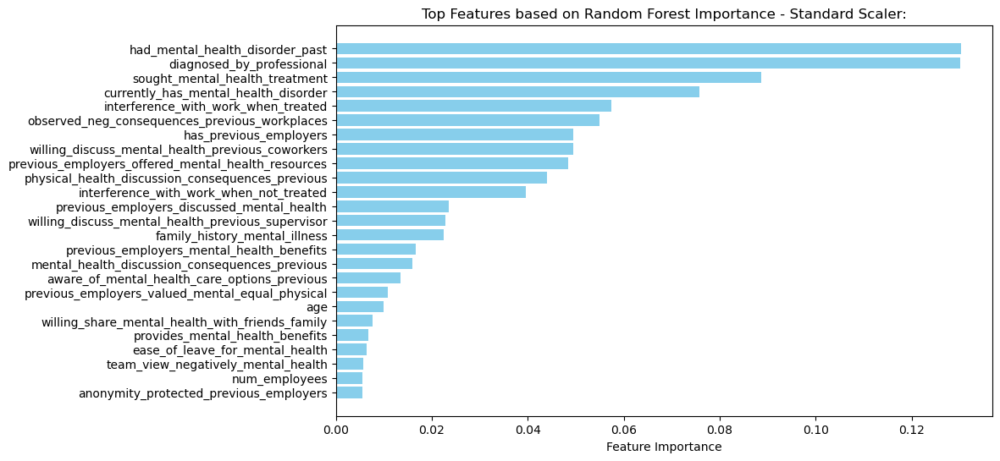



For MinMax Scale:
employer_values_mental_equal_physical
comfort_discussing_mental_health_with_supervisor
family_history_mental_illness
provides_mental_health_benefits
mental_health_discussion_consequences_previous
aware_of_mental_health_care_options_previous
previous_employers_mental_health_benefits
is_anonymity_protected
mental_health_discussion_consequences
age
has_discussed_mental_health
offers_mental_health_resources
currently_has_mental_health_disorder
comfort_discussing_mental_health_with_coworkers
interference_with_work_when_not_treated
observed_neg_consequences_for_coworkers
interference_with_work_when_treated
physical_health_discussion_consequences
is_tech_company
num_employees
had_mental_health_disorder_past
diagnosed_by_professional
sought_mental_health_treatment
gender_Female
gender_Male


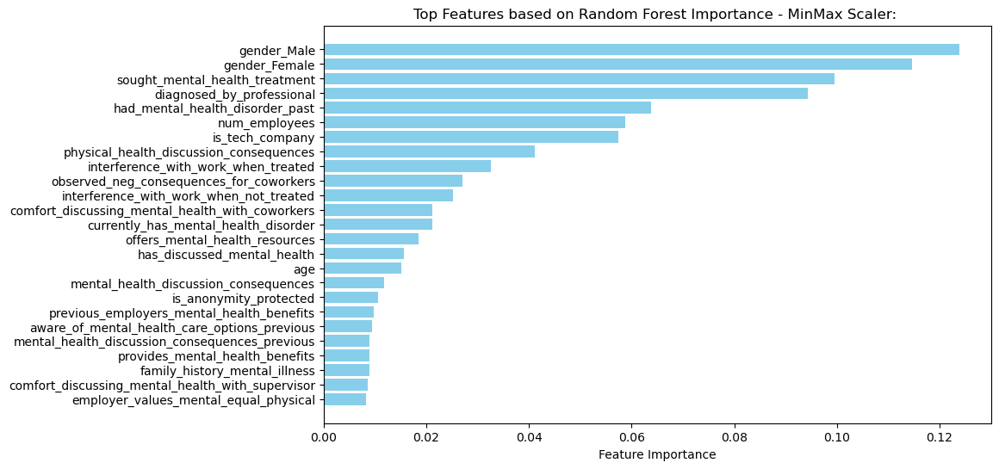

' \nMinMax Scaler:\n\nAnalysis: This includes demographic information and organizational factors.\nAdvice: Similar to the Mutual Information advice, ensure demographic factors are used appropriately to avoid biased outcomes.\n'

In [10]:
#Feature Importance from Random Forest 
clf = RandomForestClassifier(random_state=42)
clf.fit(df,initial_labels_S)
importances = clf.feature_importances_
indices = np.argsort(importances)[-25:]
data_selected_rf = df.iloc[:, indices]
feature_names_rf = df.columns[indices]

print('For Standard Scale:')
for feature in feature_names_rf:
    print(feature)

#Visualization of feature importance based on Random Forest
plt.figure(figsize=(10,6))
plt.barh(df.columns[indices], importances[indices], color ='skyblue')
plt.xlabel('Feature Importance')
plt.title('Top Features based on Random Forest Importance - Standard Scaler:')
plt.show()

''' 
Standard Scaler:

Analysis: The selected features emphasize personal mental health history and experiences with previous employers.
Advice: This aligns well with the goal of identifying key factors related to mental health in the tech industry. Consider the top features for deeper analysis.
'''
print('\n')

print('For MinMax Scale:')
#Feature Importance from Random Forest 
clf = RandomForestClassifier(random_state=42)
clf.fit(df,initial_labels_MM)
importances = clf.feature_importances_
indices = np.argsort(importances)[-25:]
data_selected_rf = df.iloc[:, indices]
feature_names_rf = df.columns[indices]

for feature in feature_names_rf:
    print(feature)

#Visualization of feature importance based on Random Forest
plt.figure(figsize=(10,6))
plt.barh(df.columns[indices], importances[indices], color ='skyblue')
plt.xlabel('Feature Importance')
plt.title('Top Features based on Random Forest Importance - MinMax Scaler: ')
plt.show()

''' 
MinMax Scaler:

Analysis: This includes demographic information and organizational factors.
Advice: Similar to the Mutual Information advice, ensure demographic factors are used appropriately to avoid biased outcomes.
'''


In [11]:
#The features that are selected below are a combination of all feature selection techniques will apply Dimensionality reduction to them and reiterate.

top_features = [
    'had_mental_health_disorder_past', 'diagnosed_by_professional', 
    'sought_mental_health_treatment', 'currently_has_mental_health_disorder', 
    'interference_with_work_when_treated', 'observed_neg_consequences_previous_workplaces', 
    'has_previous_employers', 'willing_discuss_mental_health_previous_coworkers', 
    'previous_employers_offered_mental_health_resources', 'previous_employers_discussed_mental_health', 
    'gender_Male', 'gender_Female', 'num_employees', 'is_tech_company', 
    'physical_health_discussion_consequences', 'interference_with_work_when_not_treated', 
    'observed_neg_consequences_for_coworkers', 'comfort_discussing_mental_health_with_coworkers', 
    'offers_mental_health_resources', 'age', 'provides_mental_health_benefits', 
    'is_anonymity_protected', 'mental_health_discussion_consequences', 
    'comfort_discussing_mental_health_with_supervisor', 'employer_values_mental_equal_physical', 
    'previous_employers_mental_health_benefits', 'aware_of_mental_health_care_options_previous', 
    'anonymity_protected_previous_employers', 'mental_health_discussion_consequences_previous', 
    'willing_discuss_physical_health_in_interview', 'identified_mental_health_impact_career', 
    'team_view_negatively_mental_health', 'family_history_mental_illness', 
    'works_remotely', 'willing_discuss_mental_health_previous_supervisor'
]

#from MinMax Scaler RF Importance
# top_features = [
#     'employer_values_mental_equal_physical', 'comfort_discussing_mental_health_with_supervisor',
#     'family_history_mental_illness', 'provides_mental_health_benefits',
#     'mental_health_discussion_consequences_previous', 'aware_of_mental_health_care_options_previous',
#     'previous_employers_mental_health_benefits', 'is_anonymity_protected',
#     'mental_health_discussion_consequences', 'age',
#     'has_discussed_mental_health', 'offers_mental_health_resources',
#     'currently_has_mental_health_disorder', 'comfort_discussing_mental_health_with_coworkers',
#     'interference_with_work_when_not_treated', 'observed_neg_consequences_for_coworkers',
#     'interference_with_work_when_treated', 'physical_health_discussion_consequences',
#     'is_tech_company', 'num_employees',
#     'had_mental_health_disorder_past', 'diagnosed_by_professional',
#     'sought_mental_health_treatment', 'gender_Female',
#     'gender_Male'
# ]

#from Standard Scaler RF Importance
# top_features = [
#     'employer_values_mental_equal_physical', 'comfort_discussing_mental_health_with_supervisor',
#     'family_history_mental_illness', 'provides_mental_health_benefits',
#     'mental_health_discussion_consequences_previous', 'aware_of_mental_health_care_options_previous',
#     'previous_employers_mental_health_benefits', 'is_anonymity_protected',
#     'mental_health_discussion_consequences', 'age',
#     'has_discussed_mental_health', 'offers_mental_health_resources',
#     'currently_has_mental_health_disorder', 'comfort_discussing_mental_health_with_coworkers',
#     'interference_with_work_when_not_treated', 'observed_neg_consequences_for_coworkers',
#     'interference_with_work_when_treated', 'physical_health_discussion_consequences',
#     'is_tech_company', 'num_employees',
#     'had_mental_health_disorder_past', 'diagnosed_by_professional',
#     'sought_mental_health_treatment', 'gender_Female',
#     'gender_Male'
# ]

data_selected = df[top_features]

scaler_S = StandardScaler()
data_selected_S = scaler_S.fit_transform(data_selected)
data_standard_df = pd.DataFrame(data_selected_S, columns=top_features)

scaler_MM = MinMaxScaler()
data_selected_MM = scaler_MM.fit_transform(data_selected)
data_minmax_df = pd.DataFrame(data_selected_MM, columns=top_features)


#Apply Dimensionality Reduction Methods:
from sklearn.decomposition import PCA, FastICA
from prince import MCA
from sklearn.manifold import MDS, LocallyLinearEmbedding, Isomap, TSNE
import umap

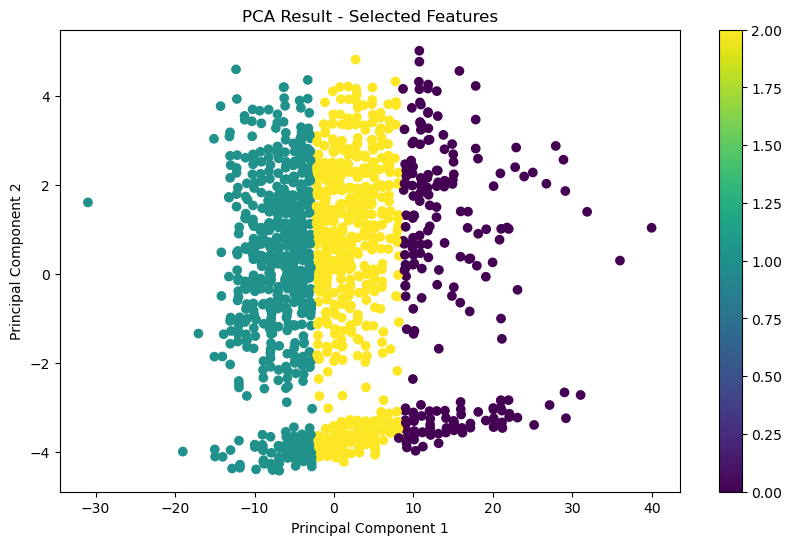

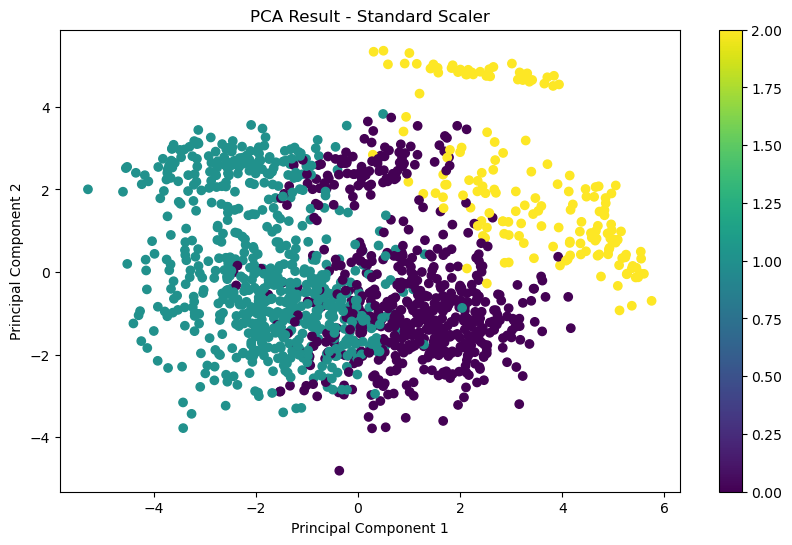

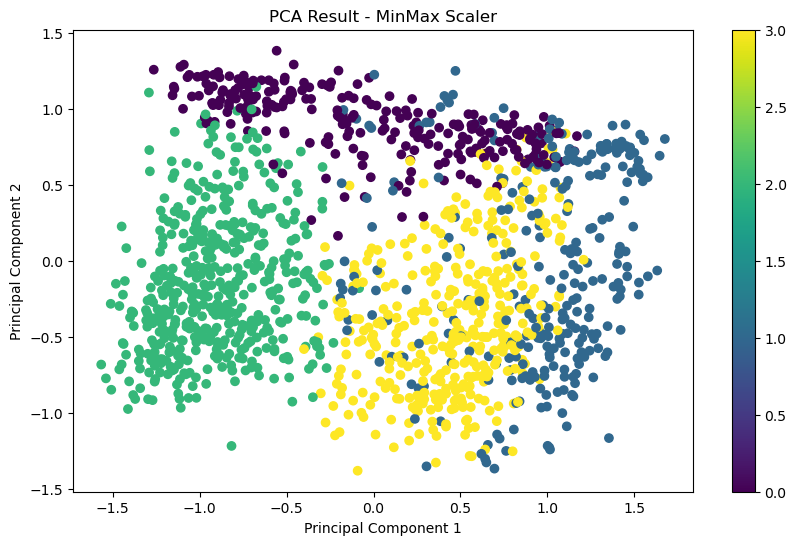

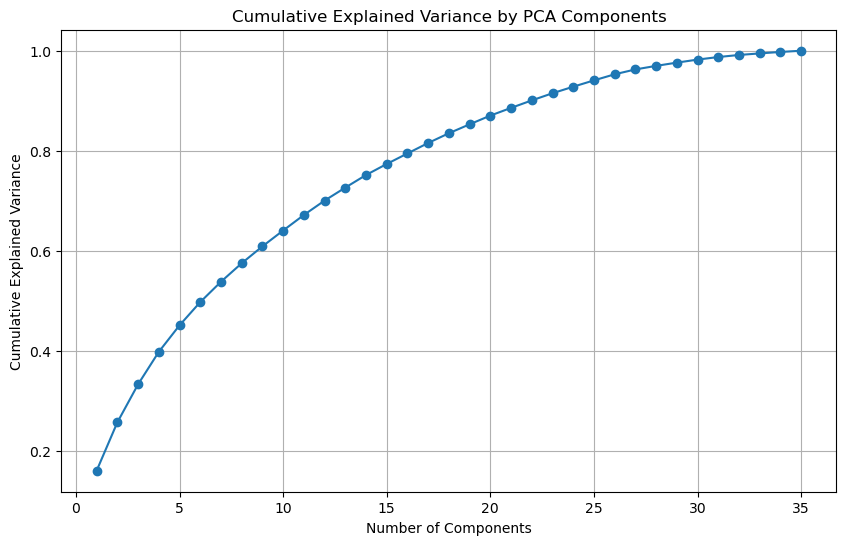

'\nPCA is a technique that reduces dimensionality by transforming features into principal components, \neach capturing the maximum variance possible. This helps simplify data while retaining its key variability.\n\n\nPCA Result - Selected Features:\nObservation: Clear and distinct cluster separation, indicating that the selected mental health features capture significant variance and effectively differentiate between groups.\n\nPCA Result - Standard Scaler:\nObservation: Balanced point distribution with noticeable cluster overlap. \nStandardization ensures equal feature contribution but may dilute the impact of highly informative features, resulting in less distinct clusters.\n\nPCA Result - MinMax Scaler:\nObservation: Distinct clusters with better separation. MinMax scaling preserves relative feature differences more effectively, \nhighlighting natural variance in the mental health data and improving cluster differentiation.\n'

In [12]:
#PCA 
pca = PCA(n_components=len(top_features))
pca_result= pca.fit_transform(data_selected)
pca_result_S = pca.fit_transform(data_selected_S)
pca_result_MM = pca.fit_transform(data_selected_MM)
explained_variance_pca = pca.explained_variance_ratio_.cumsum()

plt.figure(figsize=(10, 6))
plt.scatter(pca_result[:, 0], pca_result[:, 1], c=initial_labels, cmap='viridis')
plt.title('PCA Result - Selected Features')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(pca_result_S[:, 0], pca_result_S[:, 1], c=initial_labels_S, cmap='viridis')
plt.title('PCA Result - Standard Scaler')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(pca_result_MM[:, 0], pca_result_MM[:, 1], c=initial_labels_MM, cmap='viridis')
plt.title('PCA Result - MinMax Scaler')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(range(1,len(explained_variance_pca) + 1), explained_variance_pca, marker = 'o')
plt.title('Cumulative Explained Variance by PCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
plt.show()

'''
PCA is a technique that reduces dimensionality by transforming features into principal components, 
each capturing the maximum variance possible. This helps simplify data while retaining its key variability.


PCA Result - Selected Features:
Observation: Clear and distinct cluster separation, indicating that the selected mental health features capture significant variance and effectively differentiate between groups.

PCA Result - Standard Scaler:
Observation: Balanced point distribution with noticeable cluster overlap. 
Standardization ensures equal feature contribution but may dilute the impact of highly informative features, resulting in less distinct clusters.

PCA Result - MinMax Scaler:
Observation: Distinct clusters with better separation. MinMax scaling preserves relative feature differences more effectively, 
highlighting natural variance in the mental health data and improving cluster differentiation.
'''




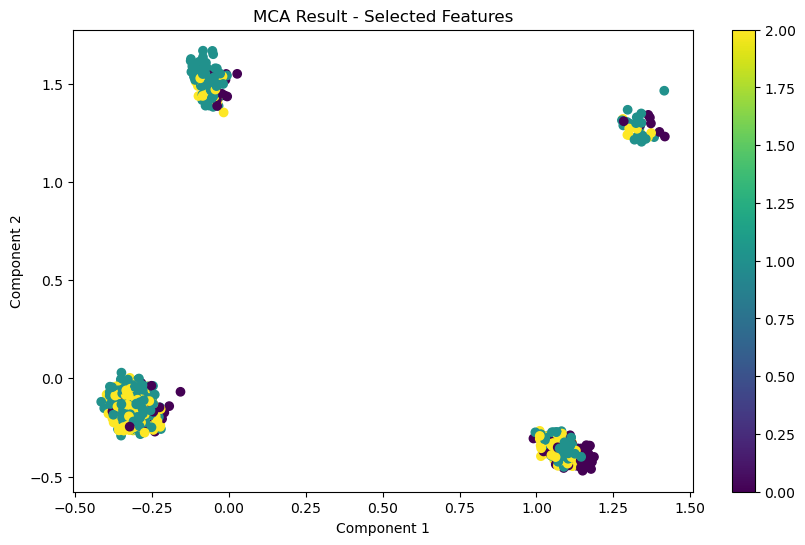

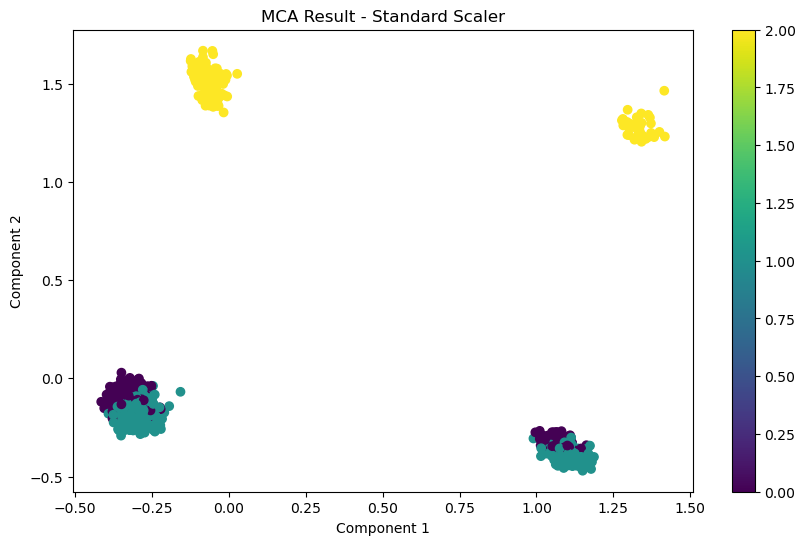

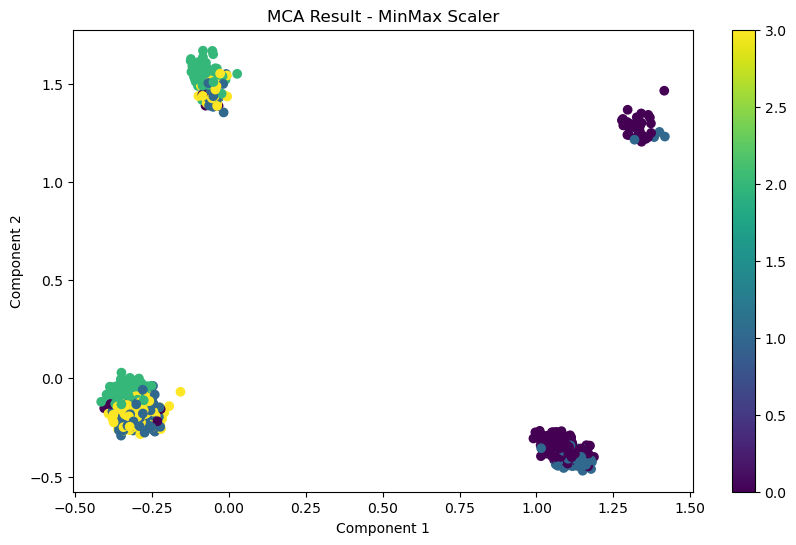

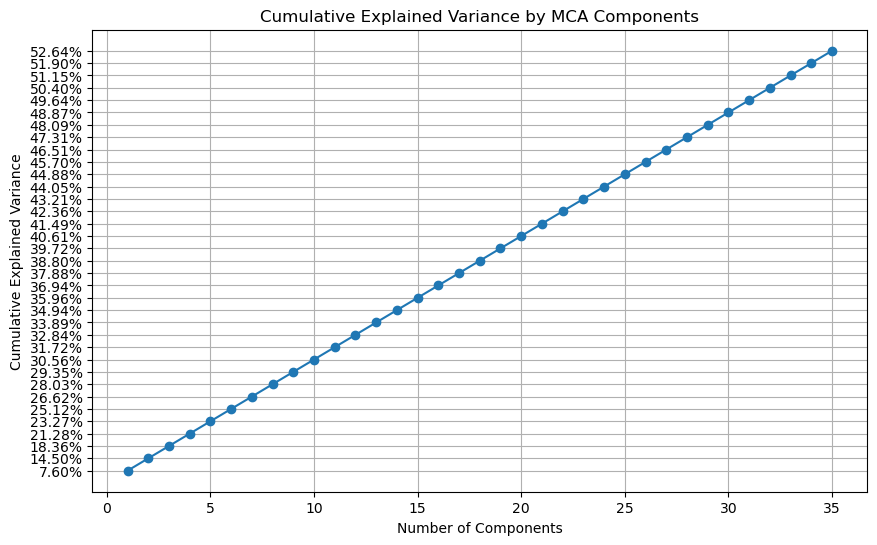

' \nMCA is a dimensionality reduction technique used for categorical data. \nIt transforms data into principal components that capture the most variance in the dataset, similar to PCA but for categorical variables.\n\nMCA Result - Selected Features:\nObservation: The scatter plot shows distinct clusters on either side of Component 1. \nThe separation indicates that the selected categorical features effectively capture the variance and differentiate between groups.\n\nMCA Result - Standard Scaler:\nObservation: The scatter plot shows similar clustering to the selected features, \nwith distinct groups on either side of Component 1. This suggests that standardization retains the variance captured by the categorical features, maintaining clear separation.\n\nMCA Result - MinMax Scaler:\nObservation: The scatter plot shows more compressed clusters compared to the standard scaler. \nThe MinMax scaling preserves relative differences between categorical features, resulting in a tighter groupin

In [13]:
#MCA 
mca = MCA(n_components = len(top_features))
mca_result = mca.fit_transform(data_selected)
mca_result_S = mca.fit_transform(data_standard_df)
mca_result_MM = mca.fit_transform(data_minmax_df)
explained_variance_mca =mca.eigenvalues_summary.iloc[:, 2].values

plt.figure(figsize=(10, 6))
plt.scatter(mca_result[0], mca_result[1], c=initial_labels, cmap='viridis')
plt.title('MCA Result - Selected Features')
plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(mca_result_S[0], mca_result_S[1], c=initial_labels_S, cmap='viridis')
plt.title('MCA Result - Standard Scaler')
plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(mca_result_MM[0], mca_result_MM[1], c=initial_labels_MM, cmap='viridis')
plt.title('MCA Result - MinMax Scaler')
plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.colorbar()
plt.show()

# Visualize MCA explained variance
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(explained_variance_mca) + 1), explained_variance_mca, marker='o')
plt.title('Cumulative Explained Variance by MCA Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
plt.show()

''' 
MCA is a dimensionality reduction technique used for categorical data. 
It transforms data into principal components that capture the most variance in the dataset, similar to PCA but for categorical variables.

MCA Result - Selected Features:
Observation: The scatter plot shows distinct clusters on either side of Component 1. 
The separation indicates that the selected categorical features effectively capture the variance and differentiate between groups.

MCA Result - Standard Scaler:
Observation: The scatter plot shows similar clustering to the selected features, 
with distinct groups on either side of Component 1. This suggests that standardization retains the variance captured by the categorical features, maintaining clear separation.

MCA Result - MinMax Scaler:
Observation: The scatter plot shows more compressed clusters compared to the standard scaler. 
The MinMax scaling preserves relative differences between categorical features, resulting in a tighter grouping but still clear separation.
'''





In [14]:
#MDS
mds = MDS (n_components=2, random_state=42, normalized_stress = 'auto')
mds_result = mds.fit_transform(data_selected)
mds_result_S = mds.fit_transform(data_selected_S)
mds_result_MM = mds.fit_transform(data_selected_MM)

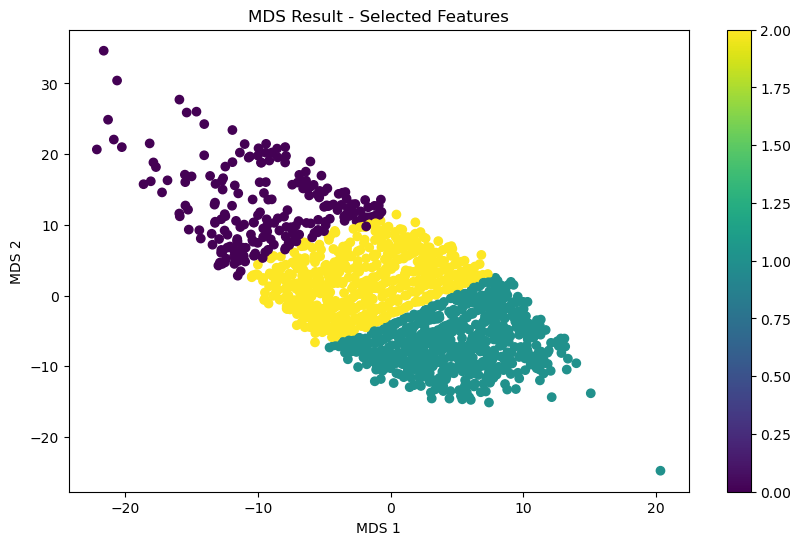

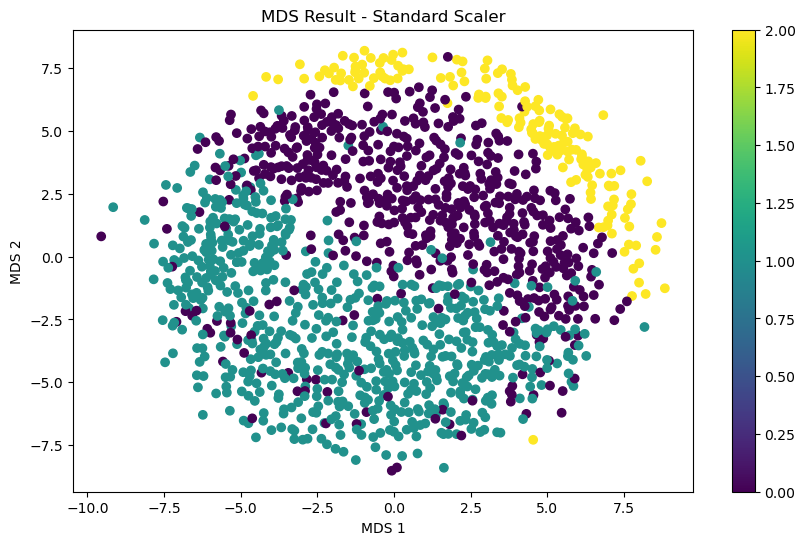

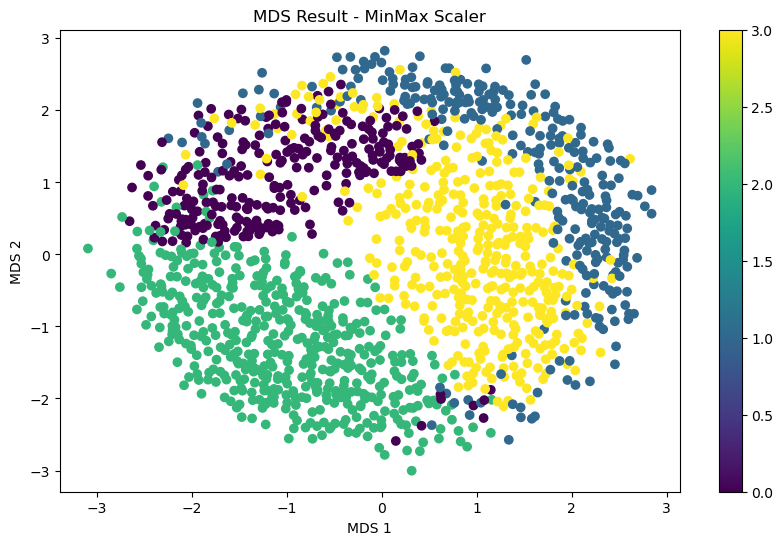

' \nMDS is a technique used to visualize the similarity or dissimilarity of data points in a lower-dimensional space. \nIt positions each object in N-dimensional space such that the between-object distances are preserved as well as possible. \nThe goal is to maintain the original distance relationships in the reduced dimensions.\n\n\nMDS Result - Selected Features:\nObservation: The scatter plot shows clear and distinct separation of clusters along the first dimension (MDS1). \nThis indicates that the selected features effectively capture the dissimilarity between groups, preserving the original distances well.\n\nMDS Result - Standard Scaler:\nObservation: The scatter plot shows a more circular distribution of points with significant cluster overlap. \nThe circular pattern suggests that the standard scaling equalizes feature contribution but may obscure the natural dissimilarities between clusters, leading to less clear separation.\n\nMDS Result - MinMax Scaler:\nObservation: The scat

In [15]:
plt.figure(figsize=(10, 6))
plt.scatter(mds_result[:, 0], mds_result[:, 1],c=initial_labels, cmap='viridis')
plt.title('MDS Result - Selected Features')
plt.xlabel('MDS 1')
plt.ylabel('MDS 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(mds_result_S[:, 0], mds_result_S[:, 1], c=initial_labels_S, cmap='viridis')
plt.title('MDS Result - Standard Scaler')
plt.xlabel('MDS 1')
plt.ylabel('MDS 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(mds_result_MM[:, 0], mds_result_MM[:, 1], c=initial_labels_MM, cmap='viridis')
plt.title('MDS Result - MinMax Scaler')
plt.xlabel('MDS 1')
plt.ylabel('MDS 2')
plt.colorbar()
plt.show()

''' 
MDS is a technique used to visualize the similarity or dissimilarity of data points in a lower-dimensional space. 
It positions each object in N-dimensional space such that the between-object distances are preserved as well as possible. 
The goal is to maintain the original distance relationships in the reduced dimensions.


MDS Result - Selected Features:
Observation: The scatter plot shows clear and distinct separation of clusters along the first dimension (MDS1). 
This indicates that the selected features effectively capture the dissimilarity between groups, preserving the original distances well.

MDS Result - Standard Scaler:
Observation: The scatter plot shows a more circular distribution of points with significant cluster overlap. 
The circular pattern suggests that the standard scaling equalizes feature contribution but may obscure the natural dissimilarities between clusters, leading to less clear separation.

MDS Result - MinMax Scaler:
Observation: The scatter plot also shows a circular distribution but with better separation compared to the standard scaler. 
MinMax scaling preserves relative differences more effectively, resulting in clearer cluster differentiation while still maintaining a circular layout.
'''

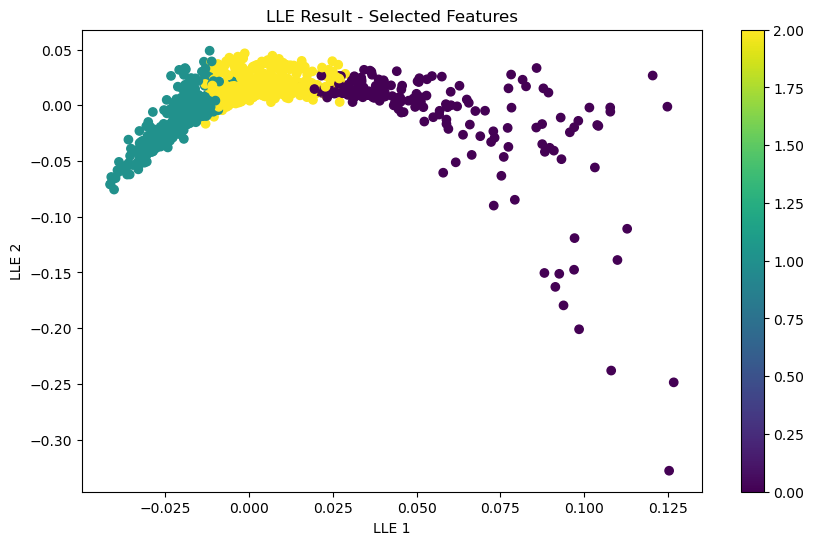

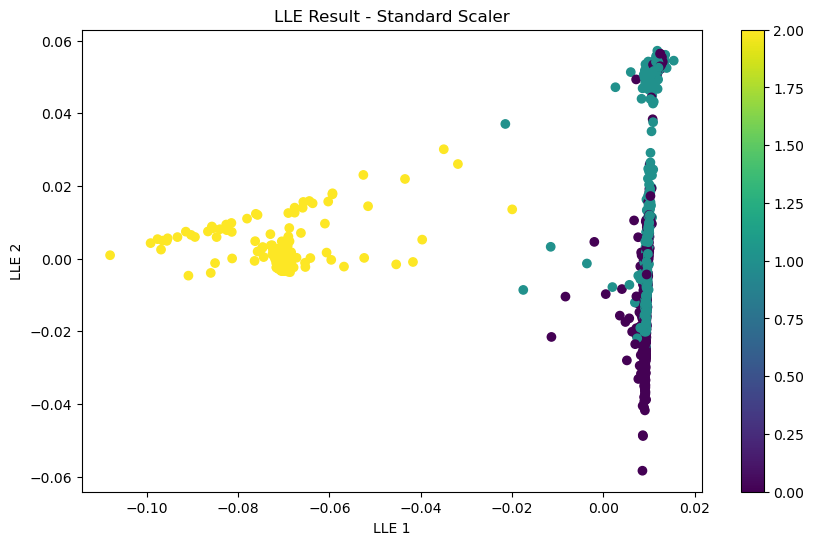

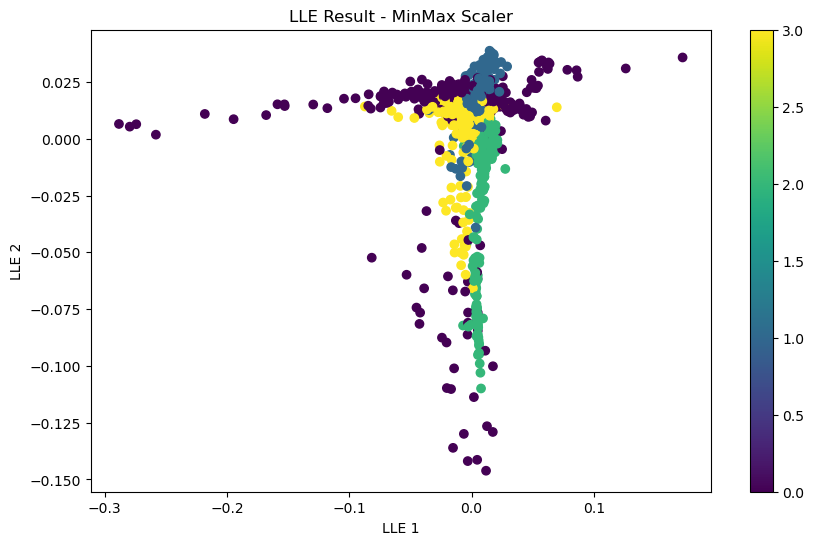

' \nLLE is a non-linear dimensionality reduction technique that preserves the local relationships of data points. \nIt aims to map data into a lower-dimensional space while maintaining the neighborhood structure of each data point.\n\n\nLLE Result - Selected Features:\nObservation: The scatter plot shows a stretched cluster formation with some distinct separation along LLE 1. \nThis indicates that the selected features capture local relationships, but there is some mixing of clusters.\n\nLLE Result - Standard Scaler:\nObservation: The scatter plot shows a more compressed distribution of points with less distinct cluster separation. \nhe standard scaler appears to cause a compression effect, reducing the ability to clearly separate clusters based on local relationships.\n\nLLE Result - MinMax Scaler:\nObservation: The scatter plot shows a more spread-out distribution with slightly better separation compared to the standard scaler. \nMinMax scaling preserves relative differences more eff

In [16]:
#lle
lle = LocallyLinearEmbedding(n_components=2,n_neighbors=10, random_state=42)
lle_result = lle.fit_transform(data_selected)
lle_result_S = lle.fit_transform(data_selected_S)
lle_result_MM = lle.fit_transform(data_selected_MM)

plt.figure(figsize=(10, 6))
plt.scatter(lle_result[:, 0], lle_result[:, 1], c=initial_labels, cmap='viridis')
plt.title('LLE Result - Selected Features')
plt.xlabel('LLE 1')
plt.ylabel('LLE 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(lle_result_S[:, 0], lle_result_S[:, 1], c=initial_labels_S, cmap='viridis')
plt.title('LLE Result - Standard Scaler')
plt.xlabel('LLE 1')
plt.ylabel('LLE 2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(lle_result_MM[:, 0], lle_result_MM[:, 1], c=initial_labels_MM, cmap='viridis')
plt.title('LLE Result - MinMax Scaler')
plt.xlabel('LLE 1')
plt.ylabel('LLE 2')
plt.colorbar()
plt.show()

''' 
LLE is a non-linear dimensionality reduction technique that preserves the local relationships of data points. 
It aims to map data into a lower-dimensional space while maintaining the neighborhood structure of each data point.


LLE Result - Selected Features:
Observation: The scatter plot shows a stretched cluster formation with some distinct separation along LLE 1. 
This indicates that the selected features capture local relationships, but there is some mixing of clusters.

LLE Result - Standard Scaler:
Observation: The scatter plot shows a more compressed distribution of points with less distinct cluster separation. 
he standard scaler appears to cause a compression effect, reducing the ability to clearly separate clusters based on local relationships.

LLE Result - MinMax Scaler:
Observation: The scatter plot shows a more spread-out distribution with slightly better separation compared to the standard scaler. 
MinMax scaling preserves relative differences more effectively, but clusters are still mixed, indicating challenges in capturing local relationships clearly.
'''


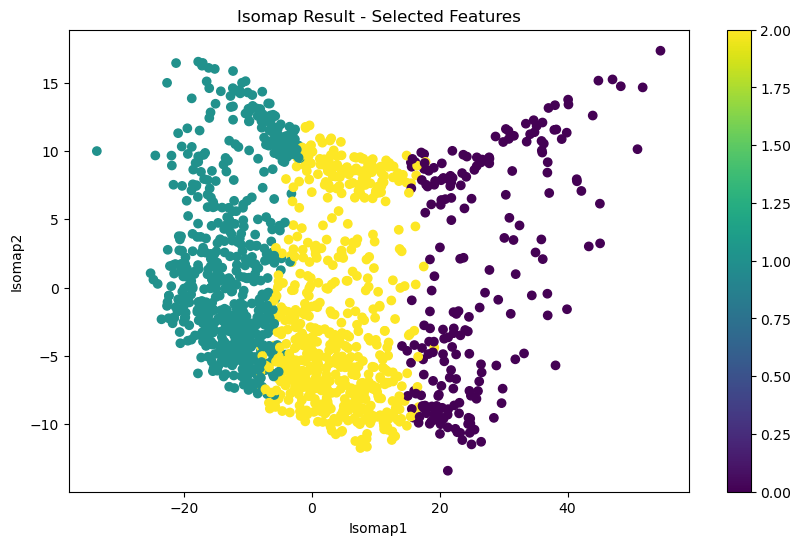

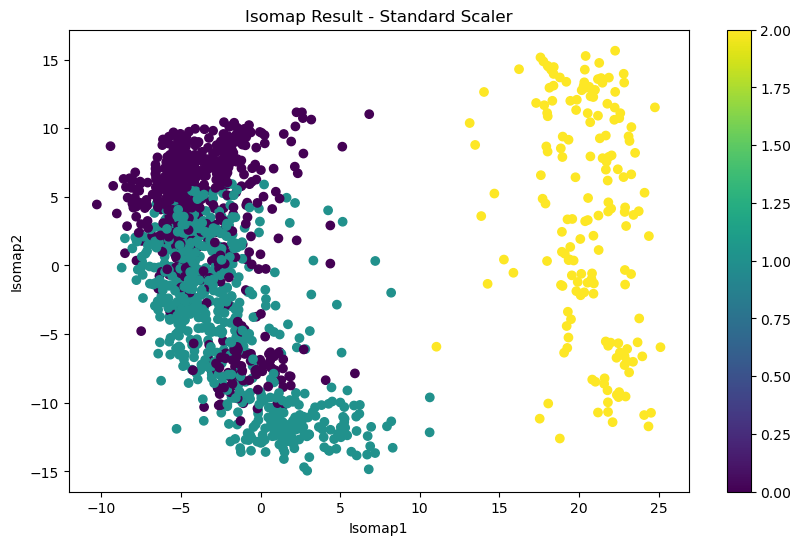

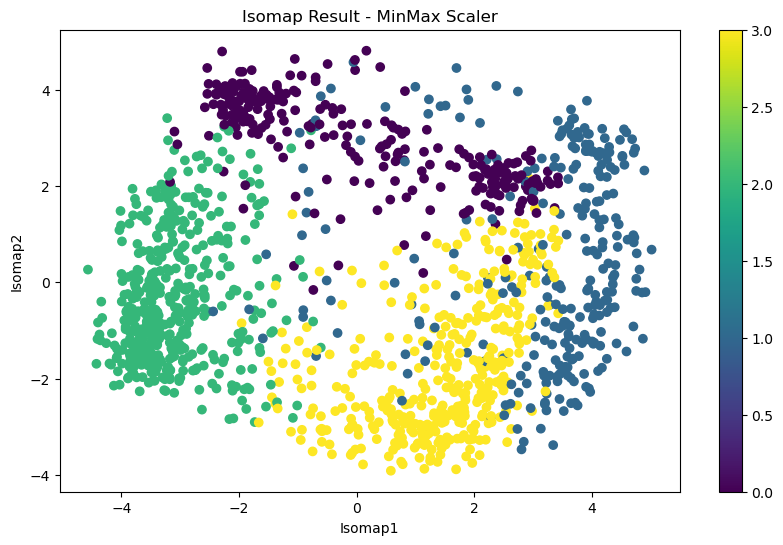

'\nIsomap is a non-linear dimensionality reduction technique that extends MDS by using geodesic distances on a neighborhood graph to preserve the global structure of the data. \nIt aims to maintain the manifold structure in a lower-dimensional space.\n\n\nIsomap Result - Selected Features:\nObservation: The scatter plot shows clear and distinct cluster separation along Isomap1, \nndicating that the selected features effectively capture the global structure and variance of the mental health dataset.\n\nIsomap Result - Standard Scaler:\nObservation: The scatter plot shows a more intertwined and compressed distribution of points with significant cluster overlap. \nStandard scaling equalizes feature contributions but may obscure the global structure, leading to less distinct clusters.\n\nIsomap Result - MinMax Scaler:\nObservation: The scatter plot shows better-separated clusters compared to the standard scaler, though with a more spread-out distribution. \nMinMax scaling preserves relativ

In [17]:
#Isomap

isomap = Isomap(n_components=2,n_neighbors=10)
isomap_result = isomap.fit_transform(data_selected)
isomap_result_S = isomap.fit_transform(data_selected_S)
isomap_result_MM = isomap.fit_transform(data_selected_MM)

plt.figure(figsize=(10, 6))
plt.scatter(isomap_result[:, 0], isomap_result[:, 1], c=initial_labels, cmap='viridis')
plt.title('Isomap Result - Selected Features')
plt.xlabel('Isomap1')
plt.ylabel('Isomap2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(isomap_result_S[:, 0], isomap_result_S[:, 1], c=initial_labels_S, cmap='viridis')
plt.title('Isomap Result - Standard Scaler')
plt.xlabel('Isomap1')
plt.ylabel('Isomap2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(isomap_result_MM[:, 0], isomap_result_MM[:, 1], c=initial_labels_MM, cmap='viridis')
plt.title('Isomap Result - MinMax Scaler')
plt.xlabel('Isomap1')
plt.ylabel('Isomap2')
plt.colorbar()
plt.show()

'''
Isomap is a non-linear dimensionality reduction technique that extends MDS by using geodesic distances on a neighborhood graph to preserve the global structure of the data. 
It aims to maintain the manifold structure in a lower-dimensional space.


Isomap Result - Selected Features:
Observation: The scatter plot shows clear and distinct cluster separation along Isomap1, 
ndicating that the selected features effectively capture the global structure and variance of the mental health dataset.

Isomap Result - Standard Scaler:
Observation: The scatter plot shows a more intertwined and compressed distribution of points with significant cluster overlap. 
Standard scaling equalizes feature contributions but may obscure the global structure, leading to less distinct clusters.

Isomap Result - MinMax Scaler:
Observation: The scatter plot shows better-separated clusters compared to the standard scaler, though with a more spread-out distribution. 
MinMax scaling preserves relative differences effectively, resulting in improved cluster differentiation while maintaining the manifold structure.
'''


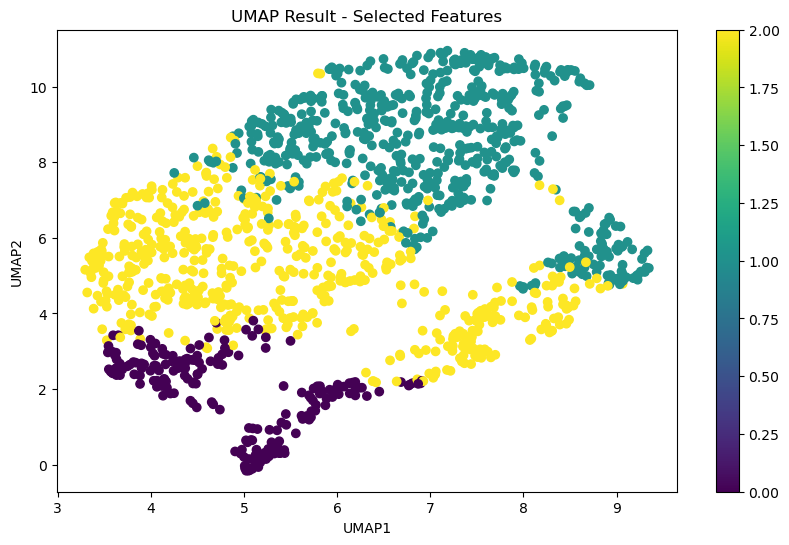

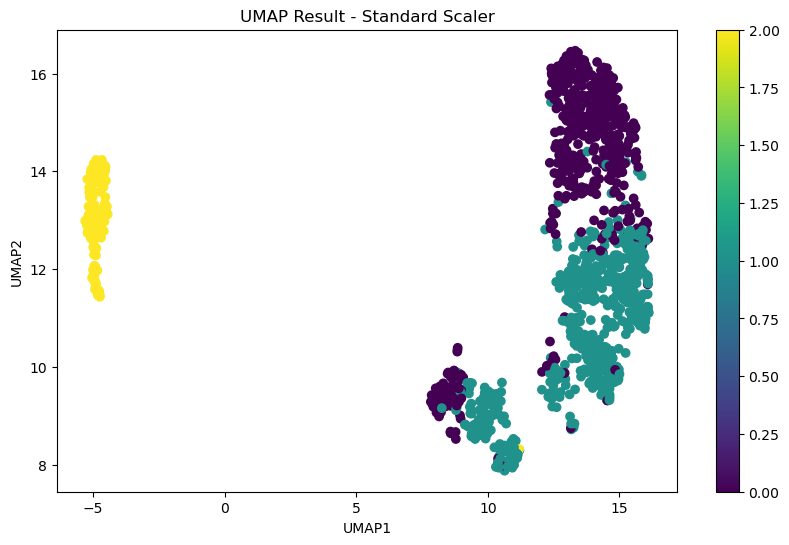

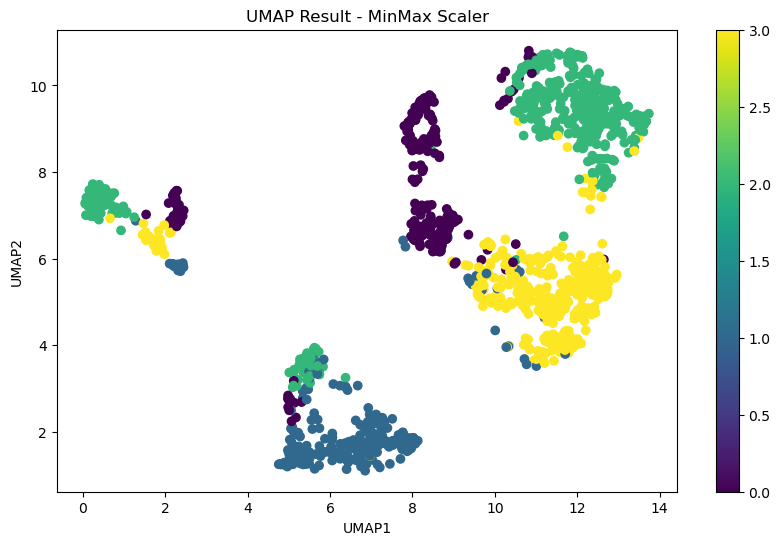

"\nUMAP is a non-linear dimensionality reduction technique that focuses on preserving the global and local structure of the data. \nIt aims to create a low-dimensional representation of data that maintains the topological structure of the original high-dimensional space.\n\nUMAP Result - Selected Features:\nObservation: The scatter plot shows clear and distinct cluster separation, with clusters well-distributed across the UMAP1 and UMAP2 axes. \nThe selected features effectively capture the data's structure, providing clear differentiation between groups.\n\nUMAP Result - Standard Scaler:\nObservation: The scatter plot shows distinct clusters, but they are more fragmented and dispersed compared to the selected features. \nStandard scaling results in smaller, isolated clusters, indicating that while some structure is preserved, the global relationships are less clear.\n\nUMAP Result - MinMax Scaler:\nObservation: The scatter plot shows well-separated clusters similar to the selected fea

In [18]:
#UMAP
umap_model = umap.UMAP(n_components=2)
umap_result = umap_model.fit_transform(data_selected)
umap_result_S = umap_model.fit_transform(data_selected_S)
umap_result_MM = umap_model.fit_transform(data_selected_MM)

plt.figure(figsize=(10, 6))
plt.scatter(umap_result[:, 0], umap_result[:, 1], c=initial_labels, cmap='viridis')
plt.title('UMAP Result - Selected Features')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.colorbar()
plt.show()


plt.figure(figsize=(10, 6))
plt.scatter(umap_result_S[:, 0], umap_result_S[:, 1], c=initial_labels_S, cmap='viridis')
plt.title('UMAP Result - Standard Scaler')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(umap_result_MM[:, 0], umap_result_MM[:, 1], c=initial_labels_MM, cmap='viridis')
plt.title('UMAP Result - MinMax Scaler')
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.colorbar()
plt.show()

'''
UMAP is a non-linear dimensionality reduction technique that focuses on preserving the global and local structure of the data. 
It aims to create a low-dimensional representation of data that maintains the topological structure of the original high-dimensional space.

UMAP Result - Selected Features:
Observation: The scatter plot shows clear and distinct cluster separation, with clusters well-distributed across the UMAP1 and UMAP2 axes. 
The selected features effectively capture the data's structure, providing clear differentiation between groups.

UMAP Result - Standard Scaler:
Observation: The scatter plot shows distinct clusters, but they are more fragmented and dispersed compared to the selected features. 
Standard scaling results in smaller, isolated clusters, indicating that while some structure is preserved, the global relationships are less clear.

UMAP Result - MinMax Scaler:
Observation: The scatter plot shows well-separated clusters similar to the selected features but with more distinct groupings. 
MinMax scaling preserves the relative differences effectively, leading to better-defined clusters while maintaining the data's topological structure.
'''

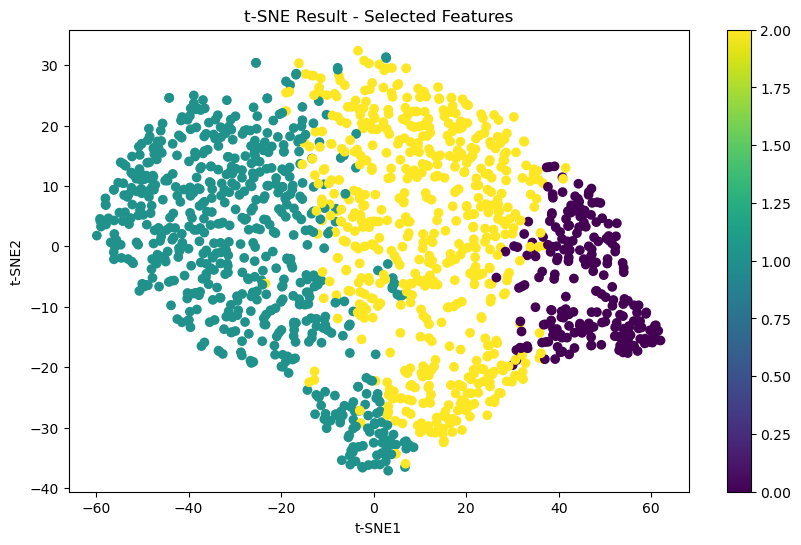

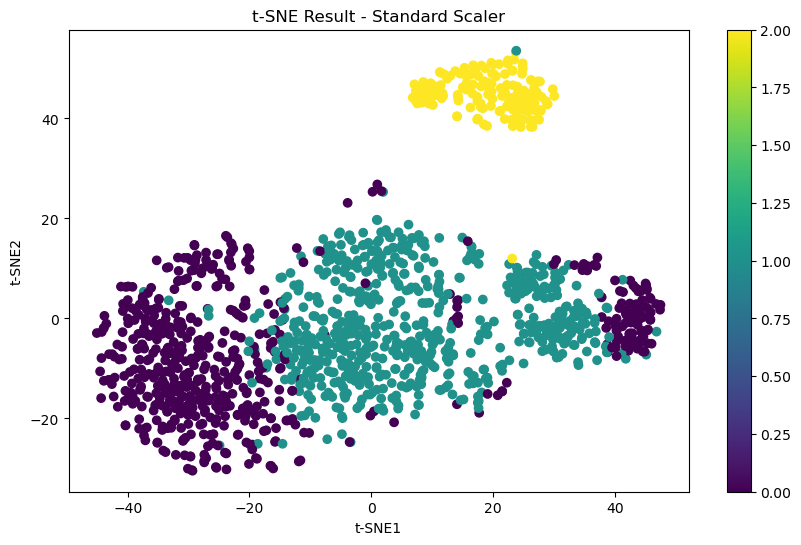

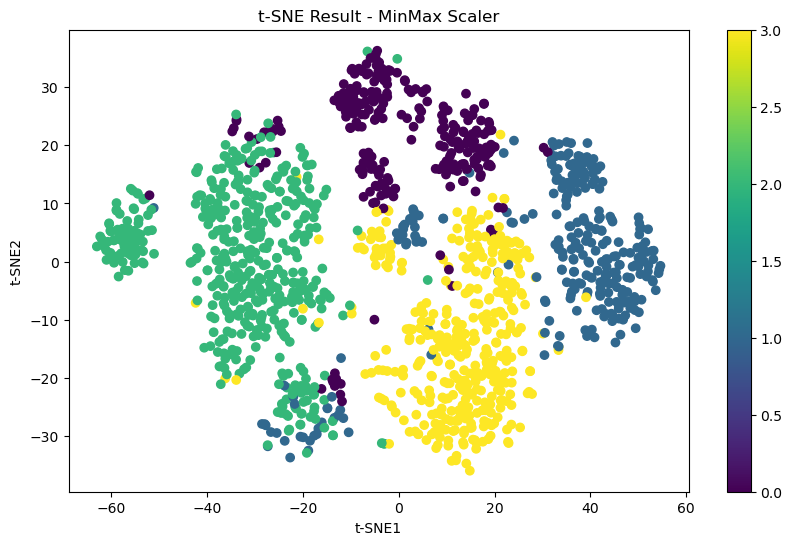

' \nt-SNE is a non-linear dimensionality reduction technique that is particularly well-suited for visualizing high-dimensional data. \nIt focuses on preserving local similarities and creating a map where similar data points are modeled by nearby points and dissimilar data points are modeled by distant points.\n\nt-SNE Result - Selected Features:\nObservation: The scatter plot shows distinct clusters with clear separation along the t-SNE axes. \nThe selected features effectively capture local similarities, resulting in well-defined clusters.\n\nt-SNE Result - Standard Scaler:\nObservation: The scatter plot shows distinct clusters but with less separation compared to the selected features. \nStandard scaling equalizes feature contributions, leading to some mixing of clusters but still preserving local similarities.\n\nt-SNE Result - MinMax Scaler:\nObservation: The scatter plot shows distinct clusters with better separation compared to the standard scaler. \nMinMax scaling preserves rela

In [19]:
#t-SNE
tsne = TSNE(n_components=2,random_state=42)
tsne_result = tsne.fit_transform(data_selected)
tsne_result_S = tsne.fit_transform(data_selected_S)
tsne_result_MM = tsne.fit_transform(data_selected_MM)

plt.figure(figsize=(10, 6))
plt.scatter(tsne_result[:, 0], tsne_result[:, 1], c=initial_labels, cmap='viridis')
plt.title('t-SNE Result - Selected Features')
plt.xlabel('t-SNE1')
plt.ylabel('t-SNE2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(tsne_result_S[:, 0], tsne_result_S[:, 1], c=initial_labels_S, cmap='viridis')
plt.title('t-SNE Result - Standard Scaler')
plt.xlabel('t-SNE1')
plt.ylabel('t-SNE2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(tsne_result_MM[:, 0], tsne_result_MM[:, 1], c=initial_labels_MM, cmap='viridis')
plt.title('t-SNE Result - MinMax Scaler')
plt.xlabel('t-SNE1')
plt.ylabel('t-SNE2')
plt.colorbar()
plt.show()

''' 
t-SNE is a non-linear dimensionality reduction technique that is particularly well-suited for visualizing high-dimensional data. 
It focuses on preserving local similarities and creating a map where similar data points are modeled by nearby points and dissimilar data points are modeled by distant points.

t-SNE Result - Selected Features:
Observation: The scatter plot shows distinct clusters with clear separation along the t-SNE axes. 
The selected features effectively capture local similarities, resulting in well-defined clusters.

t-SNE Result - Standard Scaler:
Observation: The scatter plot shows distinct clusters but with less separation compared to the selected features. 
Standard scaling equalizes feature contributions, leading to some mixing of clusters but still preserving local similarities.

t-SNE Result - MinMax Scaler:
Observation: The scatter plot shows distinct clusters with better separation compared to the standard scaler. 
MinMax scaling preserves relative differences effectively, resulting in clear and well-defined clusters that capture local similarities.
'''


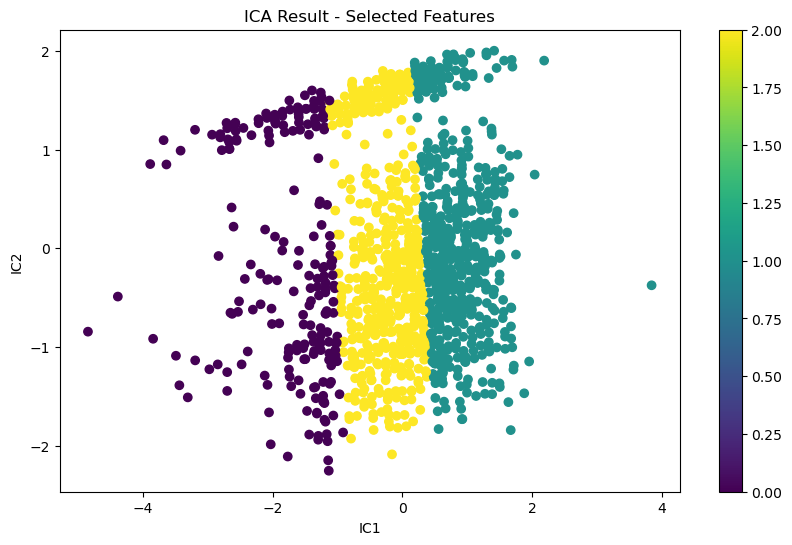

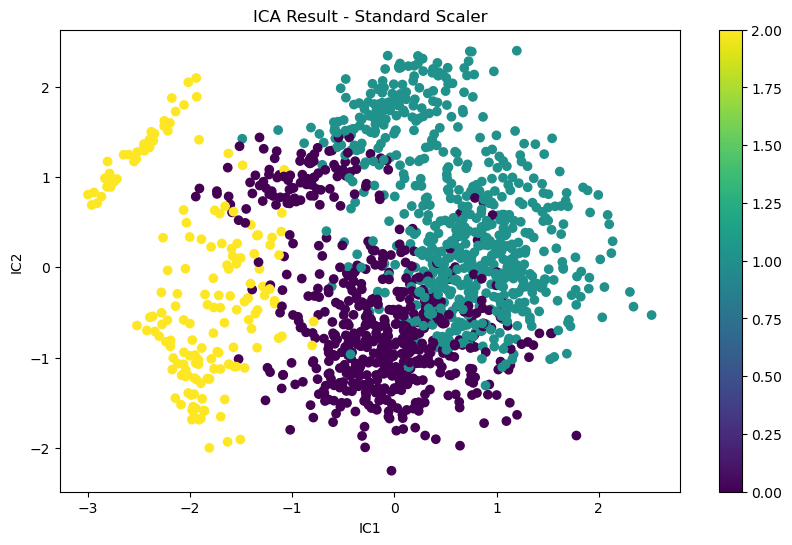

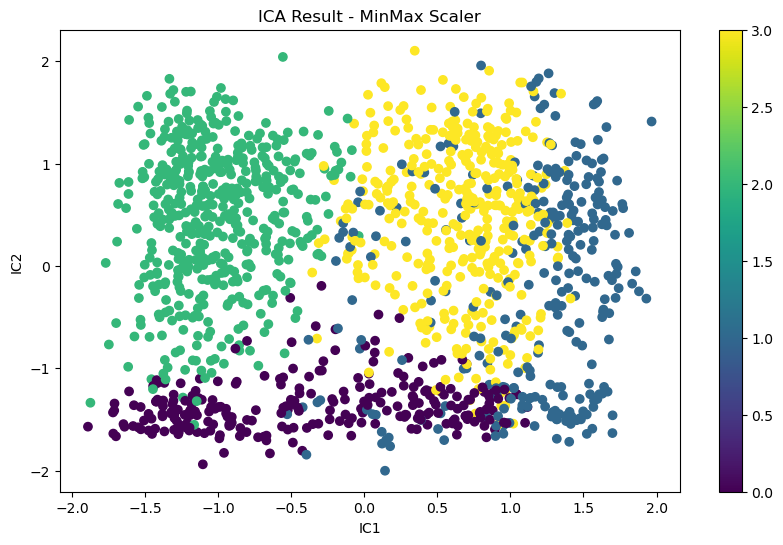

' \nICA is a computational method for separating a multivariate signal into additive, independent components. \nIt is often used for finding hidden factors or signals in the data.\n\nICA Result - Selected Features:\nObservation: The scatter plot shows distinct and clear cluster separation along the IC1 and IC2 axes. \nThe selected features capture significant independent components, effectively differentiating between groups.\n\nICA Result - Standard Scaler:\nObservation: The scatter plot shows clusters that are more spread out and less distinct. \nStandard scaling equalizes feature contributions, resulting in a more dispersed distribution and less clear separation of independent components.\n\nICA Result - MinMax Scaler:\nObservation: The scatter plot shows a better-defined separation compared to the standard scaler but with some overlap. \nMinMax scaling preserves relative differences more effectively, leading to clearer cluster differentiation along independent components.\n'

In [20]:
#ICA
ica= FastICA(n_components=2, random_state=42, whiten='unit-variance')
ica_result = ica.fit_transform(data_selected)
ica_result_S = ica.fit_transform(data_selected_S)
ica_result_MM = ica.fit_transform(data_selected_MM)

plt.figure(figsize=(10, 6))
plt.scatter(ica_result[:, 0], ica_result[:, 1], c=initial_labels, cmap='viridis')
plt.title('ICA Result - Selected Features')
plt.xlabel('IC1')
plt.ylabel('IC2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(ica_result_S[:, 0], ica_result_S[:, 1], c=initial_labels_S, cmap='viridis')
plt.title('ICA Result - Standard Scaler')
plt.xlabel('IC1')
plt.ylabel('IC2')
plt.colorbar()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(ica_result_MM[:, 0], ica_result_MM[:, 1], c=initial_labels_MM, cmap='viridis')
plt.title('ICA Result - MinMax Scaler')
plt.xlabel('IC1')
plt.ylabel('IC2')
plt.colorbar()
plt.show()



''' 
ICA is a computational method for separating a multivariate signal into additive, independent components. 
It is often used for finding hidden factors or signals in the data.

ICA Result - Selected Features:
Observation: The scatter plot shows distinct and clear cluster separation along the IC1 and IC2 axes. 
The selected features capture significant independent components, effectively differentiating between groups.

ICA Result - Standard Scaler:
Observation: The scatter plot shows clusters that are more spread out and less distinct. 
Standard scaling equalizes feature contributions, resulting in a more dispersed distribution and less clear separation of independent components.

ICA Result - MinMax Scaler:
Observation: The scatter plot shows a better-defined separation compared to the standard scaler but with some overlap. 
MinMax scaling preserves relative differences more effectively, leading to clearer cluster differentiation along independent components.
'''



In [21]:
#Evaluate and Compare Dimensionality Reduction Methods with Clustering:

from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN, MeanShift, AffinityPropagation, Birch, OPTICS, SpectralClustering
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
from yellowbrick.cluster import KElbowVisualizer
from scipy.cluster.hierarchy import dendrogram, linkage

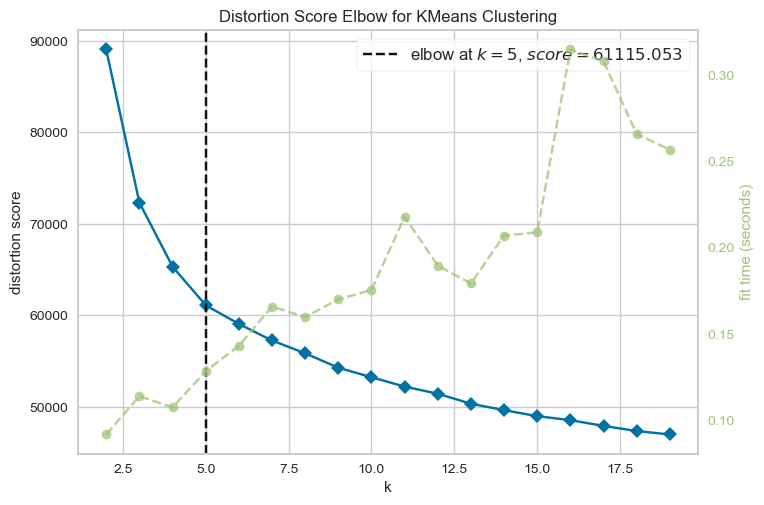

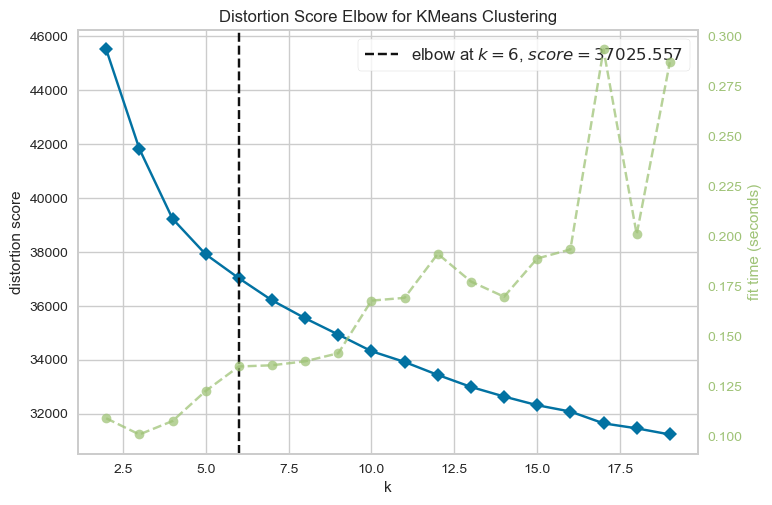

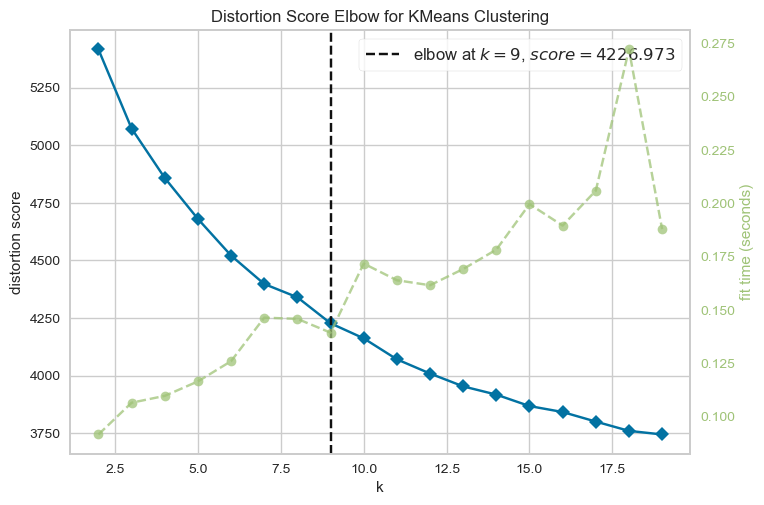

' \nThe Elbow Criterion is a method used to determine the optimal number of clusters (k) in a dataset for KMeans clustering. \nThe goal is to identify the point where the distortion score (within-cluster sum of squares) starts to diminish at a slower rate, forming an "elbow" in the plot. \nThis suggests that adding more clusters beyond this point yields diminishing returns.\n\n\nSelected Features: Optimal k = 5\nStandard Scaler: Optimal k = 7\nMinMax Scaler: Optimal k = 7\n\n'

In [22]:
# Suppress specific warnings
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

def kmeans_elbow(data):
    model = KMeans()
    visualizer = KElbowVisualizer(model,k=(2,20))
    visualizer.fit(data)
    visualizer.show()

kmeans_elbow(data_selected)
kmeans_elbow(data_selected_S)
kmeans_elbow(data_selected_MM)

''' 
The Elbow Criterion is a method used to determine the optimal number of clusters (k) in a dataset for KMeans clustering. 
The goal is to identify the point where the distortion score (within-cluster sum of squares) starts to diminish at a slower rate, forming an "elbow" in the plot. 
This suggests that adding more clusters beyond this point yields diminishing returns.


Selected Features: Optimal k = 5
Standard Scaler: Optimal k = 7
MinMax Scaler: Optimal k = 7

'''



In [23]:
def plot_dendrogram(data_reduced,method_name):
    Z = linkage(data_reduced, method = 'ward')
    
    plt.figure(figsize=(10, 6))
    dendrogram(Z)
    plt.title(f'Dendrogram for Hierarchical Clustering ({method_name})')
    plt.xlabel('Sample index')
    plt.ylabel('Distance')
    plt.show()


In [73]:
def evaluate_clustering(data_reduced, method_name):

    #KMeans
    kmeans = KMeans(random_state=42)
    visualizer = KElbowVisualizer(kmeans, k=(2,10))
    visualizer.fit(data_reduced)
    visualizer.show()
    
    optimal_k = visualizer.elbow_value_
    kmeans = KMeans(n_clusters=optimal_k, random_state=42)
    kmeans_labels = kmeans.fit_predict(data_reduced)
    sil_score_kmeans = silhouette_score(data_reduced, kmeans_labels)
    davies_bouldin_kmeans = davies_bouldin_score(data_reduced,kmeans_labels)
    calinski_harabasz_kmeans = calinski_harabasz_score(data_reduced, kmeans_labels)

    print(f'KMeans - Silhouette Score for {method_name}: {sil_score_kmeans}')
    print(f'KMeans - Davies-Bouldin Index for {method_name}: {davies_bouldin_kmeans}')
    print(f'KMeans - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_kmeans}')

    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=kmeans_labels, cmap='viridis')
    plt.title(f'KMeans Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()

    #GMM
    gmm = GaussianMixture(n_components=3, random_state=42)
    gmm_labels = gmm.fit_predict(data_reduced)
    sil_score_gmm = silhouette_score(data_reduced, gmm_labels)
    davies_bouldin_gmm = davies_bouldin_score(data_reduced,gmm_labels)
    calinski_harabasz_gmm = calinski_harabasz_score(data_reduced,gmm_labels)

    print(f'GMM - Silhouette Score for {method_name}: {sil_score_gmm}')
    print(f'GMM - Davies-Bouldin Index for {method_name}: {davies_bouldin_gmm}')
    print(f'GMM - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_gmm}')

    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=gmm_labels, cmap='viridis')
    plt.title(f'GMM Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()

    #Hierarchical Clustering
    hierarchical = AgglomerativeClustering(n_clusters=3)
    hierarchical_labels = hierarchical.fit_predict(data_reduced)
    sil_score_hierarchical = silhouette_score(data_reduced, hierarchical_labels)
    davies_bouldin_hierarchical = davies_bouldin_score(data_reduced, hierarchical_labels)
    calinski_harabasz_hierarchical = calinski_harabasz_score(data_reduced, hierarchical_labels)
    print(f'Hierarchical Clustering - Silhouette Score for {method_name}: {sil_score_hierarchical}')
    print(f'Hierarchical Clustering - Davies-Bouldin Index for {method_name}: {davies_bouldin_hierarchical}')
    print(f'Hierarchical Clustering - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_hierarchical}')

    # Visualize Hierarchical Clustering result
    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=hierarchical_labels, cmap='viridis')
    plt.title(f'Hierarchical Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()

    #DBSCAN 
    dbscan = DBSCAN(eps=0.5,min_samples=5)
    dbscan_labels = dbscan.fit_predict(data_reduced)
    if len(set(dbscan_labels)) > 1:
        sil_score_dbscan = silhouette_score(data_reduced, dbscan_labels)
        davies_bouldin_dbscan = davies_bouldin_score(data_reduced, dbscan_labels)
        calinski_harabasz_dbscan = calinski_harabasz_score(data_reduced, dbscan_labels)
        print(f'DBSCAN - Silhouette Score for {method_name}: {sil_score_dbscan}')
        print(f'DBSCAN - Davies-Bouldin Index for {method_name}: {davies_bouldin_dbscan}')
        print(f'DBSCAN - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_dbscan}')
    else:
        print(f'DBSCAN - Insufficient clusters for {method_name}')

    # Visualize DBSCAN clustering result
    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=dbscan_labels, cmap='viridis')
    plt.title(f'DBSCAN Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()

    #Mean Shift 
    mean_shift = MeanShift()
    mean_shift_labels = mean_shift.fit_predict(data_reduced)
    # sil_score_mean_shift = silhouette_score(data_reduced, mean_shift_labels)
    # davies_bouldin_mean_shift = davies_bouldin_score(data_reduced, mean_shift_labels)
    # calinski_harabasz_mean_shift = calinski_harabasz_score(data_reduced, mean_shift_labels)
    # print(f'Mean Shift - Silhouette Score for {method_name}: {sil_score_mean_shift}')
    # print(f'Mean Shift - Davies-Bouldin Index for {method_name}: {davies_bouldin_mean_shift}')
    # print(f'Mean Shift - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_mean_shift}')

    # #Visualize Mean Shift clustering result
    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=mean_shift_labels, cmap='viridis')
    plt.title(f'Mean Shift Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()

    #Affinity Propergation
    affinity_prop = AffinityPropagation(random_state=42)
    affinity_prop_labels = affinity_prop.fit_predict(data_reduced)
    sil_score_affinity_prop = silhouette_score(data_reduced, affinity_prop_labels)
    davies_bouldin_affinity_prop = davies_bouldin_score(data_reduced, affinity_prop_labels)
    calinski_harabasz_affinity_prop = calinski_harabasz_score(data_reduced, affinity_prop_labels)
    print(f'Affinity Propagation - Silhouette Score for {method_name}: {sil_score_affinity_prop}')
    print(f'Affinity Propagation - Davies-Bouldin Index for {method_name}: {davies_bouldin_affinity_prop}')
    print(f'Affinity Propagation - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_affinity_prop}')

    # Visualize Affinity Propagation clustering result
    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=affinity_prop_labels, cmap='viridis')
    plt.title(f'Affinity Propagation Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()

    #Birch
    birch = Birch(n_clusters=3)
    birch_labels = birch.fit_predict(data_reduced)
    sil_score_birch = silhouette_score(data_reduced, birch_labels)
    davies_bouldin_birch = davies_bouldin_score(data_reduced, birch_labels)
    calinski_harabasz_birch = calinski_harabasz_score(data_reduced, birch_labels)
    print(f'Birch - Silhouette Score for {method_name}: {sil_score_birch}')
    print(f'Birch - Davies-Bouldin Index for {method_name}: {davies_bouldin_birch}')
    print(f'Birch - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_birch}')

    # Visualize Birch clustering result
    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=birch_labels, cmap='viridis')
    plt.title(f'Birch Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()

    #OPTICS
    optics = OPTICS(min_samples =5)
    optics_labels = optics.fit_predict(data_reduced)
    optics_labels = optics.fit_predict(data_reduced)
    if len(set(optics_labels)) > 1:
        sil_score_optics = silhouette_score(data_reduced, optics_labels)
        davies_bouldin_optics = davies_bouldin_score(data_reduced, optics_labels)
        calinski_harabasz_optics = calinski_harabasz_score(data_reduced, optics_labels)
        print(f'OPTICS - Silhouette Score for {method_name}: {sil_score_optics}')
        print(f'OPTICS - Davies-Bouldin Index for {method_name}: {davies_bouldin_optics}')
        print(f'OPTICS - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_optics}')
    else:
        print(f'OPTICS - Insufficient clusters for {method_name}')
    
    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=optics_labels, cmap='viridis')
    plt.title(f'OPTICS Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()

    #Spectral CLustering
    spectral = SpectralClustering(n_clusters=optimal_k, random_state=42)
    spectral_labels = spectral.fit_predict(data_reduced)
    sil_score_spectral = silhouette_score(data_reduced, spectral_labels)
    davies_bouldin_spectral = davies_bouldin_score(data_reduced, spectral_labels)
    calinski_harabasz_spectral = calinski_harabasz_score(data_reduced, spectral_labels)
    print(f'Spectral Clustering - Silhouette Score for {method_name}: {sil_score_spectral}')
    print(f'Spectral Clustering - Davies-Bouldin Index for {method_name}: {davies_bouldin_spectral}')
    print(f'Spectral Clustering - Calinski-Harabasz Index for {method_name}: {calinski_harabasz_spectral}')

    # Visualize Spectral Clustering result
    plt.figure(figsize=(10, 6))
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=spectral_labels, cmap='viridis')
    plt.title(f'Spectral Clustering Result ({method_name})')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()
    
    


In [25]:
''' 
1.KMeans
Description: KMeans is a centroid-based clustering algorithm that partitions the data into k clusters. Each cluster is represented by the centroid, which is the mean of the data points in the cluster.
Advantages: Simple, fast, and efficient for large datasets.
Disadvantages: Assumes clusters are spherical and of equal size; sensitive to initial centroid placement.


2. Gaussian Mixture Model (GMM)
Description: GMM is a probabilistic model that assumes the data is generated from a mixture of several Gaussian distributions. Each component represents a cluster.
Advantages: Can model elliptical clusters; provides a probabilistic cluster assignment.
Disadvantages: Can be computationally intensive; sensitive to initialization.


3. Hierarchical Clustering
Description: Hierarchical clustering builds a hierarchy of clusters by either merging smaller clusters (agglomerative) or splitting larger clusters (divisive).
Advantages: Does not require a predefined number of clusters; produces a dendrogram to visualize the clustering process.
Disadvantages: Computationally expensive for large datasets; less flexible for large datasets.


4. DBSCAN (Density-Based Spatial Clustering of Applications with Noise)
Description: DBSCAN groups points that are closely packed together and marks points that are in low-density regions as outliers.
Advantages: Can find clusters of arbitrary shapes; robust to noise and outliers.
Disadvantages: Requires careful tuning of parameters (eps and min_samples); less effective with varying densities.


5. Mean Shift
Description: Mean Shift is a centroid-based algorithm that iteratively shifts each data point to the mean of points in its neighborhood until convergence.
Advantages: Does not require a predefined number of clusters; can find clusters of arbitrary shapes.
Disadvantages: Computationally intensive; sensitive to bandwidth parameter.


6. Affinity Propagation
Description: Affinity Propagation identifies exemplars among data points and forms clusters by sending messages between points until convergence.
Advantages: Does not require a predefined number of clusters; flexible and robust.
Disadvantages: Can be slow for large datasets; requires careful tuning of damping parameter.


7. Birch (Balanced Iterative Reducing and Clustering using Hierarchies)
Description: Birch builds a clustering feature tree (CF Tree) for large datasets and incrementally clusters the data points.
Advantages: Efficient for large datasets; performs well with noise.
Disadvantages: Assumes spherical clusters; less effective for clusters of varying density.


8. OPTICS (Ordering Points to Identify the Clustering Structure)
Description: OPTICS is a density-based clustering algorithm similar to DBSCAN but can handle clusters of varying densities. It produces an ordering of points that represents the clustering structure.
Advantages: Can find clusters of varying density; provides hierarchical clustering structure.
Disadvantages: Computationally expensive; requires careful parameter tuning.


9. Spectral Clustering
Description: Spectral Clustering uses the eigenvalues of a similarity matrix to reduce the dimensionality of the data before applying KMeans clustering.
Advantages: Effective for non-convex clusters; captures complex structures.
Disadvantages: Requires computation of the similarity matrix; sensitive to choice of parameters.
'''

' \n1.KMeans\nDescription: KMeans is a centroid-based clustering algorithm that partitions the data into k clusters. Each cluster is represented by the centroid, which is the mean of the data points in the cluster.\nAdvantages: Simple, fast, and efficient for large datasets.\nDisadvantages: Assumes clusters are spherical and of equal size; sensitive to initial centroid placement.\n\n\n2. Gaussian Mixture Model (GMM)\nDescription: GMM is a probabilistic model that assumes the data is generated from a mixture of several Gaussian distributions. Each component represents a cluster.\nAdvantages: Can model elliptical clusters; provides a probabilistic cluster assignment.\nDisadvantages: Can be computationally intensive; sensitive to initialization.\n\n\n3. Hierarchical Clustering\nDescription: Hierarchical clustering builds a hierarchy of clusters by either merging smaller clusters (agglomerative) or splitting larger clusters (divisive).\nAdvantages: Does not require a predefined number of c

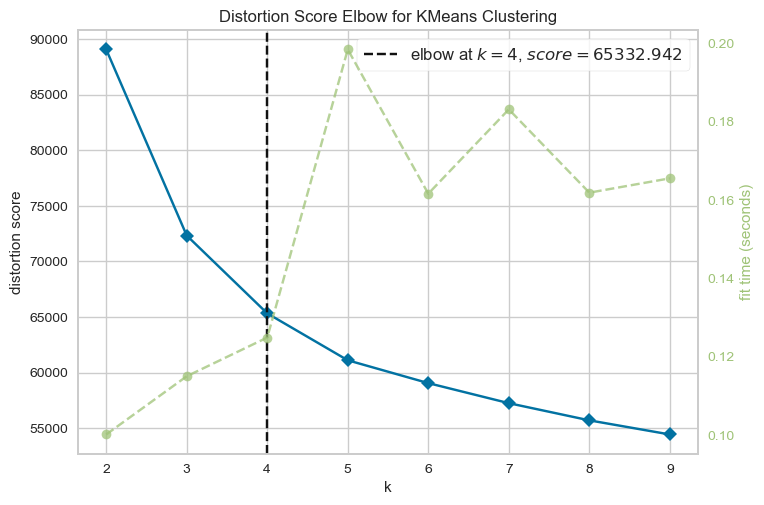

KMeans - Silhouette Score for PCA: 0.1661735805832974
KMeans - Davies-Bouldin Index for PCA: 1.6123647119619642
KMeans - Calinski-Harabasz Index for PCA: 612.7168724639034


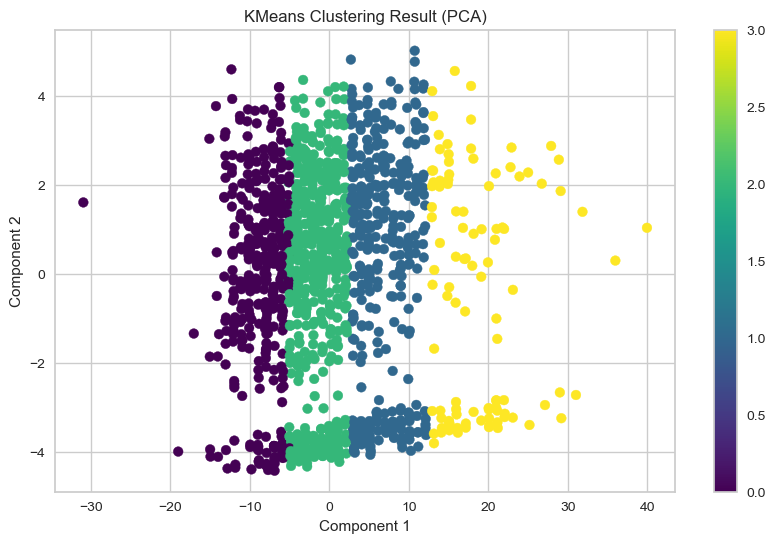

GMM - Silhouette Score for PCA: 0.01578787768384916
GMM - Davies-Bouldin Index for PCA: 3.385621995918887
GMM - Calinski-Harabasz Index for PCA: 60.57245831430859


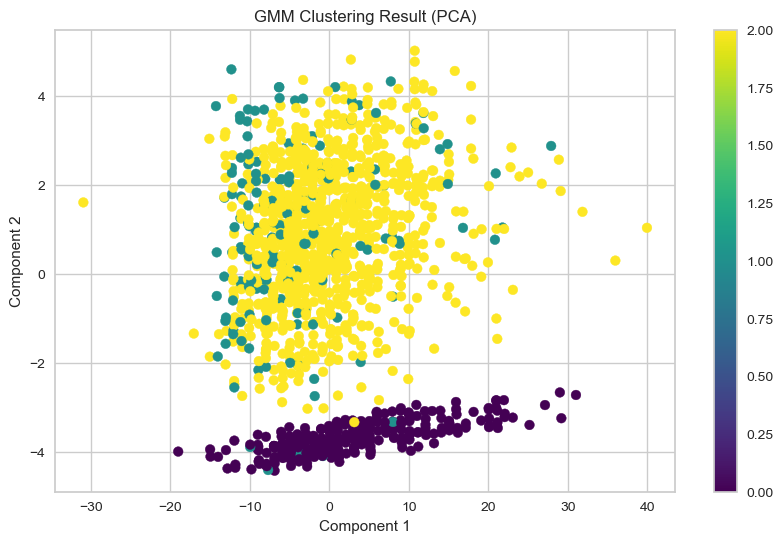

Hierarchical Clustering - Silhouette Score for PCA: 0.1935189488179397
Hierarchical Clustering - Davies-Bouldin Index for PCA: 1.5212491531749273
Hierarchical Clustering - Calinski-Harabasz Index for PCA: 703.2548196564737


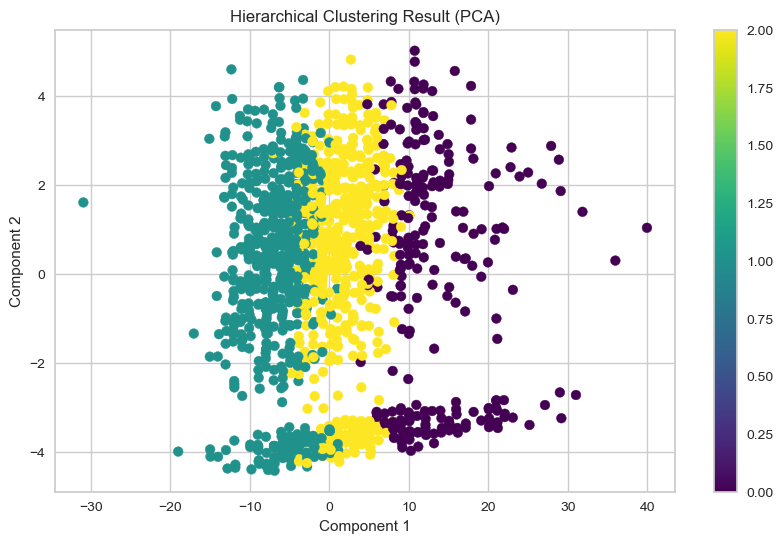

DBSCAN - Insufficient clusters for PCA


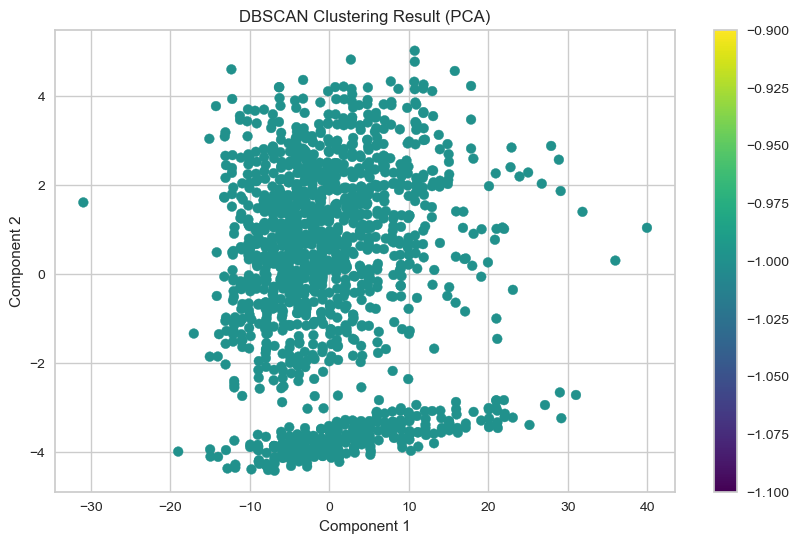

Mean Shift - Silhouette Score for PCA: 0.47624913124766927
Mean Shift - Davies-Bouldin Index for PCA: 0.6784575211068863
Mean Shift - Calinski-Harabasz Index for PCA: 12.37035476451107


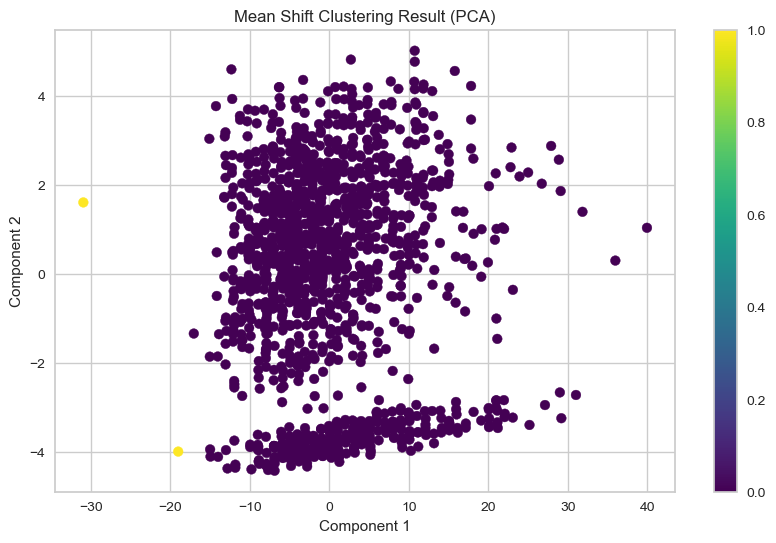

Affinity Propagation - Silhouette Score for PCA: 0.05321937923306808
Affinity Propagation - Davies-Bouldin Index for PCA: 2.2817971372493995
Affinity Propagation - Calinski-Harabasz Index for PCA: 50.79530995847009


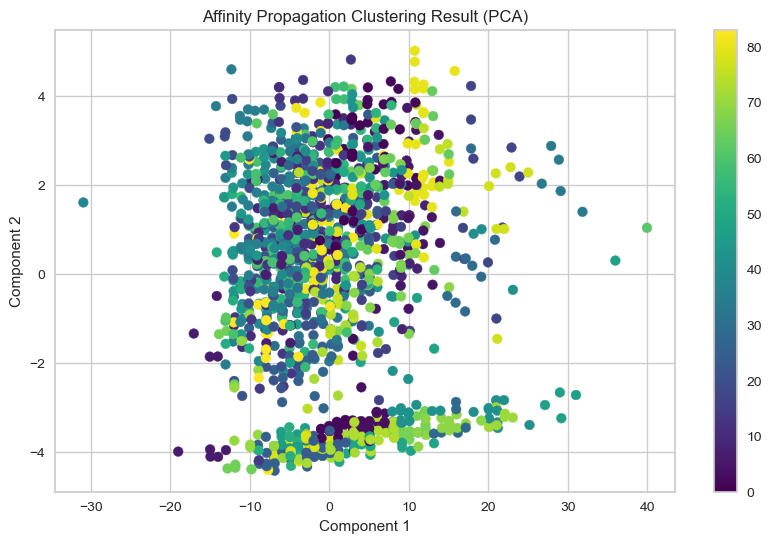

Birch - Silhouette Score for PCA: 0.19628202827903635
Birch - Davies-Bouldin Index for PCA: 1.5007678966112596
Birch - Calinski-Harabasz Index for PCA: 666.0732605572015


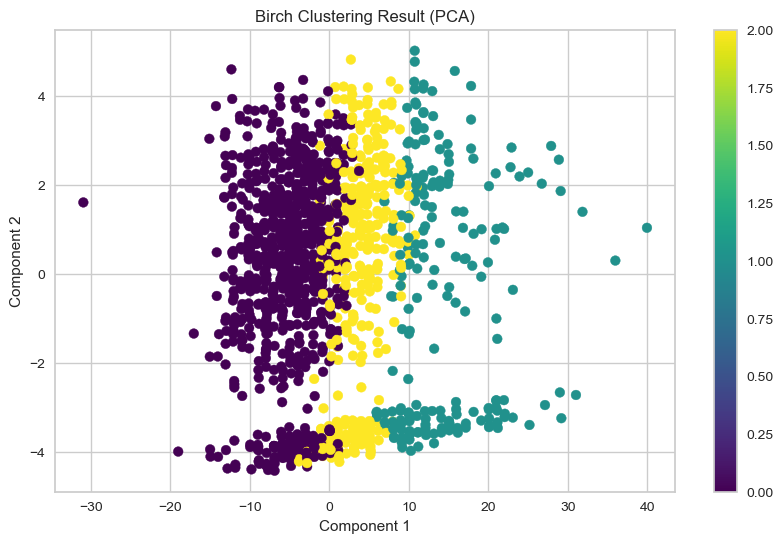

OPTICS - Silhouette Score for PCA: -0.35370984479619616
OPTICS - Davies-Bouldin Index for PCA: 1.8193298550626942
OPTICS - Calinski-Harabasz Index for PCA: 4.995493566321186


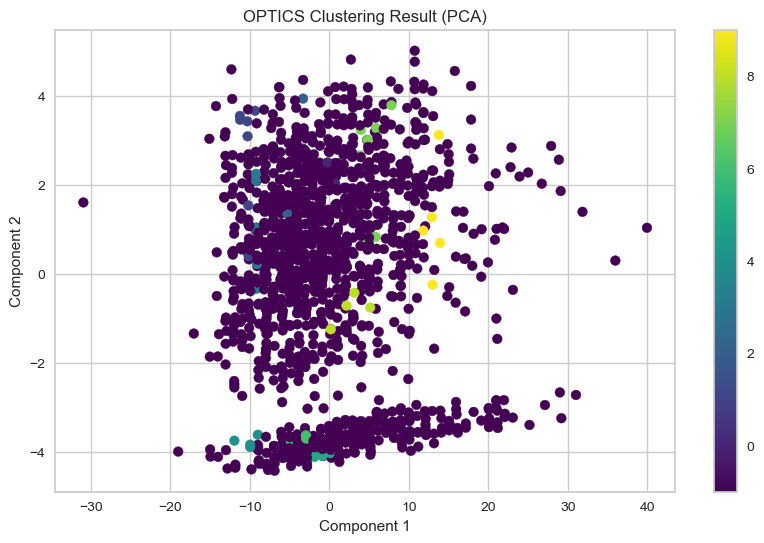

Spectral Clustering - Silhouette Score for PCA: 0.5750201052652257
Spectral Clustering - Davies-Bouldin Index for PCA: 0.2955185193056105
Spectral Clustering - Calinski-Harabasz Index for PCA: 9.696259334792275


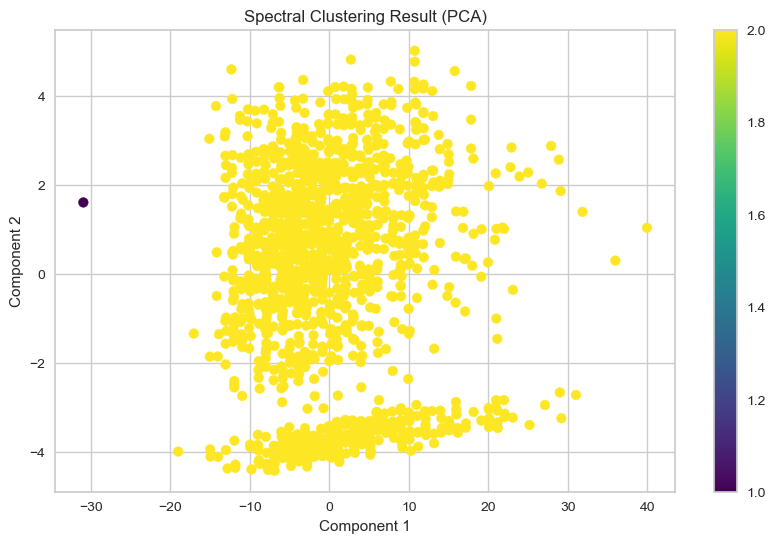

In [26]:
evaluate_clustering(pca_result, 'PCA')


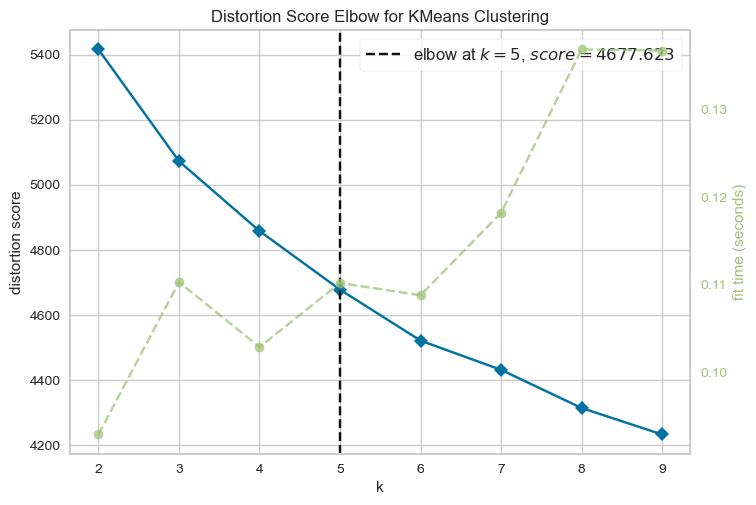

KMeans - Silhouette Score for PCA_MM: 0.09520364672990679
KMeans - Davies-Bouldin Index for PCA_MM: 2.6650000254251864
KMeans - Calinski-Harabasz Index for PCA_MM: 119.36426482252399


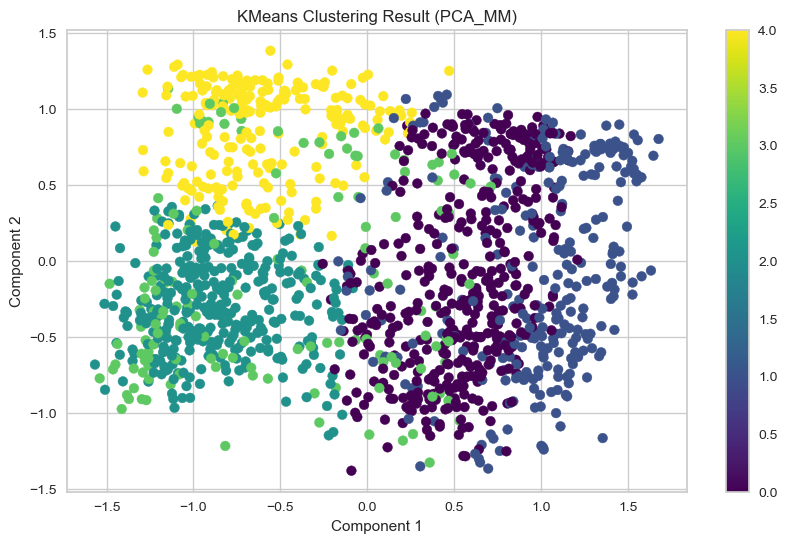

GMM - Silhouette Score for PCA_MM: 0.08172529978382313
GMM - Davies-Bouldin Index for PCA_MM: 2.7755604573138712
GMM - Calinski-Harabasz Index for PCA_MM: 128.2551237250123


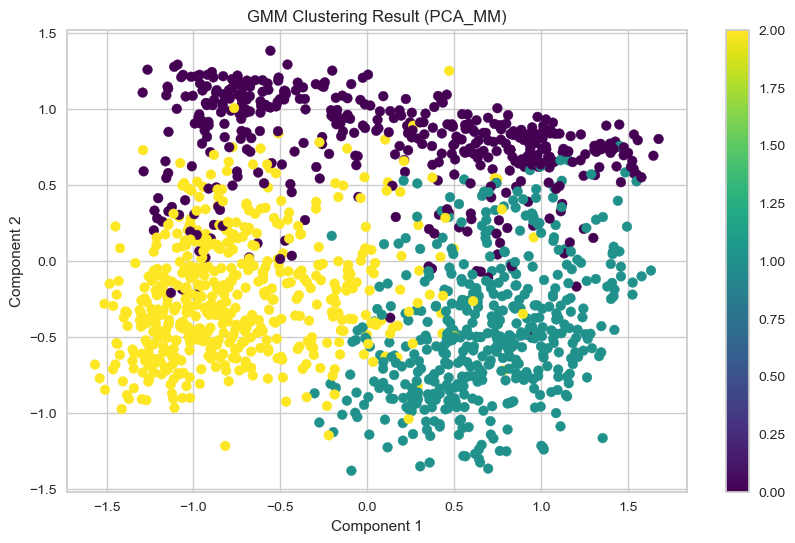

Hierarchical Clustering - Silhouette Score for PCA_MM: 0.06691318029118953
Hierarchical Clustering - Davies-Bouldin Index for PCA_MM: 2.9294761259401034
Hierarchical Clustering - Calinski-Harabasz Index for PCA_MM: 109.77946072341533


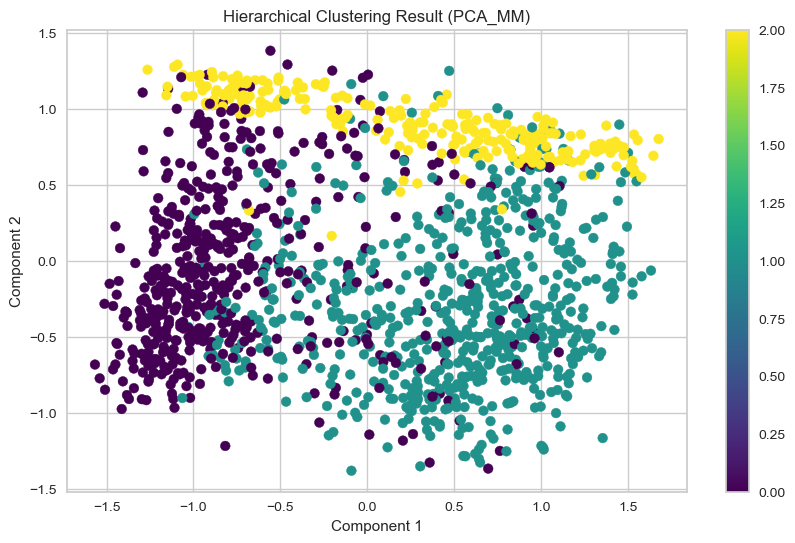

DBSCAN - Insufficient clusters for PCA_MM


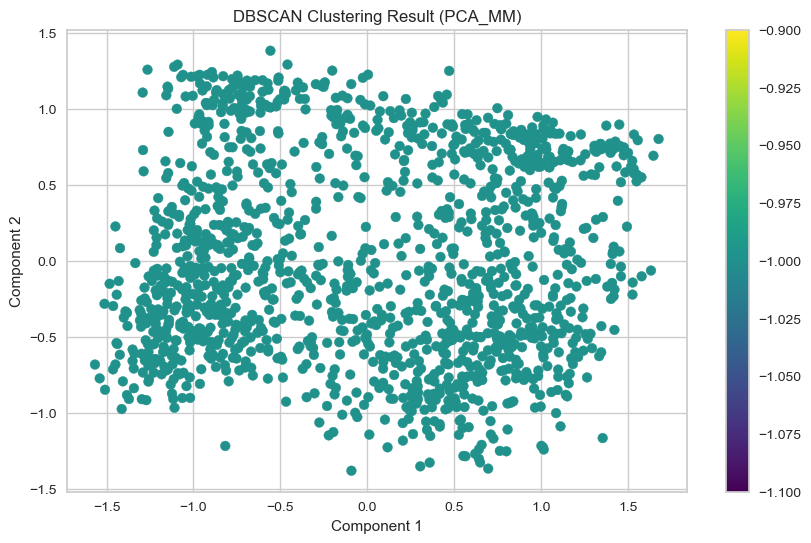

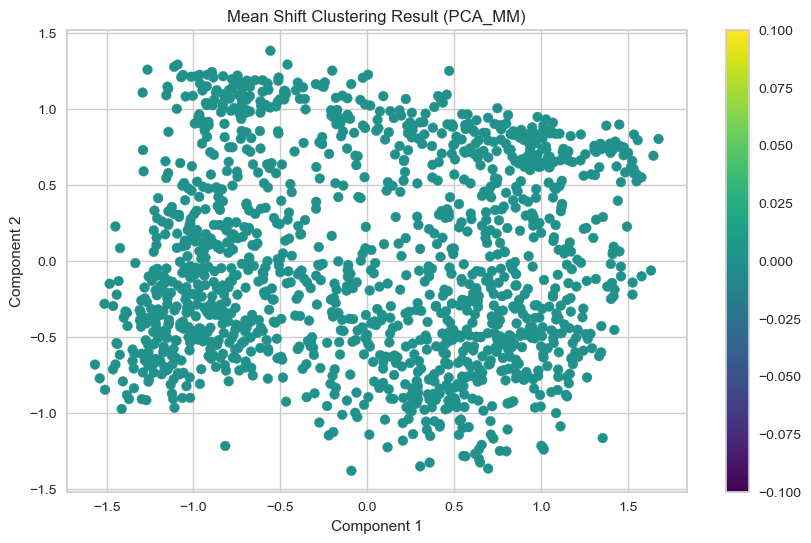

Affinity Propagation - Silhouette Score for PCA_MM: 0.04423640887115687
Affinity Propagation - Davies-Bouldin Index for PCA_MM: 2.5256040203114303
Affinity Propagation - Calinski-Harabasz Index for PCA_MM: 17.0779680778604


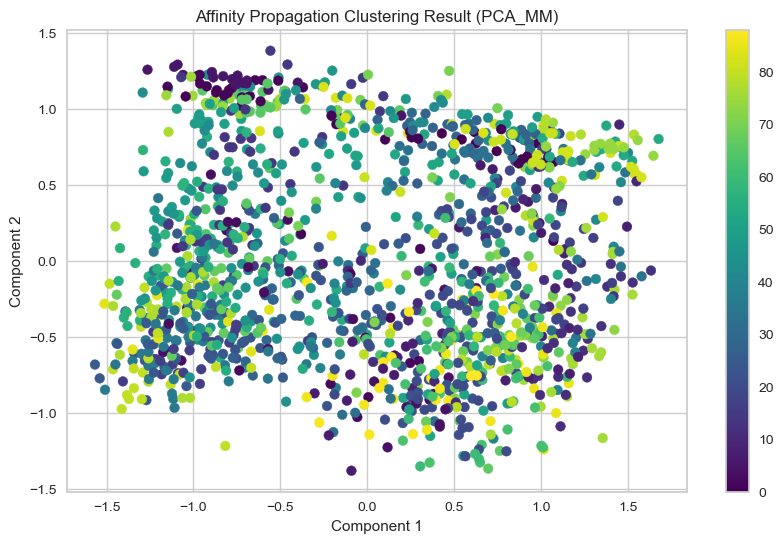

Birch - Silhouette Score for PCA_MM: 0.1087959101341919
Birch - Davies-Bouldin Index for PCA_MM: 2.512199844384915
Birch - Calinski-Harabasz Index for PCA_MM: 136.74766753852023


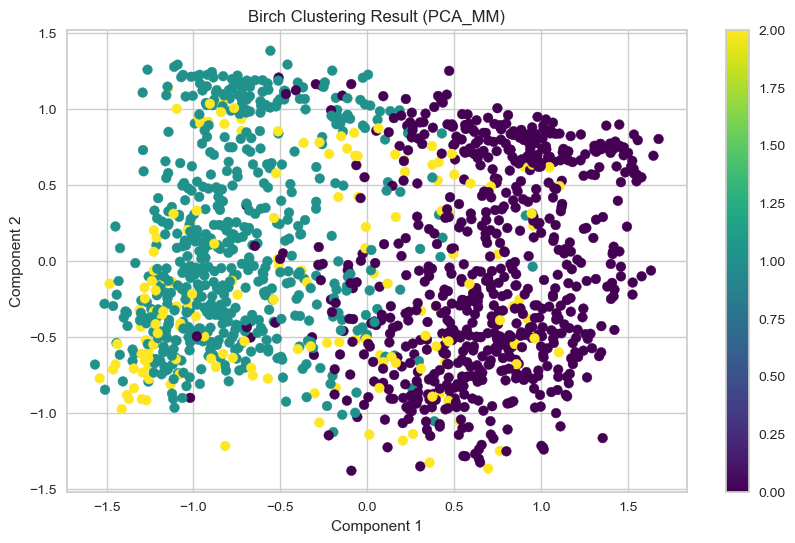

OPTICS - Silhouette Score for PCA_MM: -0.21295450945910133
OPTICS - Davies-Bouldin Index for PCA_MM: 1.5947152146128387
OPTICS - Calinski-Harabasz Index for PCA_MM: 5.758412060645739


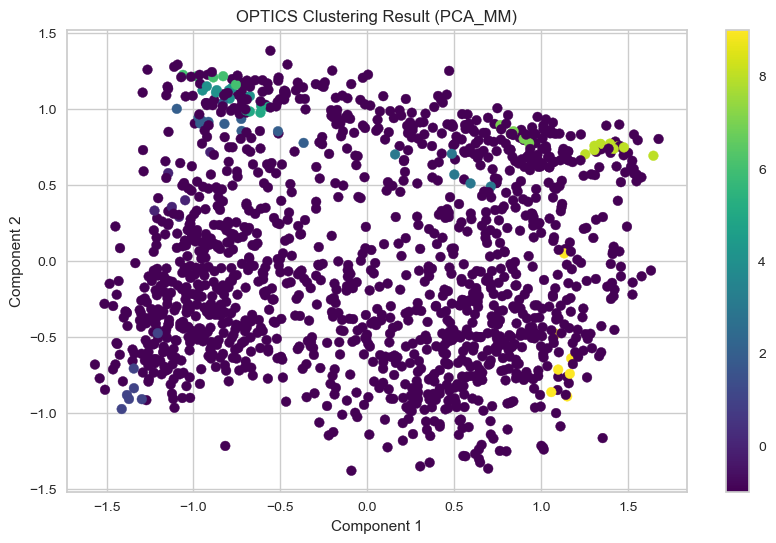

Spectral Clustering - Silhouette Score for PCA_MM: 0.09406410854089971
Spectral Clustering - Davies-Bouldin Index for PCA_MM: 2.418791335842361
Spectral Clustering - Calinski-Harabasz Index for PCA_MM: 116.83143430602104


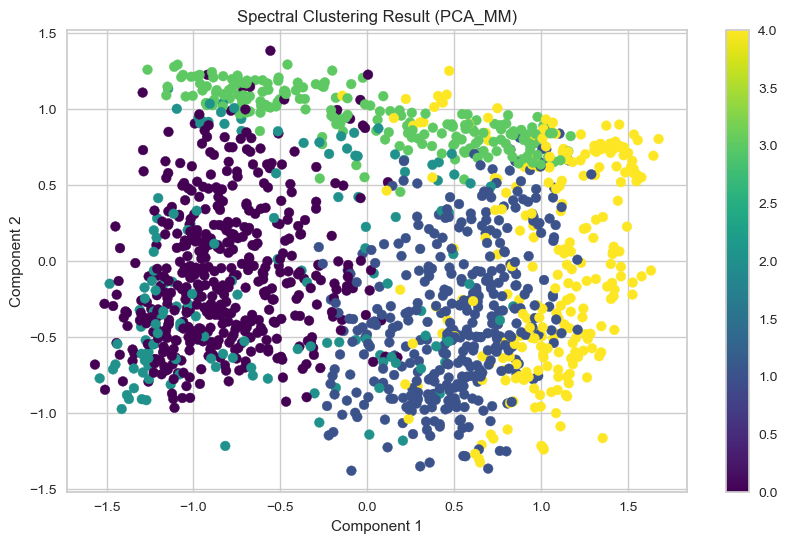

In [29]:
evaluate_clustering(pca_result_MM, 'PCA_MM')

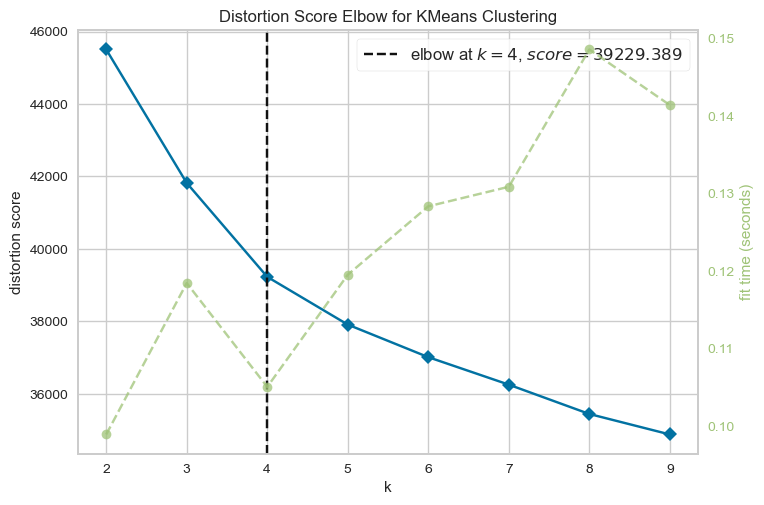

KMeans - Silhouette Score for PCA_S: 0.10620918704084167
KMeans - Davies-Bouldin Index for PCA_S: 2.546142108935122
KMeans - Calinski-Harabasz Index for PCA_S: 132.6615846590914


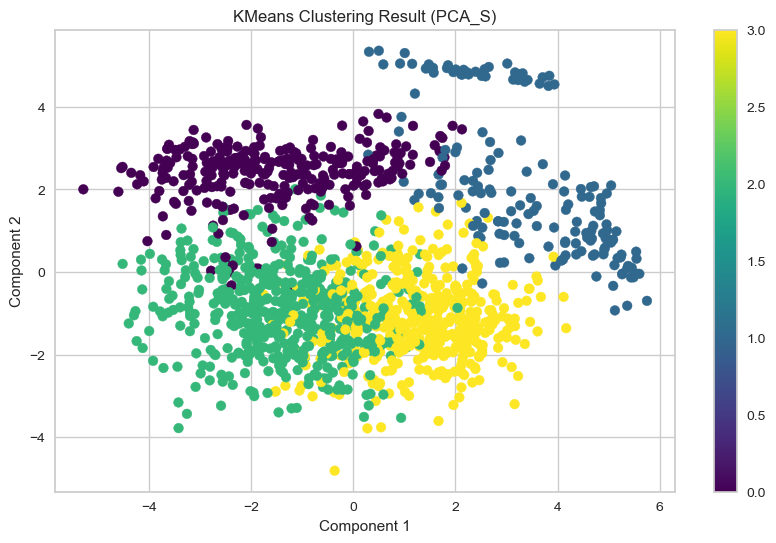

GMM - Silhouette Score for PCA_S: 0.06763665311036159
GMM - Davies-Bouldin Index for PCA_S: 3.3928942170182554
GMM - Calinski-Harabasz Index for PCA_S: 80.32186410897152


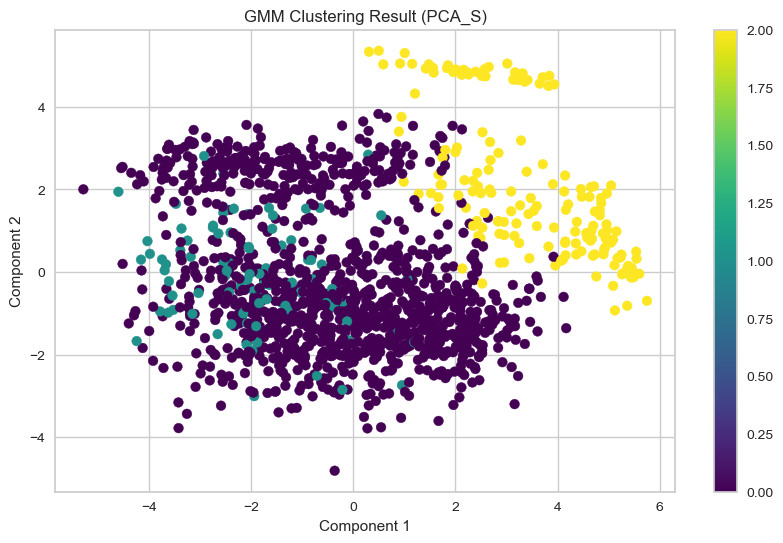

Hierarchical Clustering - Silhouette Score for PCA_S: 0.09300201364977101
Hierarchical Clustering - Davies-Bouldin Index for PCA_S: 2.356118825989029
Hierarchical Clustering - Calinski-Harabasz Index for PCA_S: 127.84743766503374


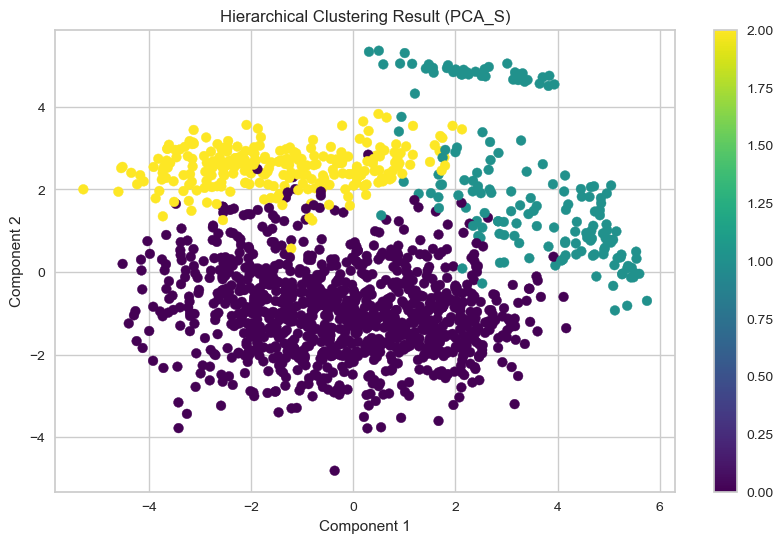

DBSCAN - Insufficient clusters for PCA_S


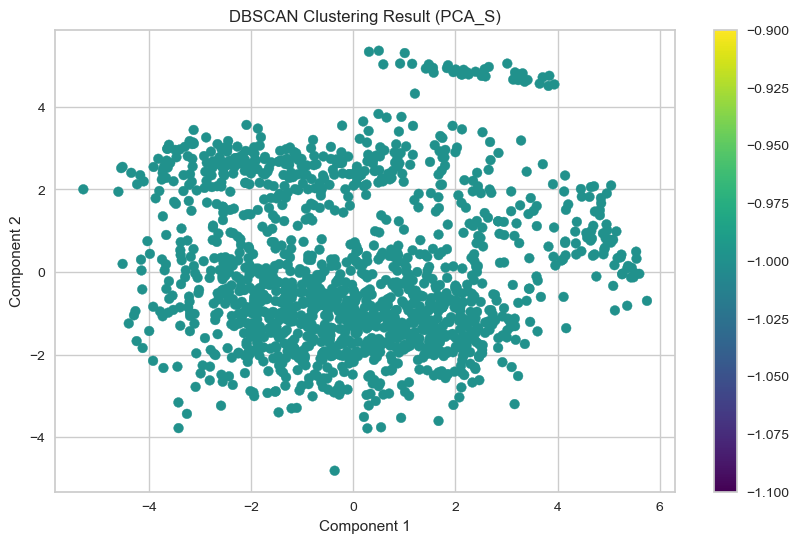

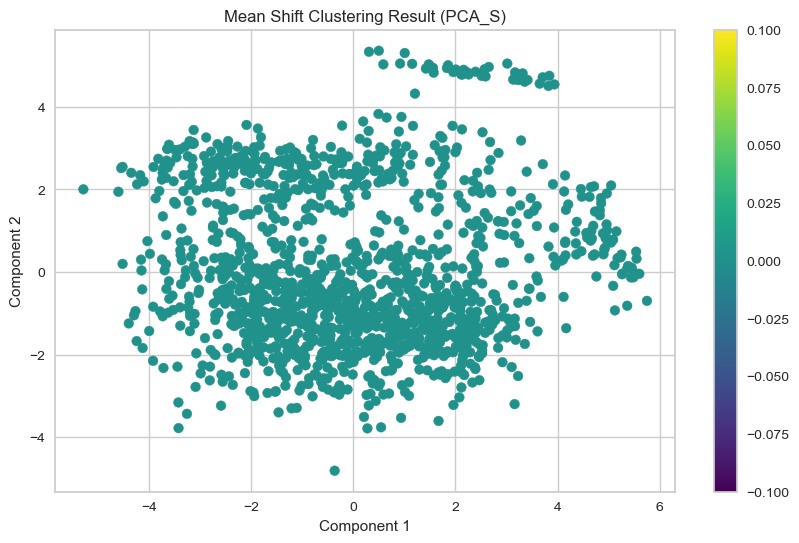

Affinity Propagation - Silhouette Score for PCA_S: 0.03768559806479654
Affinity Propagation - Davies-Bouldin Index for PCA_S: 2.5373068916615575
Affinity Propagation - Calinski-Harabasz Index for PCA_S: 14.681819992791521


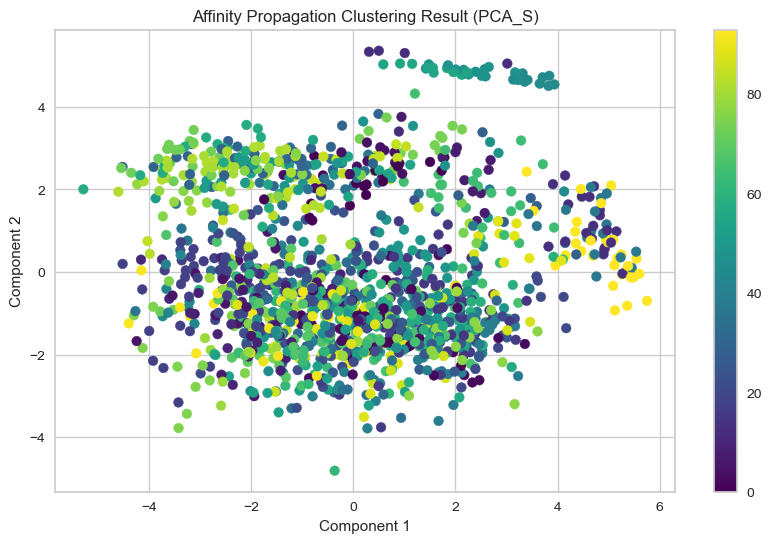

Birch - Silhouette Score for PCA_S: 0.09300201364977101
Birch - Davies-Bouldin Index for PCA_S: 2.356118825989029
Birch - Calinski-Harabasz Index for PCA_S: 127.84743766503374


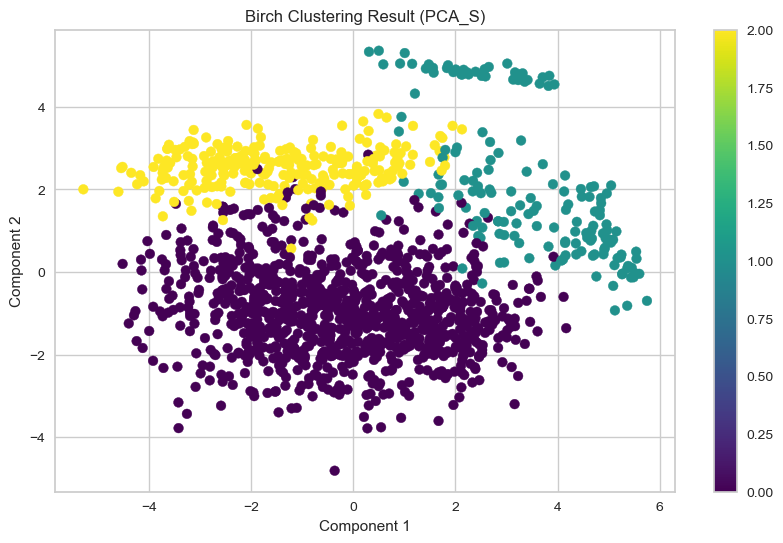

OPTICS - Silhouette Score for PCA_S: -0.20663366203882544
OPTICS - Davies-Bouldin Index for PCA_S: 1.7043176618880156
OPTICS - Calinski-Harabasz Index for PCA_S: 6.146820295116903


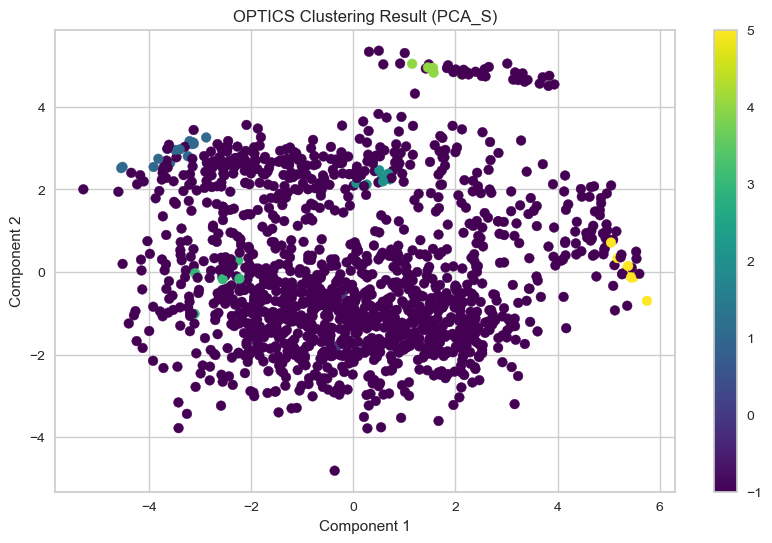

Spectral Clustering - Silhouette Score for PCA_S: 0.12479564114280599
Spectral Clustering - Davies-Bouldin Index for PCA_S: 0.9163430893477
Spectral Clustering - Calinski-Harabasz Index for PCA_S: 2.5125644826417797


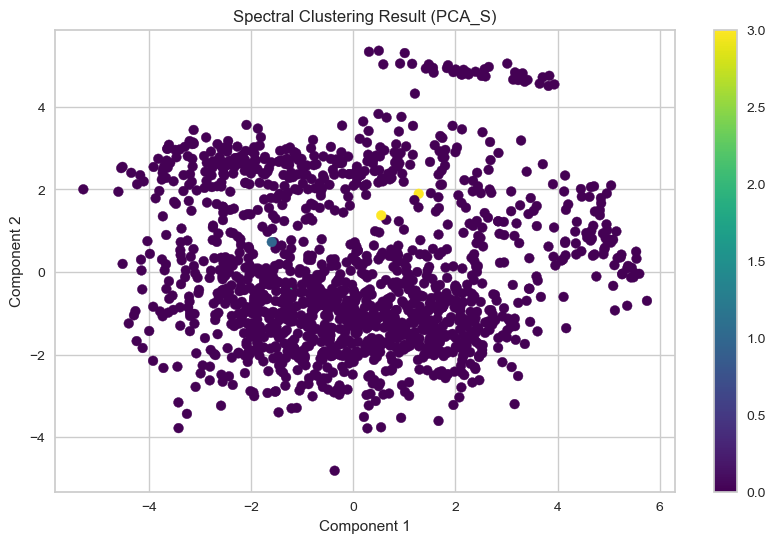

In [34]:
evaluate_clustering(pca_result_S, 'PCA_S')

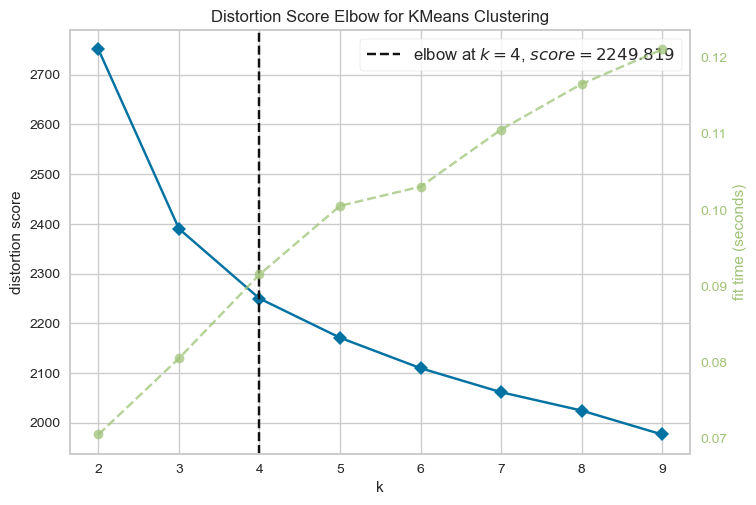

KMeans - Silhouette Score for MCA: 0.13752869009518065
KMeans - Davies-Bouldin Index for MCA: 2.381368025497614
KMeans - Calinski-Harabasz Index for MCA: 203.61986318448456


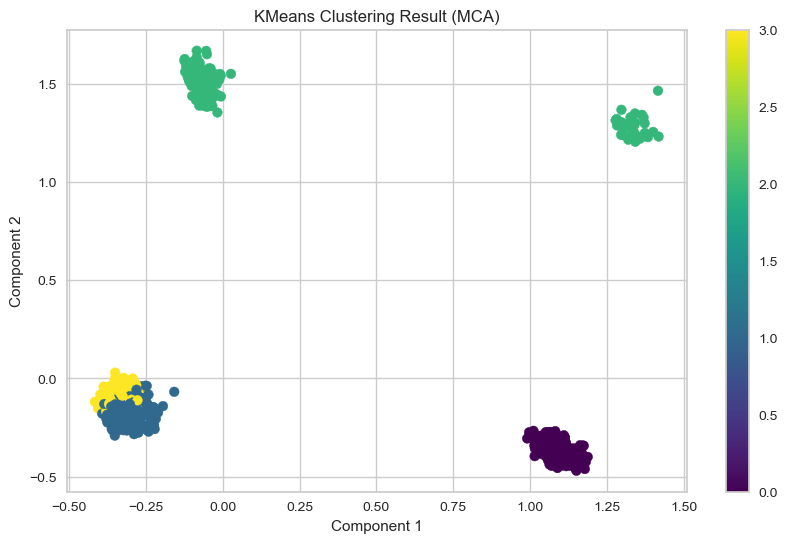

GMM - Silhouette Score for MCA: 0.08200165136769036
GMM - Davies-Bouldin Index for MCA: 4.781230748476911
GMM - Calinski-Harabasz Index for MCA: 117.82635667557321


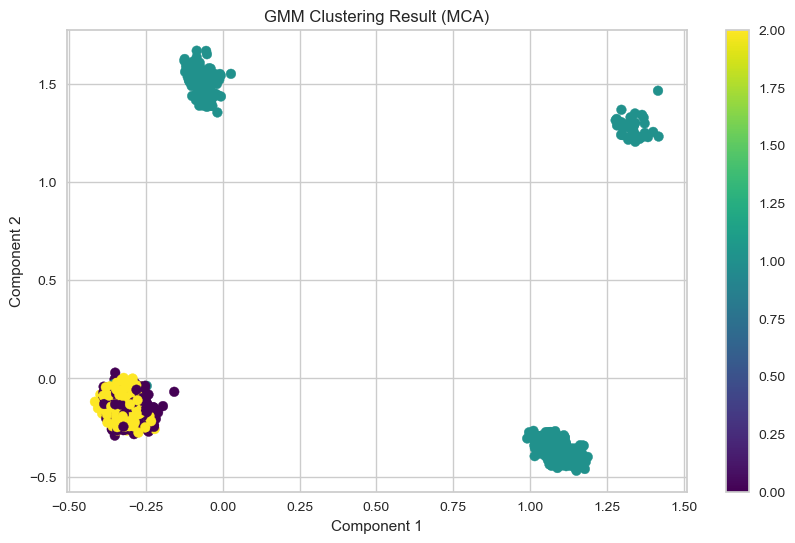

Hierarchical Clustering - Silhouette Score for MCA: 0.20413474579922675
Hierarchical Clustering - Davies-Bouldin Index for MCA: 1.6106122417603972
Hierarchical Clustering - Calinski-Harabasz Index for MCA: 236.02235777970196


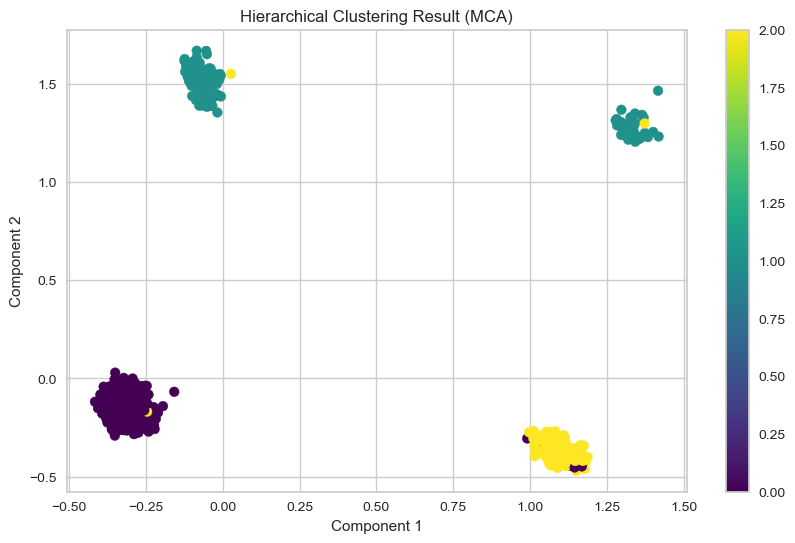

DBSCAN - Insufficient clusters for MCA


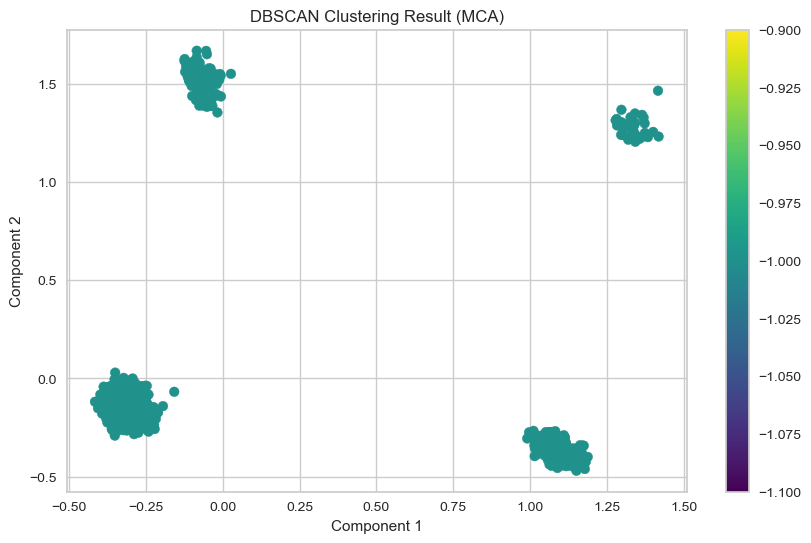

Mean Shift - Silhouette Score for MCA: 0.1962828035198607
Mean Shift - Davies-Bouldin Index for MCA: 0.7278027762095909
Mean Shift - Calinski-Harabasz Index for MCA: 6.117300978820076


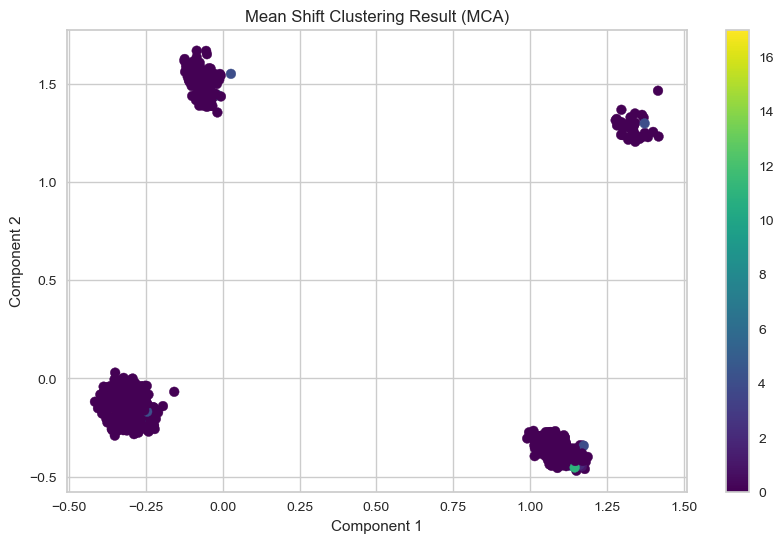

Affinity Propagation - Silhouette Score for MCA: 0.04128715987183249
Affinity Propagation - Davies-Bouldin Index for MCA: 2.13443083081218
Affinity Propagation - Calinski-Harabasz Index for MCA: 20.395331678176607


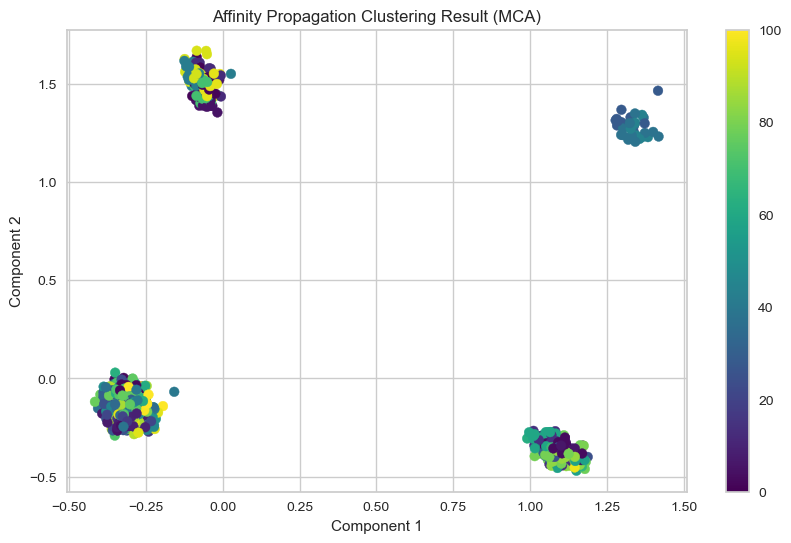

Birch - Silhouette Score for MCA: 0.20405096880557103
Birch - Davies-Bouldin Index for MCA: 1.5986411153238838
Birch - Calinski-Harabasz Index for MCA: 239.39284505004562


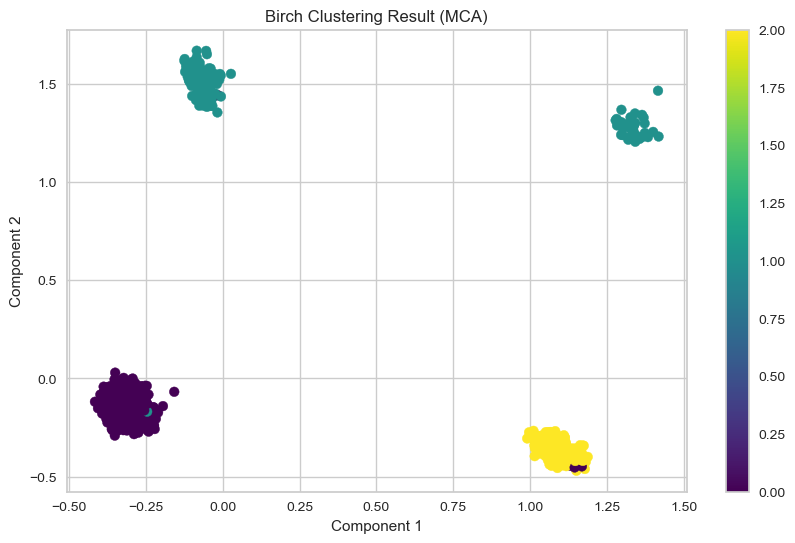

OPTICS - Silhouette Score for MCA: -0.22090050934350736
OPTICS - Davies-Bouldin Index for MCA: 1.5334771152948894
OPTICS - Calinski-Harabasz Index for MCA: 8.76709491741563


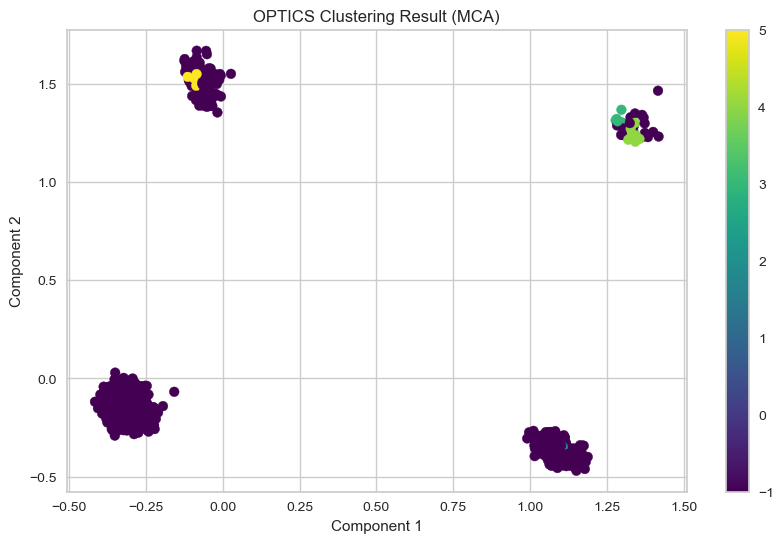

Spectral Clustering - Silhouette Score for MCA: 0.20957530450000655
Spectral Clustering - Davies-Bouldin Index for MCA: 1.5304696825370767
Spectral Clustering - Calinski-Harabasz Index for MCA: 180.61021449365626


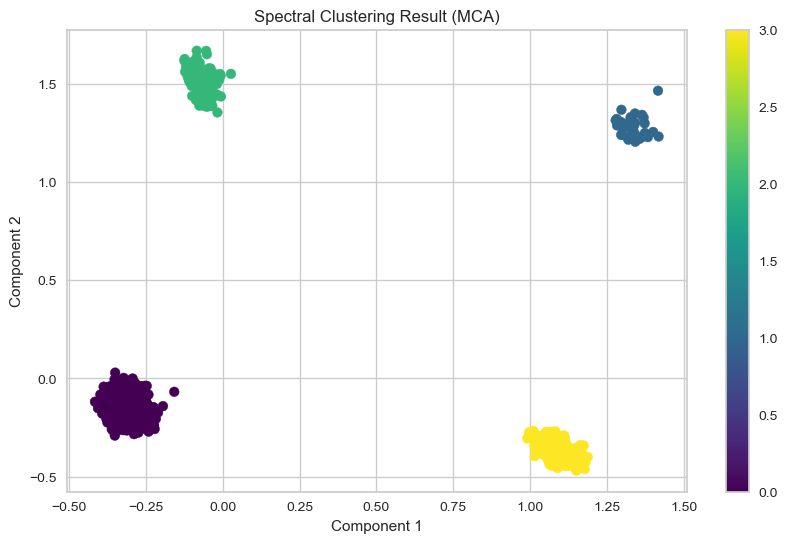

In [37]:
if isinstance(mca_result, pd.DataFrame):
    mca_result = mca_result.values

evaluate_clustering(mca_result, 'MCA')

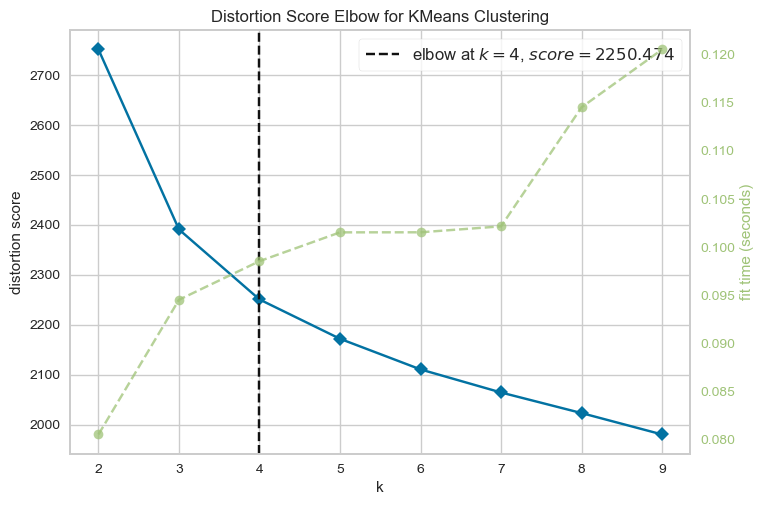

KMeans - Silhouette Score for MCA_MM: 0.1372325960168576
KMeans - Davies-Bouldin Index for MCA_MM: 2.3851087580688084
KMeans - Calinski-Harabasz Index for MCA_MM: 203.5470219713426


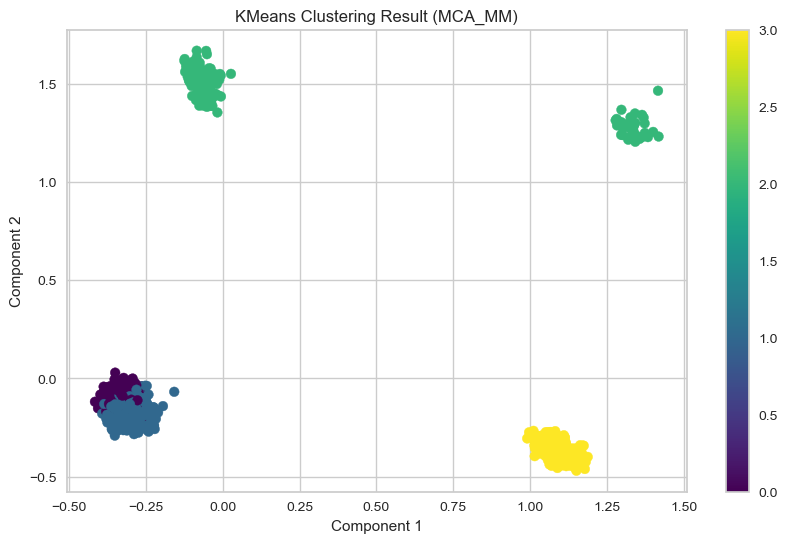

GMM - Silhouette Score for MCA_MM: 0.08246923274449369
GMM - Davies-Bouldin Index for MCA_MM: 4.685627549412243
GMM - Calinski-Harabasz Index for MCA_MM: 118.9480898458361


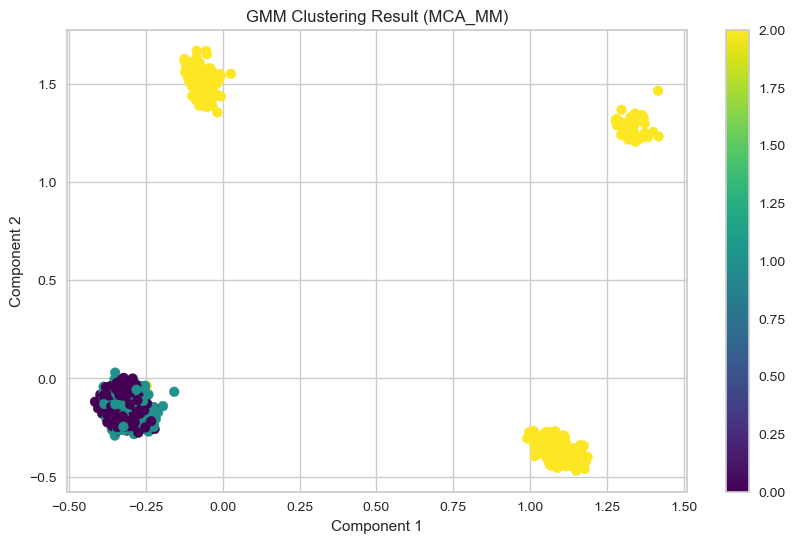

Hierarchical Clustering - Silhouette Score for MCA_MM: 0.20191125579272703
Hierarchical Clustering - Davies-Bouldin Index for MCA_MM: 1.6019709780627969
Hierarchical Clustering - Calinski-Harabasz Index for MCA_MM: 238.215745202413


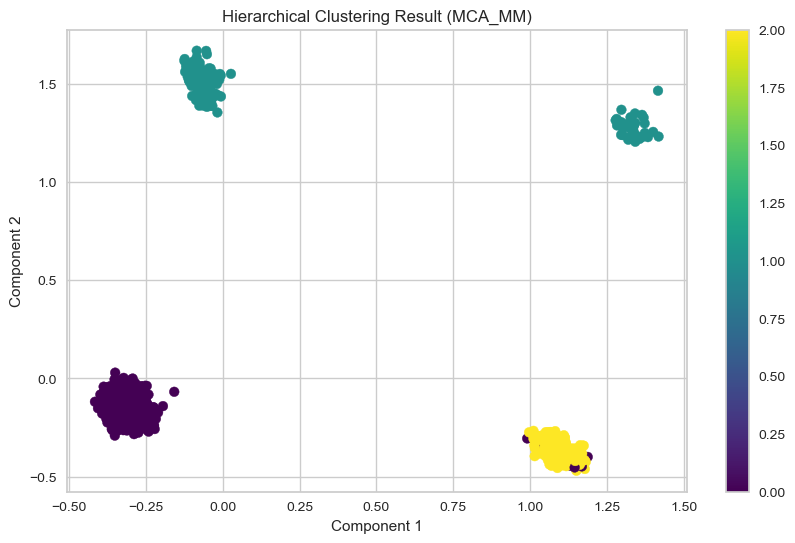

DBSCAN - Insufficient clusters for MCA_MM


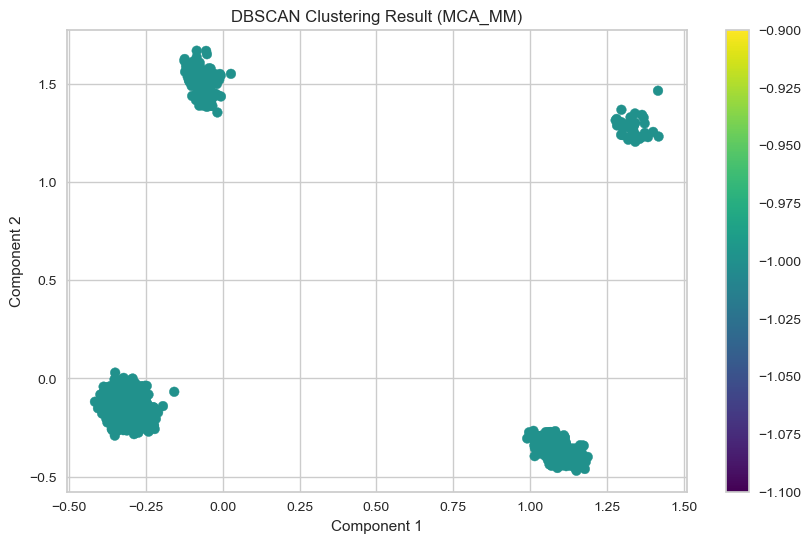

Mean Shift - Silhouette Score for MCA_MM: 0.22569911465434814
Mean Shift - Davies-Bouldin Index for MCA_MM: 0.576016291326695
Mean Shift - Calinski-Harabasz Index for MCA_MM: 5.966835342104823


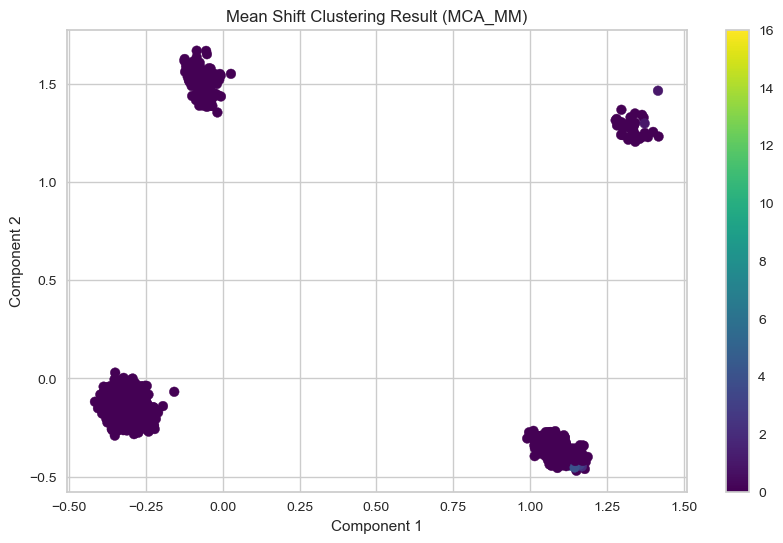

Affinity Propagation - Silhouette Score for MCA_MM: 0.037456747111359254
Affinity Propagation - Davies-Bouldin Index for MCA_MM: 2.1821296852058243
Affinity Propagation - Calinski-Harabasz Index for MCA_MM: 20.551859890233008


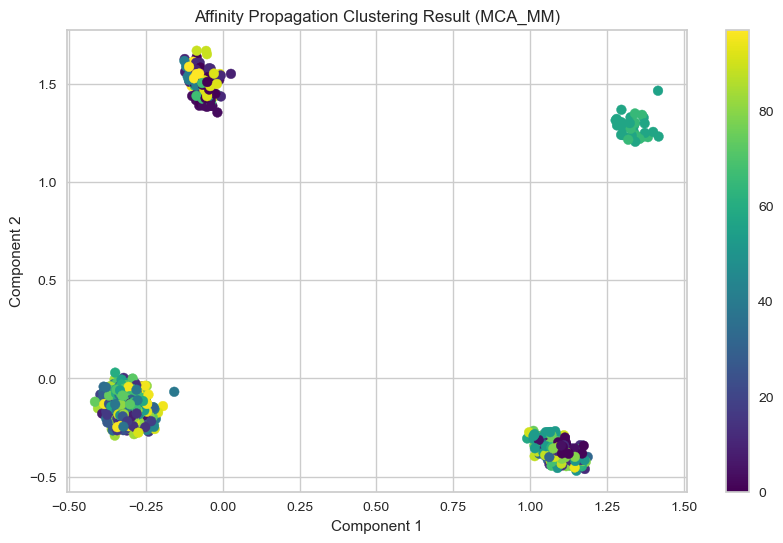

Birch - Silhouette Score for MCA_MM: 0.20018874695879108
Birch - Davies-Bouldin Index for MCA_MM: 1.6027674438995085
Birch - Calinski-Harabasz Index for MCA_MM: 233.389488160395


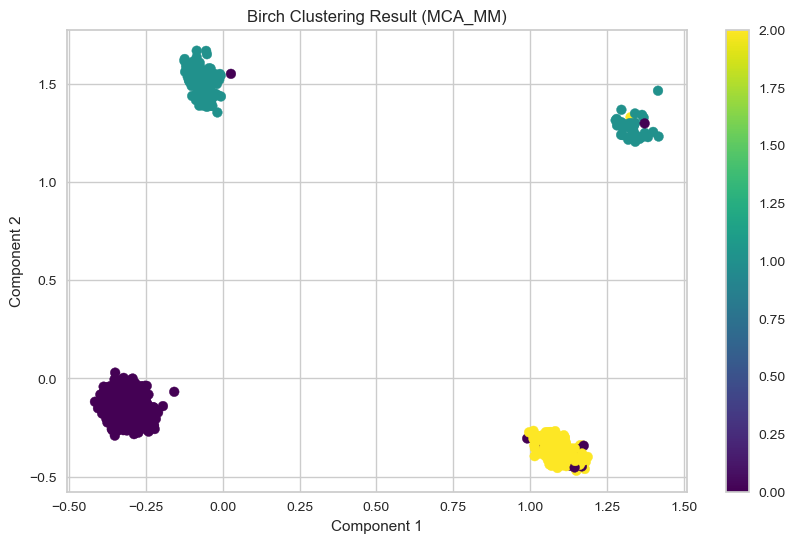

OPTICS - Silhouette Score for MCA_MM: 0.06384096258616655
OPTICS - Davies-Bouldin Index for MCA_MM: 1.2428773583719717
OPTICS - Calinski-Harabasz Index for MCA_MM: 11.091612499414516


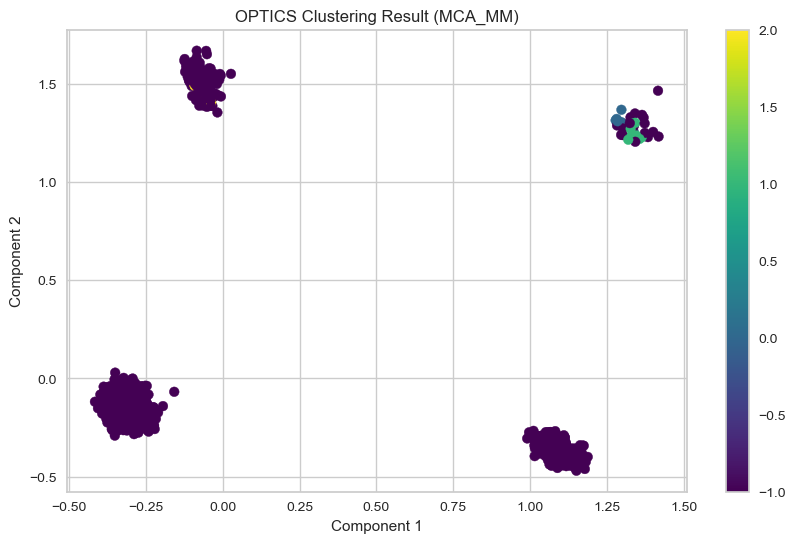

Spectral Clustering - Silhouette Score for MCA_MM: 0.20944759690768075
Spectral Clustering - Davies-Bouldin Index for MCA_MM: 1.5341031177506037
Spectral Clustering - Calinski-Harabasz Index for MCA_MM: 180.57304424704984


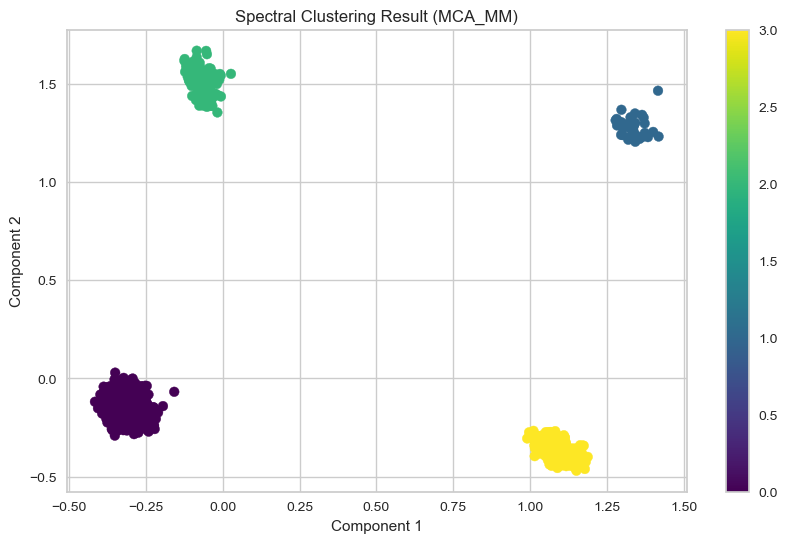

In [38]:
if isinstance(mca_result_MM, pd.DataFrame):
    mca_result_MM = mca_result_MM.values

evaluate_clustering(mca_result_MM, 'MCA_MM')

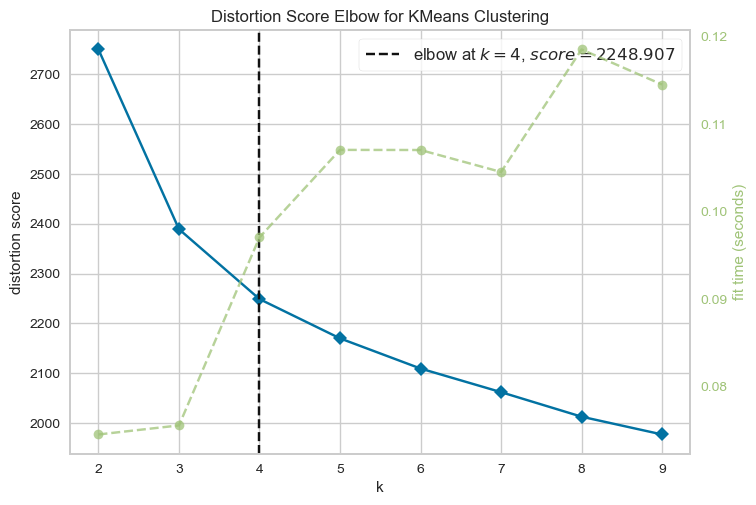

KMeans - Silhouette Score for MCA_S: 0.137441600850464
KMeans - Davies-Bouldin Index for MCA_S: 2.3850089593037467
KMeans - Calinski-Harabasz Index for MCA_S: 203.67923767352144


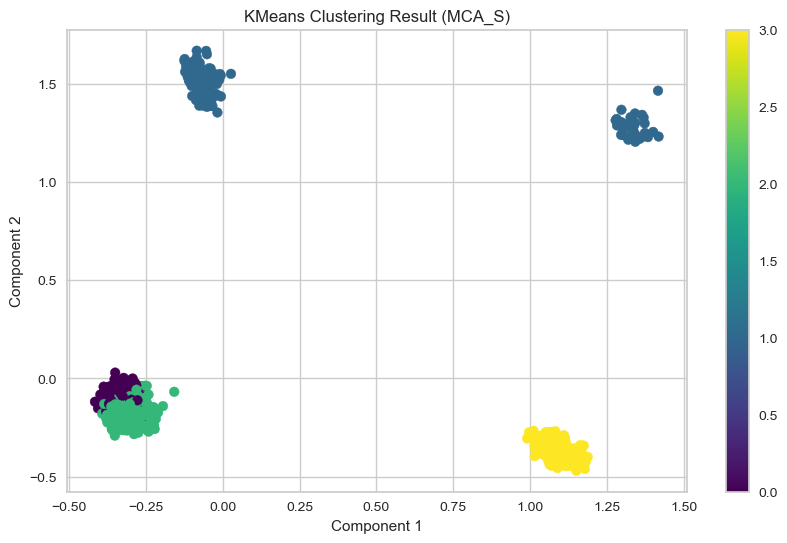

GMM - Silhouette Score for MCA_S: 0.18162315227694173
GMM - Davies-Bouldin Index for MCA_S: 2.0482872789702413
GMM - Calinski-Harabasz Index for MCA_S: 109.88747671460722


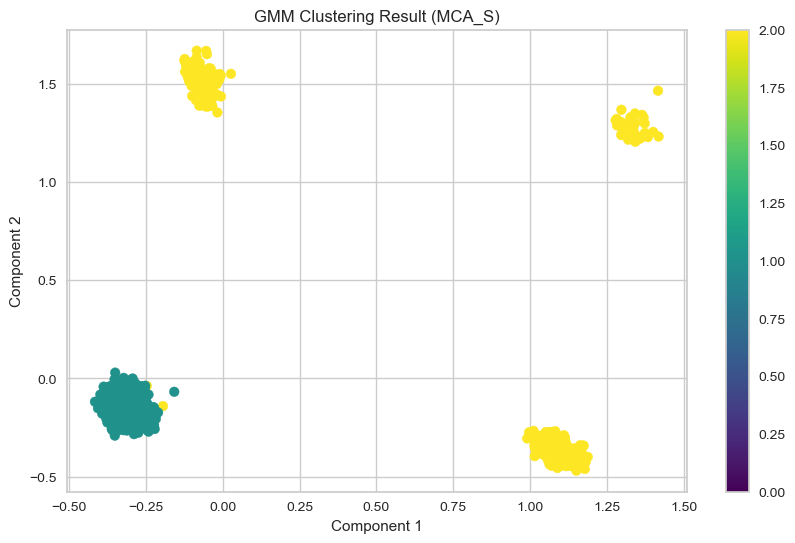

Hierarchical Clustering - Silhouette Score for MCA_S: 0.2051239072743607
Hierarchical Clustering - Davies-Bouldin Index for MCA_S: 1.602983577108919
Hierarchical Clustering - Calinski-Harabasz Index for MCA_S: 238.2166282998179


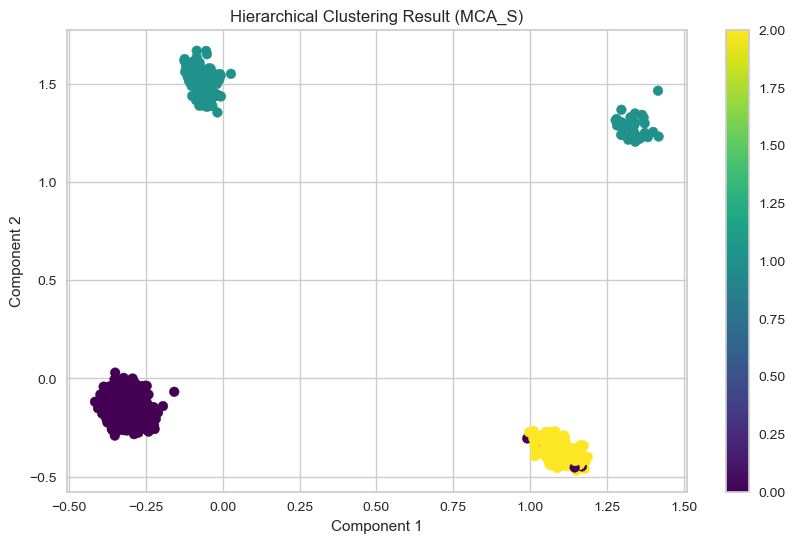

DBSCAN - Insufficient clusters for MCA_S


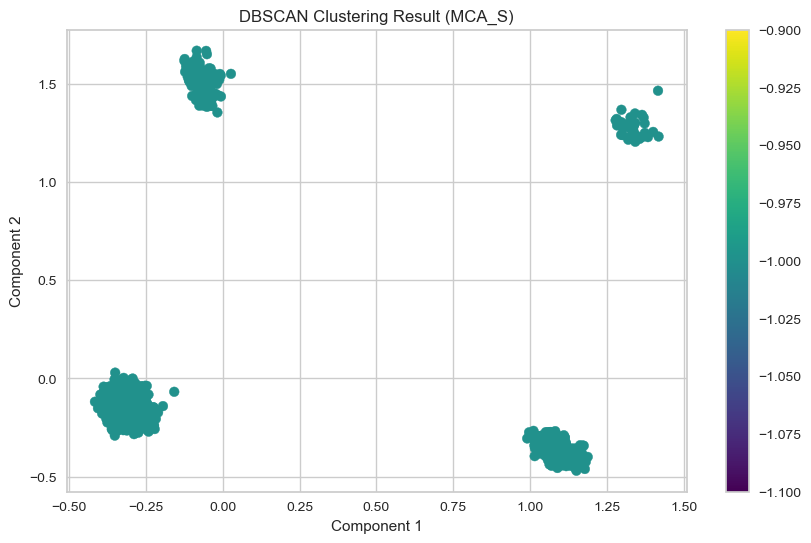

Mean Shift - Silhouette Score for MCA_S: 0.19165920227759747
Mean Shift - Davies-Bouldin Index for MCA_S: 0.6080424162464562
Mean Shift - Calinski-Harabasz Index for MCA_S: 5.3261803819733595


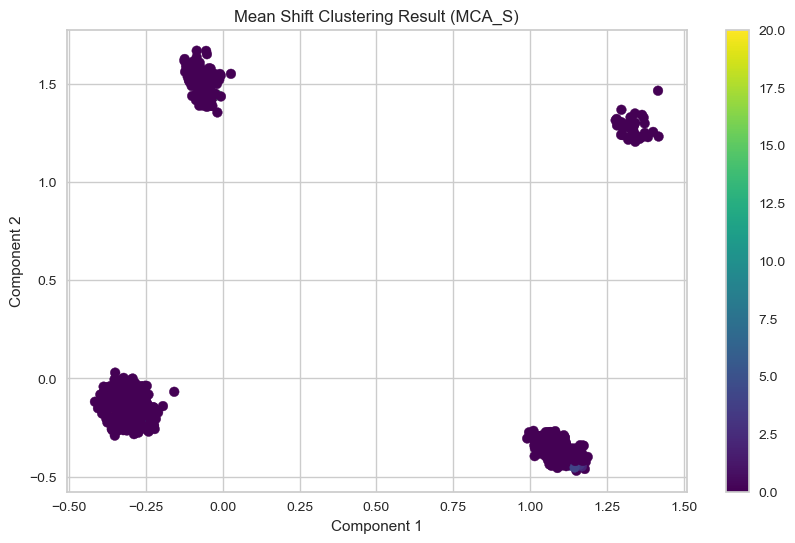

Affinity Propagation - Silhouette Score for MCA_S: 0.044359470219379395
Affinity Propagation - Davies-Bouldin Index for MCA_S: 2.0547894397654427
Affinity Propagation - Calinski-Harabasz Index for MCA_S: 20.446991060581396


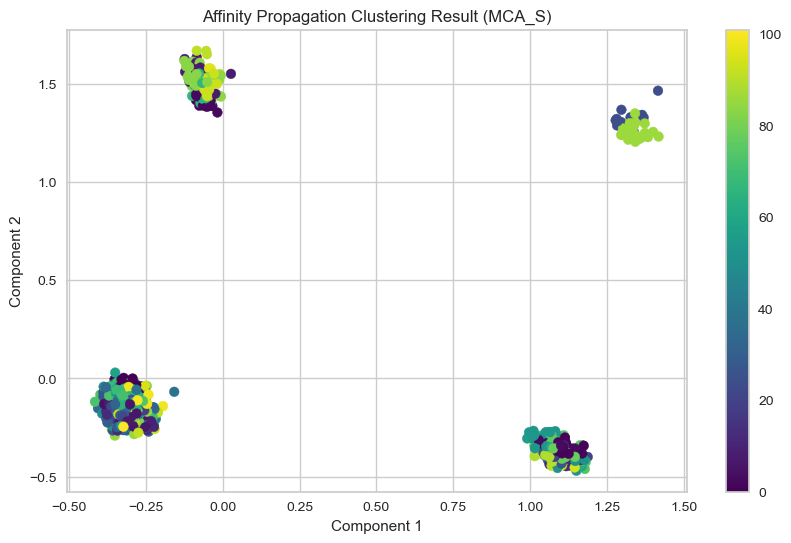

Birch - Silhouette Score for MCA_S: 0.2027885687728039
Birch - Davies-Bouldin Index for MCA_S: 1.6046870986781883
Birch - Calinski-Harabasz Index for MCA_S: 235.86084023130343


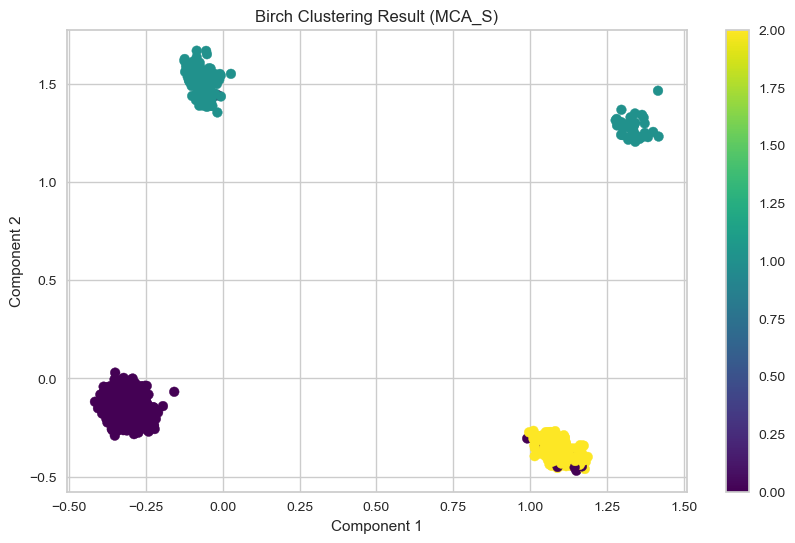

OPTICS - Silhouette Score for MCA_S: -0.09757196433394975
OPTICS - Davies-Bouldin Index for MCA_S: 1.6035034074917498
OPTICS - Calinski-Harabasz Index for MCA_S: 43.76342275262175


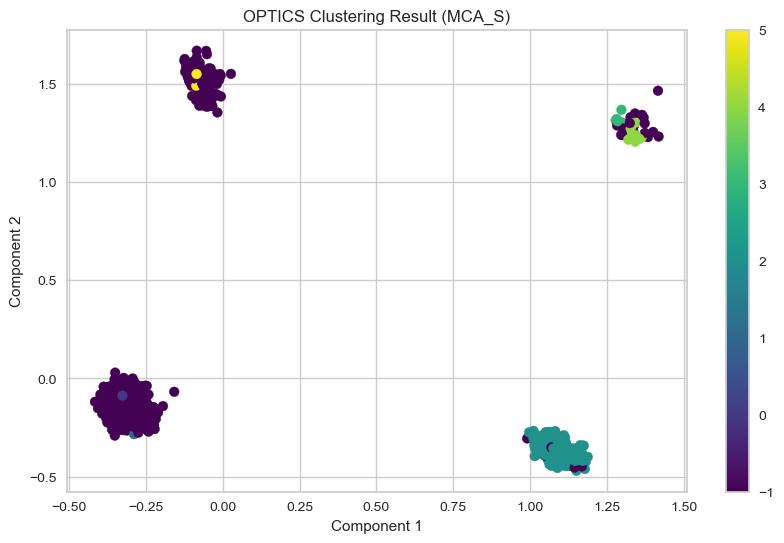

Spectral Clustering - Silhouette Score for MCA_S: 0.209168855081201
Spectral Clustering - Davies-Bouldin Index for MCA_S: 1.5298074699224928
Spectral Clustering - Calinski-Harabasz Index for MCA_S: 180.5907446966424


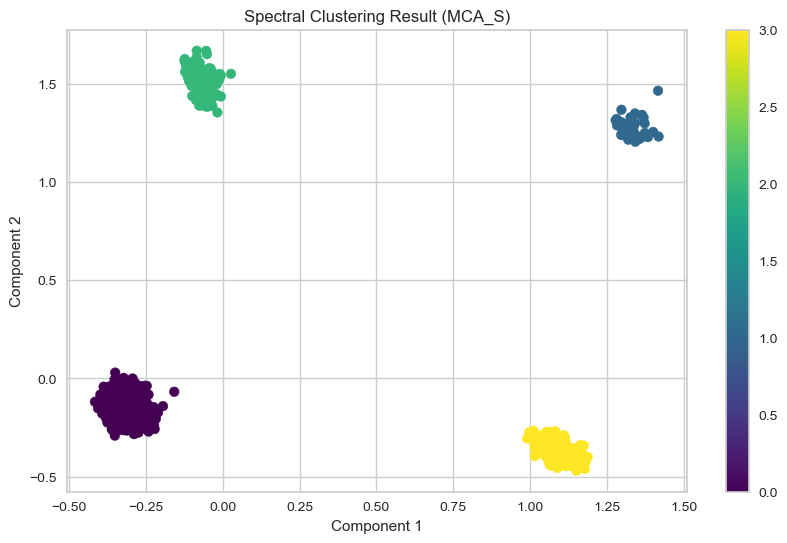

In [39]:
if isinstance(mca_result_S, pd.DataFrame):
    mca_result_S = mca_result_S.values

evaluate_clustering(mca_result_S, 'MCA_S')

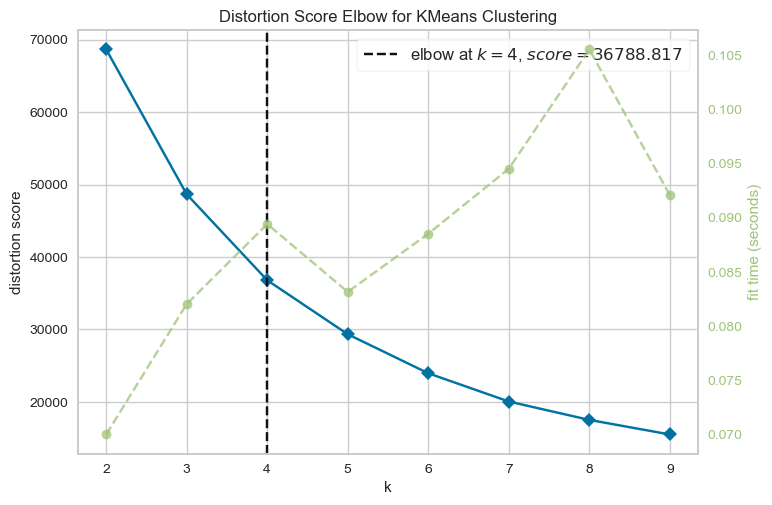

KMeans - Silhouette Score for MDS: 0.3849695321615497
KMeans - Davies-Bouldin Index for MDS: 0.8378101276402397
KMeans - Calinski-Harabasz Index for MDS: 1389.9496755677353


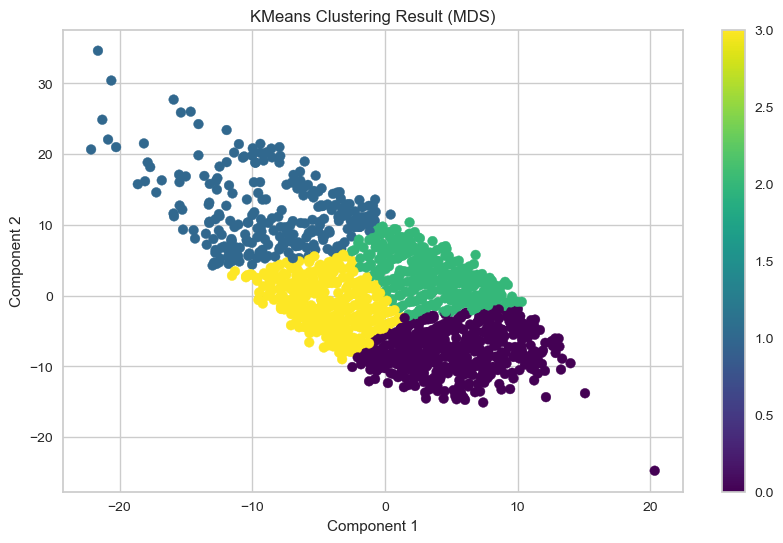

GMM - Silhouette Score for MDS: 0.3648728104571339
GMM - Davies-Bouldin Index for MDS: 0.9626565512611996
GMM - Calinski-Harabasz Index for MDS: 1378.7696746843621


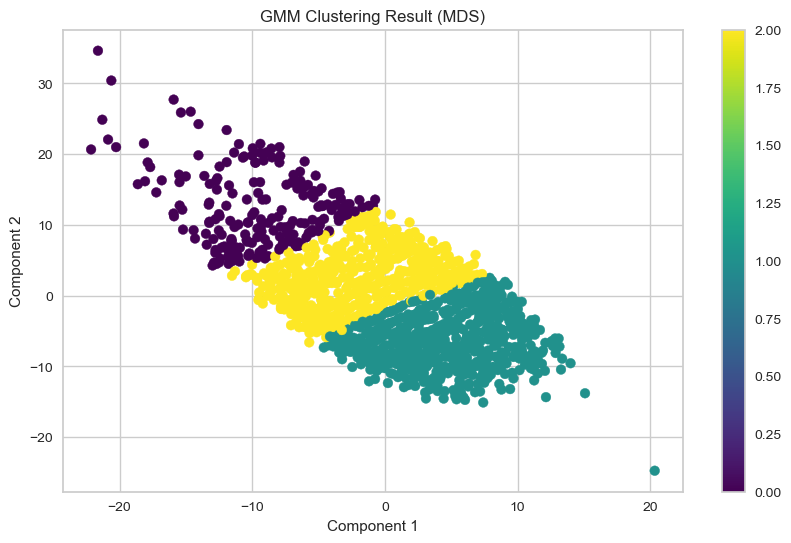

Hierarchical Clustering - Silhouette Score for MDS: 0.2502928945561336
Hierarchical Clustering - Davies-Bouldin Index for MDS: 1.0941316323799548
Hierarchical Clustering - Calinski-Harabasz Index for MDS: 1055.0874054514306


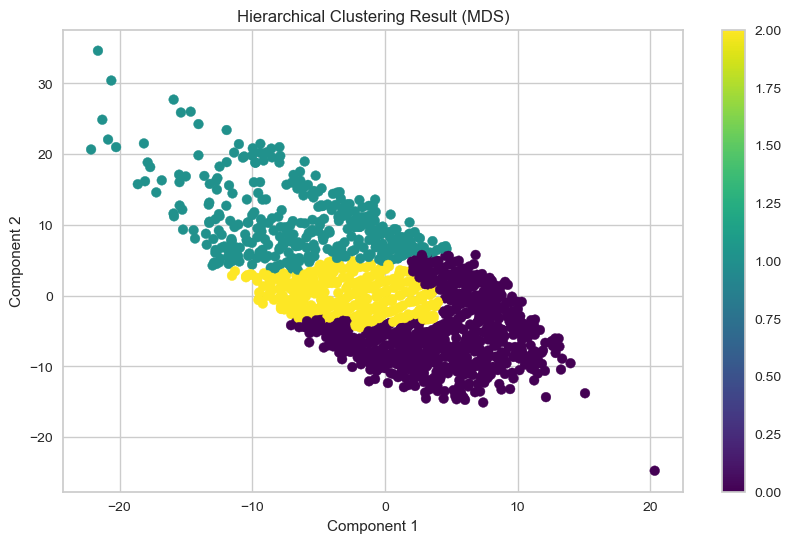

DBSCAN - Silhouette Score for MDS: -0.20019450503836914
DBSCAN - Davies-Bouldin Index for MDS: 2.9959832003630447
DBSCAN - Calinski-Harabasz Index for MDS: 5.911467227685965


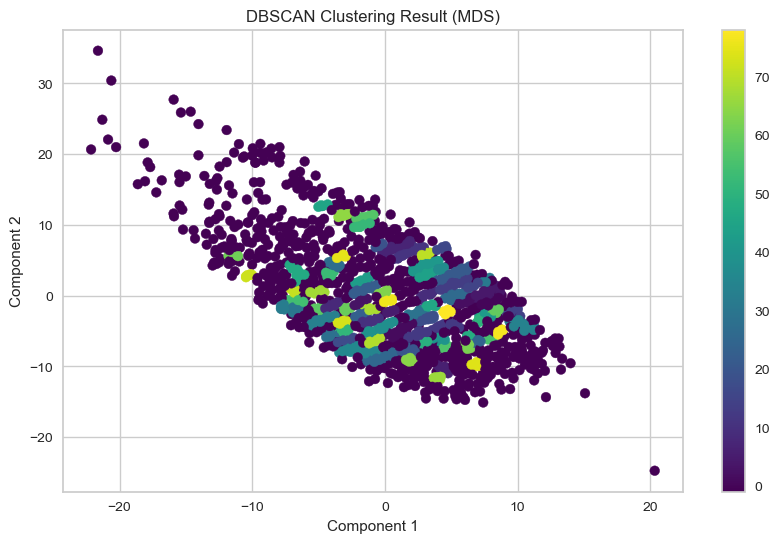

Mean Shift - Silhouette Score for MDS: 0.4444497706504601
Mean Shift - Davies-Bouldin Index for MDS: 0.61146358650726
Mean Shift - Calinski-Harabasz Index for MDS: 16.99337061474678


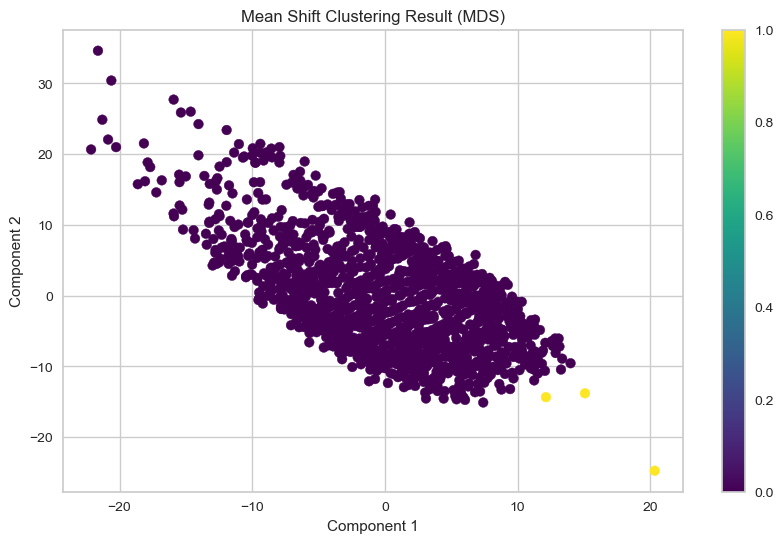

Affinity Propagation - Silhouette Score for MDS: 0.3276733739038798
Affinity Propagation - Davies-Bouldin Index for MDS: 0.7938280535247271
Affinity Propagation - Calinski-Harabasz Index for MDS: 1443.7164611847118


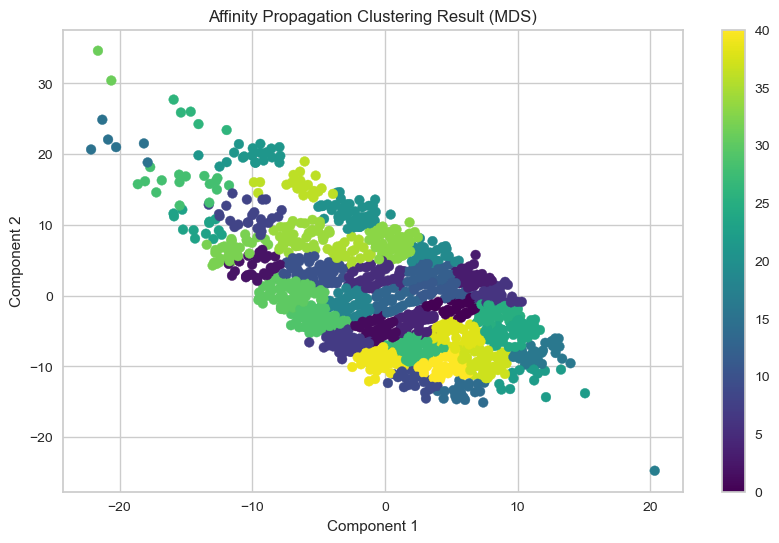

Birch - Silhouette Score for MDS: 0.34635014879980386
Birch - Davies-Bouldin Index for MDS: 0.8433555014613355
Birch - Calinski-Harabasz Index for MDS: 1062.581733994195


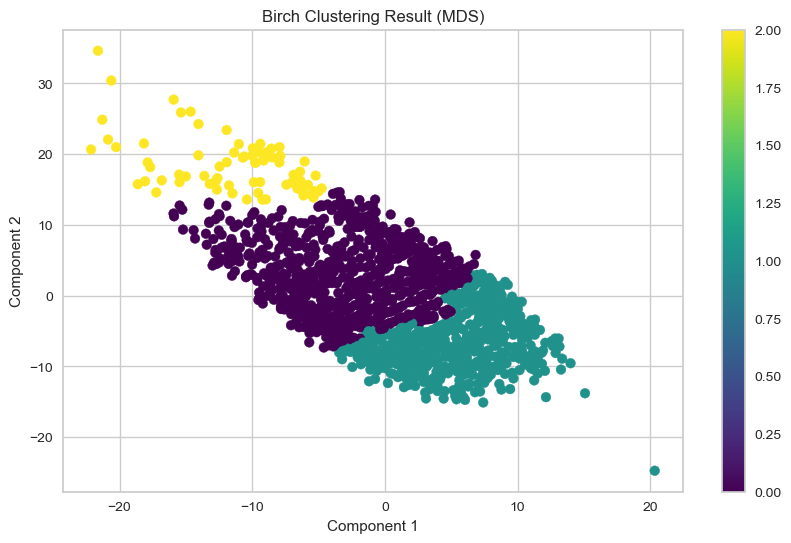

OPTICS - Silhouette Score for MDS: -0.11183035818690655
OPTICS - Davies-Bouldin Index for MDS: 1.725059543046855
OPTICS - Calinski-Harabasz Index for MDS: 12.542031432725189


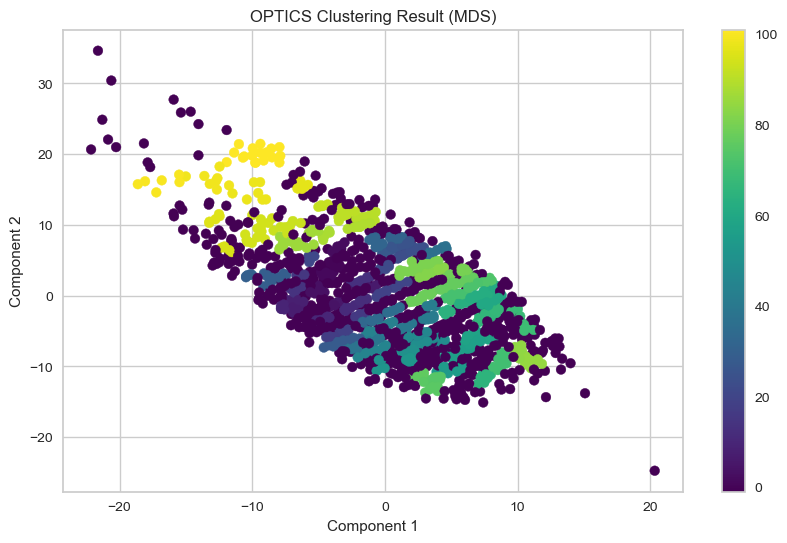

Spectral Clustering - Silhouette Score for MDS: 0.08167733092050763
Spectral Clustering - Davies-Bouldin Index for MDS: 1.7532981968465637
Spectral Clustering - Calinski-Harabasz Index for MDS: 59.39668132071223


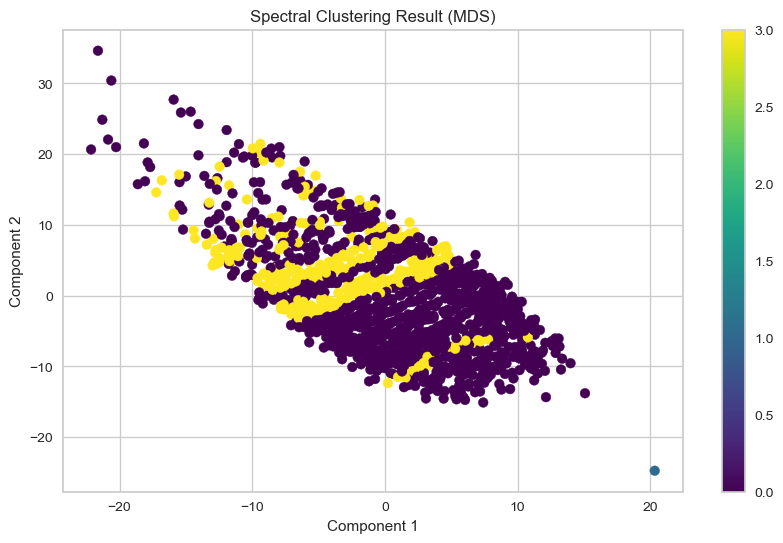

In [40]:
evaluate_clustering(mds_result, 'MDS')

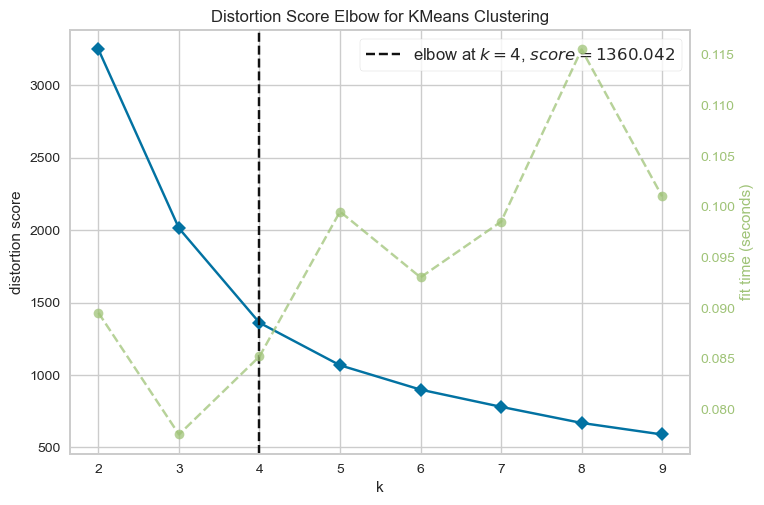

KMeans - Silhouette Score for MDS_MM: 0.4083412402311169
KMeans - Davies-Bouldin Index for MDS_MM: 0.7729318717371036
KMeans - Calinski-Harabasz Index for MDS_MM: 1452.9300252926416


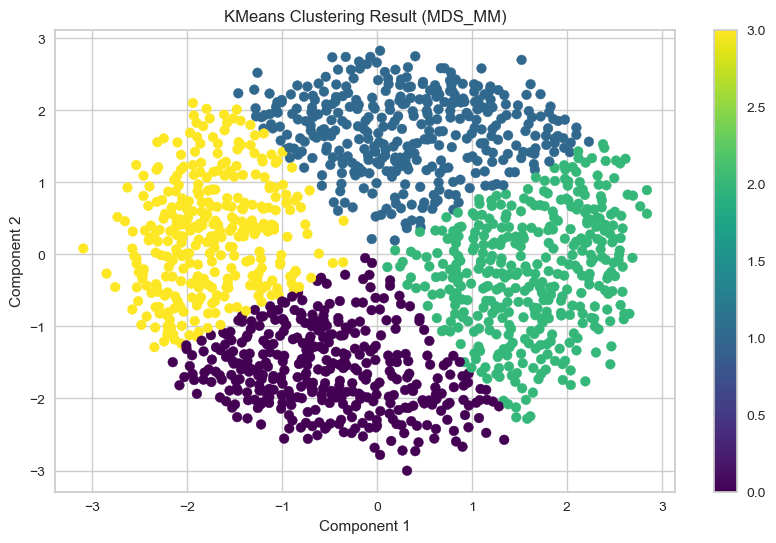

GMM - Silhouette Score for MDS_MM: 0.40831159482251705
GMM - Davies-Bouldin Index for MDS_MM: 0.8186173982054025
GMM - Calinski-Harabasz Index for MDS_MM: 1235.5757366113285


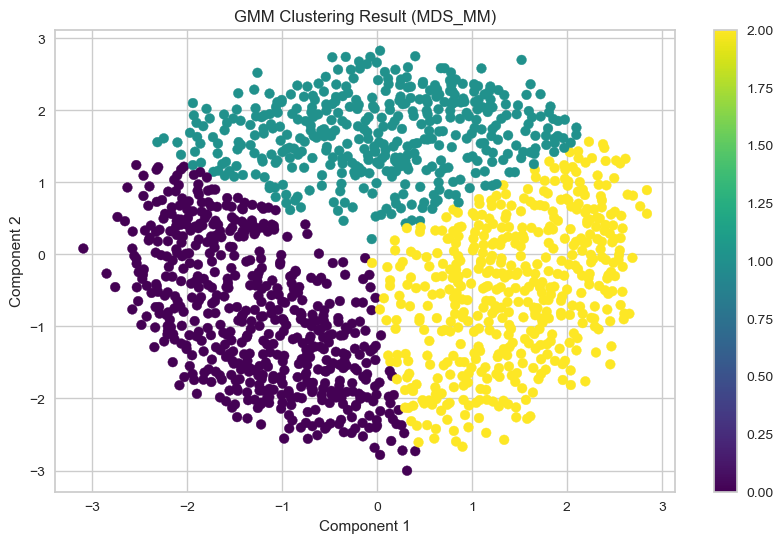

Hierarchical Clustering - Silhouette Score for MDS_MM: 0.35320587721843594
Hierarchical Clustering - Davies-Bouldin Index for MDS_MM: 0.8974830864492539
Hierarchical Clustering - Calinski-Harabasz Index for MDS_MM: 1011.1321875982063


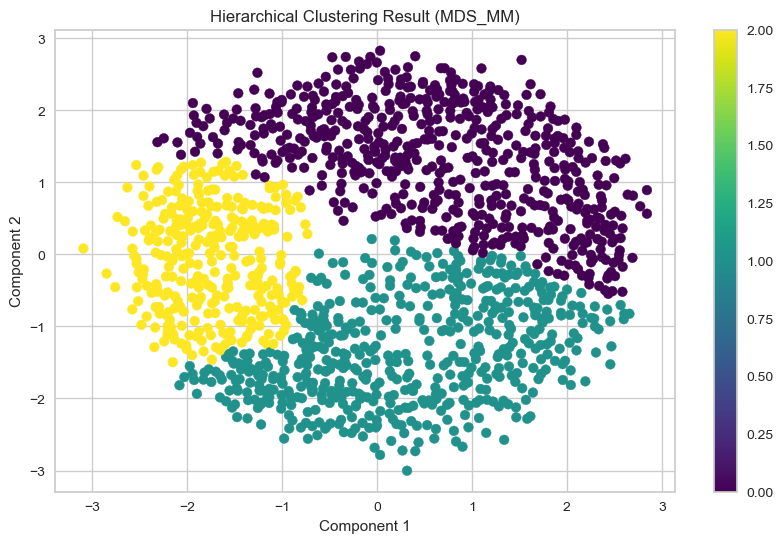

DBSCAN - Insufficient clusters for MDS_MM


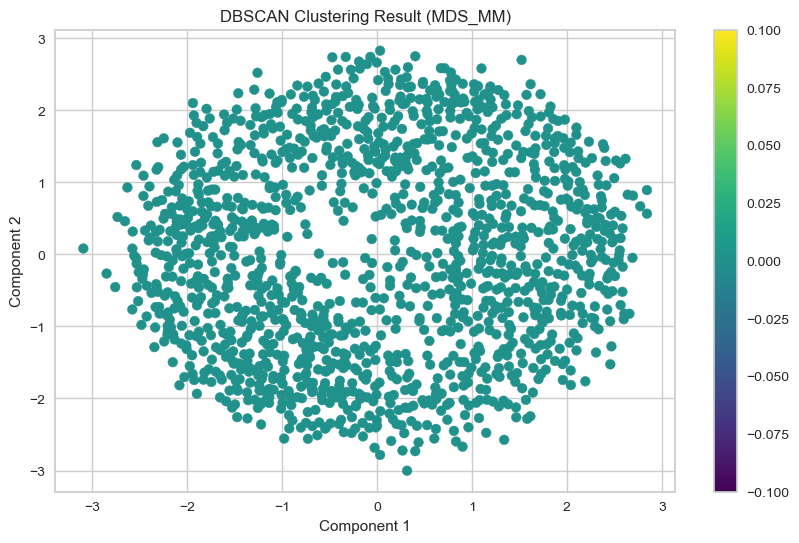

Mean Shift - Silhouette Score for MDS_MM: 0.3878477697871416
Mean Shift - Davies-Bouldin Index for MDS_MM: 1.0987532175595336
Mean Shift - Calinski-Harabasz Index for MDS_MM: 993.2261130889425


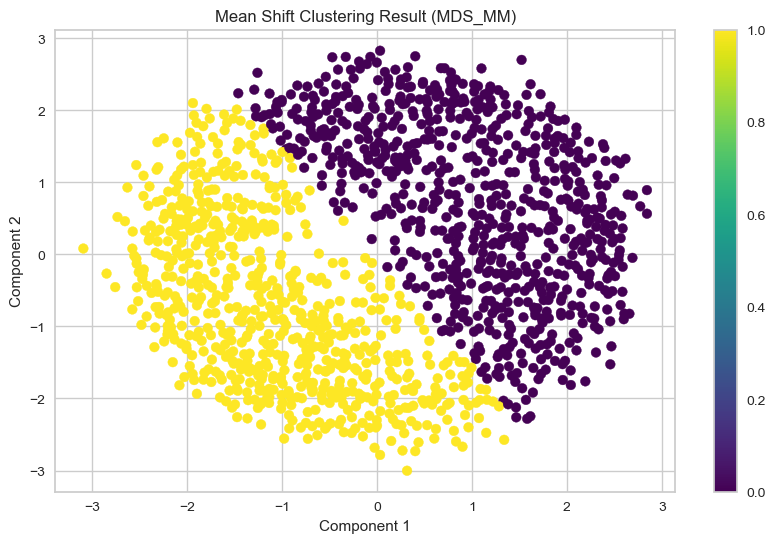

Affinity Propagation - Silhouette Score for MDS_MM: 0.30521358735046916
Affinity Propagation - Davies-Bouldin Index for MDS_MM: 0.8475908101792266
Affinity Propagation - Calinski-Harabasz Index for MDS_MM: 1365.0600122940095


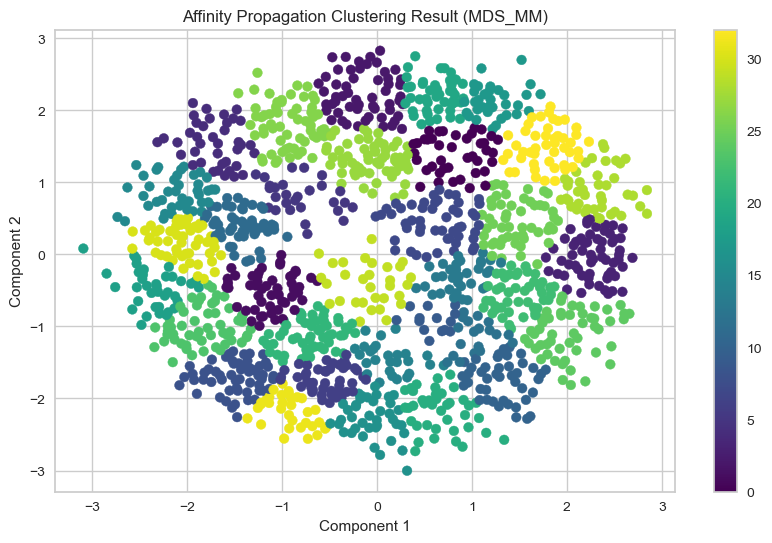

Birch - Silhouette Score for MDS_MM: 0.36986095355225257
Birch - Davies-Bouldin Index for MDS_MM: 0.8389551691557874
Birch - Calinski-Harabasz Index for MDS_MM: 1069.8709729926973


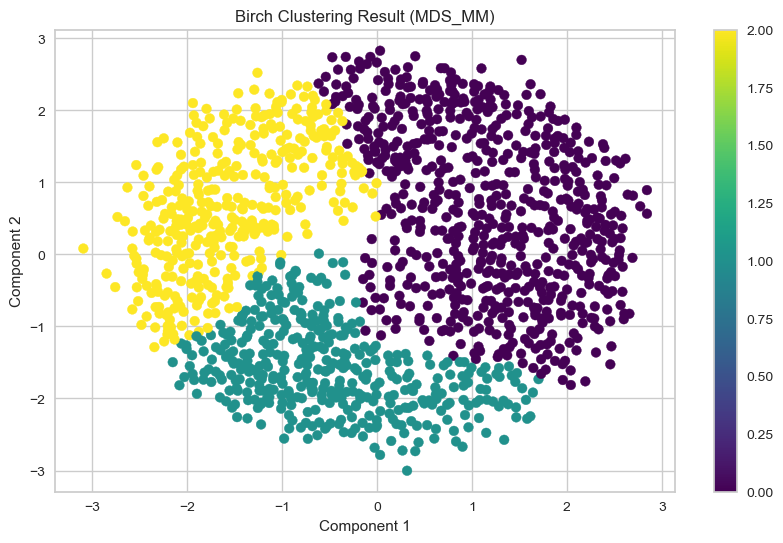

OPTICS - Silhouette Score for MDS_MM: -0.3234425194640021
OPTICS - Davies-Bouldin Index for MDS_MM: 1.2835706319214277
OPTICS - Calinski-Harabasz Index for MDS_MM: 10.33401256976053


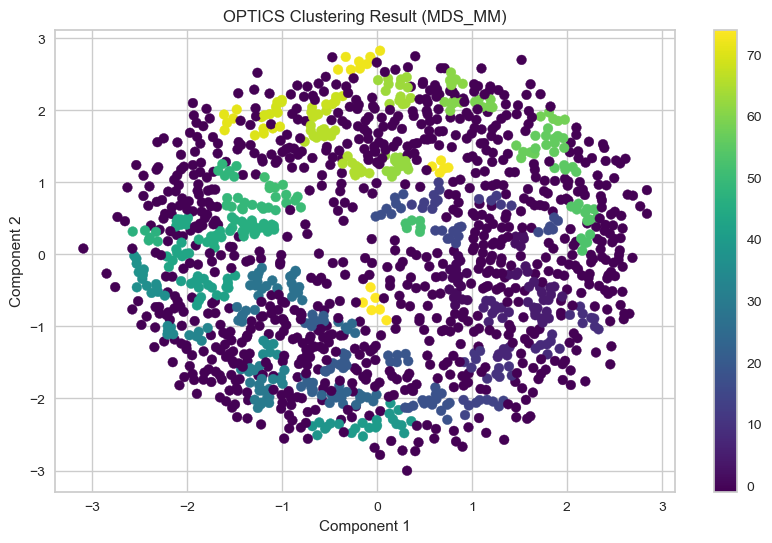

Spectral Clustering - Silhouette Score for MDS_MM: 0.4091764048309076
Spectral Clustering - Davies-Bouldin Index for MDS_MM: 0.7675180087094882
Spectral Clustering - Calinski-Harabasz Index for MDS_MM: 1449.2046856965135


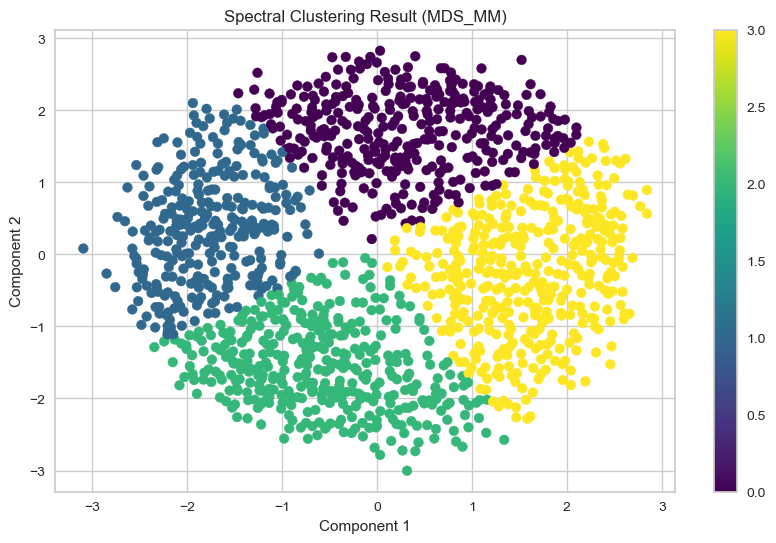

In [41]:
evaluate_clustering(mds_result_MM, 'MDS_MM')

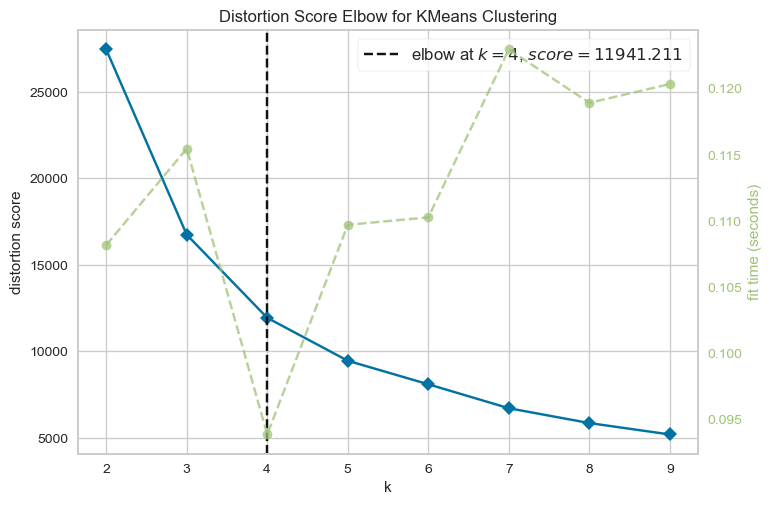

KMeans - Silhouette Score for MDS_S: 0.3788986285092465
KMeans - Davies-Bouldin Index for MDS_S: 0.8088694535185352
KMeans - Calinski-Harabasz Index for MDS_S: 1286.549904707777


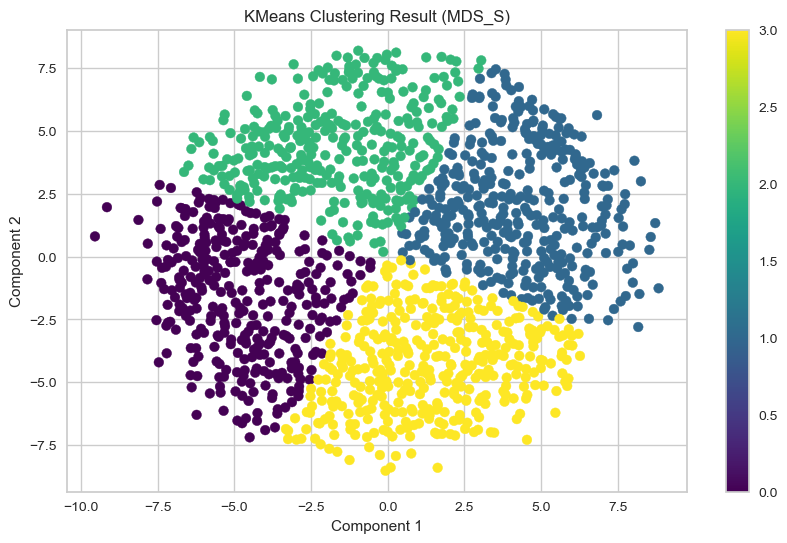

GMM - Silhouette Score for MDS_S: 0.3908014947504594
GMM - Davies-Bouldin Index for MDS_S: 0.8360514932779832
GMM - Calinski-Harabasz Index for MDS_S: 1161.3596797716887


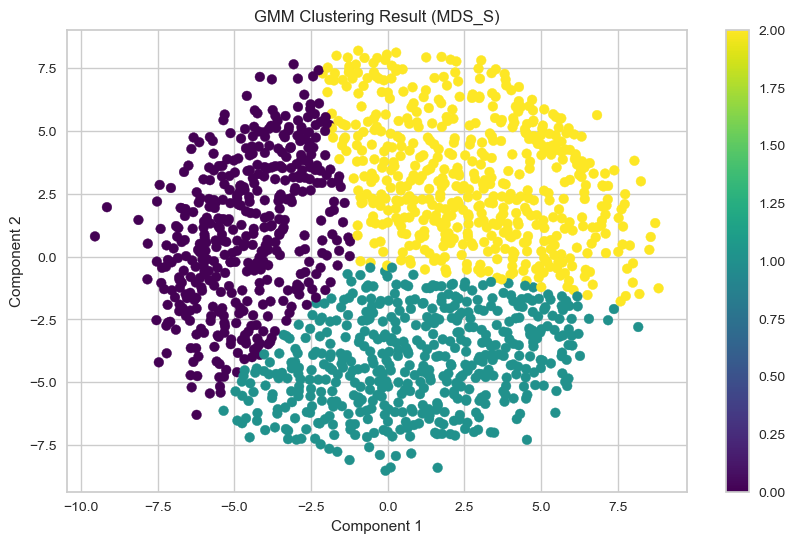

Hierarchical Clustering - Silhouette Score for MDS_S: 0.3315976655081429
Hierarchical Clustering - Davies-Bouldin Index for MDS_S: 0.9655648777513252
Hierarchical Clustering - Calinski-Harabasz Index for MDS_S: 924.7119741021114


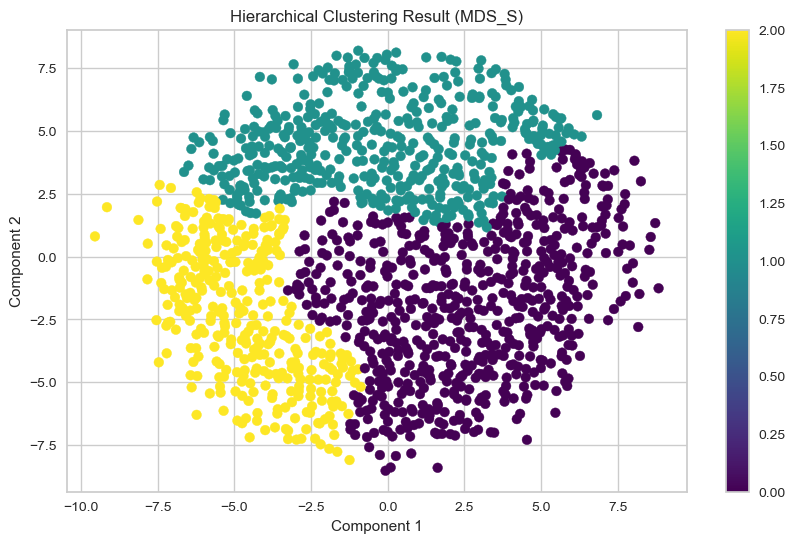

DBSCAN - Silhouette Score for MDS_S: -0.44756498990307225
DBSCAN - Davies-Bouldin Index for MDS_S: 3.0088432960894687
DBSCAN - Calinski-Harabasz Index for MDS_S: 30.63622668322174


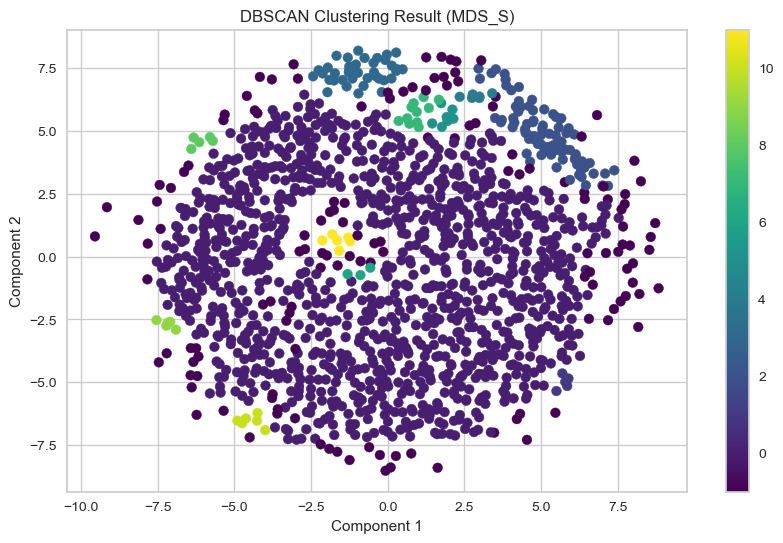

Mean Shift - Silhouette Score for MDS_S: 0.34010820357985105
Mean Shift - Davies-Bouldin Index for MDS_S: 1.2412349088454497
Mean Shift - Calinski-Harabasz Index for MDS_S: 768.493480179722


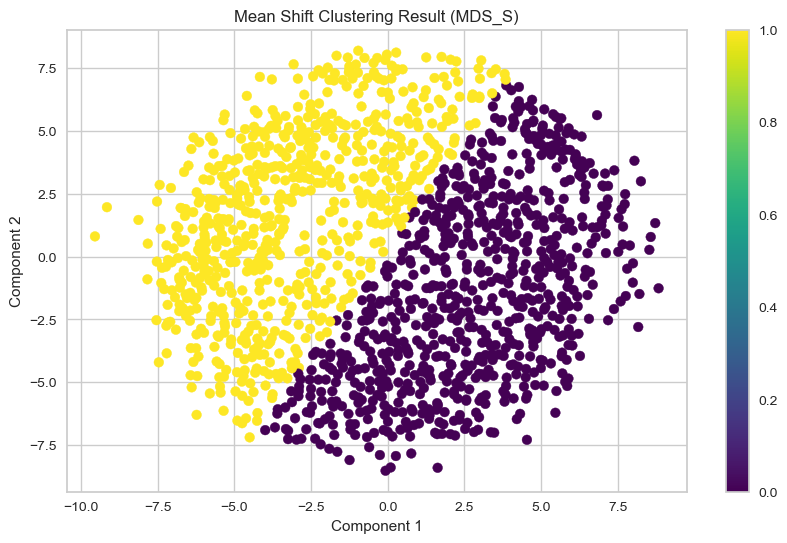

Affinity Propagation - Silhouette Score for MDS_S: 0.22131115493473694
Affinity Propagation - Davies-Bouldin Index for MDS_S: 0.5063055770269761
Affinity Propagation - Calinski-Harabasz Index for MDS_S: 280.79504824735955


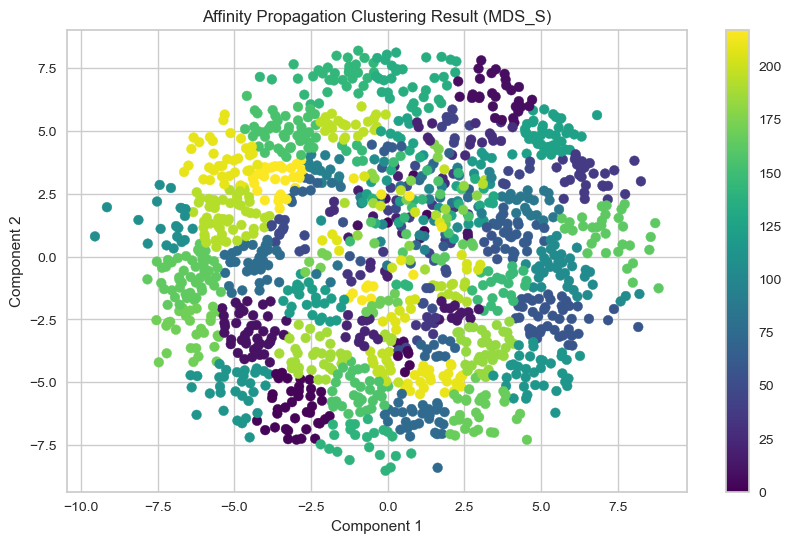

Birch - Silhouette Score for MDS_S: 0.3390328874209412
Birch - Davies-Bouldin Index for MDS_S: 0.9202226538335566
Birch - Calinski-Harabasz Index for MDS_S: 945.0485411329495


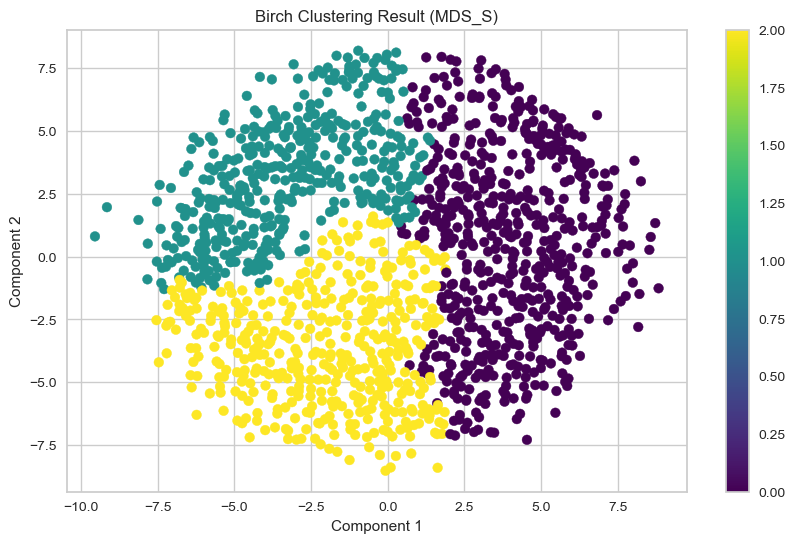

OPTICS - Silhouette Score for MDS_S: -0.338020840764151
OPTICS - Davies-Bouldin Index for MDS_S: 1.3900844214019976
OPTICS - Calinski-Harabasz Index for MDS_S: 10.79536133975124


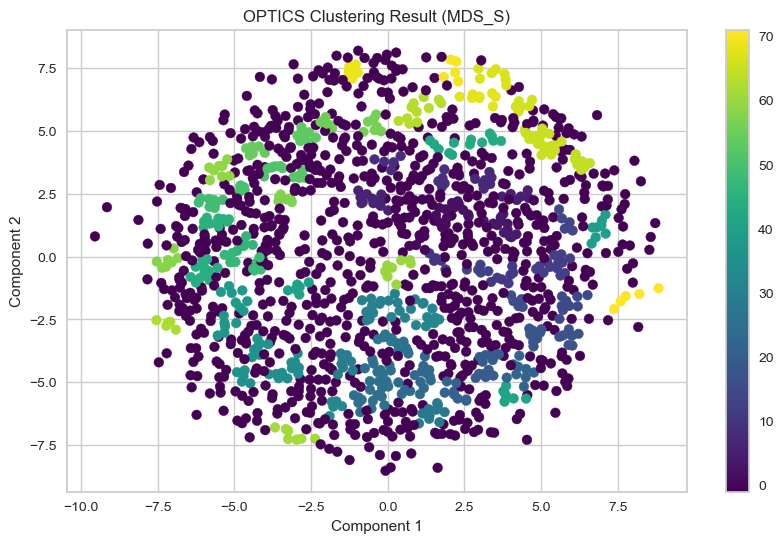

Spectral Clustering - Silhouette Score for MDS_S: 0.370915079934756
Spectral Clustering - Davies-Bouldin Index for MDS_S: 0.8073312849346441
Spectral Clustering - Calinski-Harabasz Index for MDS_S: 1236.617651691285


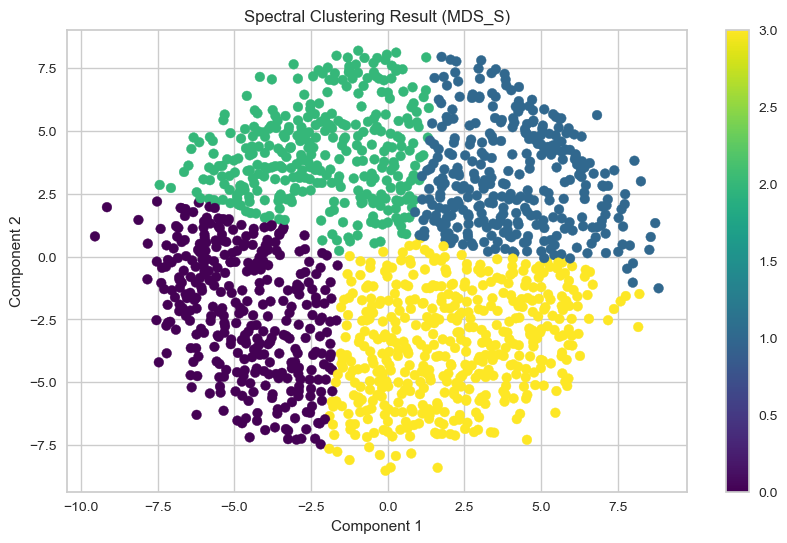

In [42]:
evaluate_clustering(mds_result_S, 'MDS_S')

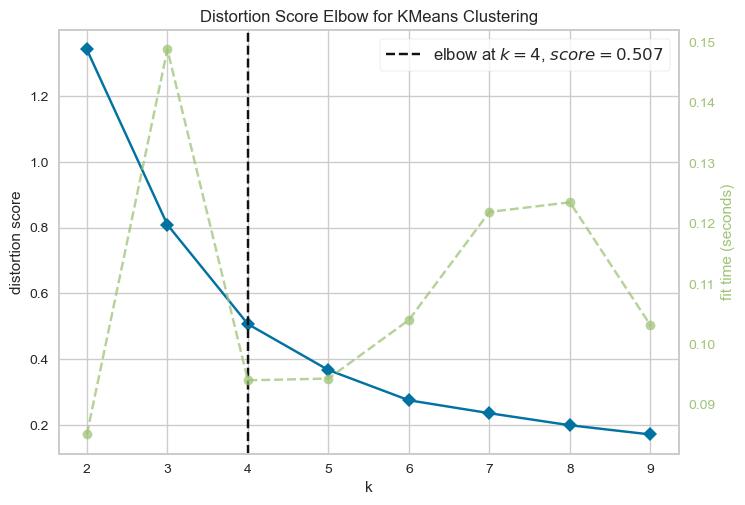

KMeans - Silhouette Score for LLE: 0.4704022126626958
KMeans - Davies-Bouldin Index for LLE: 0.6521071107418784
KMeans - Calinski-Harabasz Index for LLE: 1402.5301469153476


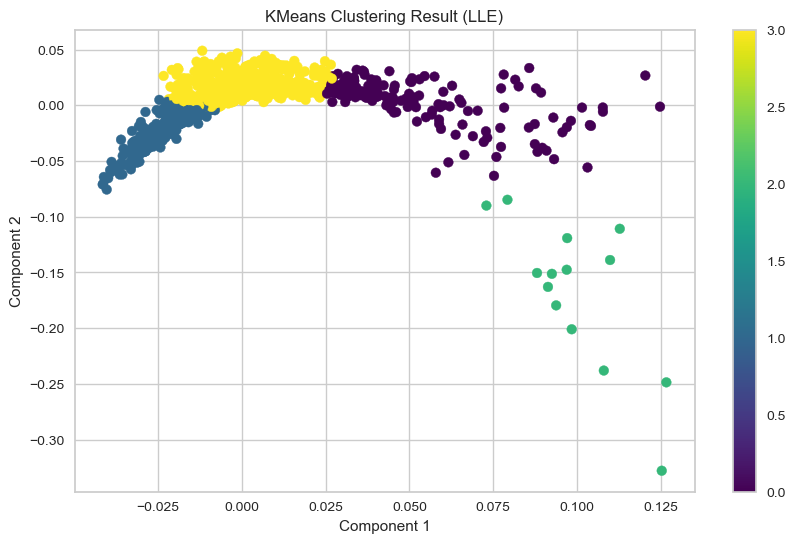

GMM - Silhouette Score for LLE: 0.372639417488063
GMM - Davies-Bouldin Index for LLE: 0.8717153218802038
GMM - Calinski-Harabasz Index for LLE: 828.0897426719877


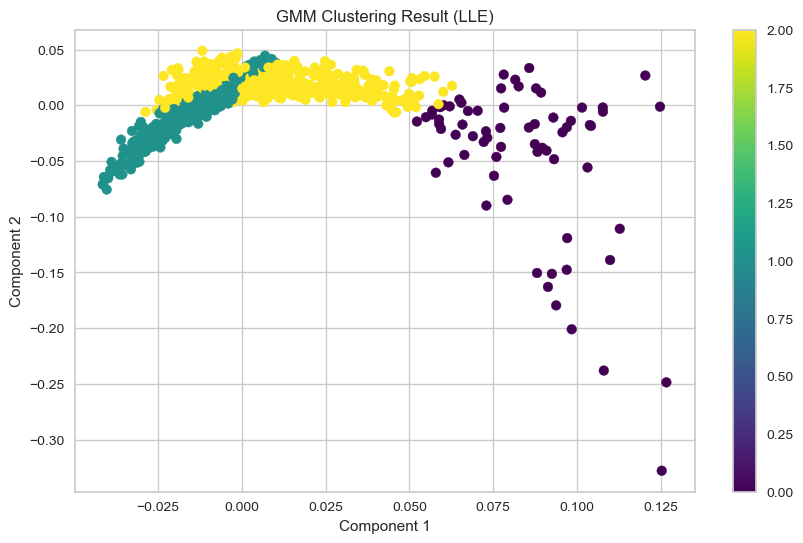

Hierarchical Clustering - Silhouette Score for LLE: 0.42444343721853367
Hierarchical Clustering - Davies-Bouldin Index for LLE: 0.6751173117447852
Hierarchical Clustering - Calinski-Harabasz Index for LLE: 927.6567770875799


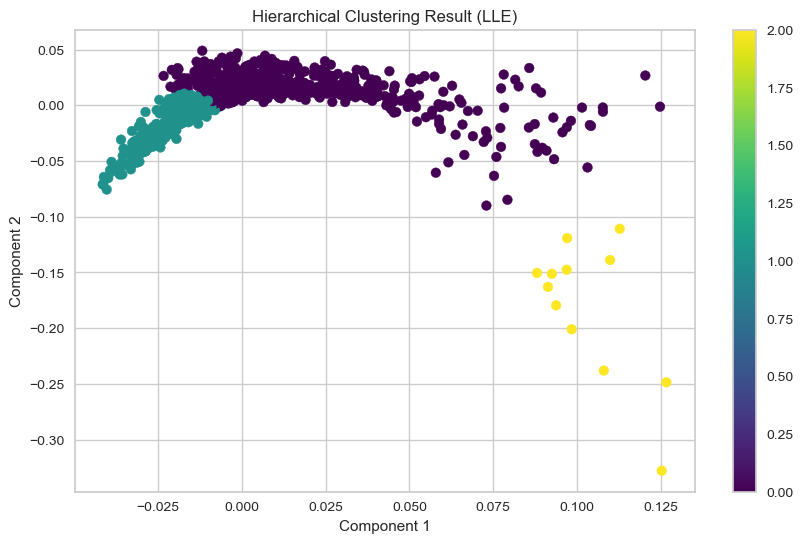

DBSCAN - Insufficient clusters for LLE


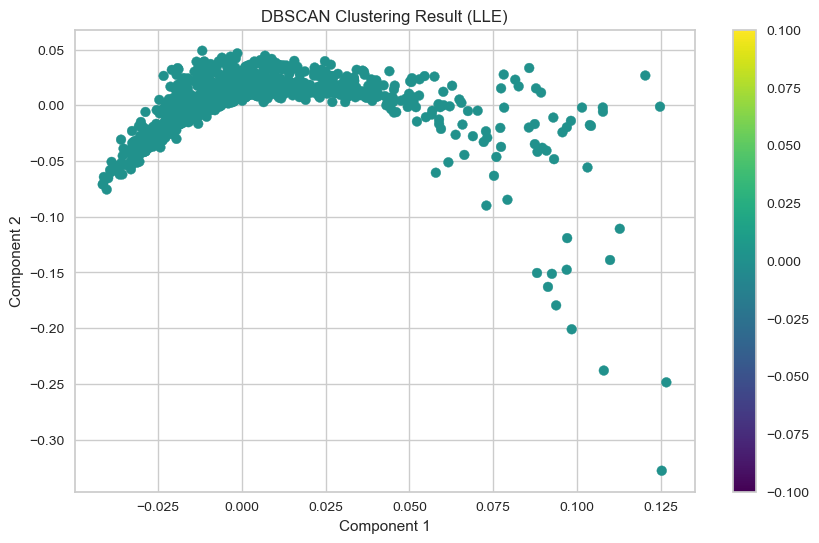

Mean Shift - Silhouette Score for LLE: 0.5537099941268491
Mean Shift - Davies-Bouldin Index for LLE: 0.6283088069638072
Mean Shift - Calinski-Harabasz Index for LLE: 201.95184255689014


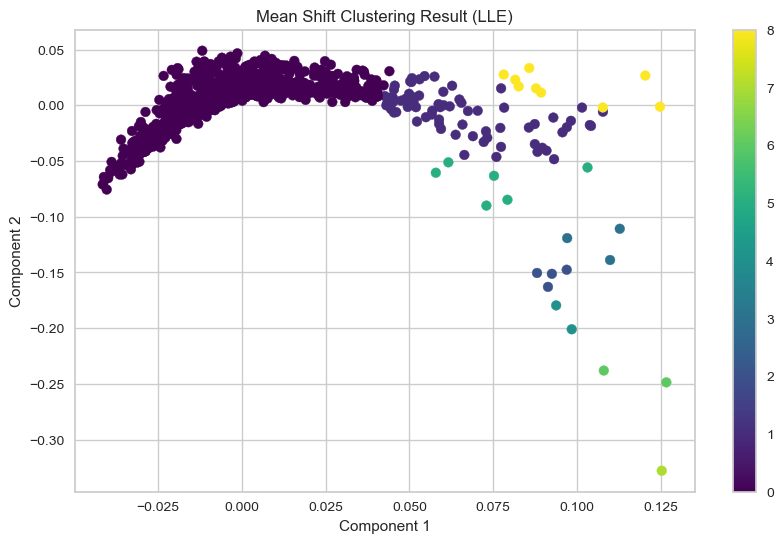

Affinity Propagation - Silhouette Score for LLE: 0.21330271646011786
Affinity Propagation - Davies-Bouldin Index for LLE: 0.602659581299365
Affinity Propagation - Calinski-Harabasz Index for LLE: 492.07505861460015


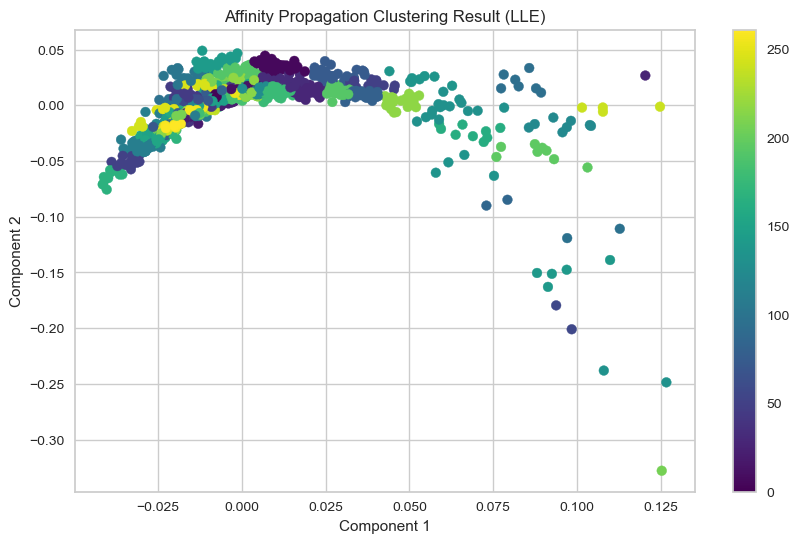

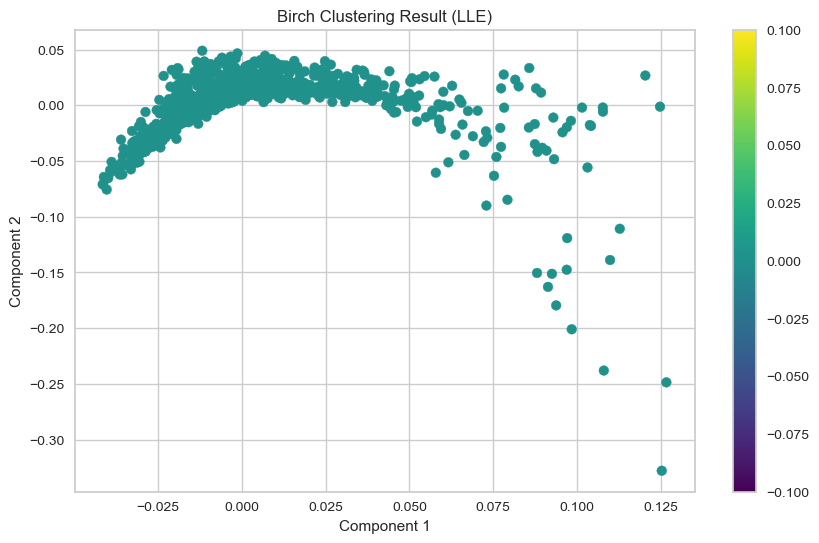

OPTICS - Silhouette Score for LLE: -0.23255624325267235
OPTICS - Davies-Bouldin Index for LLE: 1.6639306453340066
OPTICS - Calinski-Harabasz Index for LLE: 12.20913065007438


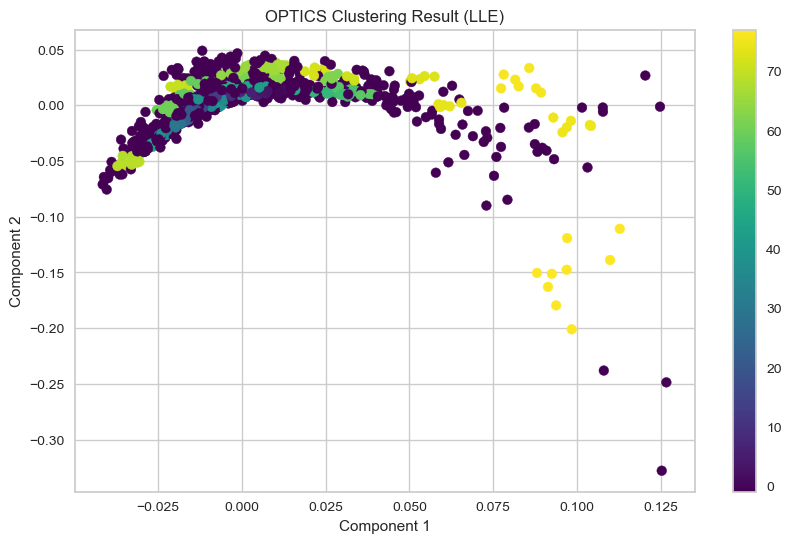

Spectral Clustering - Silhouette Score for LLE: 0.42060380932108493
Spectral Clustering - Davies-Bouldin Index for LLE: 0.7018338690529344
Spectral Clustering - Calinski-Harabasz Index for LLE: 1218.4257801013107


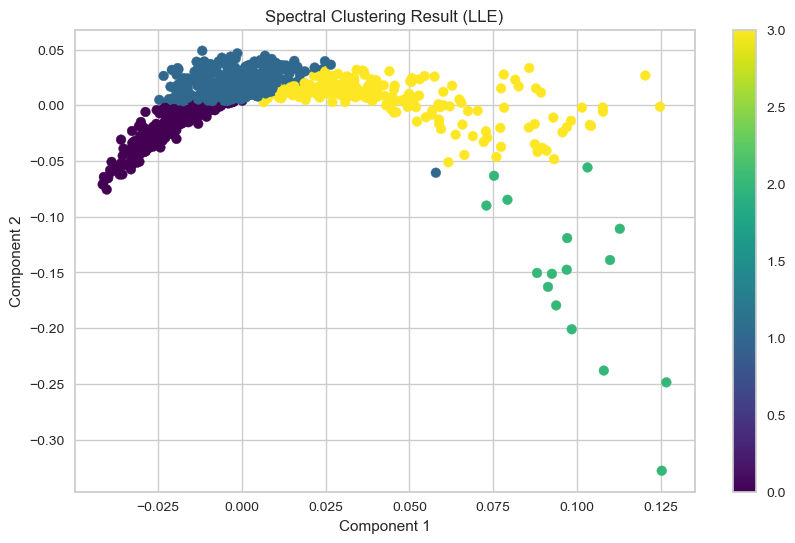

In [45]:
evaluate_clustering(lle_result, 'LLE')

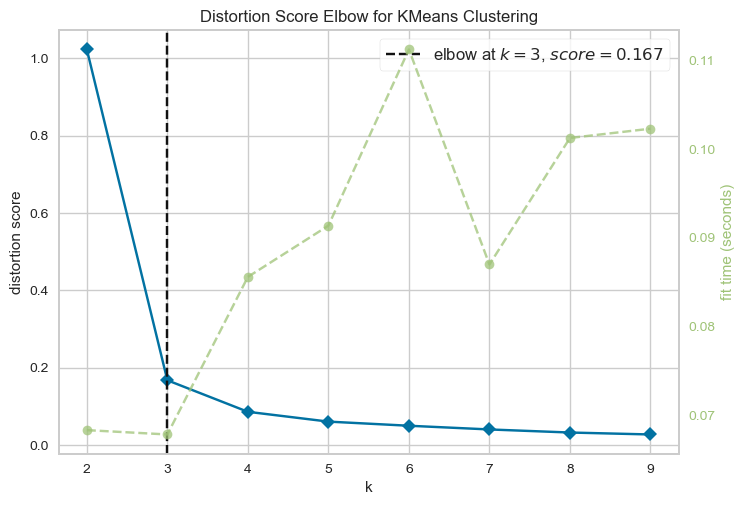

KMeans - Silhouette Score for LLE_S: 0.8118772797699046
KMeans - Davies-Bouldin Index for LLE_S: 0.2116806079616247
KMeans - Calinski-Harabasz Index for LLE_S: 7842.404608027991


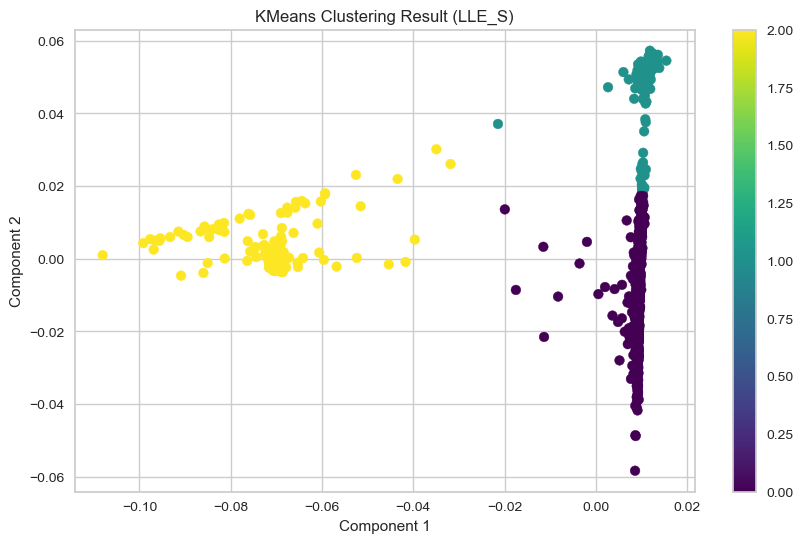

GMM - Silhouette Score for LLE_S: 0.8001078040820756
GMM - Davies-Bouldin Index for LLE_S: 0.23708580411884025
GMM - Calinski-Harabasz Index for LLE_S: 5957.706260743738


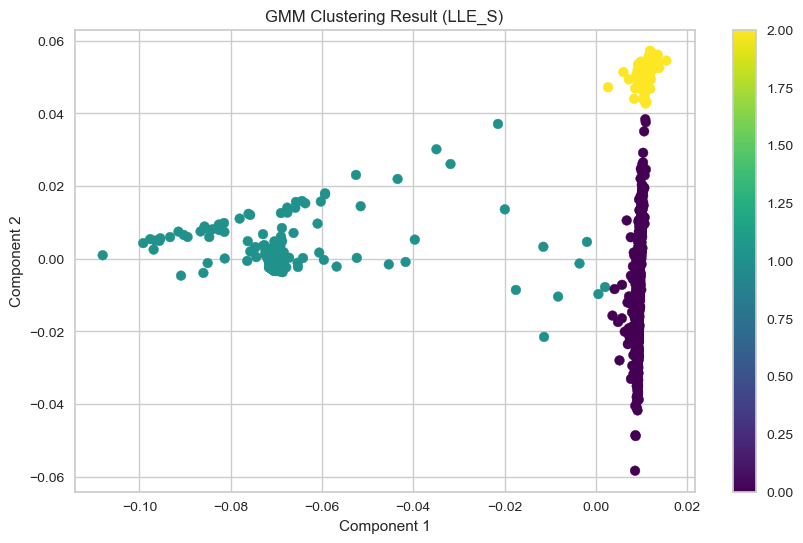

Hierarchical Clustering - Silhouette Score for LLE_S: 0.8133476682633718
Hierarchical Clustering - Davies-Bouldin Index for LLE_S: 0.2047312977070013
Hierarchical Clustering - Calinski-Harabasz Index for LLE_S: 7391.788545540842


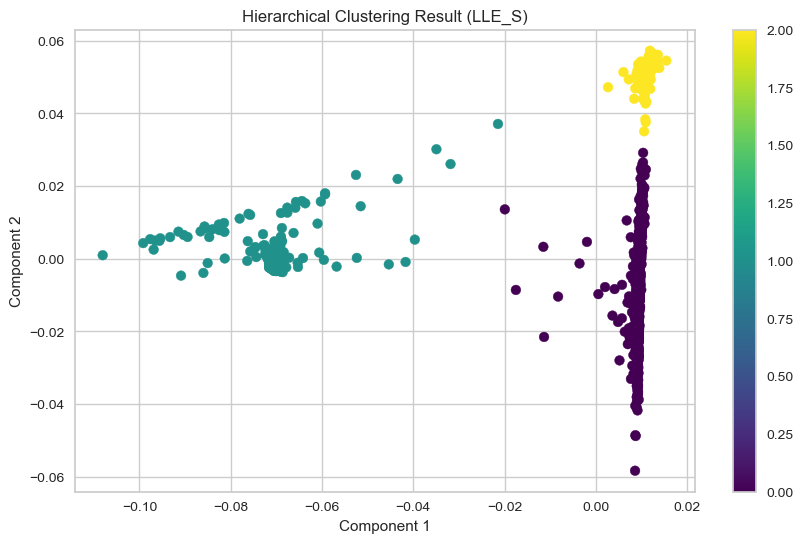

DBSCAN - Insufficient clusters for LLE_S


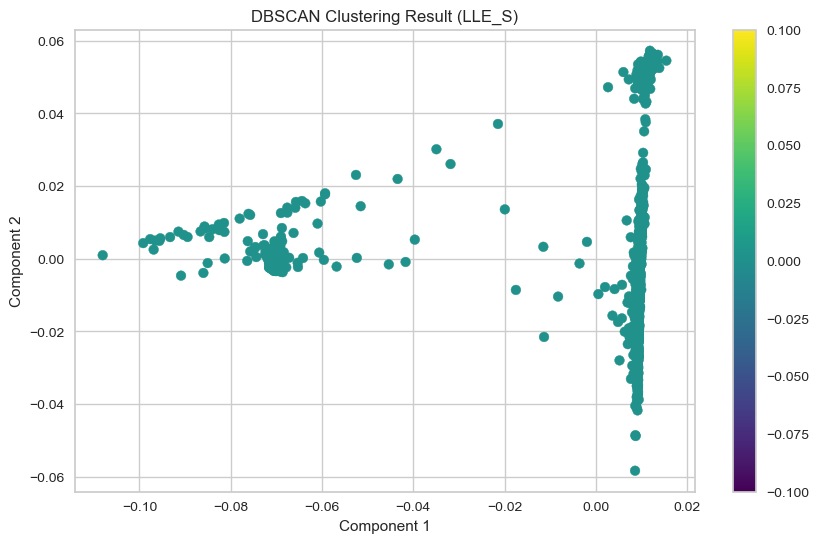

Mean Shift - Silhouette Score for LLE_S: 0.8133212346678093
Mean Shift - Davies-Bouldin Index for LLE_S: 0.20797026982524977
Mean Shift - Calinski-Harabasz Index for LLE_S: 7840.410975141381


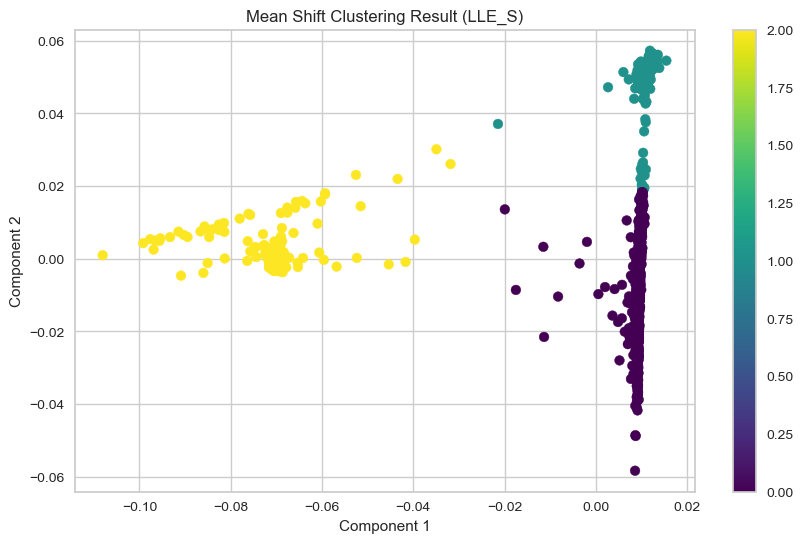

Affinity Propagation - Silhouette Score for LLE_S: 0.12087355580357265
Affinity Propagation - Davies-Bouldin Index for LLE_S: 0.4326126969732975
Affinity Propagation - Calinski-Harabasz Index for LLE_S: 119.94551252689492


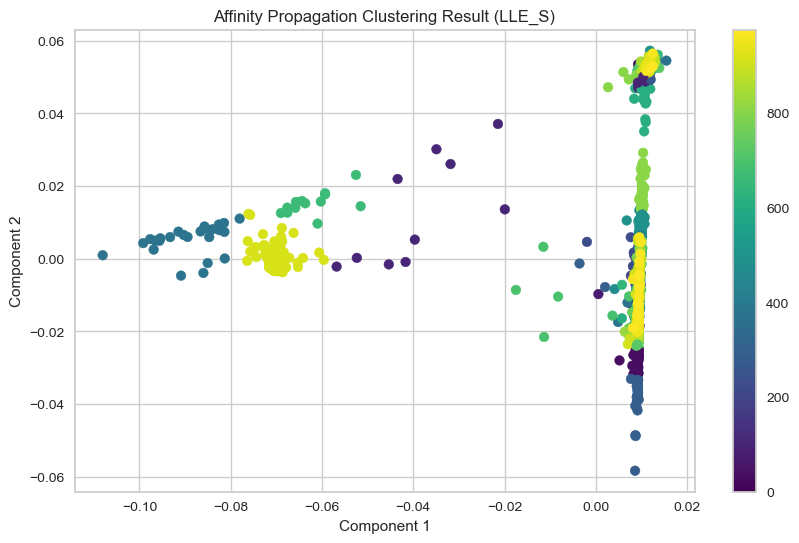

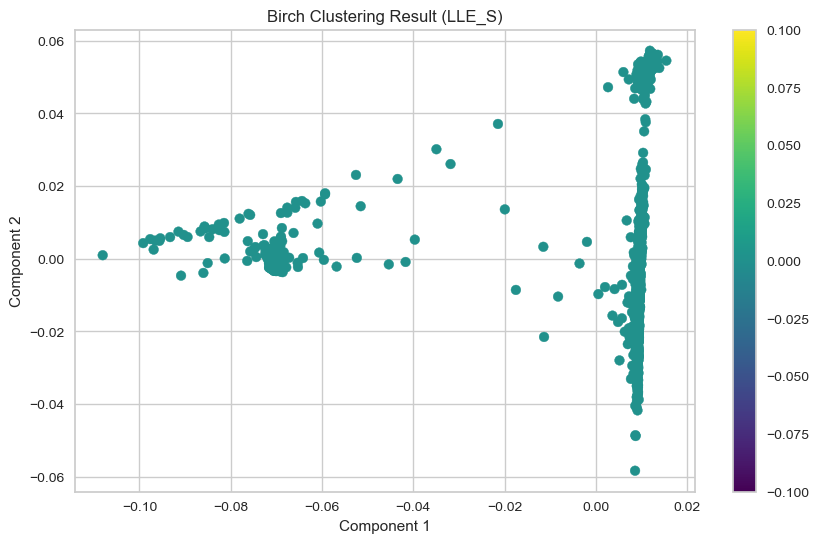

OPTICS - Silhouette Score for LLE_S: -0.17960487125651237
OPTICS - Davies-Bouldin Index for LLE_S: 1.5966679442275429
OPTICS - Calinski-Harabasz Index for LLE_S: 12.324632730986275


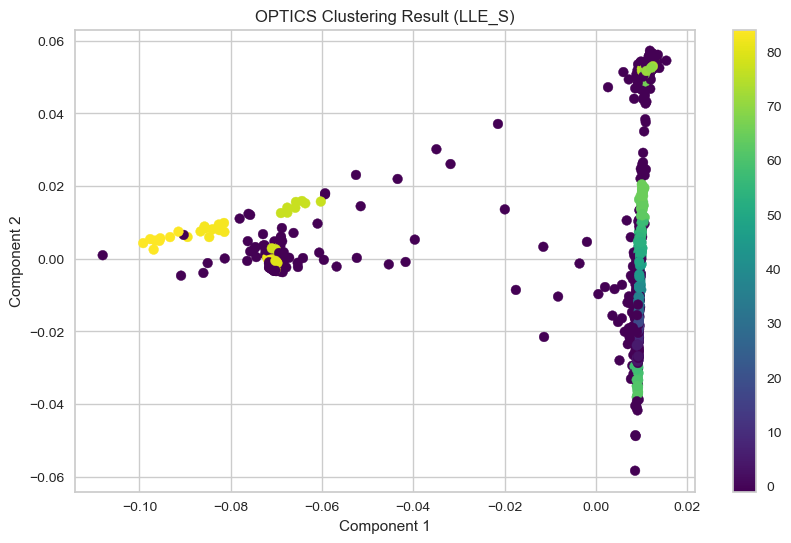

Spectral Clustering - Silhouette Score for LLE_S: 0.8118772797699046
Spectral Clustering - Davies-Bouldin Index for LLE_S: 0.2116806079616247
Spectral Clustering - Calinski-Harabasz Index for LLE_S: 7842.404608027991


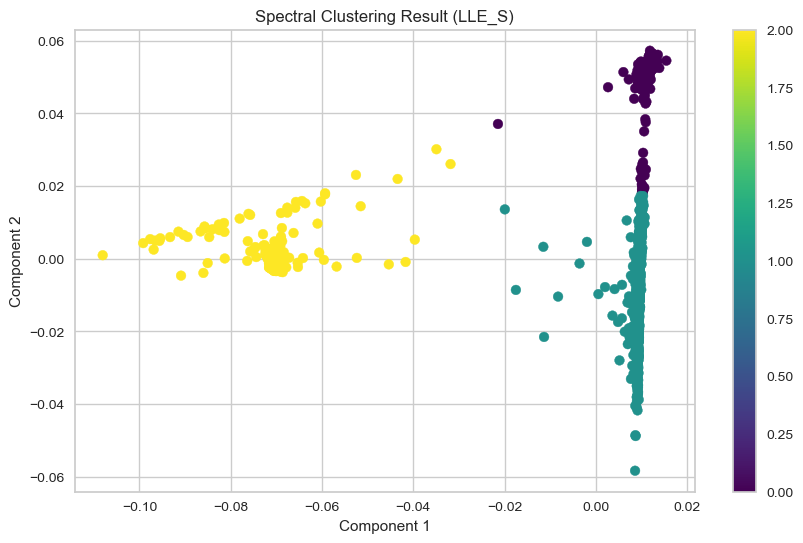

In [49]:
evaluate_clustering(lle_result_S, 'LLE_S')

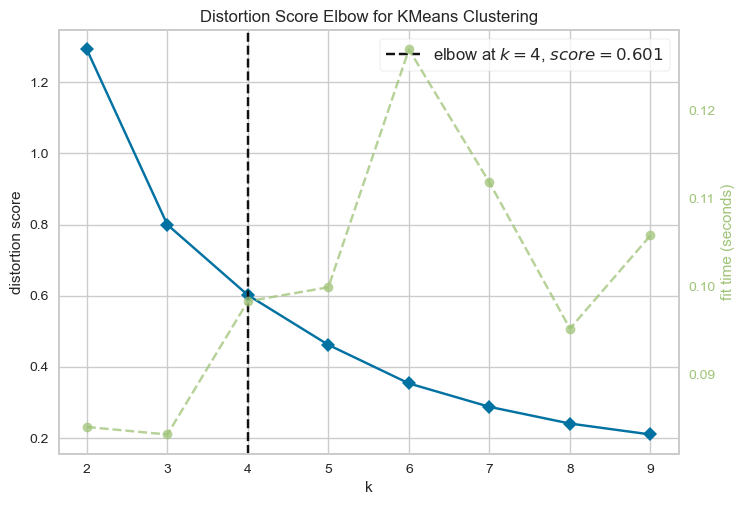

KMeans - Silhouette Score for LLE_MM: 0.515940325083744
KMeans - Davies-Bouldin Index for LLE_MM: 0.6372970243431385
KMeans - Calinski-Harabasz Index for LLE_MM: 1107.520514739124


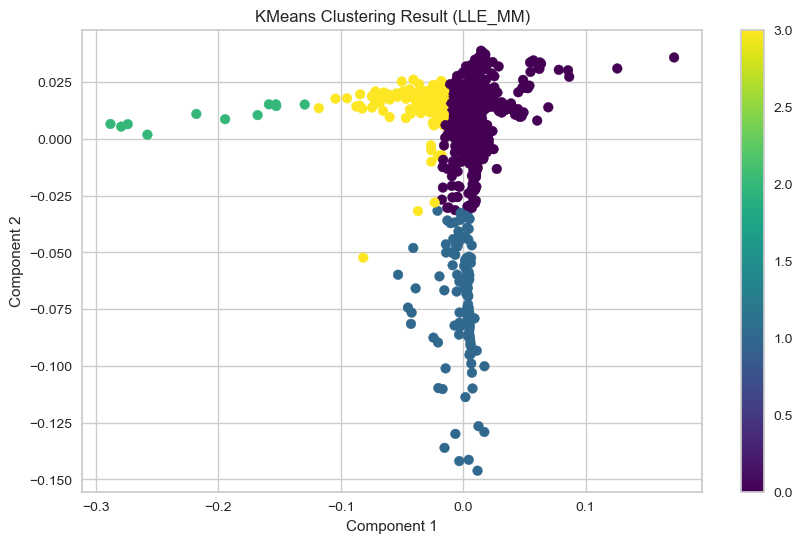

GMM - Silhouette Score for LLE_MM: 0.551376613018936
GMM - Davies-Bouldin Index for LLE_MM: 1.563241521012429
GMM - Calinski-Harabasz Index for LLE_MM: 506.4895031793145


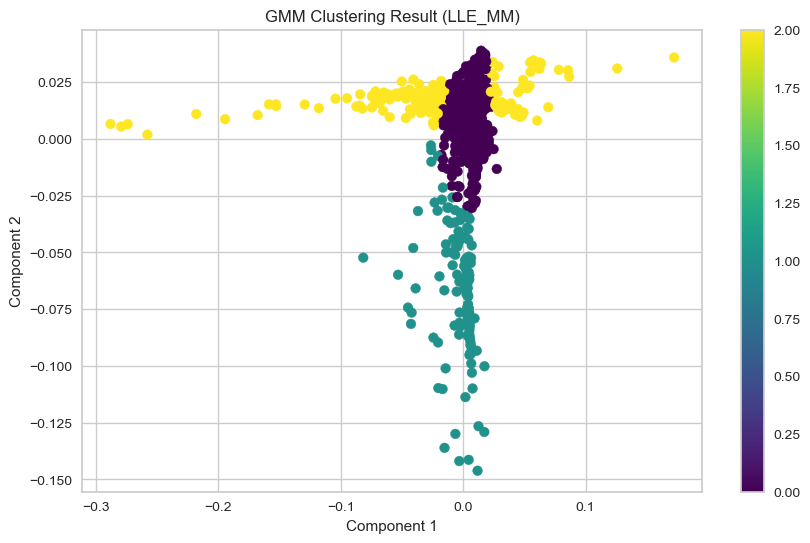

Hierarchical Clustering - Silhouette Score for LLE_MM: 0.684195801366738
Hierarchical Clustering - Davies-Bouldin Index for LLE_MM: 0.4437845632835282
Hierarchical Clustering - Calinski-Harabasz Index for LLE_MM: 1025.785471171334


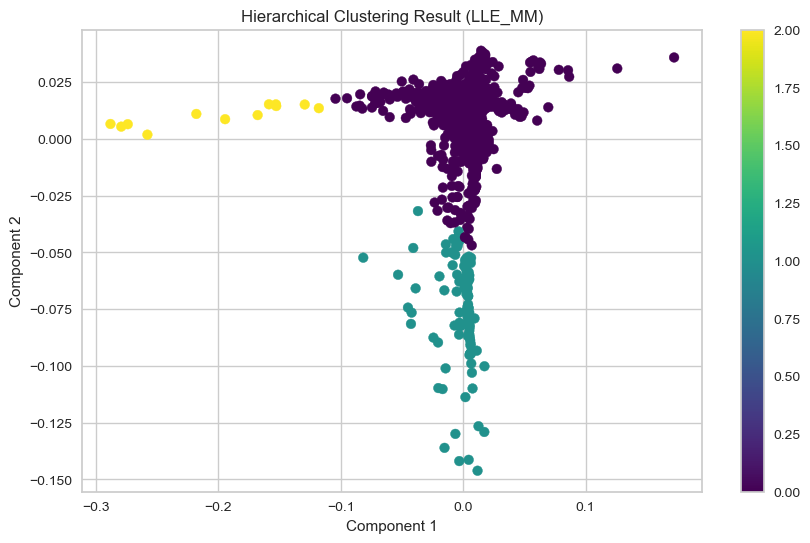

DBSCAN - Insufficient clusters for LLE_MM


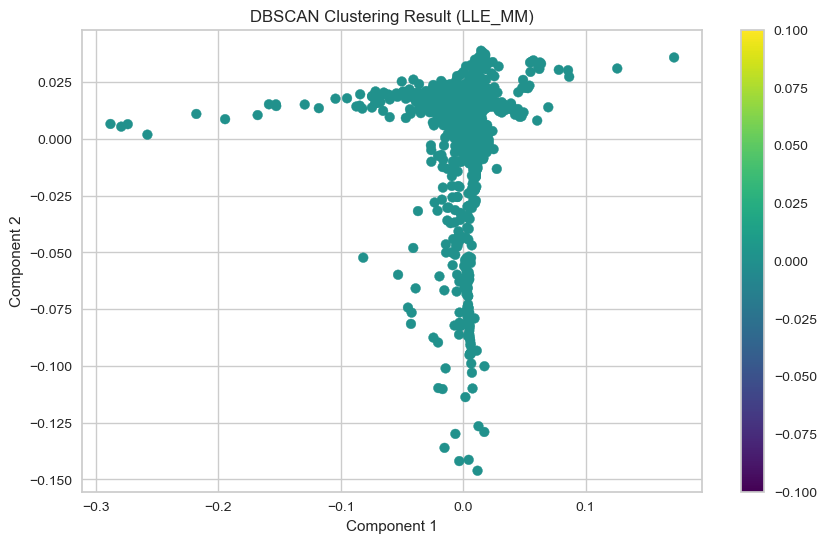

Mean Shift - Silhouette Score for LLE_MM: 0.5818270556354561
Mean Shift - Davies-Bouldin Index for LLE_MM: 0.7237799983118377
Mean Shift - Calinski-Harabasz Index for LLE_MM: 427.34322301624695


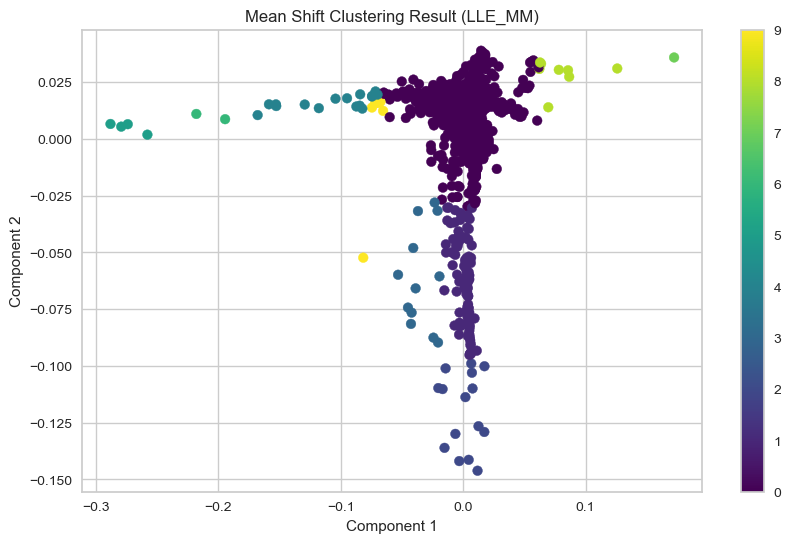

Affinity Propagation - Silhouette Score for LLE_MM: 0.3338291254441042
Affinity Propagation - Davies-Bouldin Index for LLE_MM: 0.7161385210178132
Affinity Propagation - Calinski-Harabasz Index for LLE_MM: 2191.390468083942


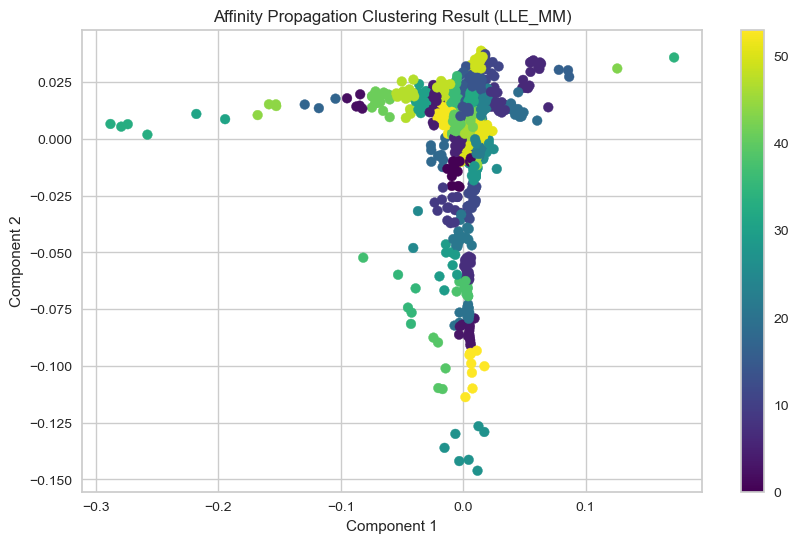

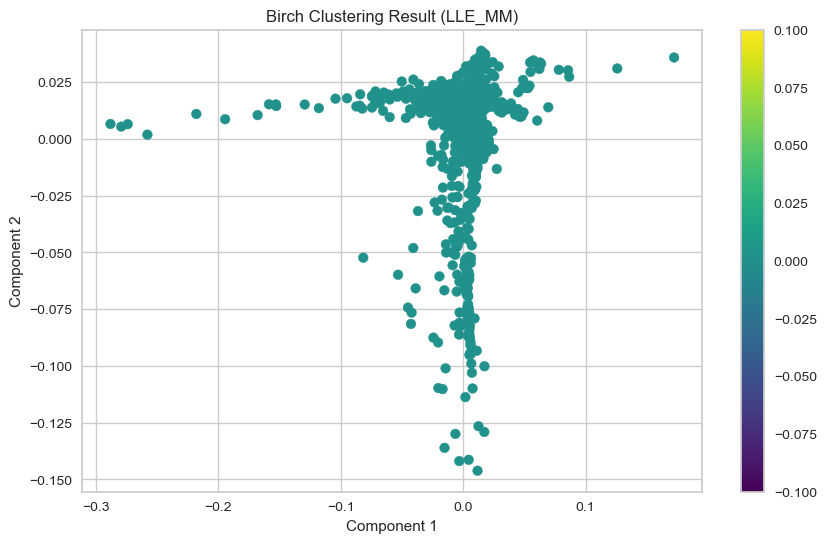

OPTICS - Silhouette Score for LLE_MM: -0.3081872153215417
OPTICS - Davies-Bouldin Index for LLE_MM: 2.5426631691689576
OPTICS - Calinski-Harabasz Index for LLE_MM: 6.3646600641449895


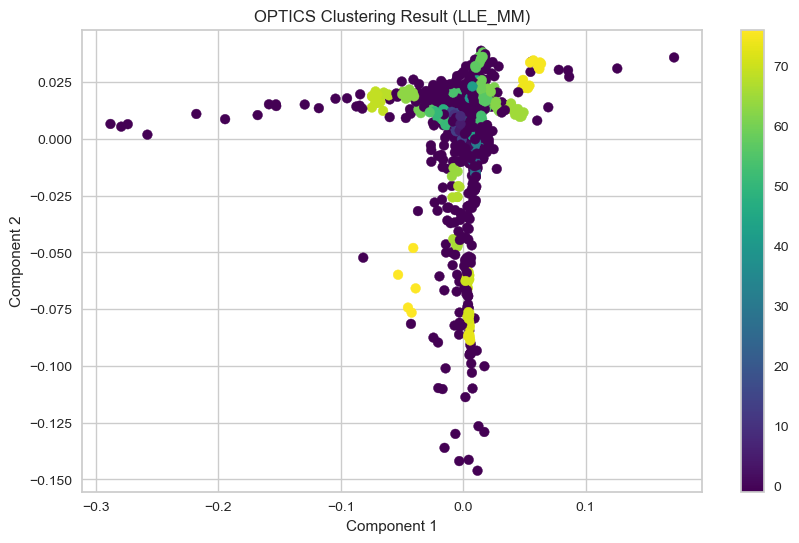

Spectral Clustering - Silhouette Score for LLE_MM: 0.5859245099358628
Spectral Clustering - Davies-Bouldin Index for LLE_MM: 0.5531864037282472
Spectral Clustering - Calinski-Harabasz Index for LLE_MM: 918.6032839297474


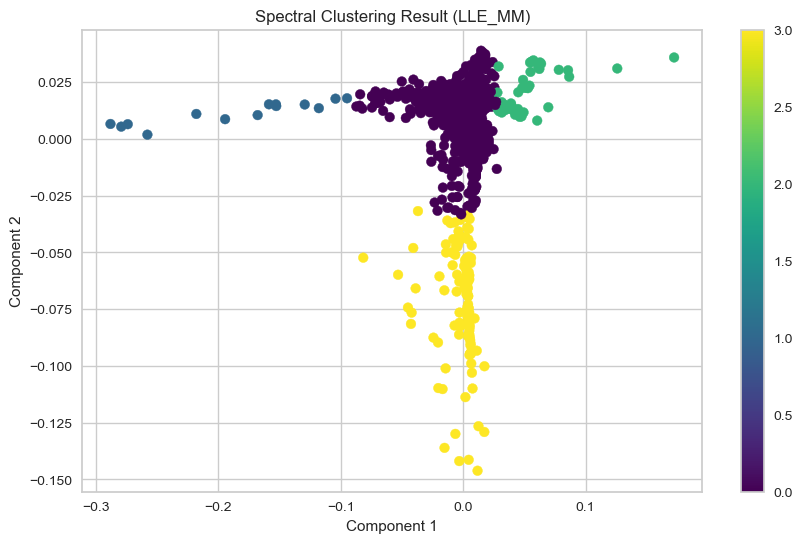

In [53]:
evaluate_clustering(lle_result_MM, 'LLE_MM')

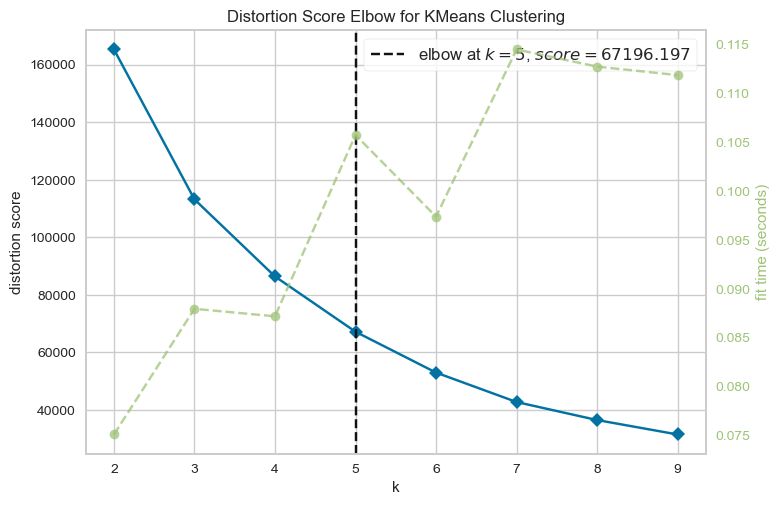

KMeans - Silhouette Score for Isomap: 0.4052815985850895
KMeans - Davies-Bouldin Index for Isomap: 0.795758452869956
KMeans - Calinski-Harabasz Index for Isomap: 1593.2895654191716


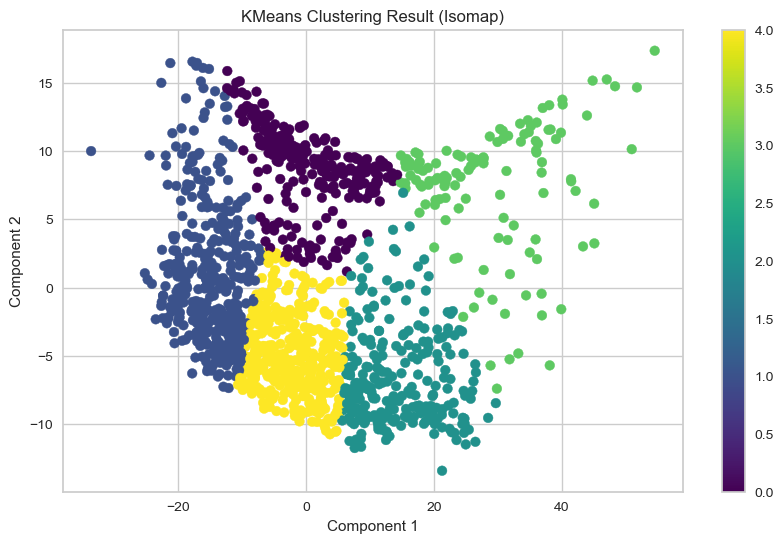

GMM - Silhouette Score for Isomap: 0.24080765128395876
GMM - Davies-Bouldin Index for Isomap: 1.4259391032733595
GMM - Calinski-Harabasz Index for Isomap: 590.3946934218444


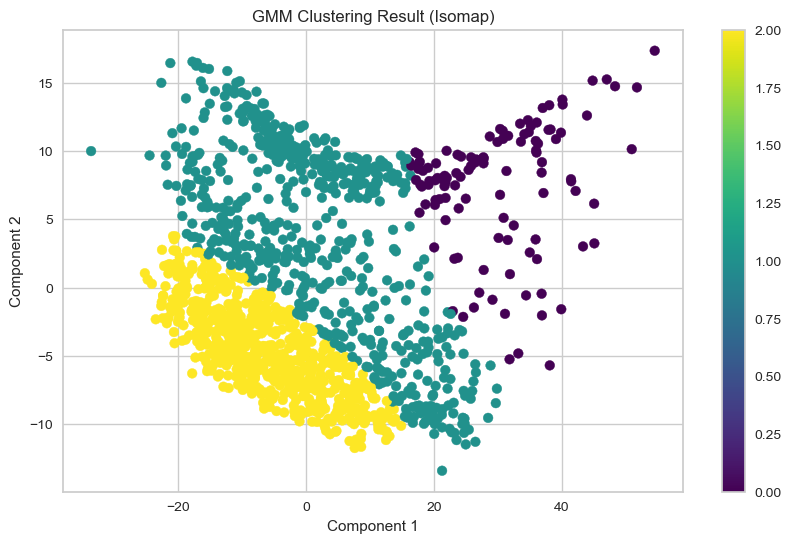

Hierarchical Clustering - Silhouette Score for Isomap: 0.41893185275087325
Hierarchical Clustering - Davies-Bouldin Index for Isomap: 0.7764345949679514
Hierarchical Clustering - Calinski-Harabasz Index for Isomap: 1354.4668180408692


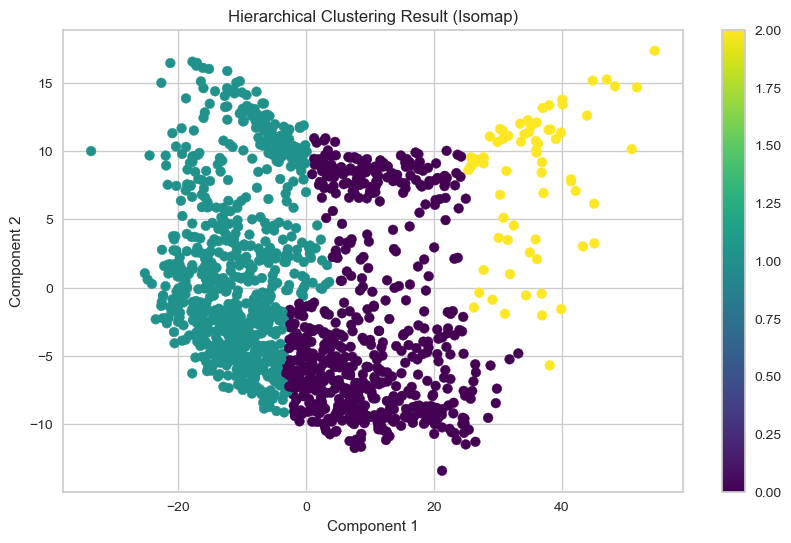

DBSCAN - Silhouette Score for Isomap: -0.47452245263881604
DBSCAN - Davies-Bouldin Index for Isomap: 1.4063029050011595
DBSCAN - Calinski-Harabasz Index for Isomap: 8.019803364505739


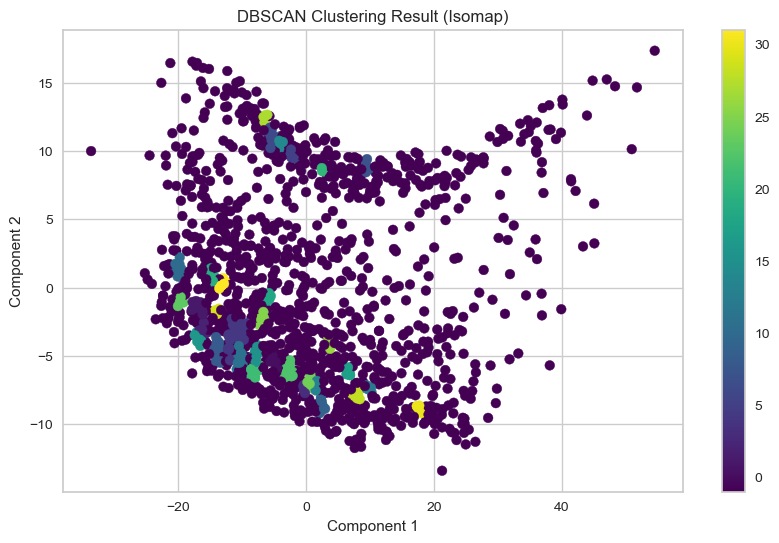

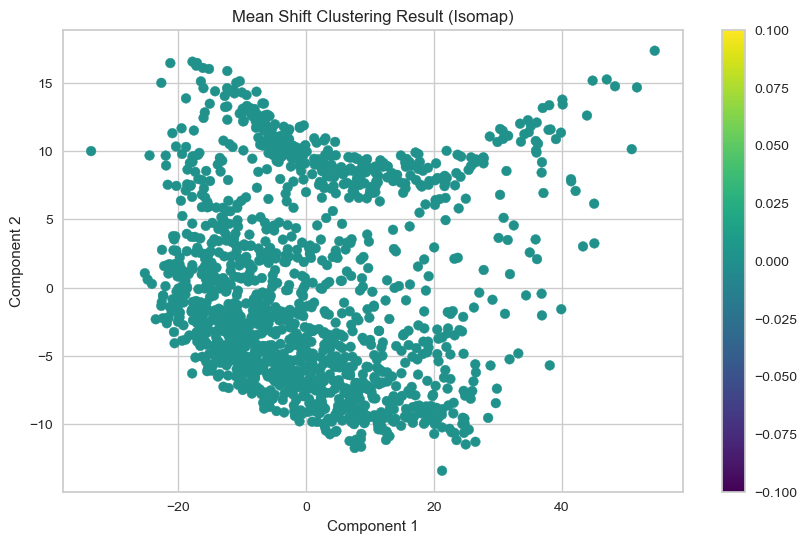

Affinity Propagation - Silhouette Score for Isomap: 0.34756479103262394
Affinity Propagation - Davies-Bouldin Index for Isomap: 0.7701295603388709
Affinity Propagation - Calinski-Harabasz Index for Isomap: 1708.2426902996783


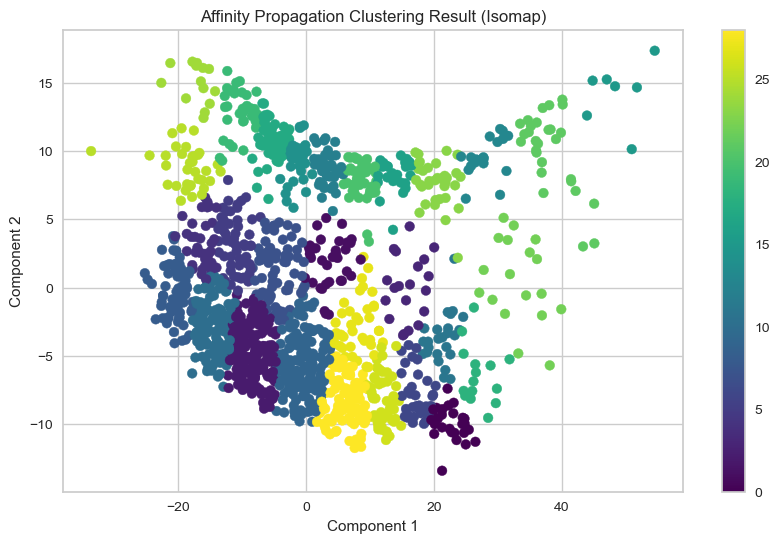

Birch - Silhouette Score for Isomap: 0.3224026716066192
Birch - Davies-Bouldin Index for Isomap: 0.9617360260134706
Birch - Calinski-Harabasz Index for Isomap: 1287.020125176936


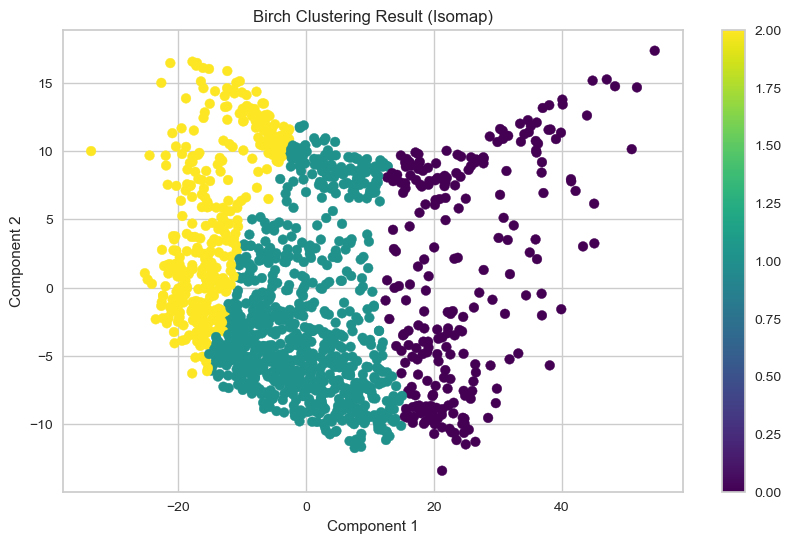

OPTICS - Silhouette Score for Isomap: -0.19767125817255515
OPTICS - Davies-Bouldin Index for Isomap: 1.5820211111398943
OPTICS - Calinski-Harabasz Index for Isomap: 12.647508299630152


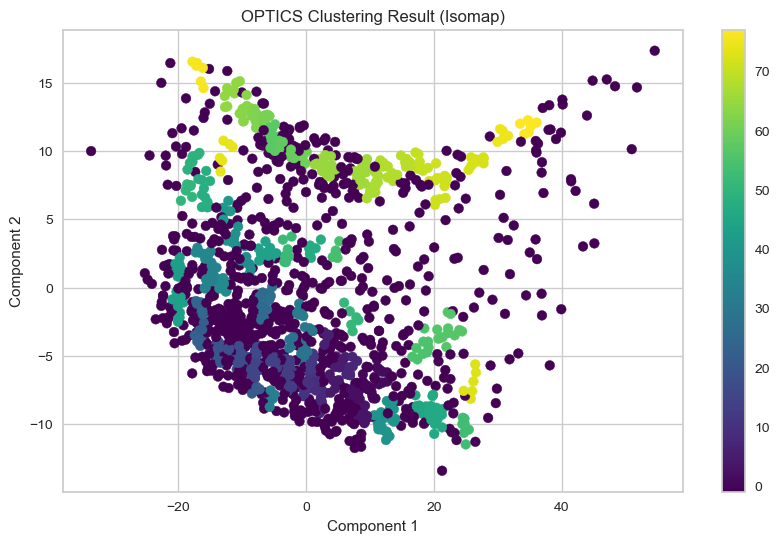

Spectral Clustering - Silhouette Score for Isomap: 0.2438558718039166
Spectral Clustering - Davies-Bouldin Index for Isomap: 0.530115978828186
Spectral Clustering - Calinski-Harabasz Index for Isomap: 46.03561219064077


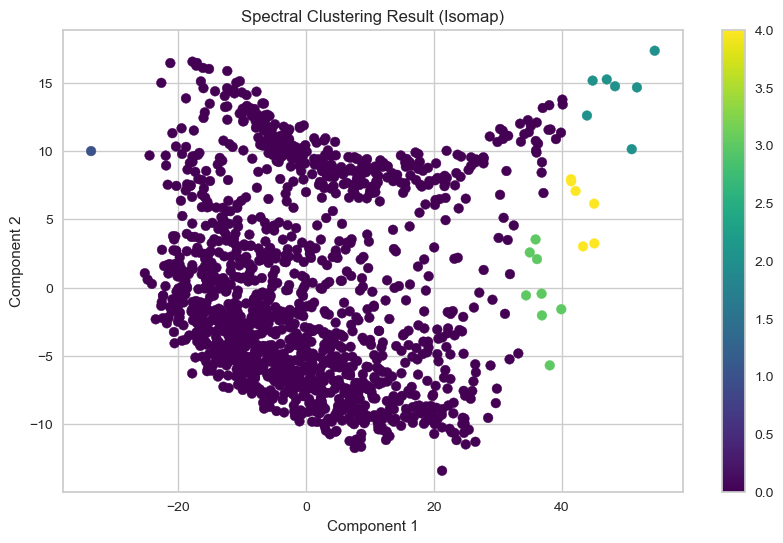

In [57]:
evaluate_clustering(isomap_result, 'Isomap')

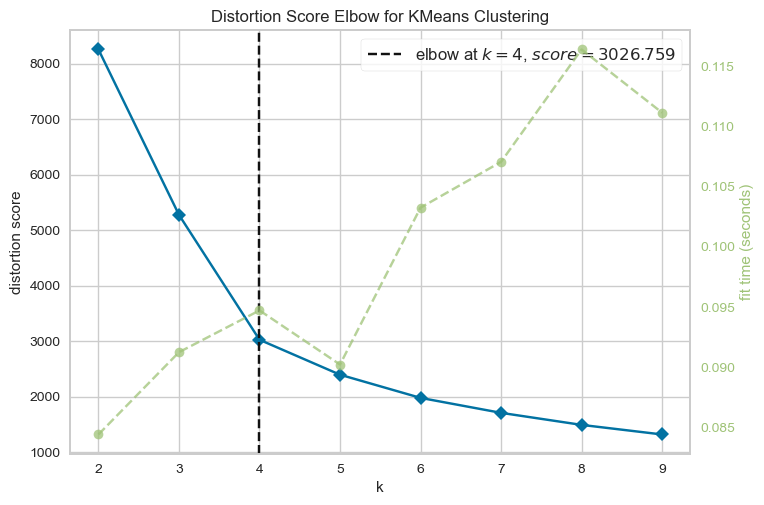

KMeans - Silhouette Score for Isomap_MM: 0.5044698707518831
KMeans - Davies-Bouldin Index for Isomap_MM: 0.6724248299371596
KMeans - Calinski-Harabasz Index for Isomap_MM: 2233.6699041312922


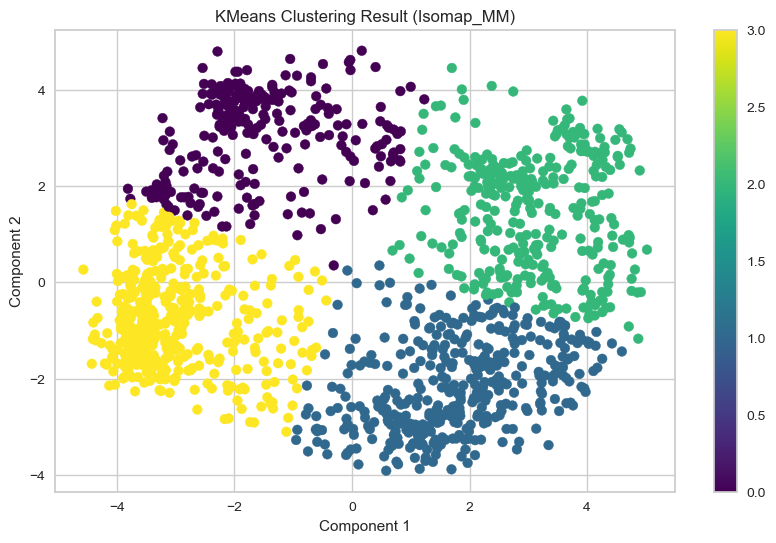

GMM - Silhouette Score for Isomap_MM: 0.4656889596900004
GMM - Davies-Bouldin Index for Isomap_MM: 0.7478957831892528
GMM - Calinski-Harabasz Index for Isomap_MM: 1571.401659108904


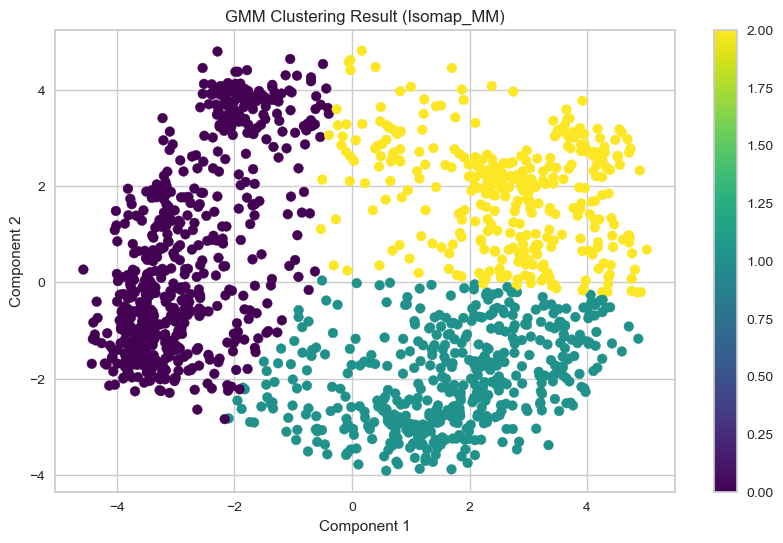

Hierarchical Clustering - Silhouette Score for Isomap_MM: 0.464470029907159
Hierarchical Clustering - Davies-Bouldin Index for Isomap_MM: 0.849562835829322
Hierarchical Clustering - Calinski-Harabasz Index for Isomap_MM: 1460.5003369470649


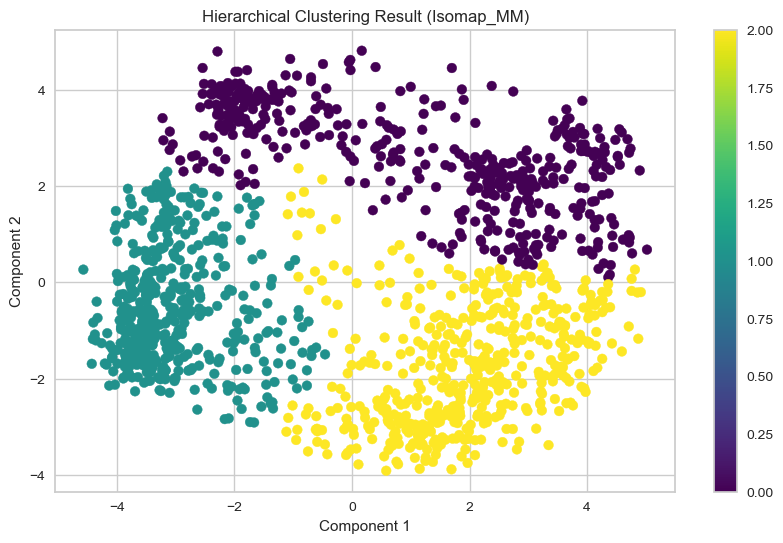

DBSCAN - Silhouette Score for Isomap_MM: 0.10385833257594532
DBSCAN - Davies-Bouldin Index for Isomap_MM: 2.6334370949348083
DBSCAN - Calinski-Harabasz Index for Isomap_MM: 2.5920285819996423


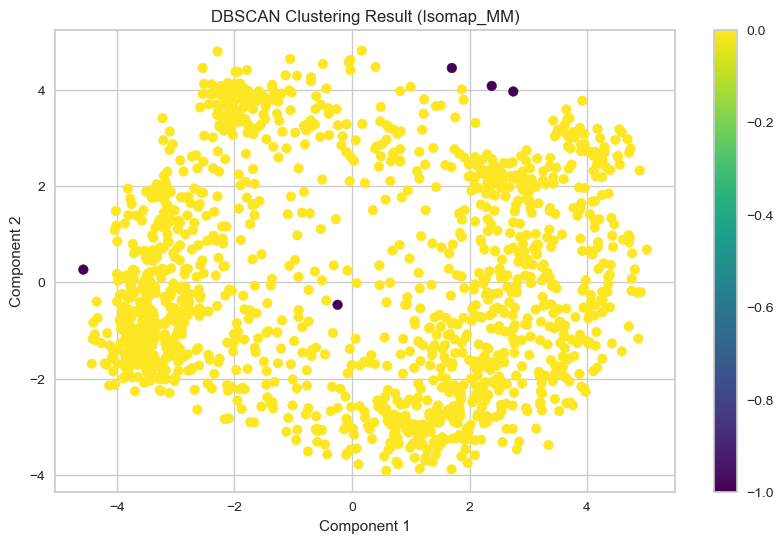

Mean Shift - Silhouette Score for Isomap_MM: 0.4840809293495281
Mean Shift - Davies-Bouldin Index for Isomap_MM: 0.8704619383566075
Mean Shift - Calinski-Harabasz Index for Isomap_MM: 1552.6234444590832


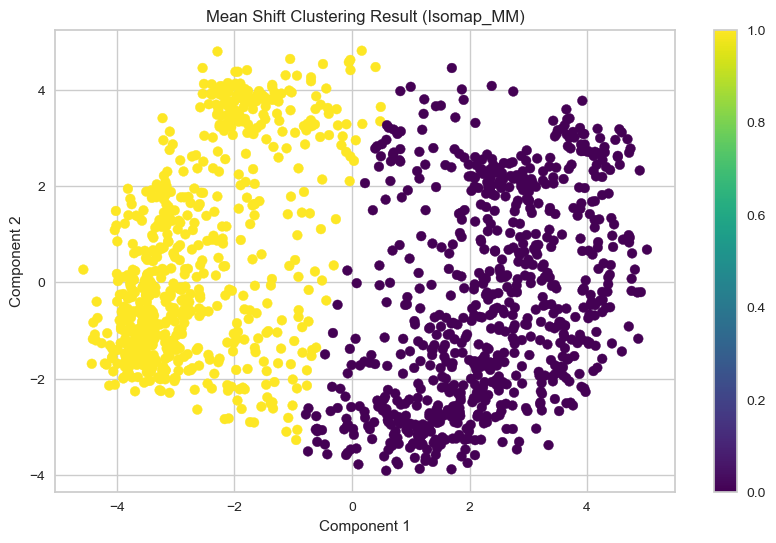

Affinity Propagation - Silhouette Score for Isomap_MM: 0.27622210568746525
Affinity Propagation - Davies-Bouldin Index for Isomap_MM: 0.9289790750008853
Affinity Propagation - Calinski-Harabasz Index for Isomap_MM: 1187.0401650780127


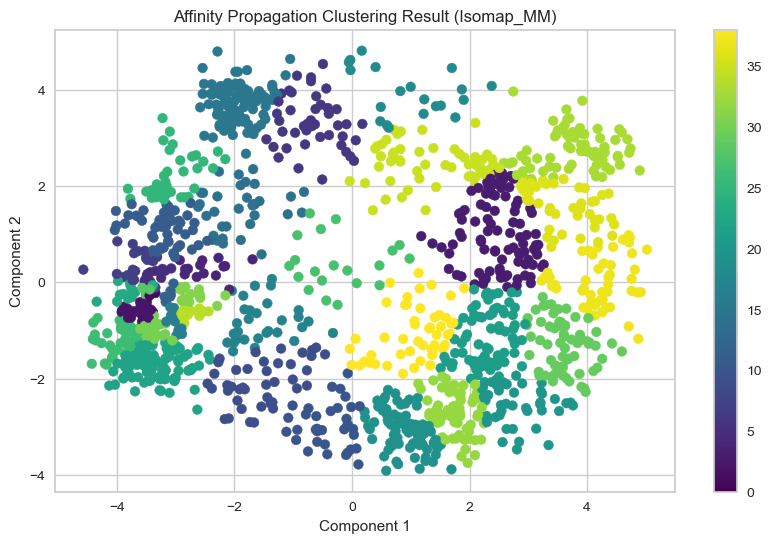

Birch - Silhouette Score for Isomap_MM: 0.4733579842461422
Birch - Davies-Bouldin Index for Isomap_MM: 0.8292034037339856
Birch - Calinski-Harabasz Index for Isomap_MM: 1534.356333828129


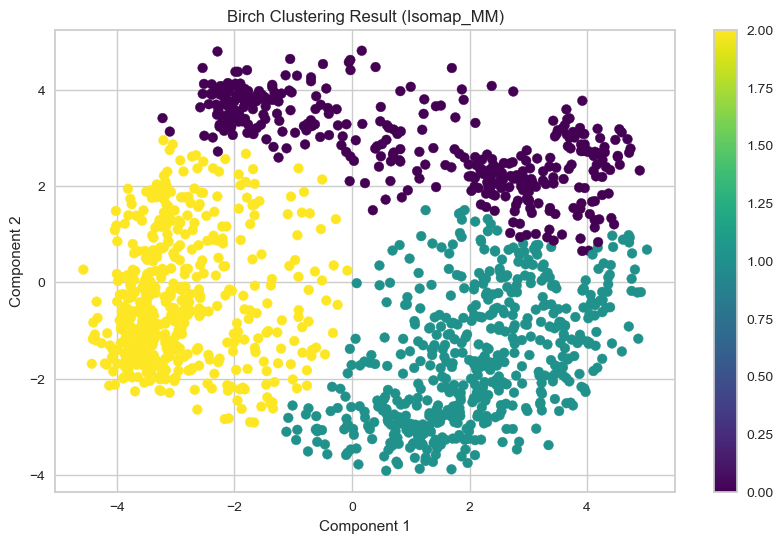

OPTICS - Silhouette Score for Isomap_MM: -0.20846041992557496
OPTICS - Davies-Bouldin Index for Isomap_MM: 1.250138215915354
OPTICS - Calinski-Harabasz Index for Isomap_MM: 13.807128789331273


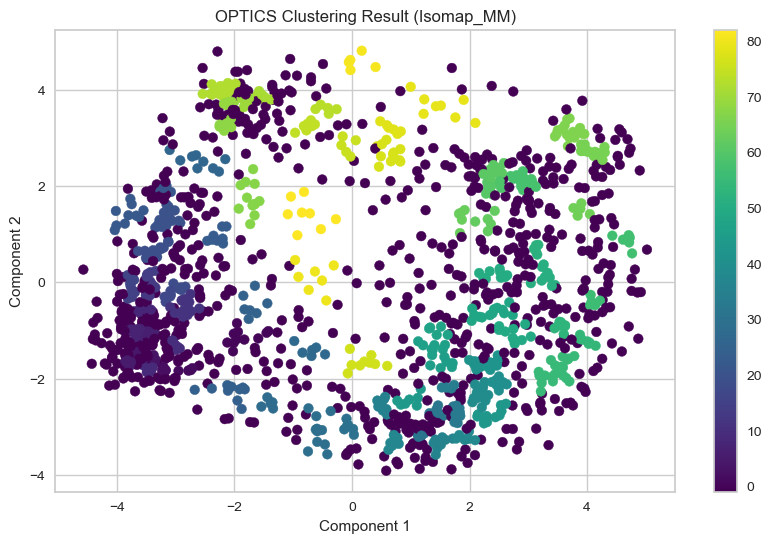

Spectral Clustering - Silhouette Score for Isomap_MM: 0.4970456469900742
Spectral Clustering - Davies-Bouldin Index for Isomap_MM: 0.6333053686492882
Spectral Clustering - Calinski-Harabasz Index for Isomap_MM: 2057.251684727845


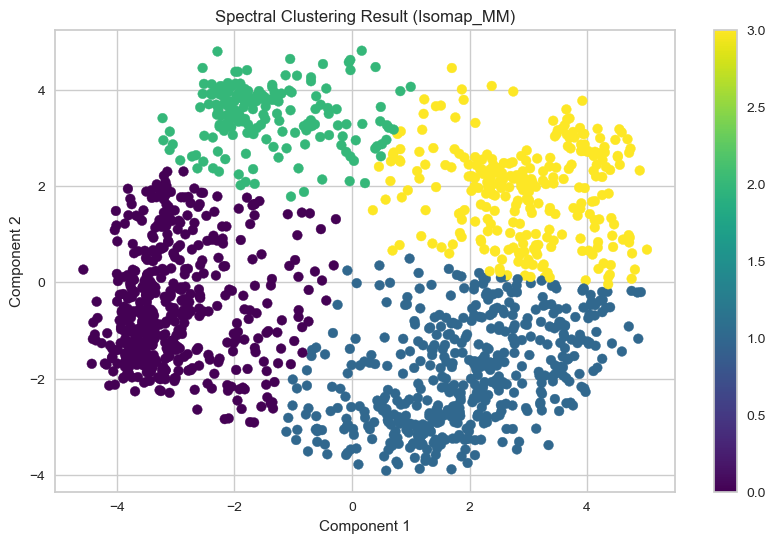

In [59]:
evaluate_clustering(isomap_result_MM, 'Isomap_MM')

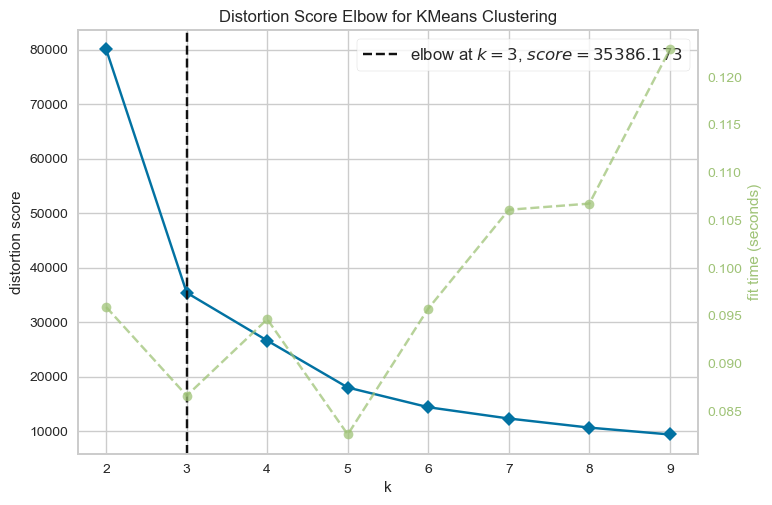

KMeans - Silhouette Score for Isomap_S: 0.5603423247482178
KMeans - Davies-Bouldin Index for Isomap_S: 0.5800867680994827
KMeans - Calinski-Harabasz Index for Isomap_S: 2596.4772528405456


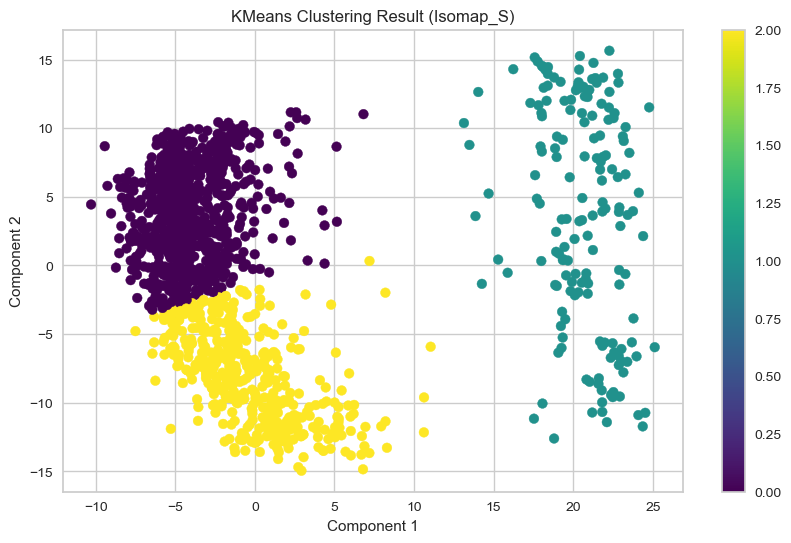

GMM - Silhouette Score for Isomap_S: 0.5613313909534542
GMM - Davies-Bouldin Index for Isomap_S: 0.5747276776787492
GMM - Calinski-Harabasz Index for Isomap_S: 2587.574660889836


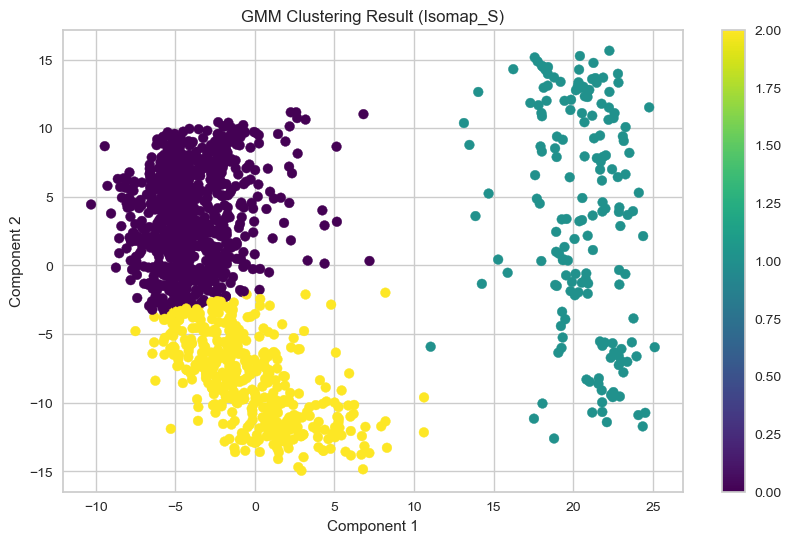

Hierarchical Clustering - Silhouette Score for Isomap_S: 0.5494469823672434
Hierarchical Clustering - Davies-Bouldin Index for Isomap_S: 0.5945801717704621
Hierarchical Clustering - Calinski-Harabasz Index for Isomap_S: 2544.2928413182535


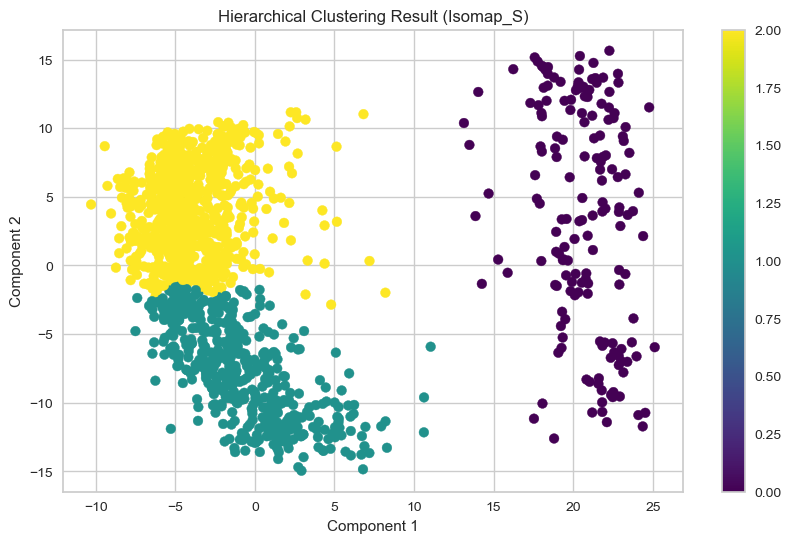

DBSCAN - Silhouette Score for Isomap_S: -0.3139523080697323
DBSCAN - Davies-Bouldin Index for Isomap_S: 1.0796877800208253
DBSCAN - Calinski-Harabasz Index for Isomap_S: 68.29027797897686


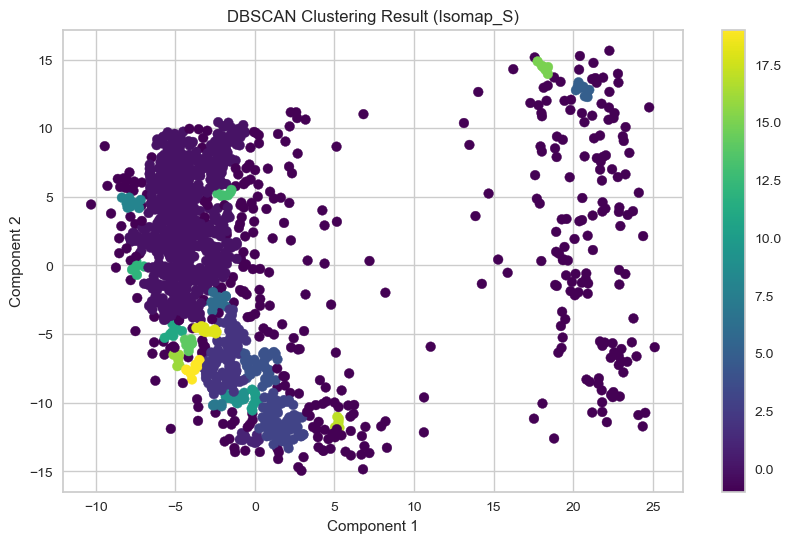

Mean Shift - Silhouette Score for Isomap_S: 0.6089630067500269
Mean Shift - Davies-Bouldin Index for Isomap_S: 0.5996454915574887
Mean Shift - Calinski-Harabasz Index for Isomap_S: 928.5643203569626


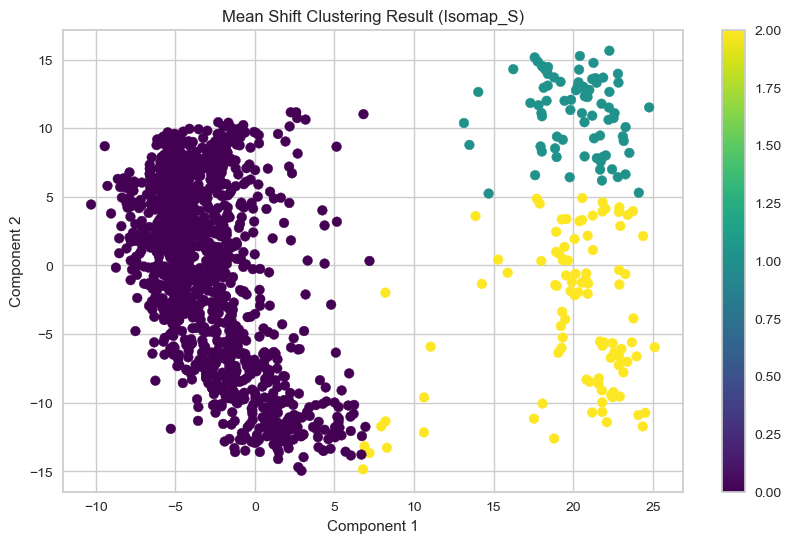

Affinity Propagation - Silhouette Score for Isomap_S: 0.24548290962354
Affinity Propagation - Davies-Bouldin Index for Isomap_S: 0.7787324466700095
Affinity Propagation - Calinski-Harabasz Index for Isomap_S: 1009.2038370531862


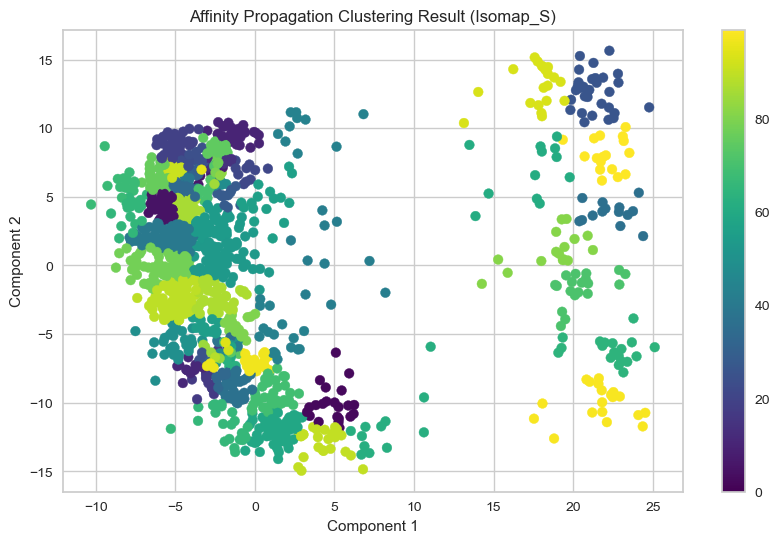

Birch - Silhouette Score for Isomap_S: 0.5202147742281032
Birch - Davies-Bouldin Index for Isomap_S: 0.5617825052748825
Birch - Calinski-Harabasz Index for Isomap_S: 2058.198203604197


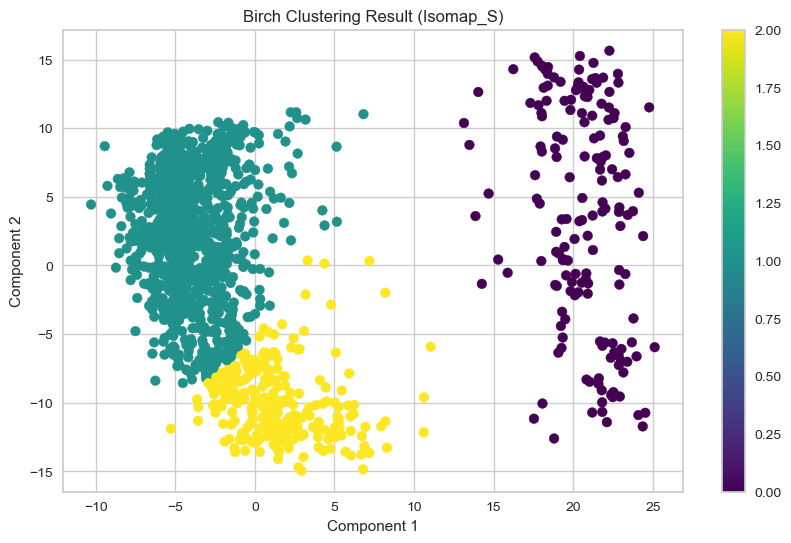

OPTICS - Silhouette Score for Isomap_S: -0.14671771042852594
OPTICS - Davies-Bouldin Index for Isomap_S: 1.5050093676412624
OPTICS - Calinski-Harabasz Index for Isomap_S: 16.070299953793572


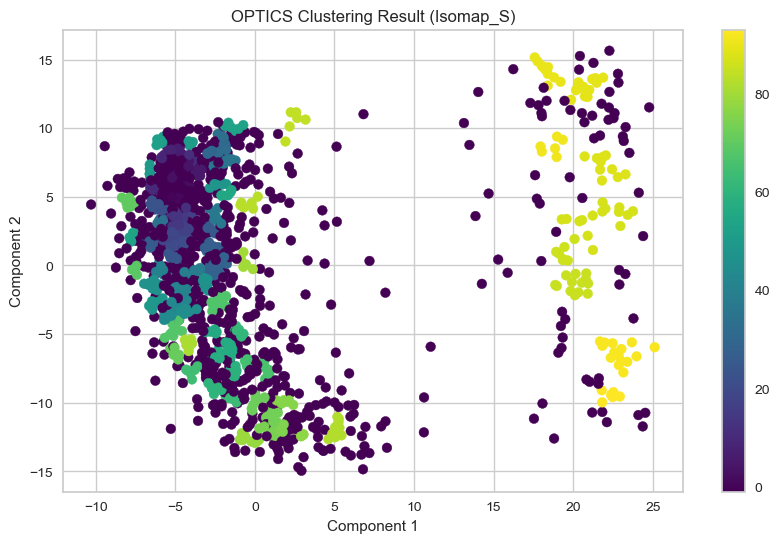

Spectral Clustering - Silhouette Score for Isomap_S: 0.6101917342863138
Spectral Clustering - Davies-Bouldin Index for Isomap_S: 0.5263590931745844
Spectral Clustering - Calinski-Harabasz Index for Isomap_S: 877.4988230897832


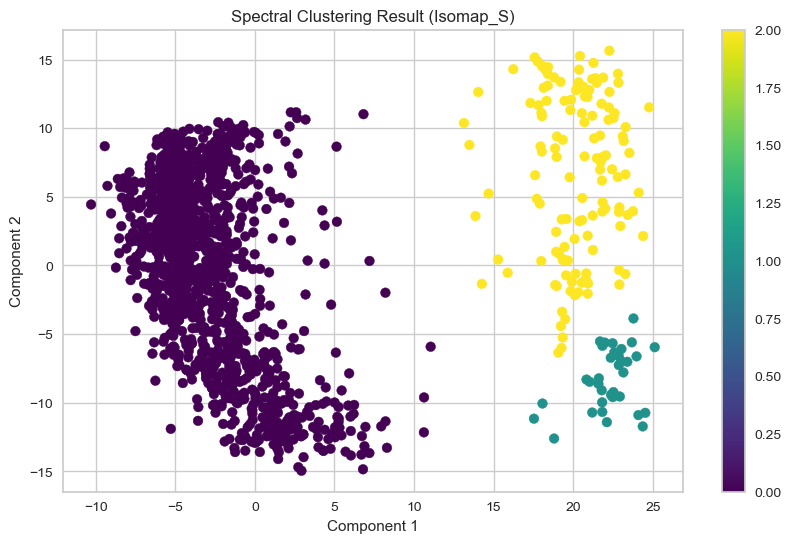

In [60]:
evaluate_clustering(isomap_result_S, 'Isomap_S')

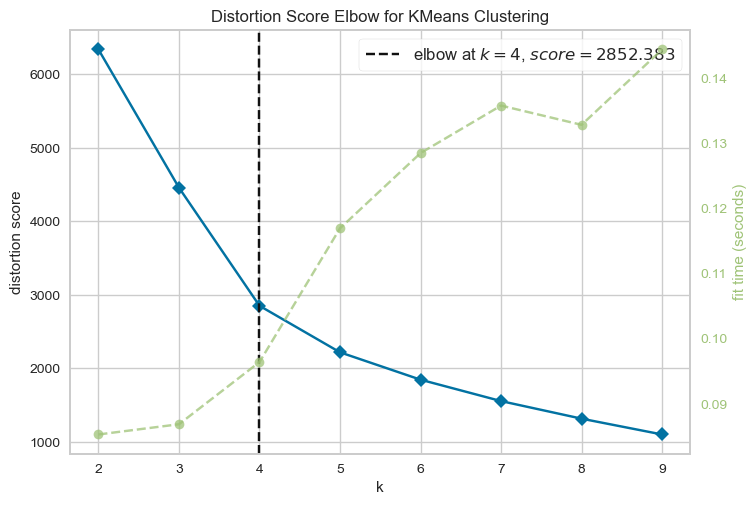

KMeans - Silhouette Score for UMAP: 0.45185011625289917
KMeans - Davies-Bouldin Index for UMAP: 0.7287950463400685
KMeans - Calinski-Harabasz Index for UMAP: 1873.8482146933738


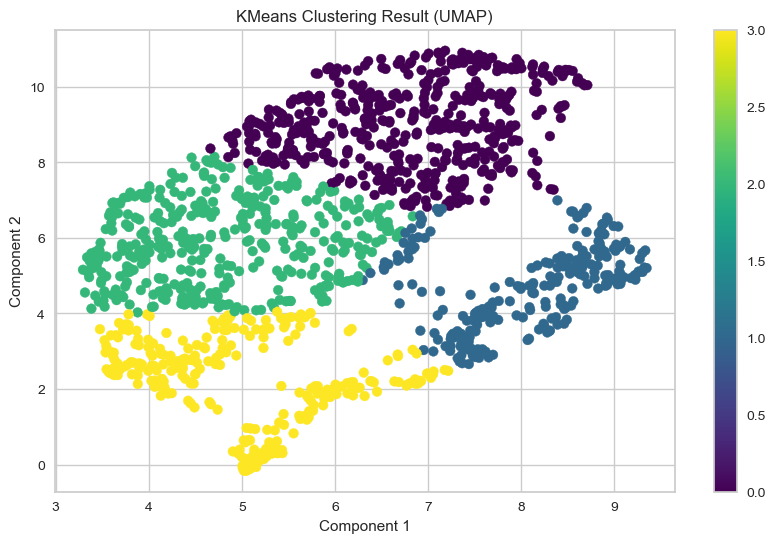

GMM - Silhouette Score for UMAP: 0.38037753105163574
GMM - Davies-Bouldin Index for UMAP: 1.0551364940515429
GMM - Calinski-Harabasz Index for UMAP: 1362.4350358446854


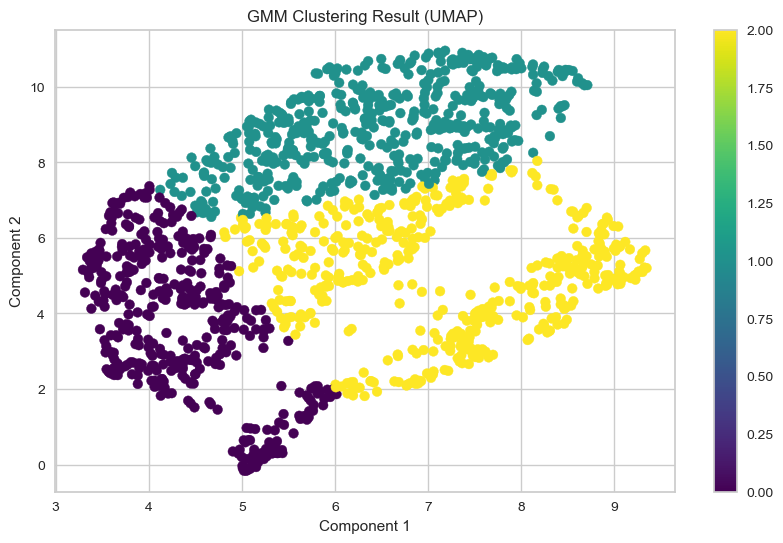

Hierarchical Clustering - Silhouette Score for UMAP: 0.3645873963832855
Hierarchical Clustering - Davies-Bouldin Index for UMAP: 0.9278851759548083
Hierarchical Clustering - Calinski-Harabasz Index for UMAP: 1411.1240566018546


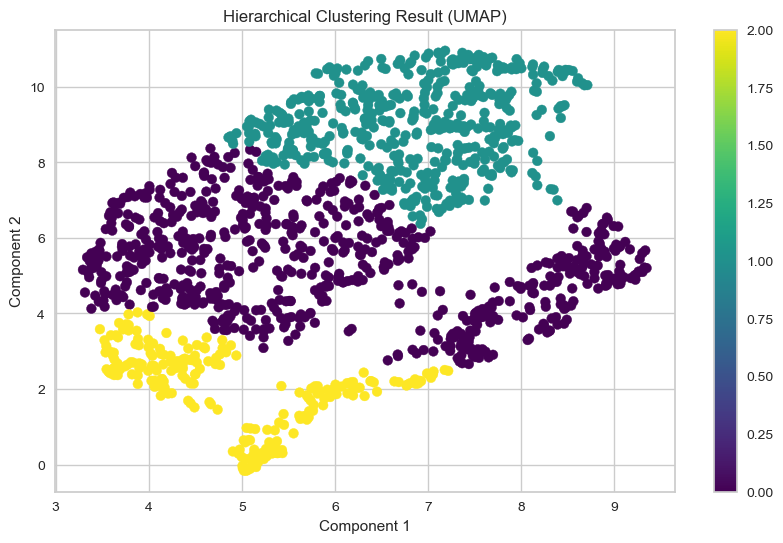

DBSCAN - Insufficient clusters for UMAP


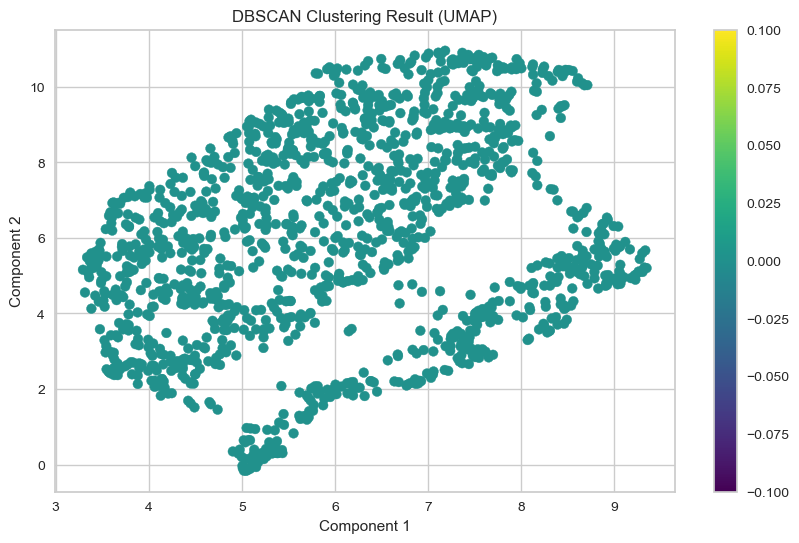

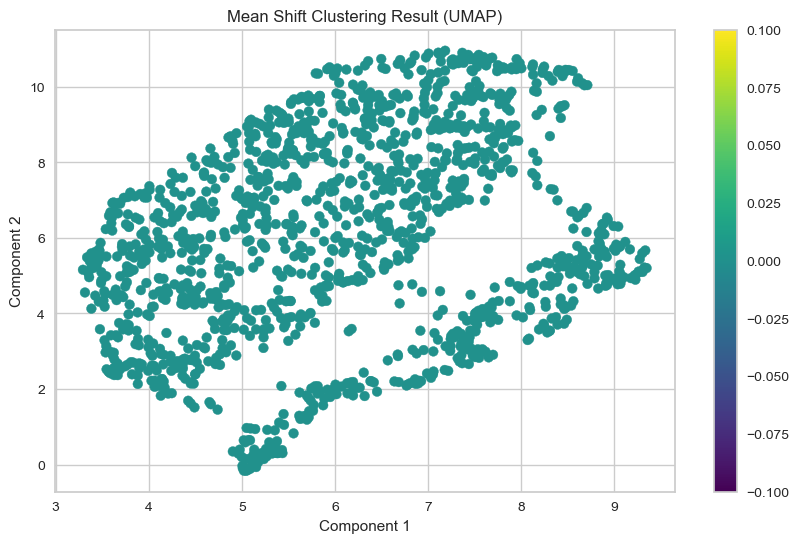

Affinity Propagation - Silhouette Score for UMAP: 0.35442858934402466
Affinity Propagation - Davies-Bouldin Index for UMAP: 0.8313124852324474
Affinity Propagation - Calinski-Harabasz Index for UMAP: 2147.3923626452097


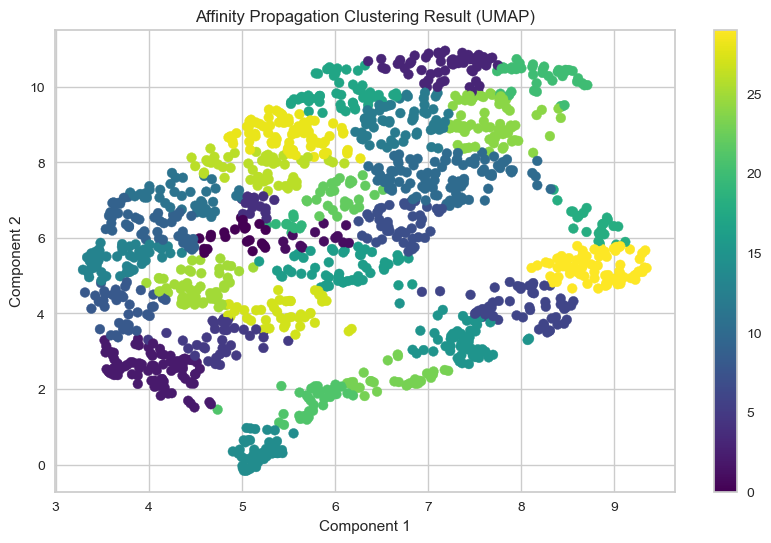

Birch - Silhouette Score for UMAP: 0.37881800532341003
Birch - Davies-Bouldin Index for UMAP: 0.9493713807921896
Birch - Calinski-Harabasz Index for UMAP: 1448.9863620618812


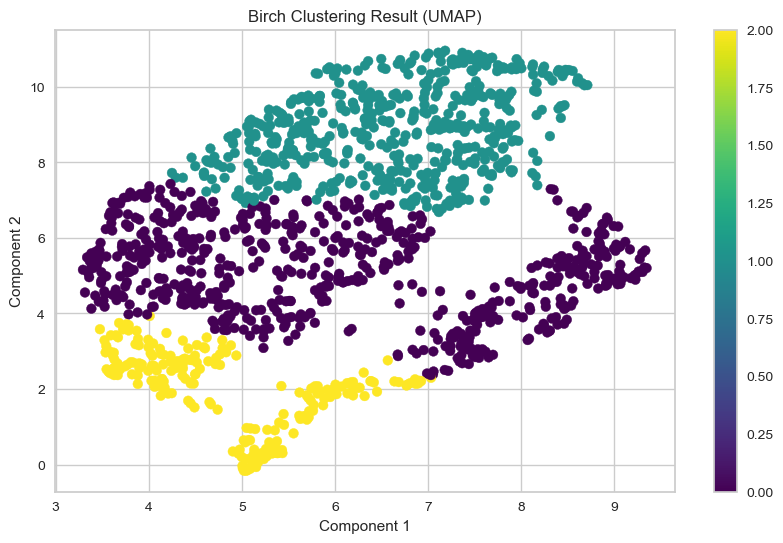

OPTICS - Silhouette Score for UMAP: -0.0404324010014534
OPTICS - Davies-Bouldin Index for UMAP: 1.6630607511963953
OPTICS - Calinski-Harabasz Index for UMAP: 19.796136031894882


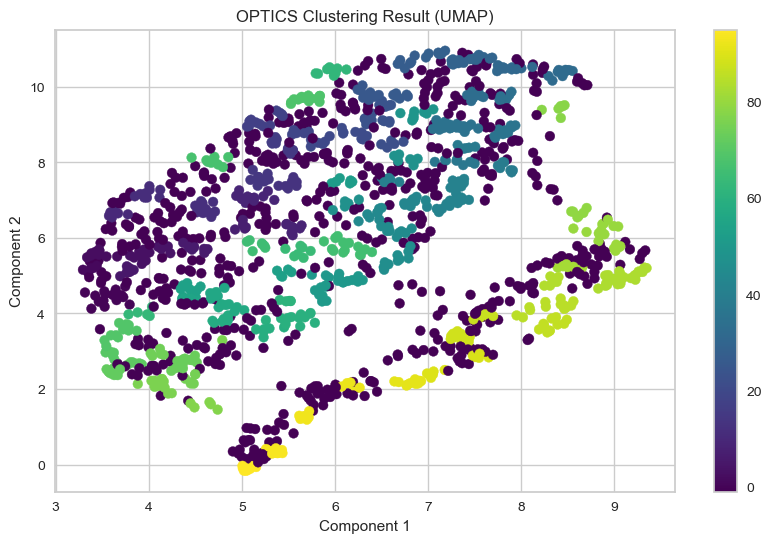

Spectral Clustering - Silhouette Score for UMAP: 0.4378880262374878
Spectral Clustering - Davies-Bouldin Index for UMAP: 0.7307382227466123
Spectral Clustering - Calinski-Harabasz Index for UMAP: 1485.5863702590684


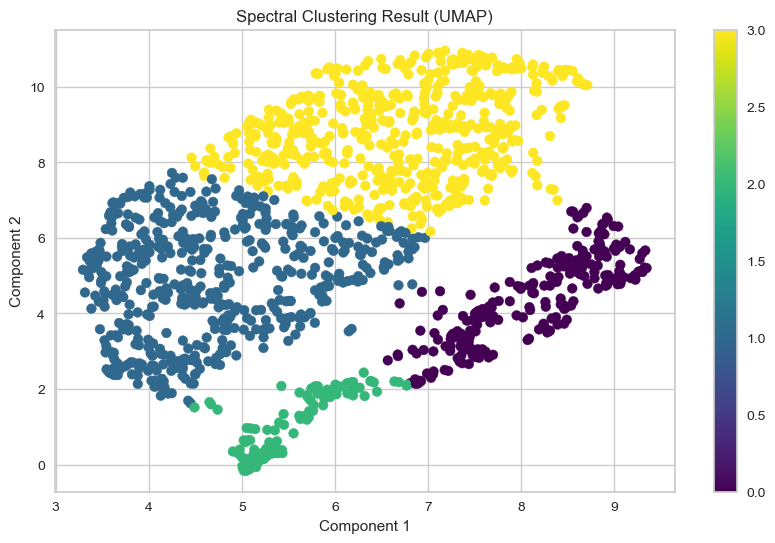

In [63]:
evaluate_clustering(umap_result, 'UMAP')

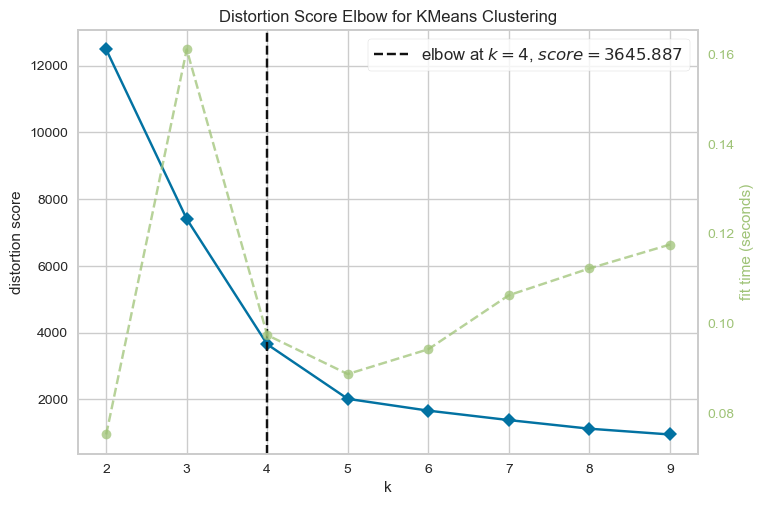

KMeans - Silhouette Score for UMAP_MM: 0.6011040210723877
KMeans - Davies-Bouldin Index for UMAP_MM: 0.5943689692767503
KMeans - Calinski-Harabasz Index for UMAP_MM: 3455.7719510076713


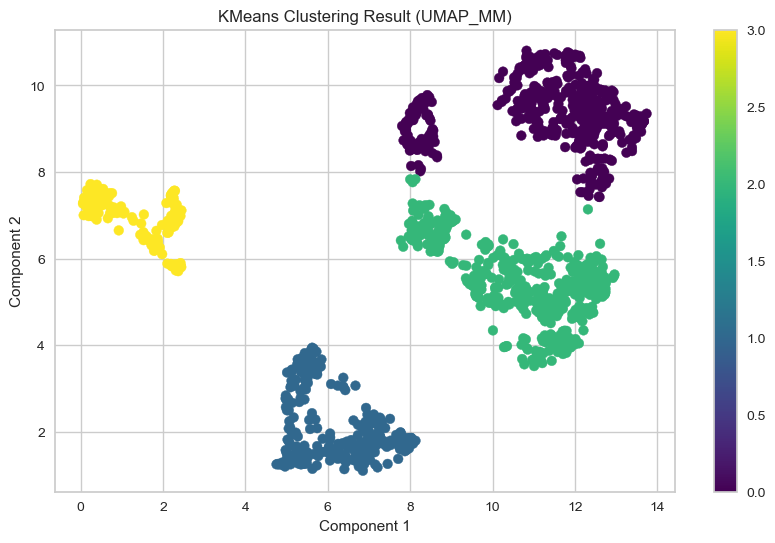

GMM - Silhouette Score for UMAP_MM: 0.4941735863685608
GMM - Davies-Bouldin Index for UMAP_MM: 0.7708899708309497
GMM - Calinski-Harabasz Index for UMAP_MM: 1749.9802931421905


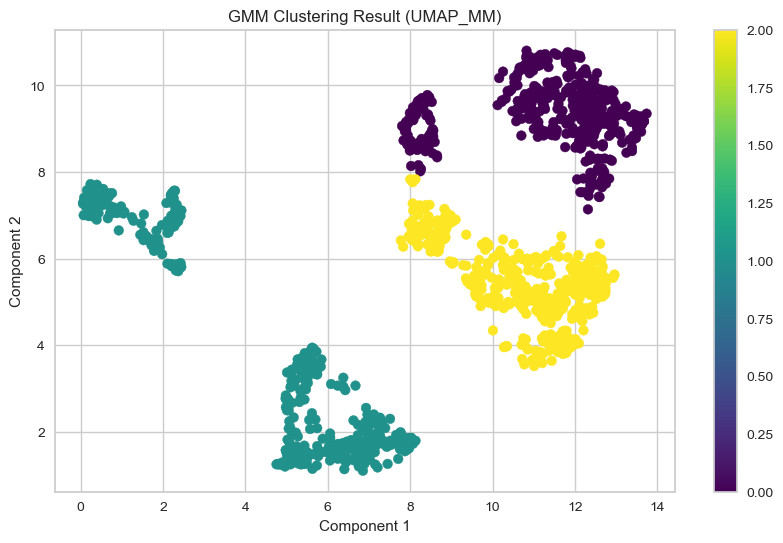

Hierarchical Clustering - Silhouette Score for UMAP_MM: 0.604874312877655
Hierarchical Clustering - Davies-Bouldin Index for UMAP_MM: 0.4758575126470135
Hierarchical Clustering - Calinski-Harabasz Index for UMAP_MM: 2190.9051184029895


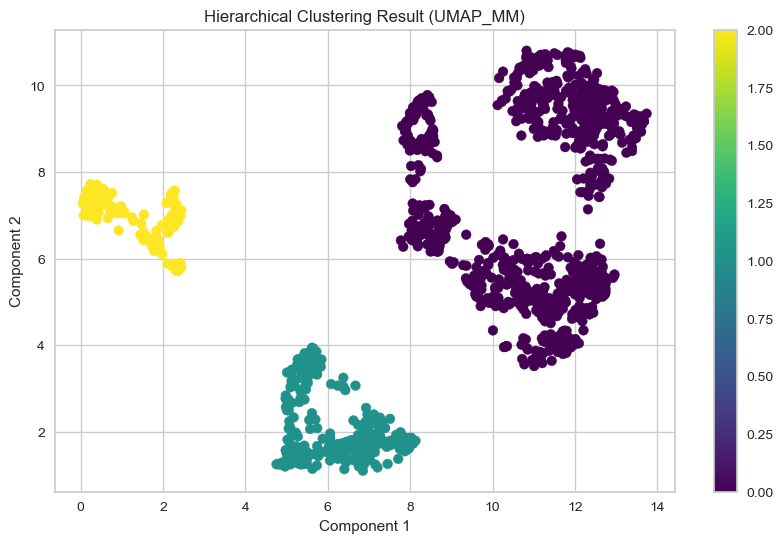

DBSCAN - Silhouette Score for UMAP_MM: 0.5874010920524597
DBSCAN - Davies-Bouldin Index for UMAP_MM: 0.6263283882103874
DBSCAN - Calinski-Harabasz Index for UMAP_MM: 3094.0518916898577


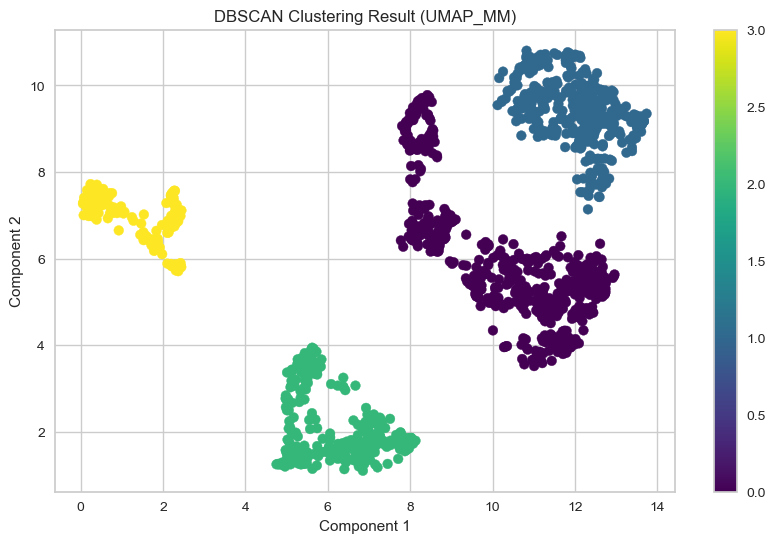

Mean Shift - Silhouette Score for UMAP_MM: 0.604874312877655
Mean Shift - Davies-Bouldin Index for UMAP_MM: 0.4758575126470135
Mean Shift - Calinski-Harabasz Index for UMAP_MM: 2190.9051184029895


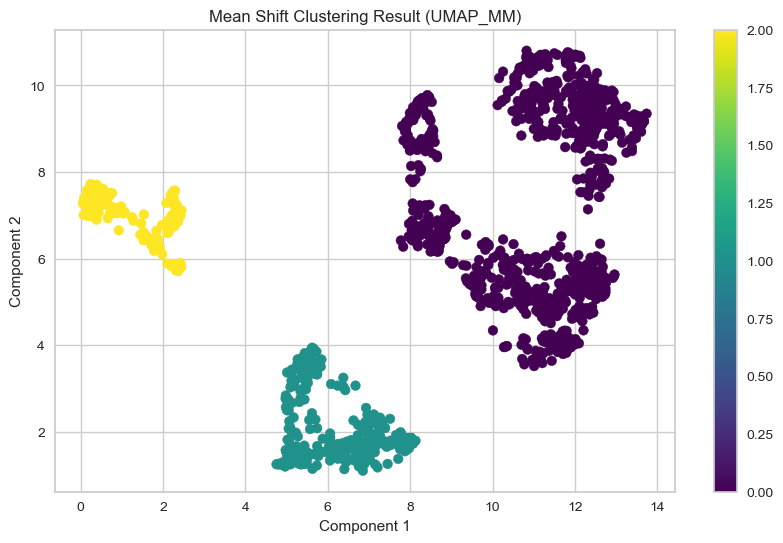

Affinity Propagation - Silhouette Score for UMAP_MM: 0.3552566468715668
Affinity Propagation - Davies-Bouldin Index for UMAP_MM: 0.33725749753818
Affinity Propagation - Calinski-Harabasz Index for UMAP_MM: 904.0265282670229


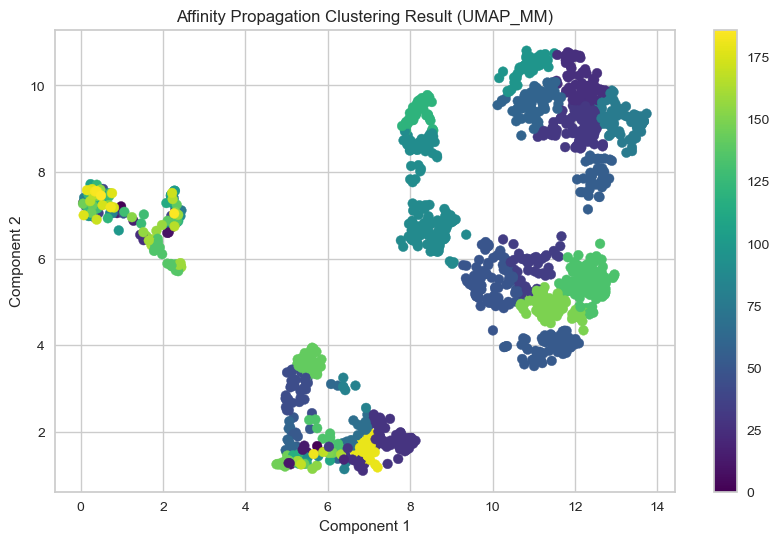

Birch - Silhouette Score for UMAP_MM: 0.604874312877655
Birch - Davies-Bouldin Index for UMAP_MM: 0.4758575126470135
Birch - Calinski-Harabasz Index for UMAP_MM: 2190.9051184029895


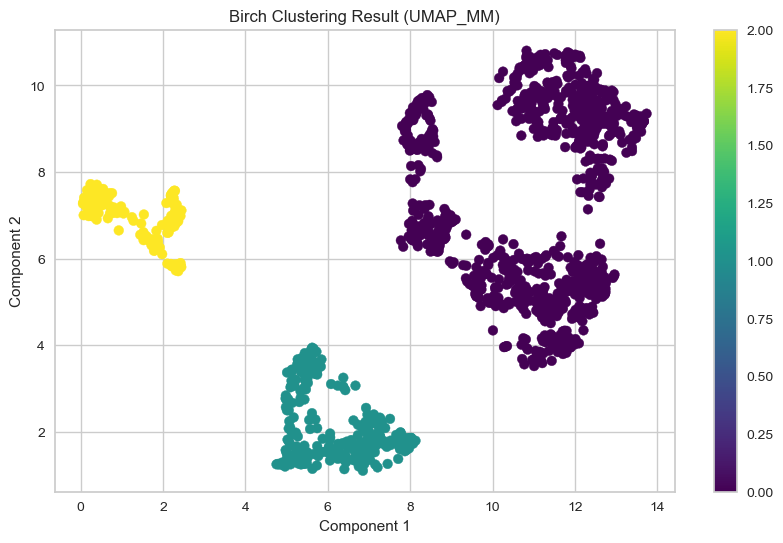

OPTICS - Silhouette Score for UMAP_MM: -0.08537190407514572
OPTICS - Davies-Bouldin Index for UMAP_MM: 1.6551033344205373
OPTICS - Calinski-Harabasz Index for UMAP_MM: 18.338776017653707


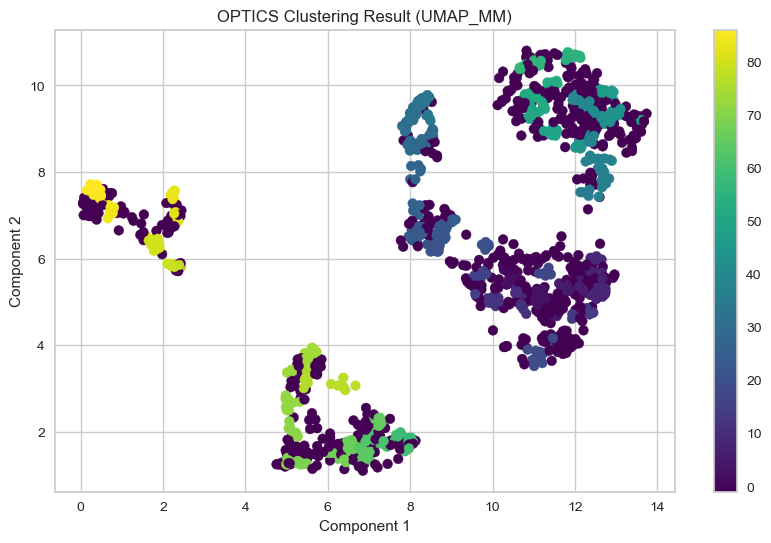

Spectral Clustering - Silhouette Score for UMAP_MM: 0.5874010920524597
Spectral Clustering - Davies-Bouldin Index for UMAP_MM: 0.6263283882103874
Spectral Clustering - Calinski-Harabasz Index for UMAP_MM: 3094.0518916898577


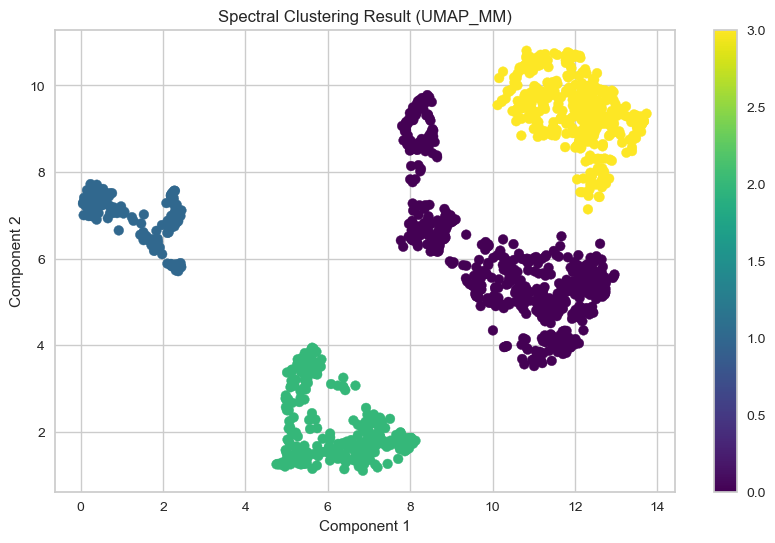

In [65]:
evaluate_clustering(umap_result_MM, 'UMAP_MM')

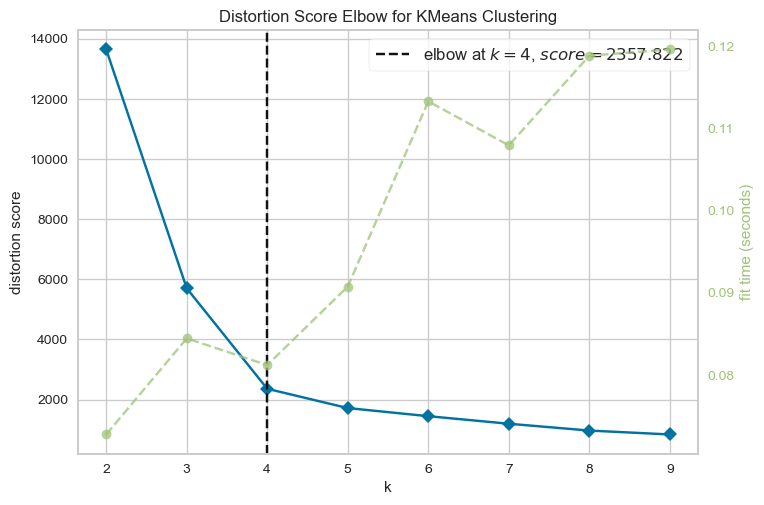

KMeans - Silhouette Score for UMAP_S: 0.6206486225128174
KMeans - Davies-Bouldin Index for UMAP_S: 0.4728139074219303
KMeans - Calinski-Harabasz Index for UMAP_S: 12140.047029281553


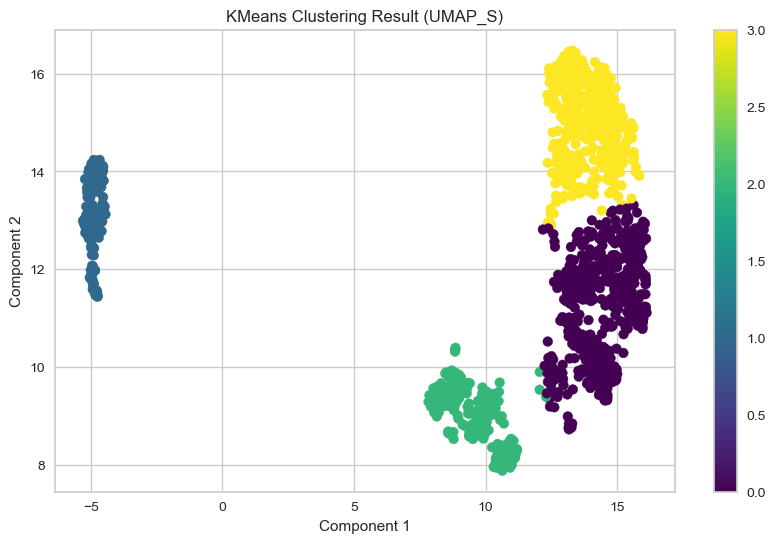

GMM - Silhouette Score for UMAP_S: 0.6137209534645081
GMM - Davies-Bouldin Index for UMAP_S: 0.4044476752055283
GMM - Calinski-Harabasz Index for UMAP_S: 6756.464323371955


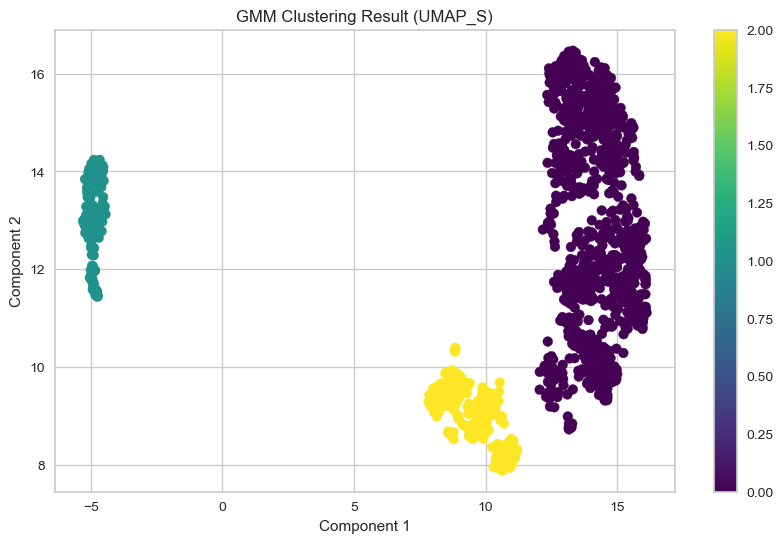

Hierarchical Clustering - Silhouette Score for UMAP_S: 0.6137209534645081
Hierarchical Clustering - Davies-Bouldin Index for UMAP_S: 0.4044476752055283
Hierarchical Clustering - Calinski-Harabasz Index for UMAP_S: 6756.464323371955


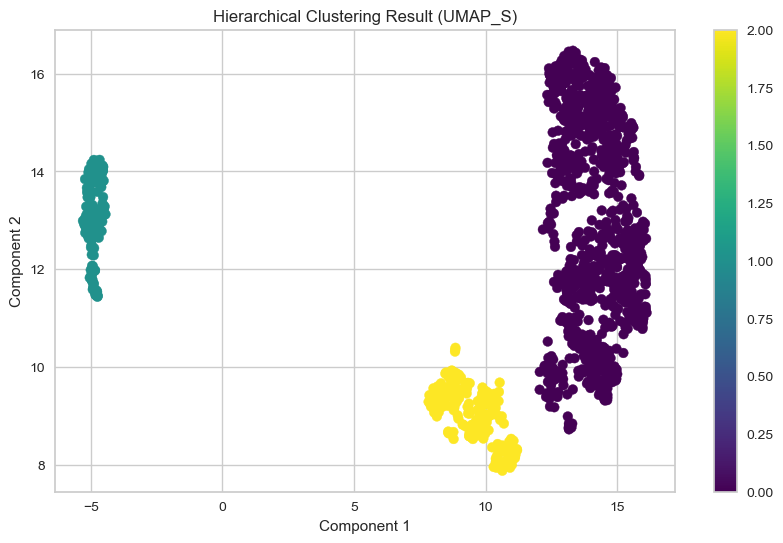

DBSCAN - Silhouette Score for UMAP_S: 0.6137209534645081
DBSCAN - Davies-Bouldin Index for UMAP_S: 0.4044476752055283
DBSCAN - Calinski-Harabasz Index for UMAP_S: 6756.464323371955


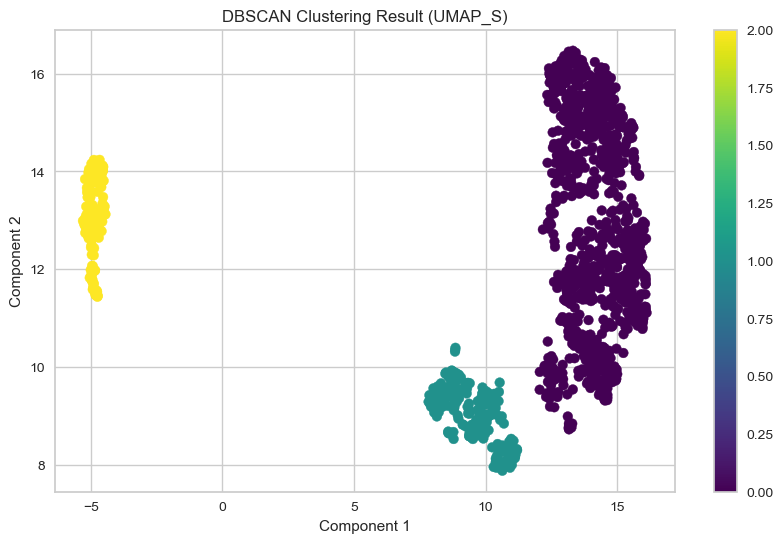

Mean Shift - Silhouette Score for UMAP_S: 0.7939804196357727
Mean Shift - Davies-Bouldin Index for UMAP_S: 0.20908448240886757
Mean Shift - Calinski-Harabasz Index for UMAP_S: 5118.705184155646


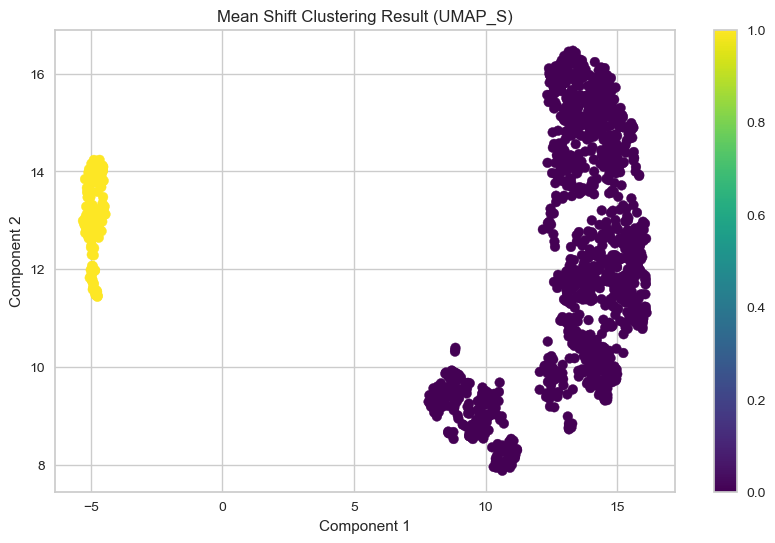

Affinity Propagation - Silhouette Score for UMAP_S: 0.2670506536960602
Affinity Propagation - Davies-Bouldin Index for UMAP_S: 0.31452051051812696
Affinity Propagation - Calinski-Harabasz Index for UMAP_S: 1249.727643781295


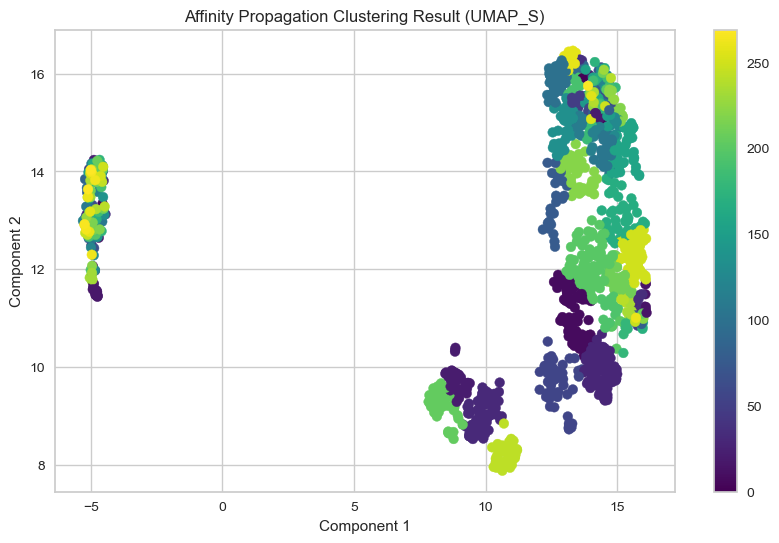

Birch - Silhouette Score for UMAP_S: 0.6137209534645081
Birch - Davies-Bouldin Index for UMAP_S: 0.4044476752055283
Birch - Calinski-Harabasz Index for UMAP_S: 6756.464323371955


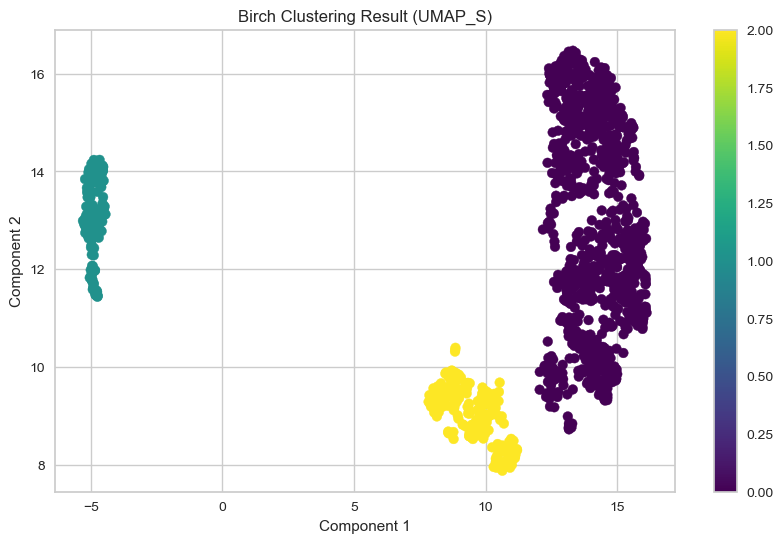

OPTICS - Silhouette Score for UMAP_S: -0.12411272525787354
OPTICS - Davies-Bouldin Index for UMAP_S: 1.3742993884261163
OPTICS - Calinski-Harabasz Index for UMAP_S: 17.350829847853255


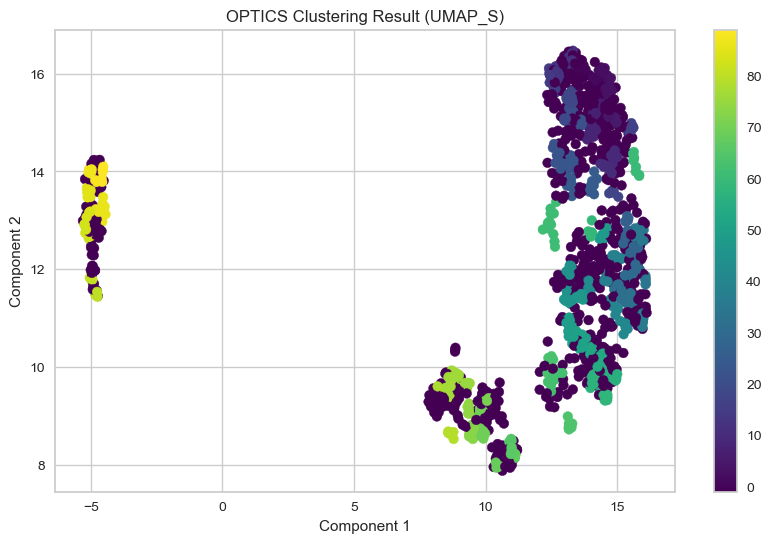

Spectral Clustering - Silhouette Score for UMAP_S: 0.6209359765052795
Spectral Clustering - Davies-Bouldin Index for UMAP_S: 0.4716020347969282
Spectral Clustering - Calinski-Harabasz Index for UMAP_S: 12122.695393005095


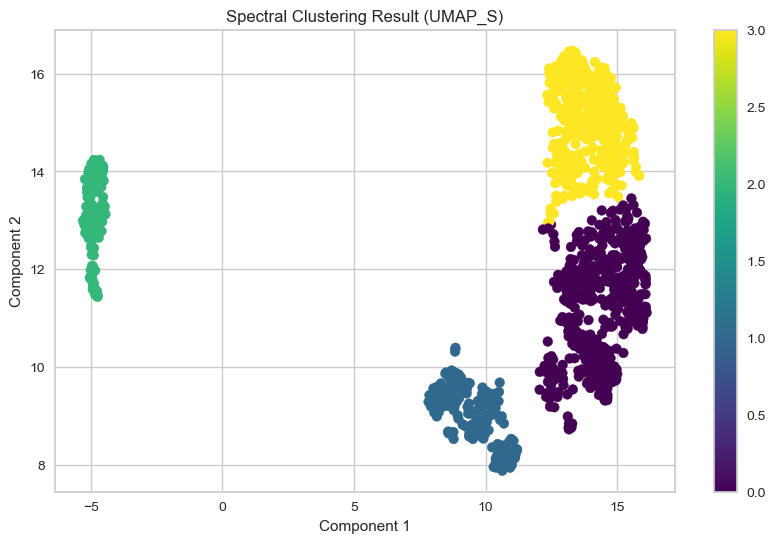

In [66]:
evaluate_clustering(umap_result_S, 'UMAP_S')

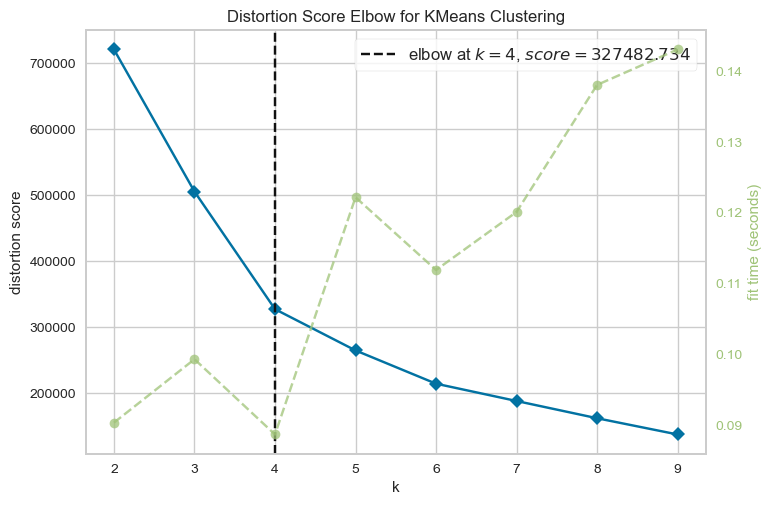

KMeans - Silhouette Score for t-SNE: 0.43962135910987854
KMeans - Davies-Bouldin Index for t-SNE: 0.7557533426384317
KMeans - Calinski-Harabasz Index for t-SNE: 1894.0954955175487


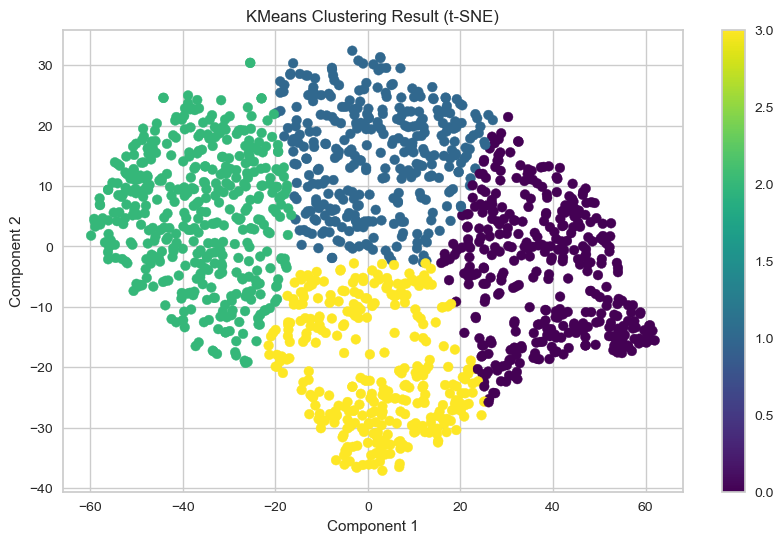

GMM - Silhouette Score for t-SNE: 0.36173930764198303
GMM - Davies-Bouldin Index for t-SNE: 1.027322392977082
GMM - Calinski-Harabasz Index for t-SNE: 1424.0315143530852


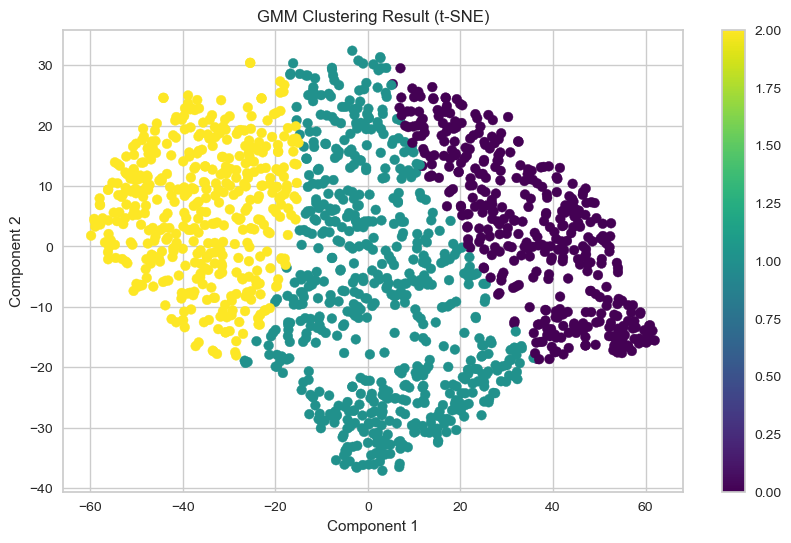

Hierarchical Clustering - Silhouette Score for t-SNE: 0.35458803176879883
Hierarchical Clustering - Davies-Bouldin Index for t-SNE: 1.0728365392150907
Hierarchical Clustering - Calinski-Harabasz Index for t-SNE: 1455.2648609127718


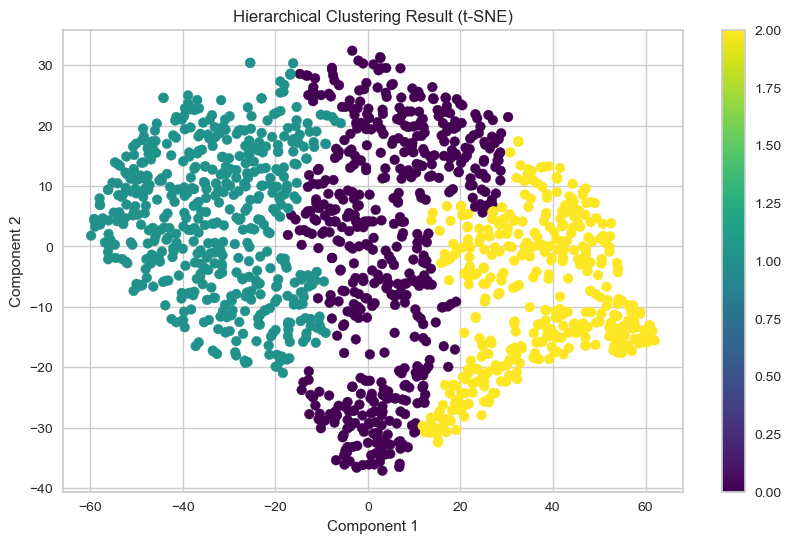

DBSCAN - Insufficient clusters for t-SNE


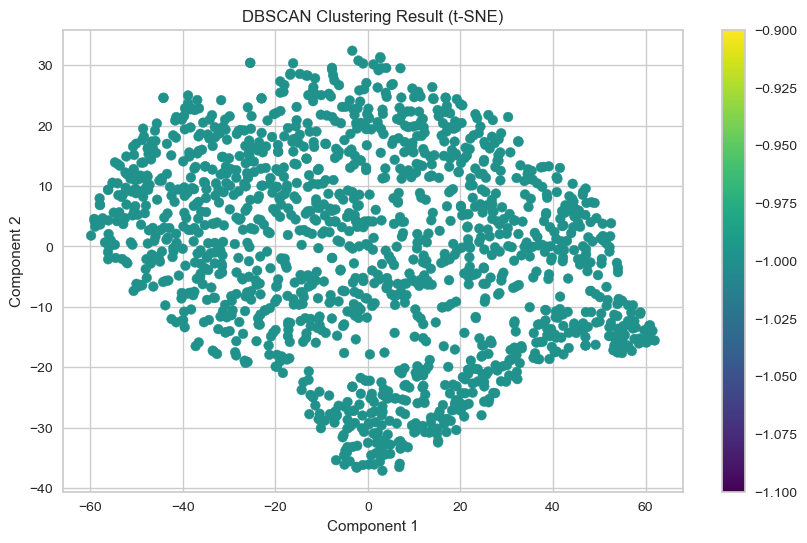

Mean Shift - Silhouette Score for t-SNE: 0.4495255947113037
Mean Shift - Davies-Bouldin Index for t-SNE: 0.8024402638178116
Mean Shift - Calinski-Harabasz Index for t-SNE: 1718.454196466872


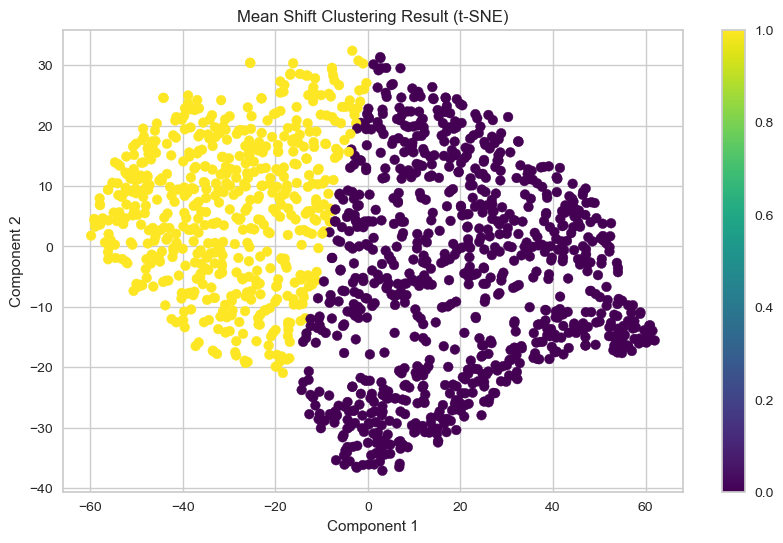

Affinity Propagation - Silhouette Score for t-SNE: 0.3555731177330017
Affinity Propagation - Davies-Bouldin Index for t-SNE: 0.8071093227967873
Affinity Propagation - Calinski-Harabasz Index for t-SNE: 1987.2484261805355


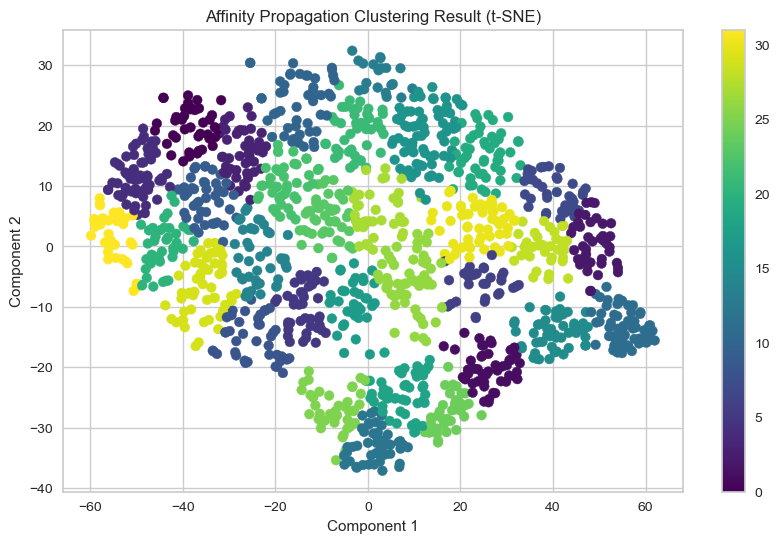

Birch - Silhouette Score for t-SNE: 0.36565616726875305
Birch - Davies-Bouldin Index for t-SNE: 1.03958842616985
Birch - Calinski-Harabasz Index for t-SNE: 1423.84705003696


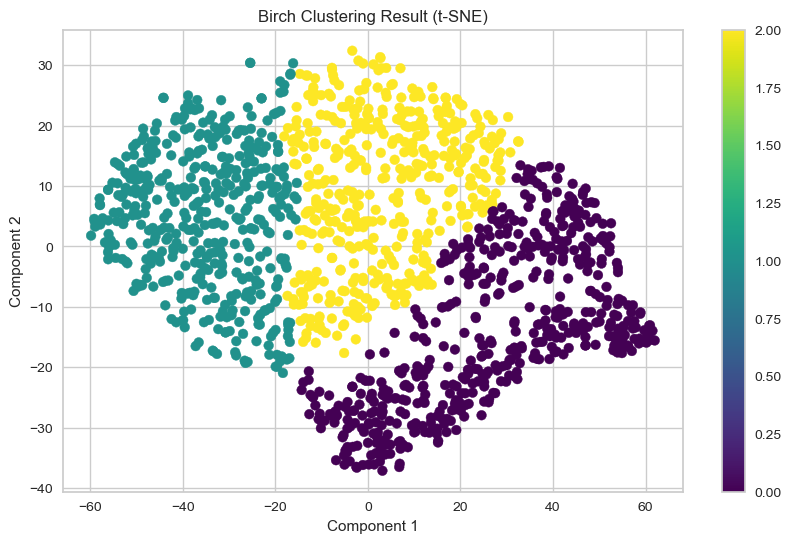

OPTICS - Silhouette Score for t-SNE: -0.25848302245140076
OPTICS - Davies-Bouldin Index for t-SNE: 4.1612085659197335
OPTICS - Calinski-Harabasz Index for t-SNE: 16.555380852993572


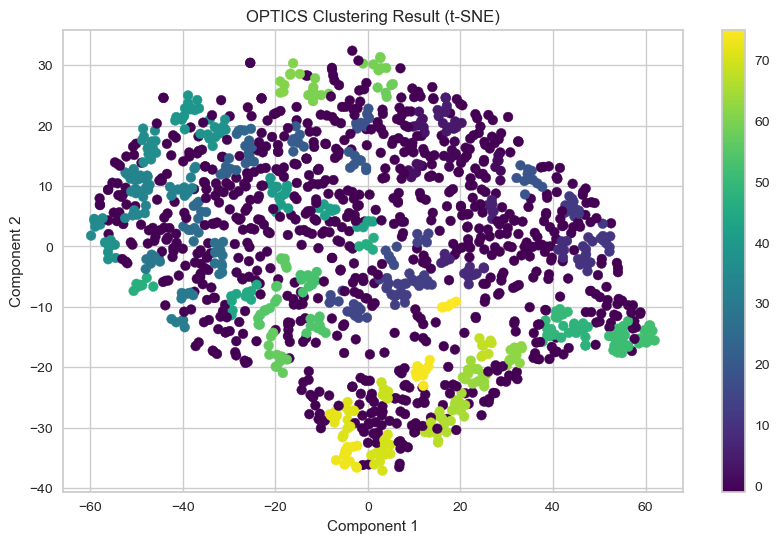

Spectral Clustering - Silhouette Score for t-SNE: -0.04486827924847603
Spectral Clustering - Davies-Bouldin Index for t-SNE: 0.986931936659169
Spectral Clustering - Calinski-Harabasz Index for t-SNE: 169.0129420659613


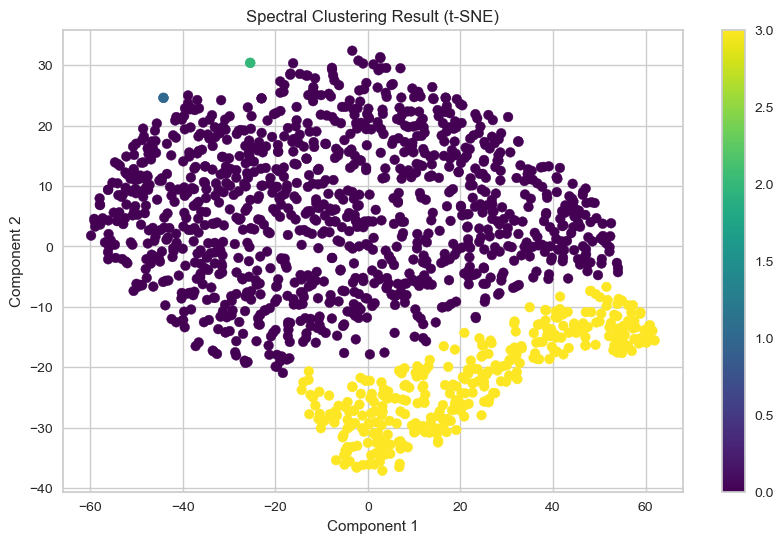

In [67]:
evaluate_clustering(tsne_result, 't-SNE')

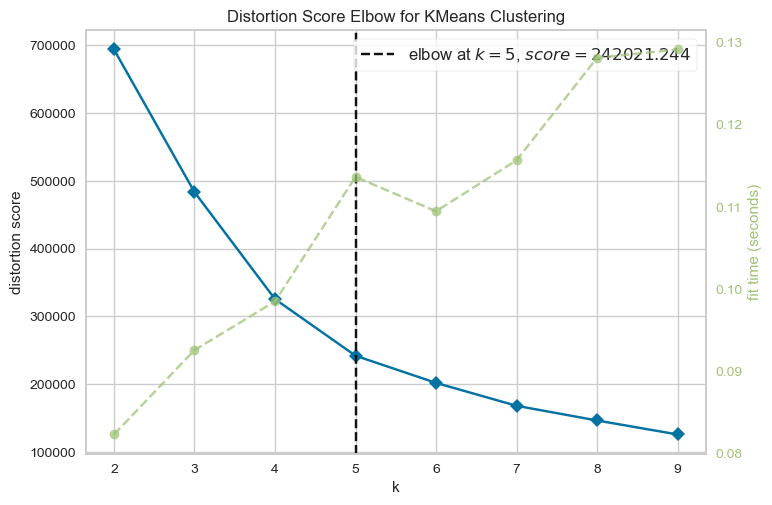

KMeans - Silhouette Score for t-SNE_MM: 0.44121697545051575
KMeans - Davies-Bouldin Index for t-SNE_MM: 0.7757014010669936
KMeans - Calinski-Harabasz Index for t-SNE_MM: 1914.045416503806


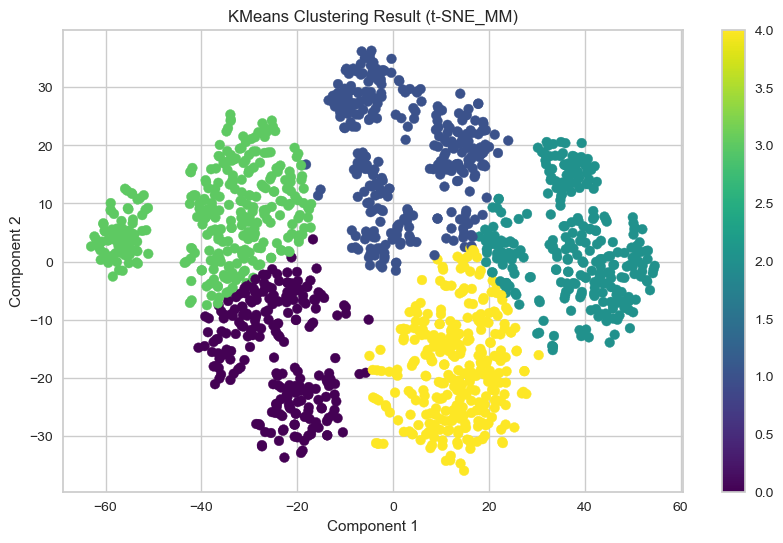

GMM - Silhouette Score for t-SNE_MM: 0.3856118619441986
GMM - Davies-Bouldin Index for t-SNE_MM: 0.9358315516776073
GMM - Calinski-Harabasz Index for t-SNE_MM: 1230.1845147708502


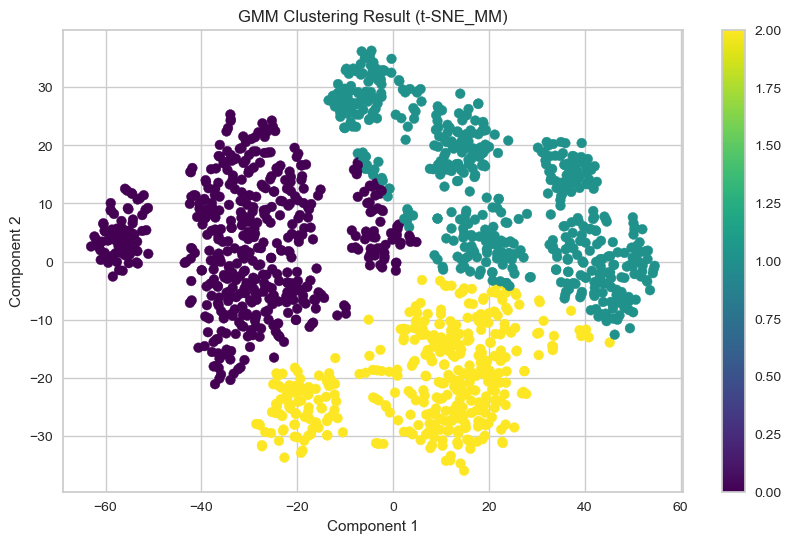

Hierarchical Clustering - Silhouette Score for t-SNE_MM: 0.4187651574611664
Hierarchical Clustering - Davies-Bouldin Index for t-SNE_MM: 0.8505184290724005
Hierarchical Clustering - Calinski-Harabasz Index for t-SNE_MM: 1552.485536182015


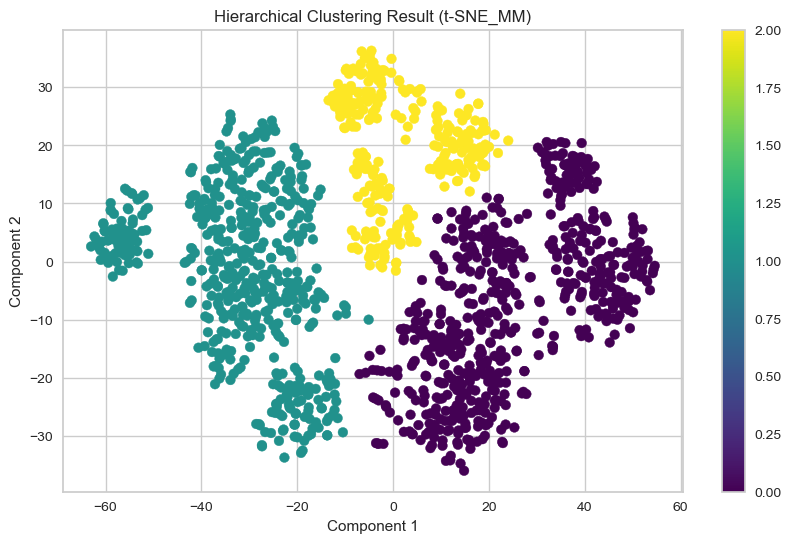

DBSCAN - Insufficient clusters for t-SNE_MM


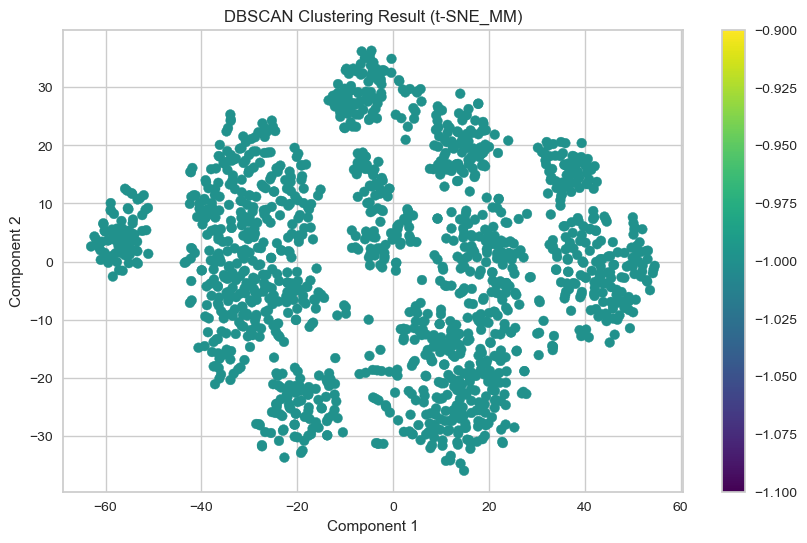

Mean Shift - Silhouette Score for t-SNE_MM: 0.4479842185974121
Mean Shift - Davies-Bouldin Index for t-SNE_MM: 0.86087148409143
Mean Shift - Calinski-Harabasz Index for t-SNE_MM: 1588.86037663192


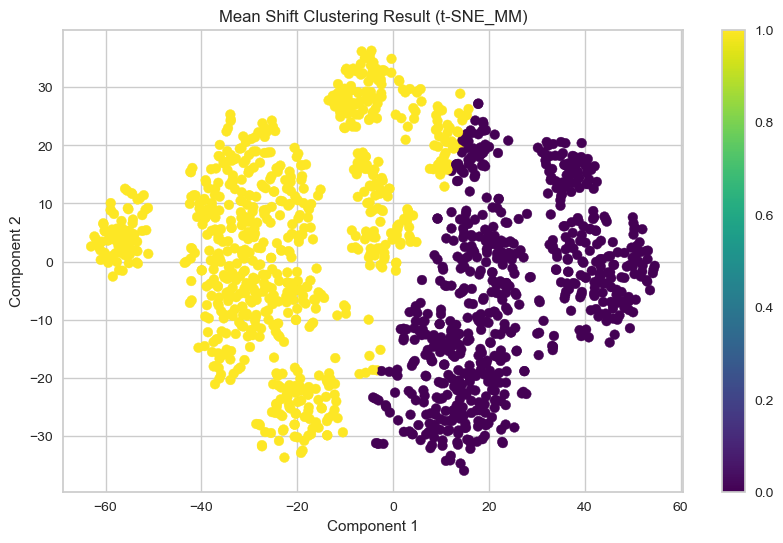

Affinity Propagation - Silhouette Score for t-SNE_MM: 0.38951265811920166
Affinity Propagation - Davies-Bouldin Index for t-SNE_MM: 0.842337130566728
Affinity Propagation - Calinski-Harabasz Index for t-SNE_MM: 2339.0337953953226


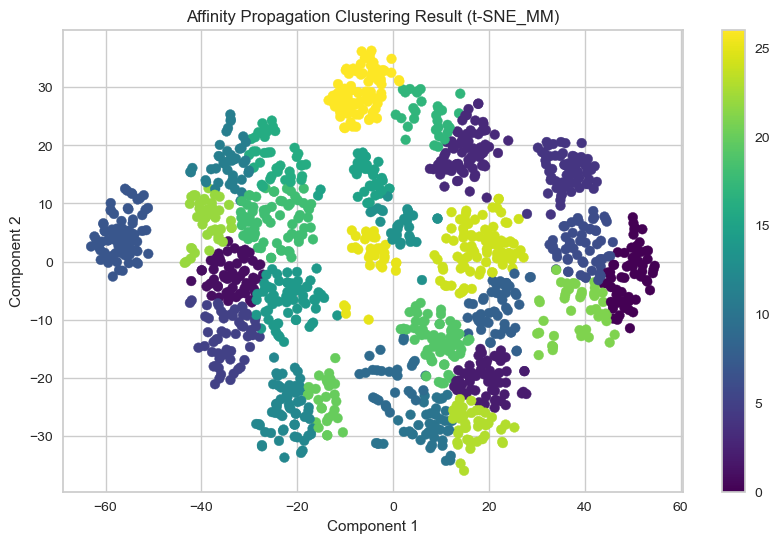

Birch - Silhouette Score for t-SNE_MM: 0.38812056183815
Birch - Davies-Bouldin Index for t-SNE_MM: 0.7770679564043622
Birch - Calinski-Harabasz Index for t-SNE_MM: 1323.6559649284106


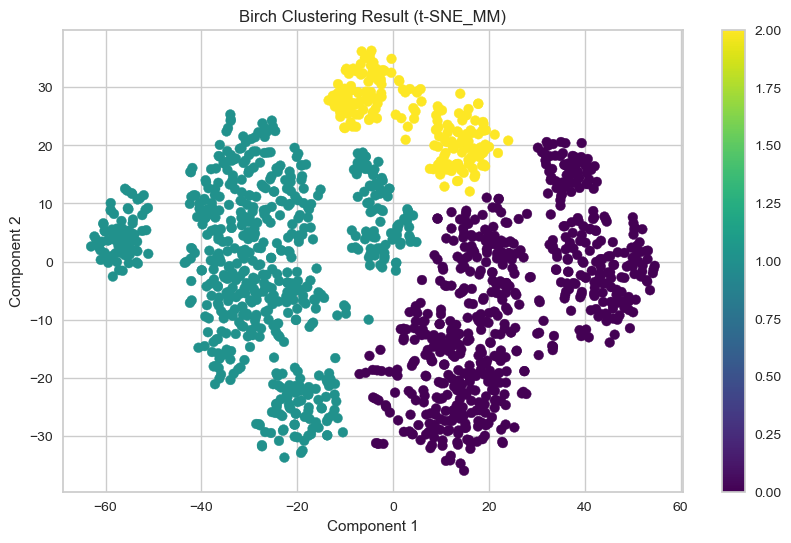

OPTICS - Silhouette Score for t-SNE_MM: -0.14923253655433655
OPTICS - Davies-Bouldin Index for t-SNE_MM: 1.5606442438804171
OPTICS - Calinski-Harabasz Index for t-SNE_MM: 13.813627233994517


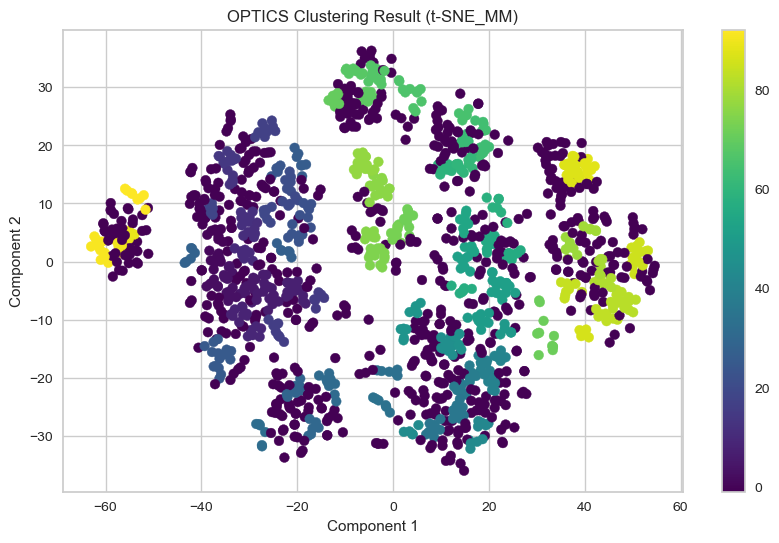

Spectral Clustering - Silhouette Score for t-SNE_MM: 0.09916089475154877
Spectral Clustering - Davies-Bouldin Index for t-SNE_MM: 4.104273548827912
Spectral Clustering - Calinski-Harabasz Index for t-SNE_MM: 272.4445532603066


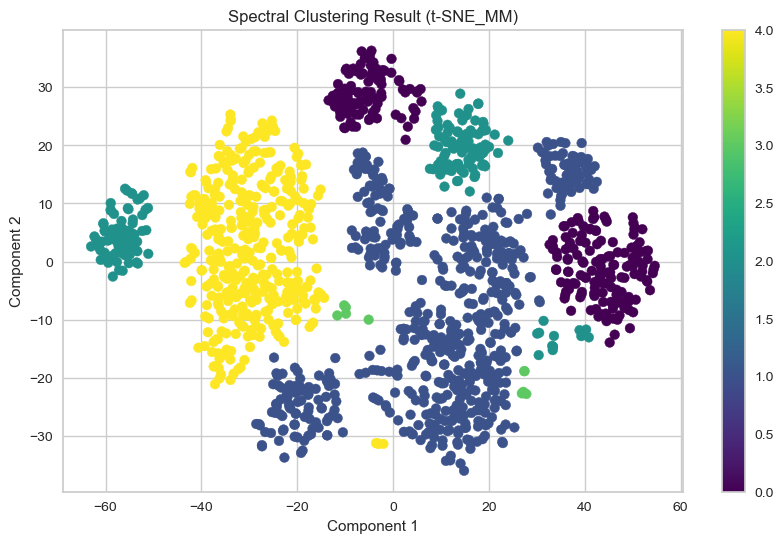

In [68]:
evaluate_clustering(tsne_result_MM, 't-SNE_MM')

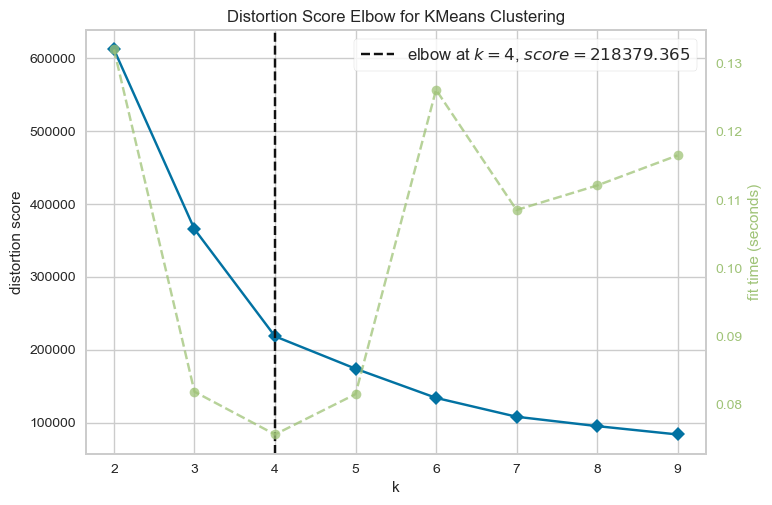

KMeans - Silhouette Score for t-SNE_S: 0.49923673272132874
KMeans - Davies-Bouldin Index for t-SNE_S: 0.6831263574296892
KMeans - Calinski-Harabasz Index for t-SNE_S: 2527.8257720799697


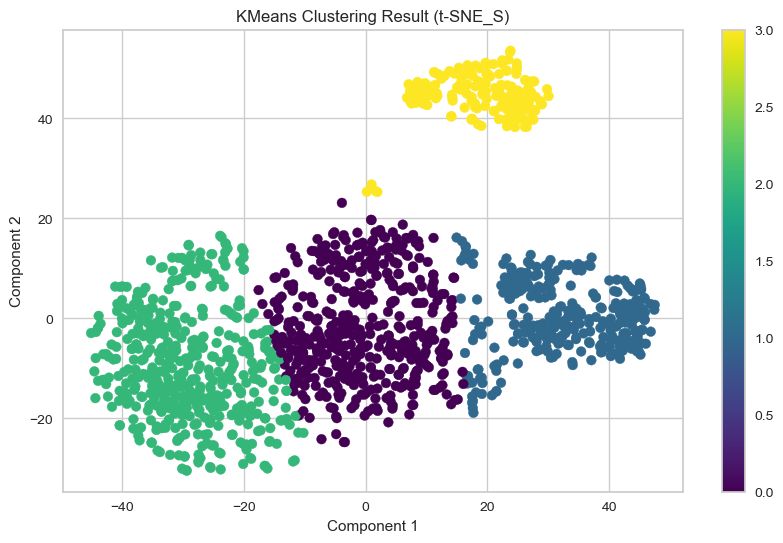

GMM - Silhouette Score for t-SNE_S: 0.35180526971817017
GMM - Davies-Bouldin Index for t-SNE_S: 0.9954537397929485
GMM - Calinski-Harabasz Index for t-SNE_S: 1175.1094183349417


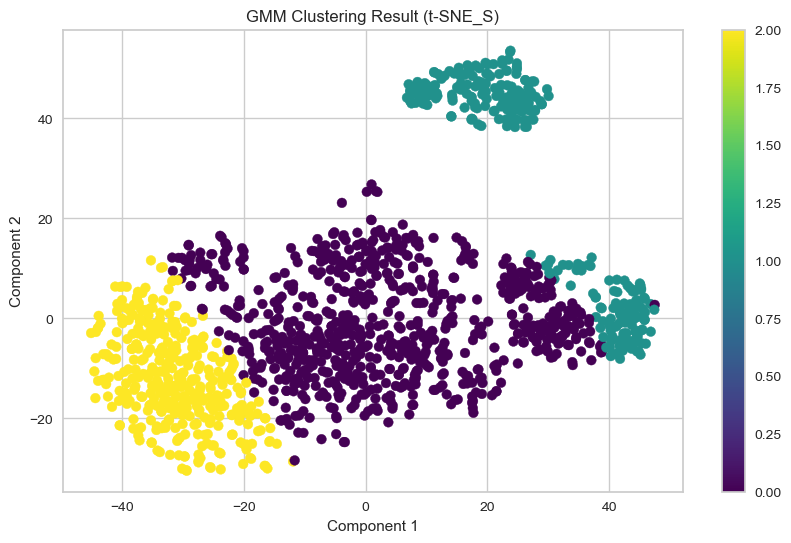

Hierarchical Clustering - Silhouette Score for t-SNE_S: 0.3815615475177765
Hierarchical Clustering - Davies-Bouldin Index for t-SNE_S: 0.9681222100001614
Hierarchical Clustering - Calinski-Harabasz Index for t-SNE_S: 1401.0574520055995


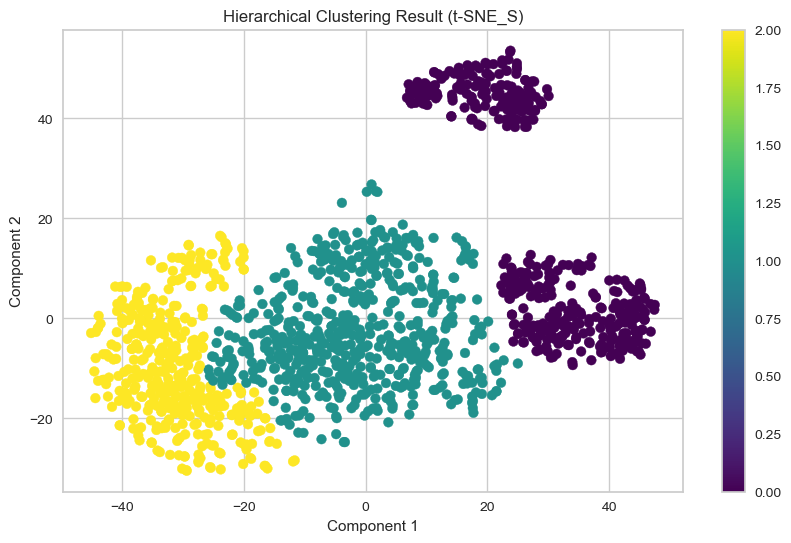

DBSCAN - Insufficient clusters for t-SNE_S


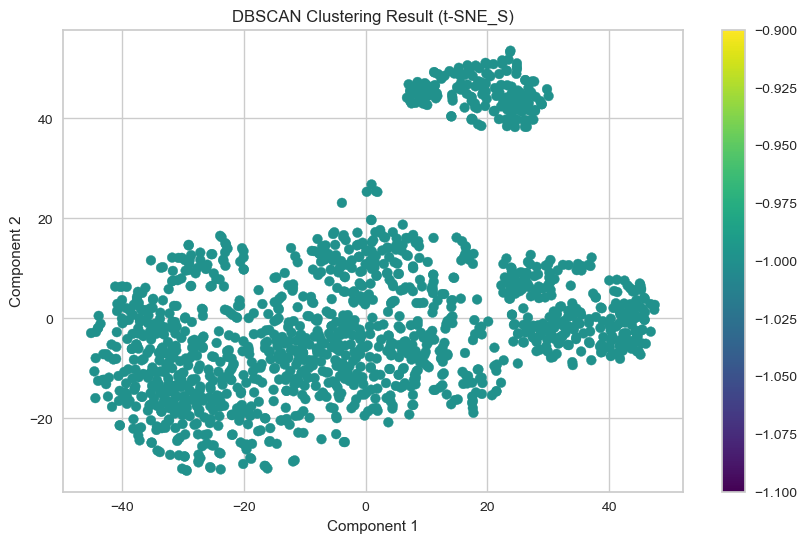

Mean Shift - Silhouette Score for t-SNE_S: 0.45805397629737854
Mean Shift - Davies-Bouldin Index for t-SNE_S: 0.8978272686618441
Mean Shift - Calinski-Harabasz Index for t-SNE_S: 1390.6856093441552


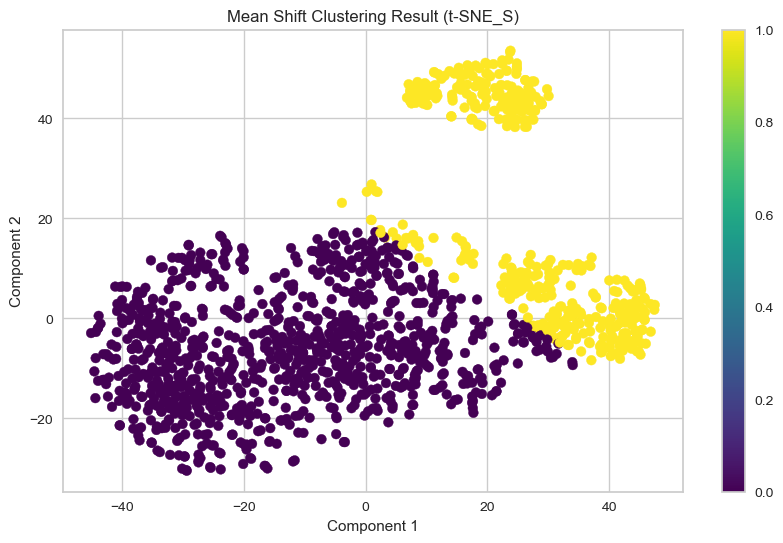

Affinity Propagation - Silhouette Score for t-SNE_S: 0.32087212800979614
Affinity Propagation - Davies-Bouldin Index for t-SNE_S: 0.8665800719592813
Affinity Propagation - Calinski-Harabasz Index for t-SNE_S: 2152.1237143169674


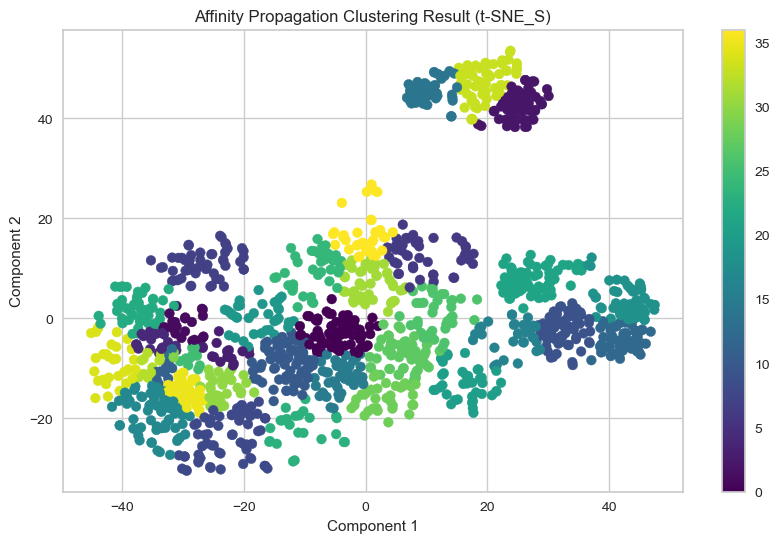

Birch - Silhouette Score for t-SNE_S: 0.3863567113876343
Birch - Davies-Bouldin Index for t-SNE_S: 0.9889472945187983
Birch - Calinski-Harabasz Index for t-SNE_S: 1436.995486497502


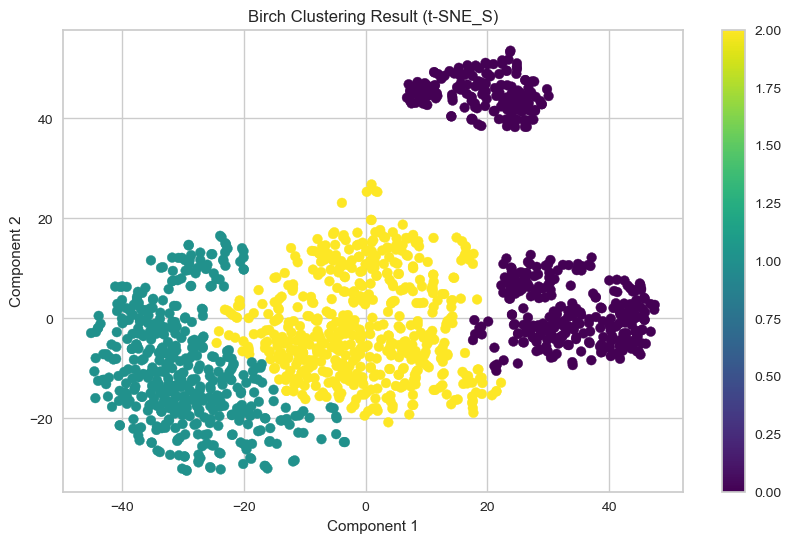

OPTICS - Silhouette Score for t-SNE_S: -0.22117824852466583
OPTICS - Davies-Bouldin Index for t-SNE_S: 1.6561504238120492
OPTICS - Calinski-Harabasz Index for t-SNE_S: 12.866512661537104


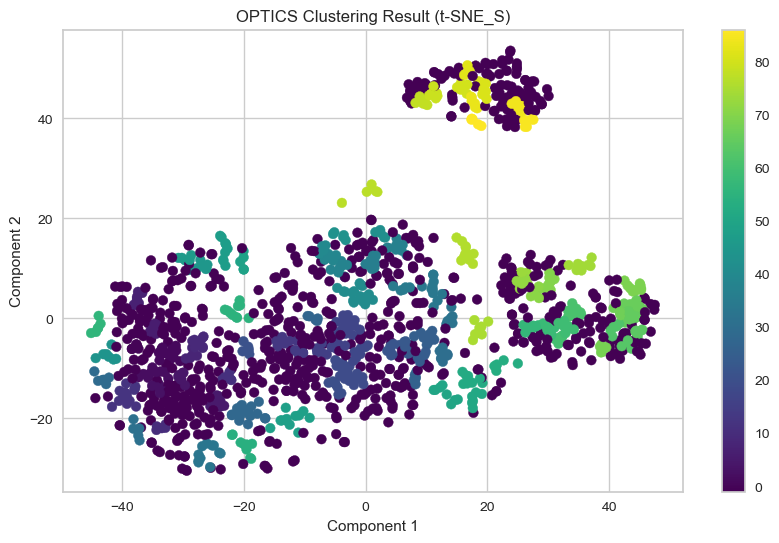

Spectral Clustering - Silhouette Score for t-SNE_S: -0.07965990900993347
Spectral Clustering - Davies-Bouldin Index for t-SNE_S: 0.8581330162826892
Spectral Clustering - Calinski-Harabasz Index for t-SNE_S: 222.00300119084056


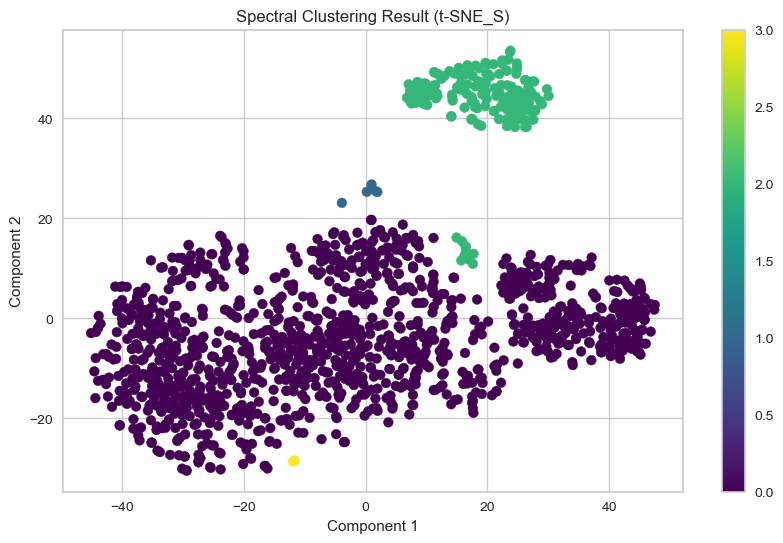

In [69]:
evaluate_clustering(tsne_result_S, 't-SNE_S')

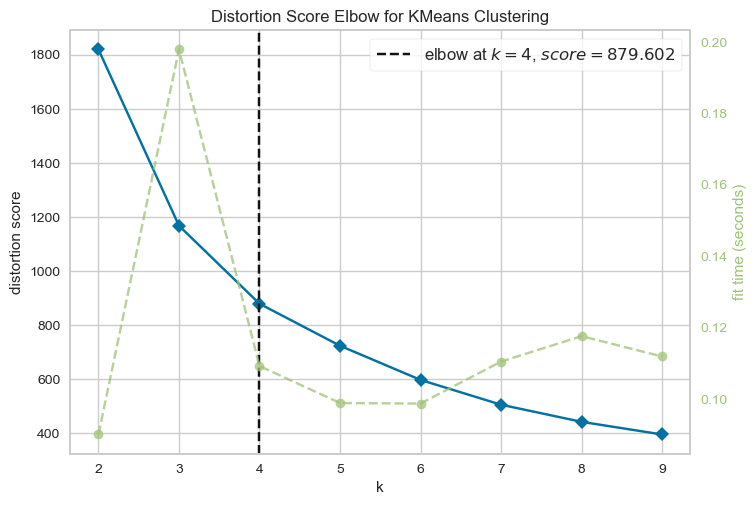

KMeans - Silhouette Score for ICA: 0.3892524793150367
KMeans - Davies-Bouldin Index for ICA: 0.8402455860828761
KMeans - Calinski-Harabasz Index for ICA: 1075.6994873877563


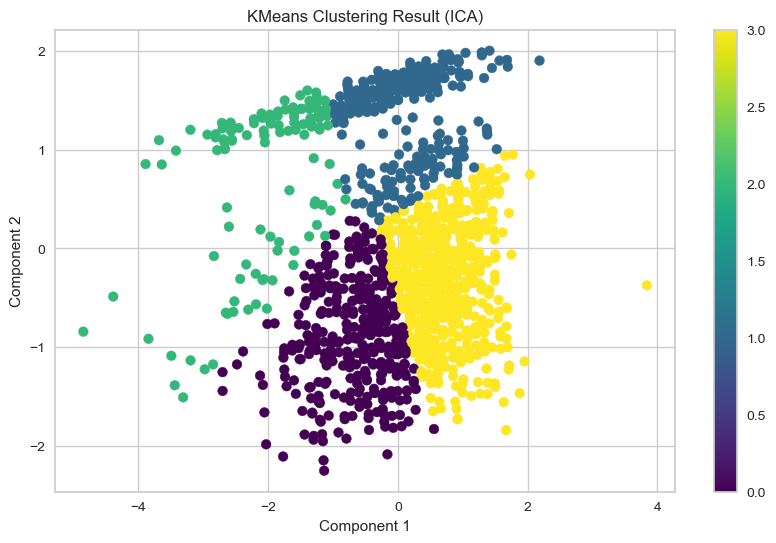

GMM - Silhouette Score for ICA: 0.394163530664505
GMM - Davies-Bouldin Index for ICA: 0.8888147348505072
GMM - Calinski-Harabasz Index for ICA: 885.6667468059444


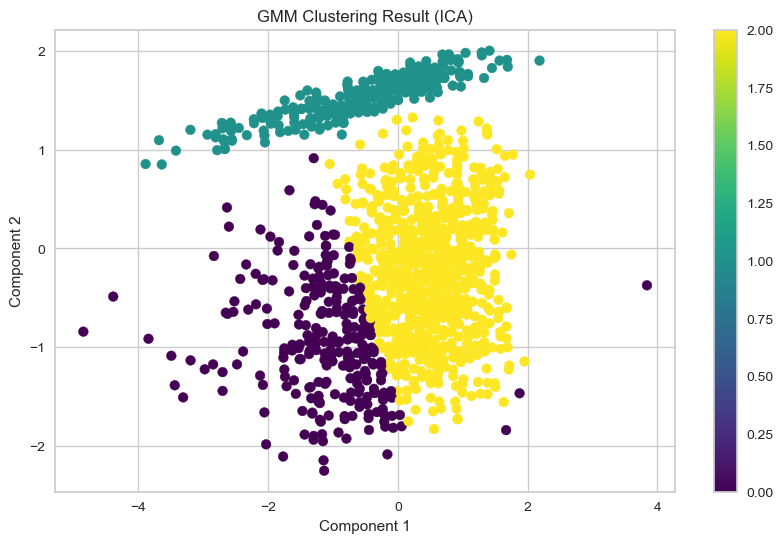

Hierarchical Clustering - Silhouette Score for ICA: 0.3881065377733378
Hierarchical Clustering - Davies-Bouldin Index for ICA: 0.8593748746453788
Hierarchical Clustering - Calinski-Harabasz Index for ICA: 939.7116081646719


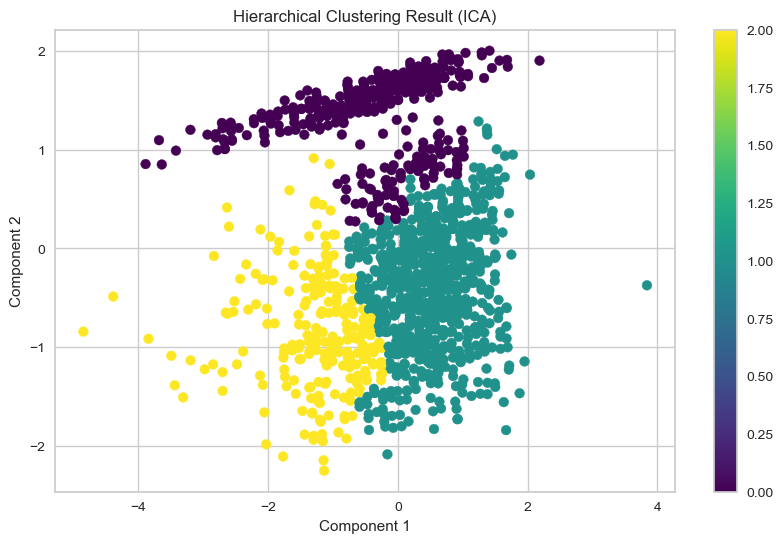

DBSCAN - Silhouette Score for ICA: 0.608356293691439
DBSCAN - Davies-Bouldin Index for ICA: 2.6526433908632012
DBSCAN - Calinski-Harabasz Index for ICA: 5.358596446420575


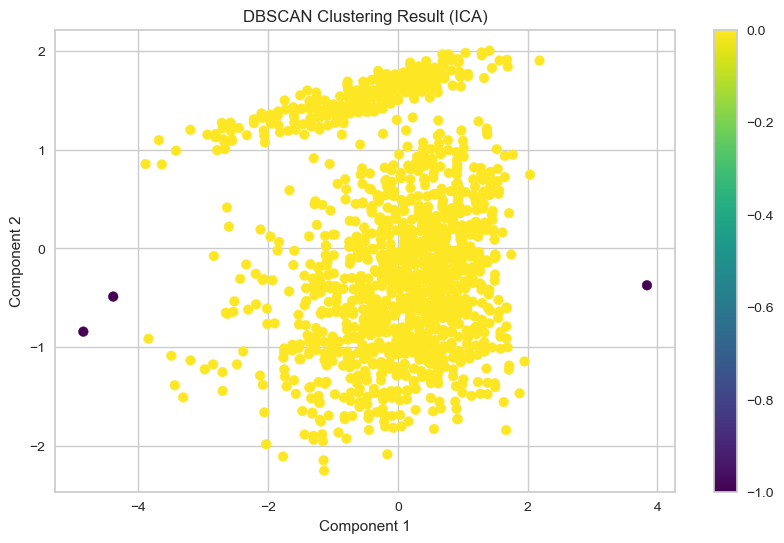

Mean Shift - Silhouette Score for ICA: 0.48376662515722807
Mean Shift - Davies-Bouldin Index for ICA: 0.8545545308979401
Mean Shift - Calinski-Harabasz Index for ICA: 9.726997067795033


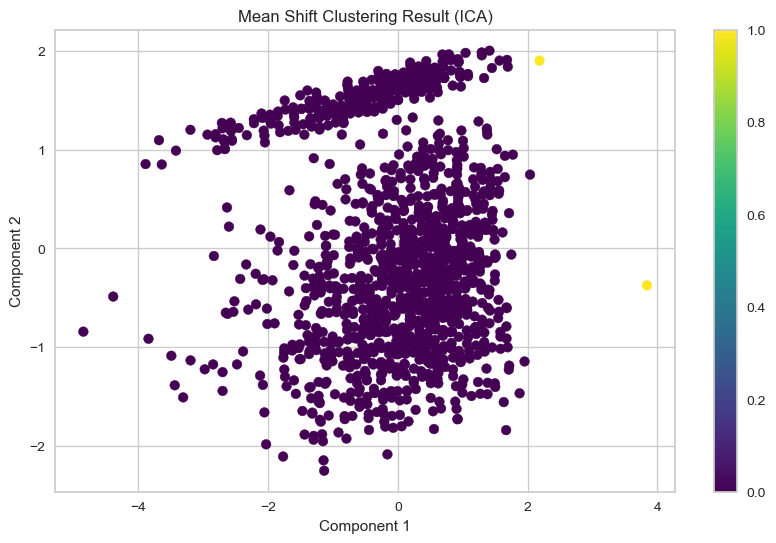

Affinity Propagation - Silhouette Score for ICA: 0.25674692303725605
Affinity Propagation - Davies-Bouldin Index for ICA: 0.5571502897847632
Affinity Propagation - Calinski-Harabasz Index for ICA: 272.0225357244283


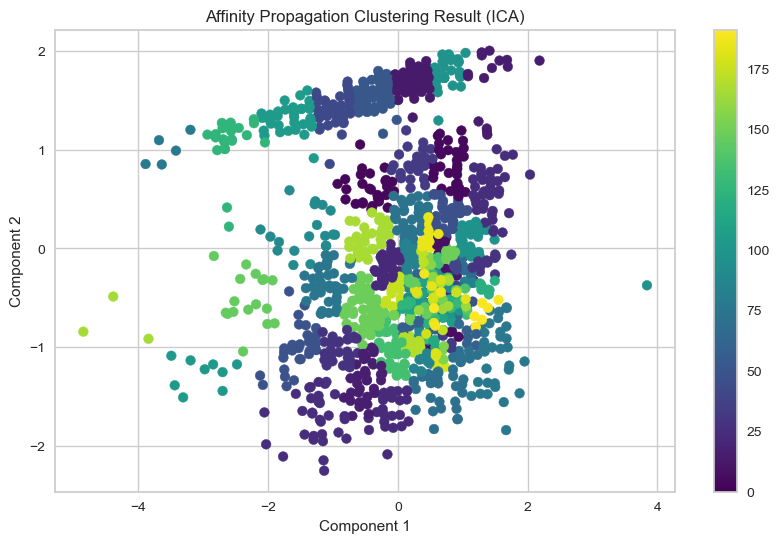

Birch - Silhouette Score for ICA: 0.3677705371993762
Birch - Davies-Bouldin Index for ICA: 0.8854303011626524
Birch - Calinski-Harabasz Index for ICA: 628.5606332883353


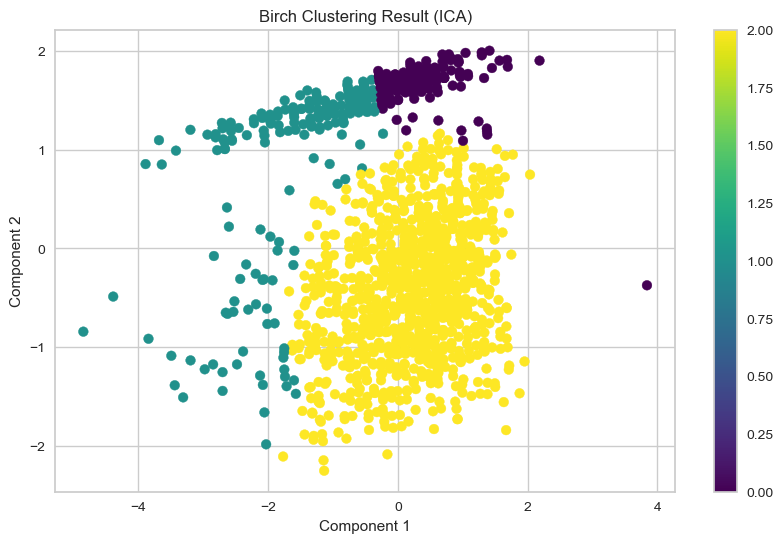

OPTICS - Silhouette Score for ICA: -0.06976317769452117
OPTICS - Davies-Bouldin Index for ICA: 2.4284909213891153
OPTICS - Calinski-Harabasz Index for ICA: 15.015843455002745


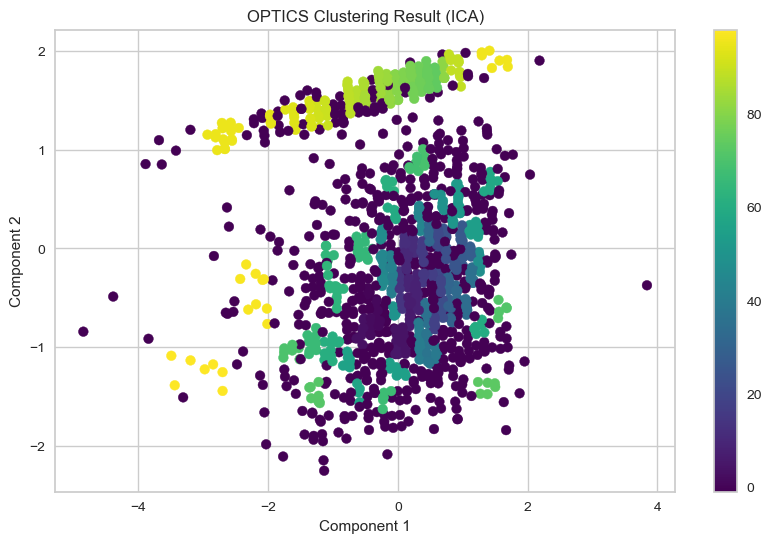

Spectral Clustering - Silhouette Score for ICA: 0.3846773160866207
Spectral Clustering - Davies-Bouldin Index for ICA: 0.6452309436976496
Spectral Clustering - Calinski-Harabasz Index for ICA: 418.6107904070943


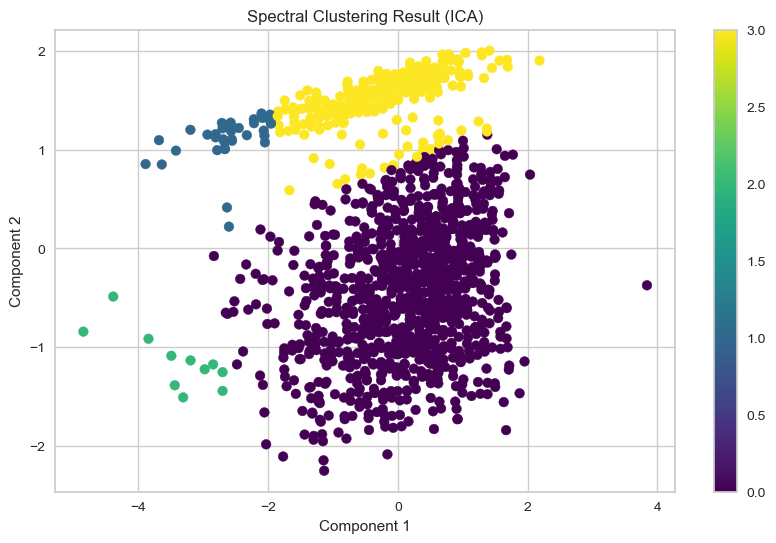

In [70]:
evaluate_clustering(ica_result, 'ICA')

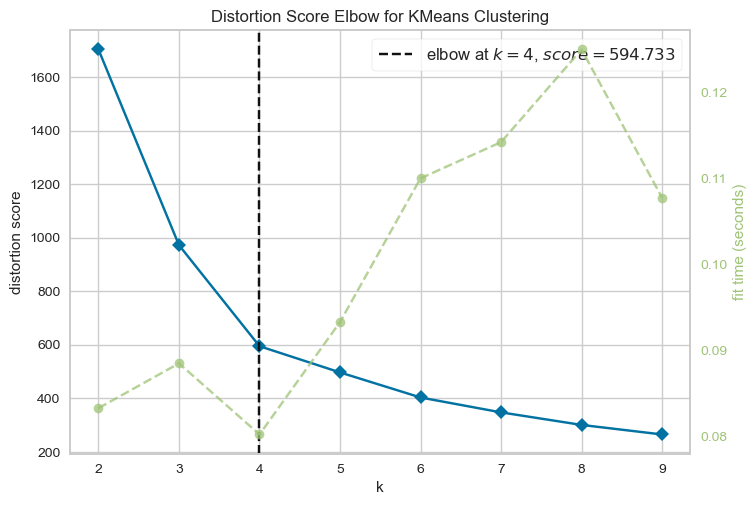

KMeans - Silhouette Score for ICA_MM: 0.4794715923890299
KMeans - Davies-Bouldin Index for ICA_MM: 0.6540548882382694
KMeans - Calinski-Harabasz Index for ICA_MM: 1819.1028082909304


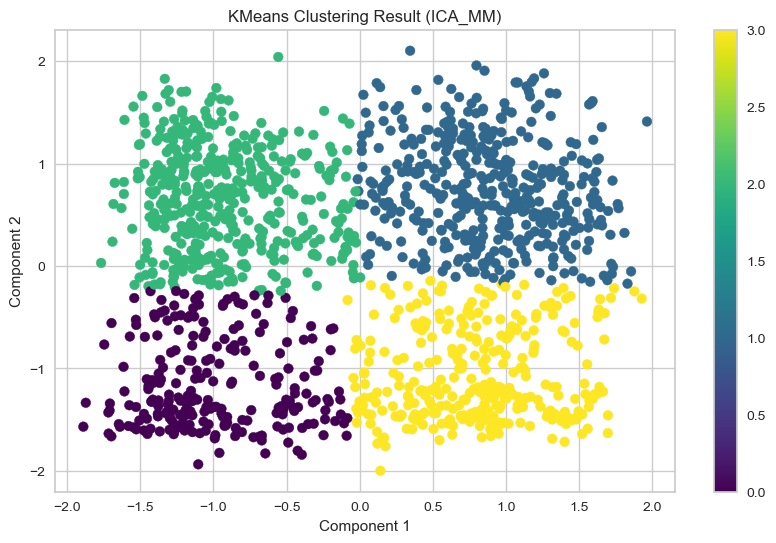

GMM - Silhouette Score for ICA_MM: 0.4204142770983045
GMM - Davies-Bouldin Index for ICA_MM: 0.8173471260400053
GMM - Calinski-Harabasz Index for ICA_MM: 1217.4193706259273


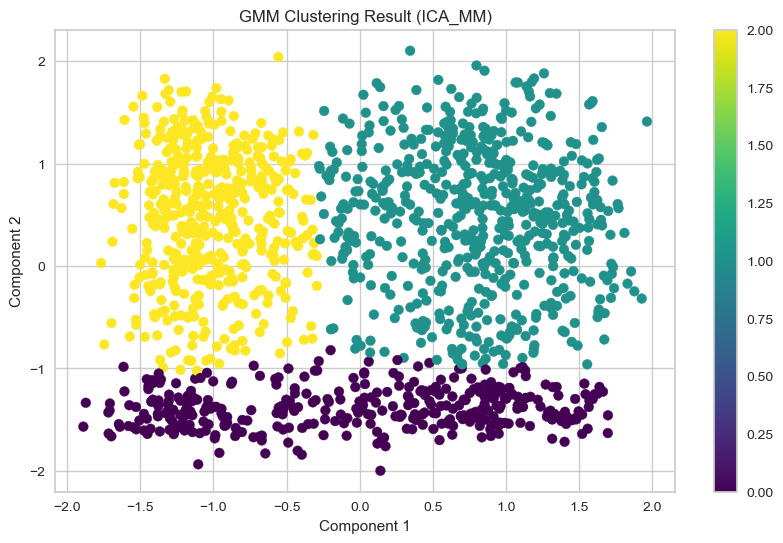

Hierarchical Clustering - Silhouette Score for ICA_MM: 0.4050960945384044
Hierarchical Clustering - Davies-Bouldin Index for ICA_MM: 0.7904038642717972
Hierarchical Clustering - Calinski-Harabasz Index for ICA_MM: 1142.288551447699


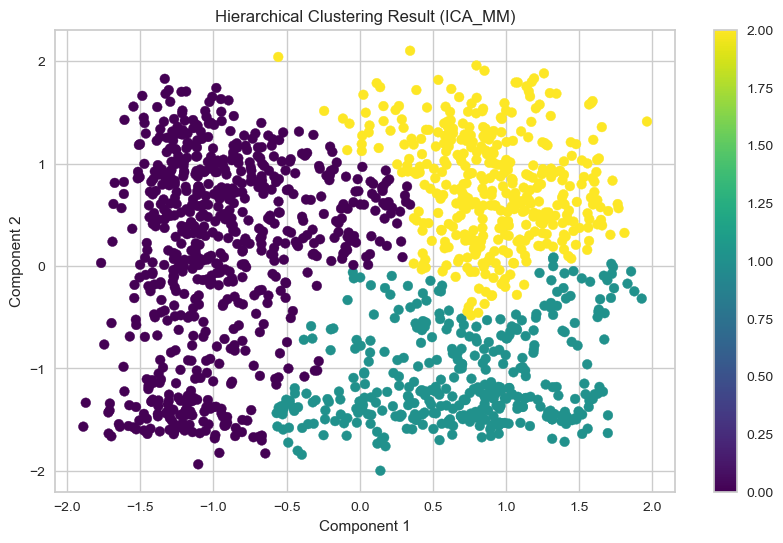

DBSCAN - Silhouette Score for ICA_MM: 0.1579396306491447
DBSCAN - Davies-Bouldin Index for ICA_MM: 0.6339033724690375
DBSCAN - Calinski-Harabasz Index for ICA_MM: 2.2392618789031986


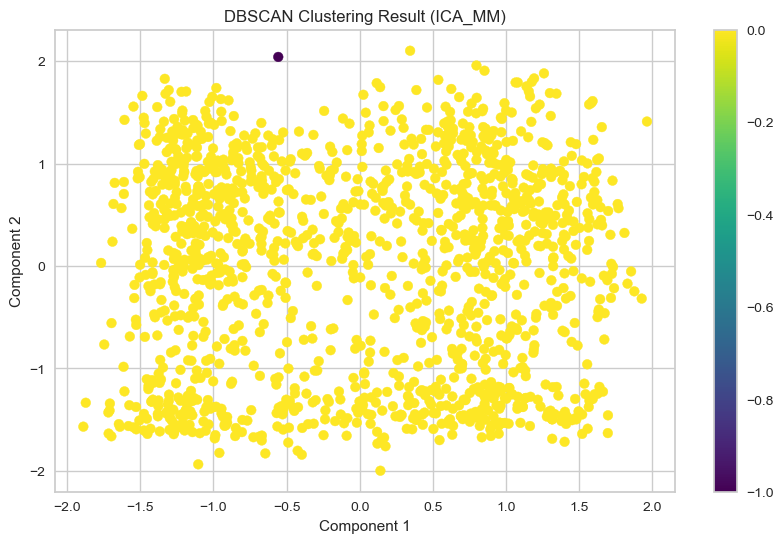

Mean Shift - Silhouette Score for ICA_MM: 0.39568846244907546
Mean Shift - Davies-Bouldin Index for ICA_MM: 1.099045785567658
Mean Shift - Calinski-Harabasz Index for ICA_MM: 975.973551831726


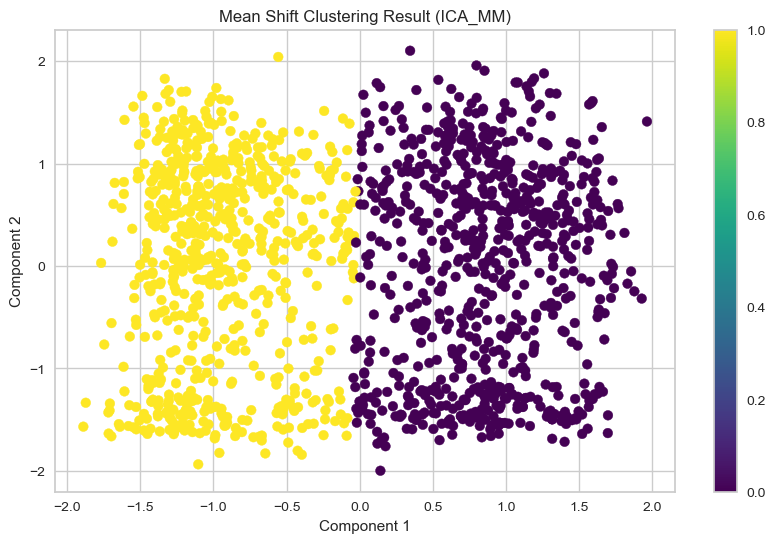

Affinity Propagation - Silhouette Score for ICA_MM: 0.2698674150516463
Affinity Propagation - Davies-Bouldin Index for ICA_MM: 0.6210091249546061
Affinity Propagation - Calinski-Harabasz Index for ICA_MM: 339.6442709734555


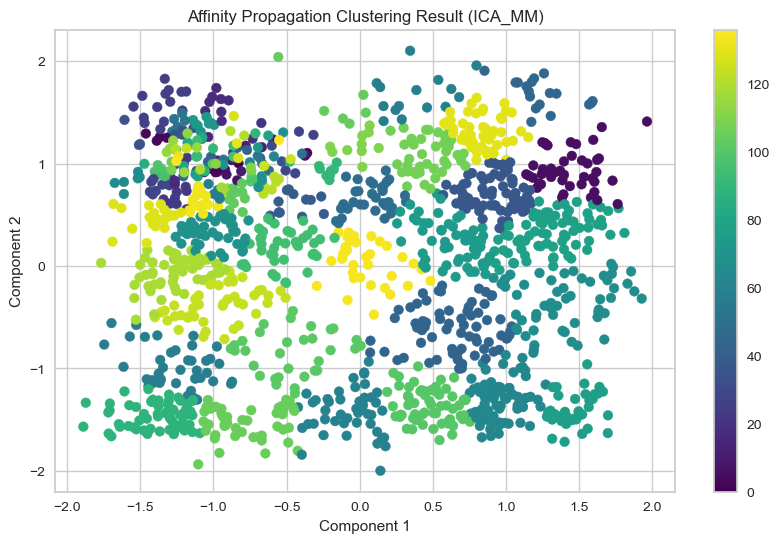

Birch - Silhouette Score for ICA_MM: 0.42275877561072983
Birch - Davies-Bouldin Index for ICA_MM: 0.8108147088451435
Birch - Calinski-Harabasz Index for ICA_MM: 1246.2533487829742


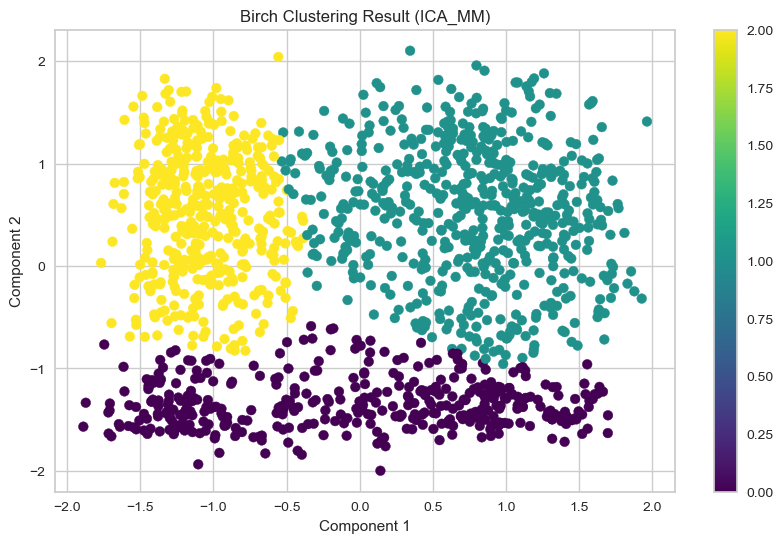

OPTICS - Silhouette Score for ICA_MM: -0.18802196064801424
OPTICS - Davies-Bouldin Index for ICA_MM: 1.4064328143099178
OPTICS - Calinski-Harabasz Index for ICA_MM: 15.510726725923355


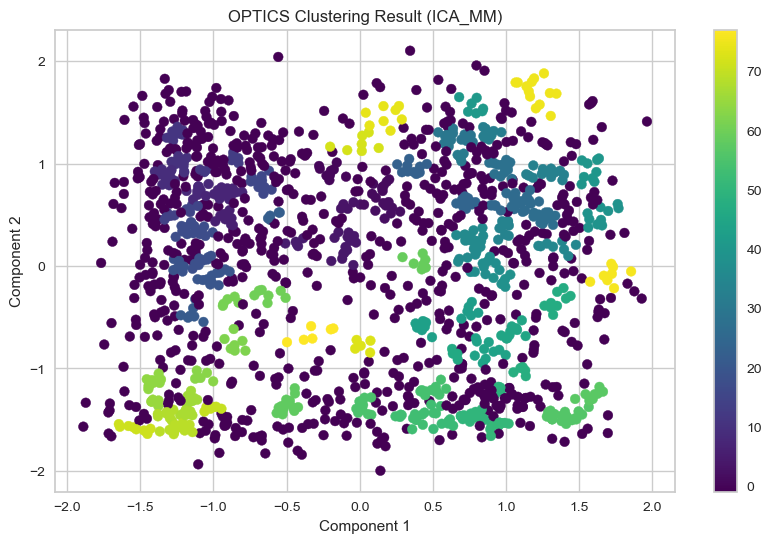

Spectral Clustering - Silhouette Score for ICA_MM: 0.4793952706740123
Spectral Clustering - Davies-Bouldin Index for ICA_MM: 0.656408294849811
Spectral Clustering - Calinski-Harabasz Index for ICA_MM: 1765.4169534770756


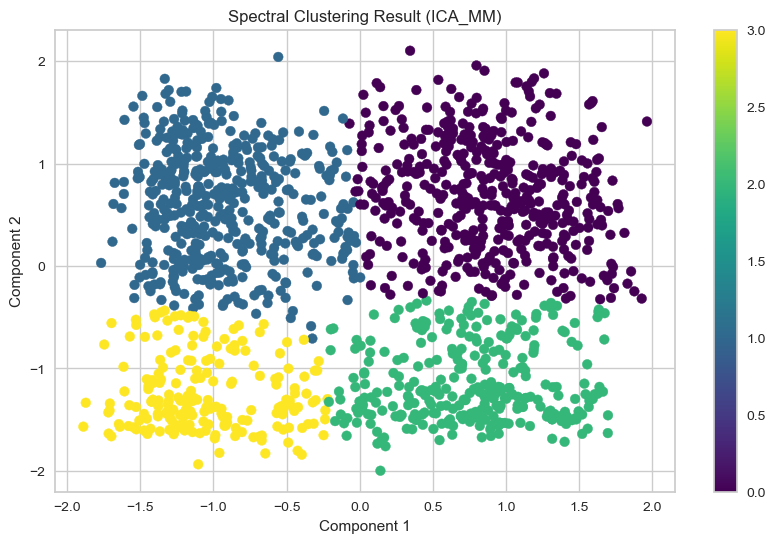

In [71]:
evaluate_clustering(ica_result_MM, 'ICA_MM')

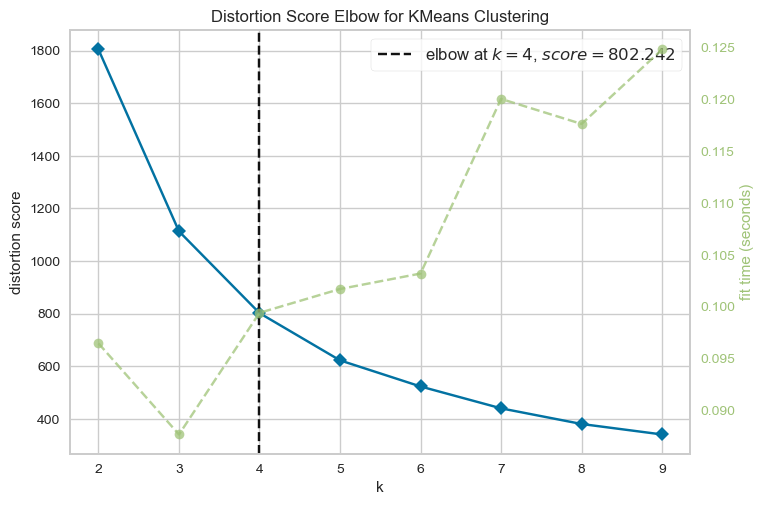

KMeans - Silhouette Score for ICA_S: 0.3977958135039649
KMeans - Davies-Bouldin Index for ICA_S: 0.8232690487961931
KMeans - Calinski-Harabasz Index for ICA_S: 1225.3615554323746


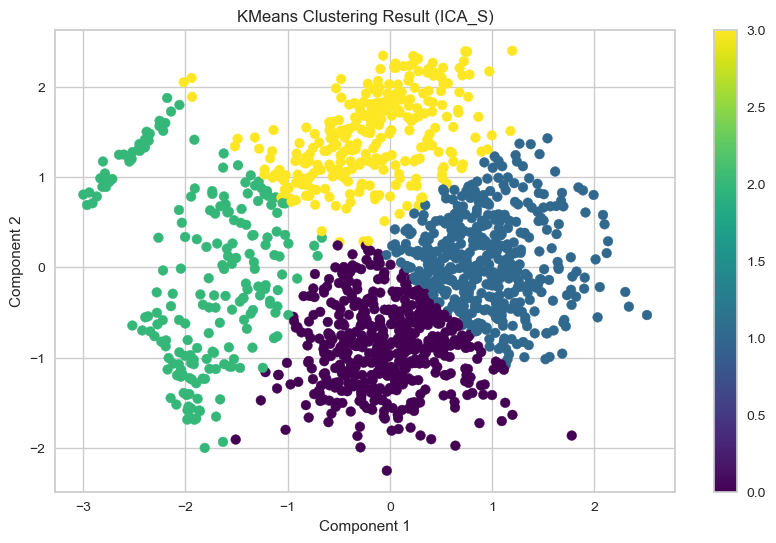

GMM - Silhouette Score for ICA_S: 0.3891815077728234
GMM - Davies-Bouldin Index for ICA_S: 0.8929363164106606
GMM - Calinski-Harabasz Index for ICA_S: 1052.9425935300999


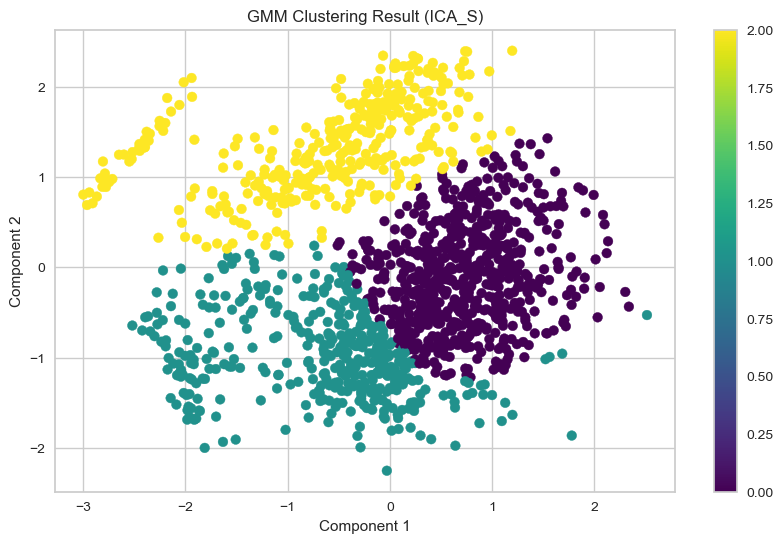

Hierarchical Clustering - Silhouette Score for ICA_S: 0.4152174681596392
Hierarchical Clustering - Davies-Bouldin Index for ICA_S: 0.7861084656456349
Hierarchical Clustering - Calinski-Harabasz Index for ICA_S: 888.5669664684674


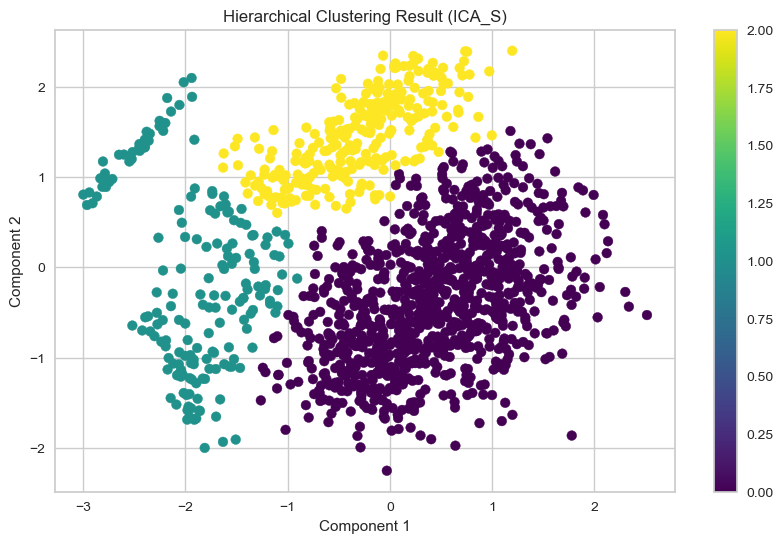

DBSCAN - Silhouette Score for ICA_S: 0.3060969929399562
DBSCAN - Davies-Bouldin Index for ICA_S: 0.49643985963978915
DBSCAN - Calinski-Harabasz Index for ICA_S: 3.3298899411349994


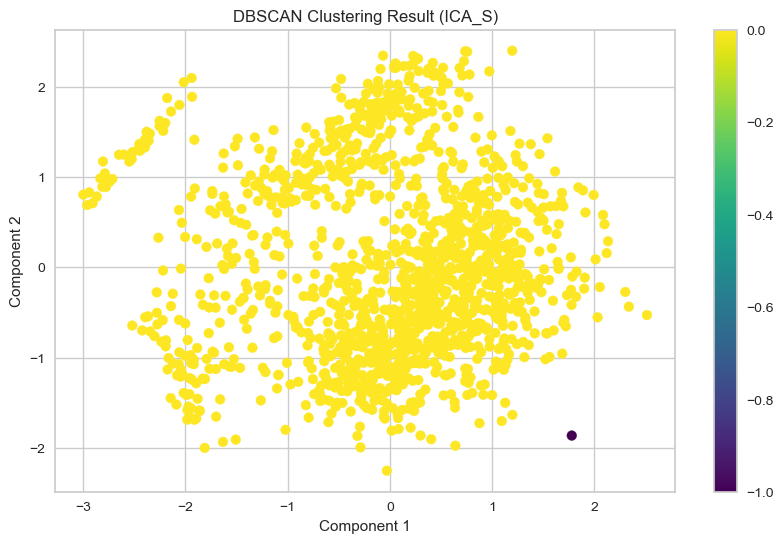

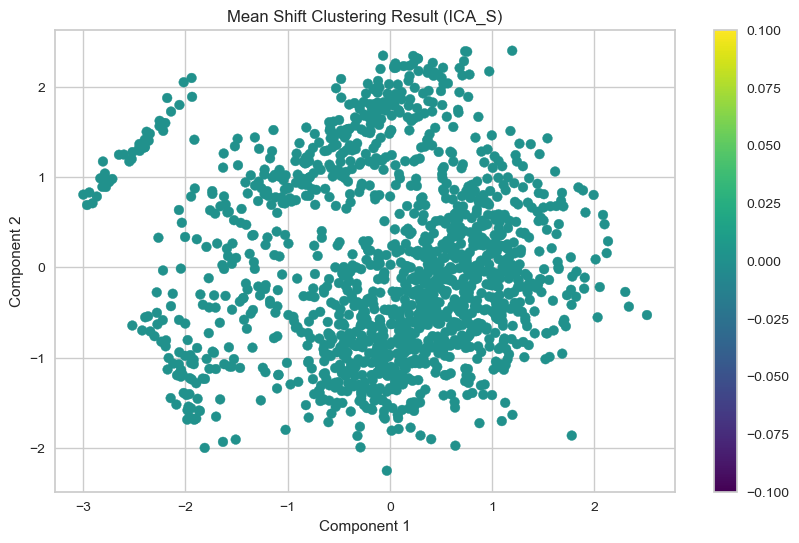

Affinity Propagation - Silhouette Score for ICA_S: 0.247740815356766
Affinity Propagation - Davies-Bouldin Index for ICA_S: 0.909819201807175
Affinity Propagation - Calinski-Harabasz Index for ICA_S: 939.4723807081043


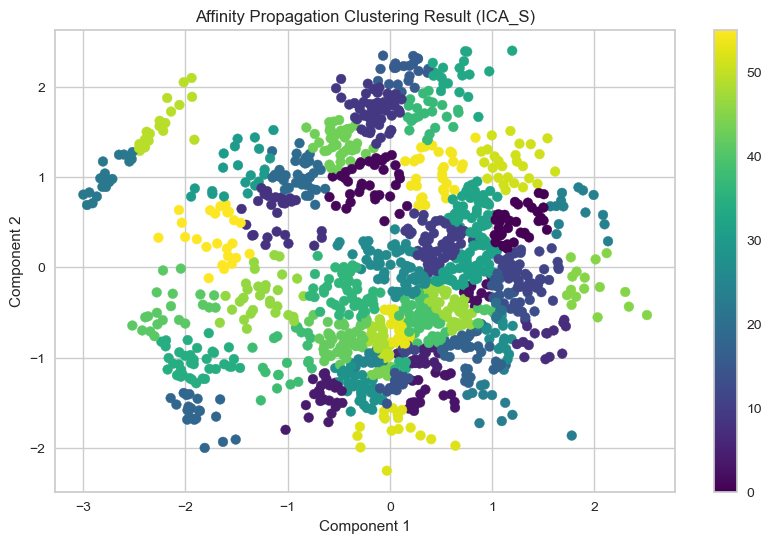

Birch - Silhouette Score for ICA_S: 0.34268330043743767
Birch - Davies-Bouldin Index for ICA_S: 0.9453644078094573
Birch - Calinski-Harabasz Index for ICA_S: 888.3801243333654


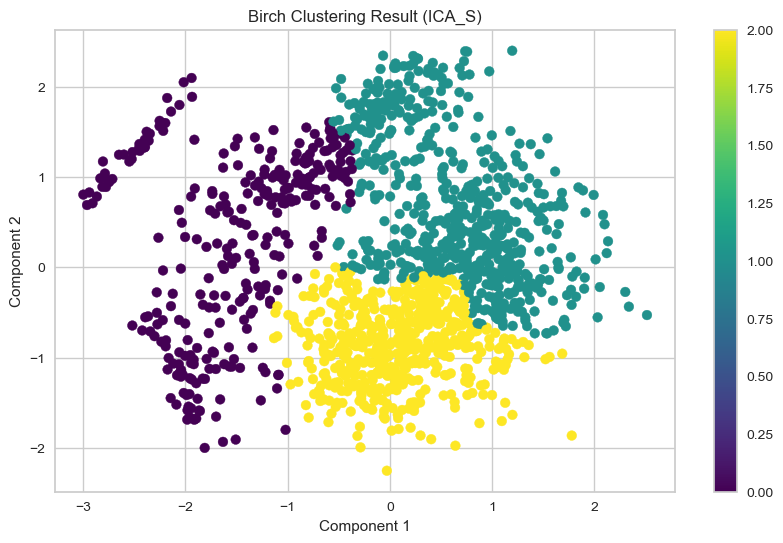

OPTICS - Silhouette Score for ICA_S: -0.21714526150607605
OPTICS - Davies-Bouldin Index for ICA_S: 1.9936874122883108
OPTICS - Calinski-Harabasz Index for ICA_S: 14.335224914984991


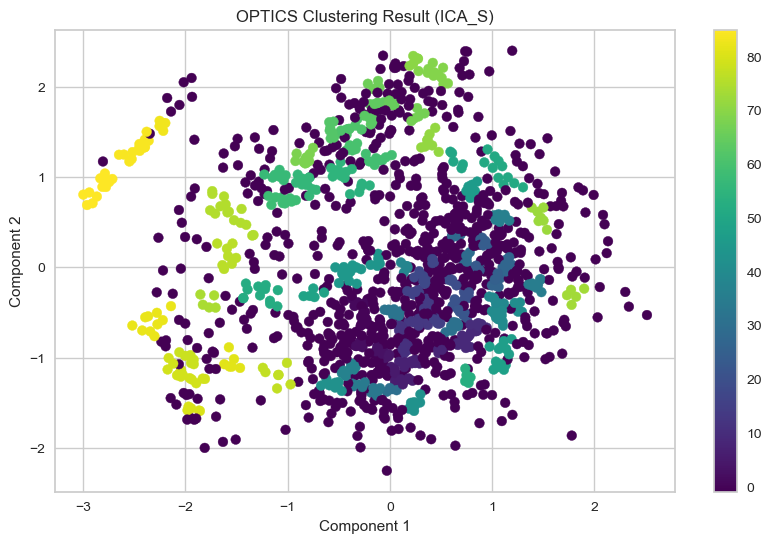

Spectral Clustering - Silhouette Score for ICA_S: 0.39037554517047884
Spectral Clustering - Davies-Bouldin Index for ICA_S: 0.7162095084622597
Spectral Clustering - Calinski-Harabasz Index for ICA_S: 664.9255507519633


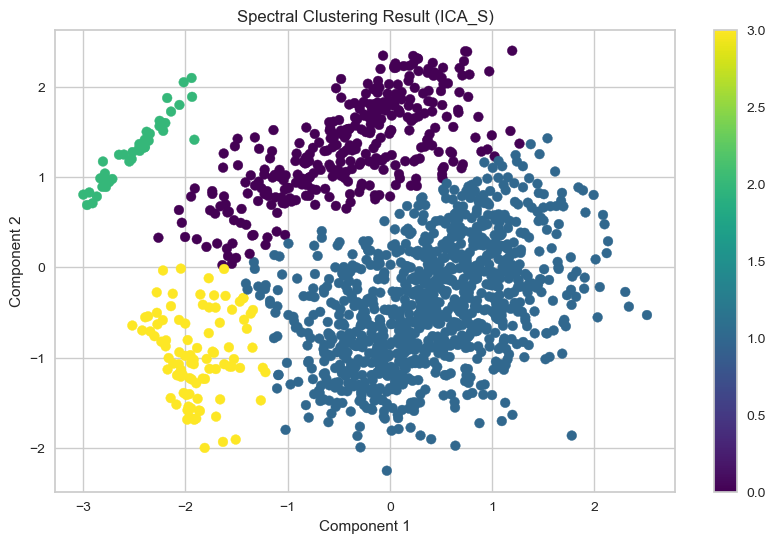

In [74]:
evaluate_clustering(ica_result_S, 'ICA_S')

In [134]:
'''
Explanation of Data Quality
Selected Features: Provides specific insights by focusing on key features, which helps in better cluster separation and compactness.
Standard Scaled Features: Ensures that all features contribute equally to the clustering process, enhancing the clustering performance.
MinMax Scaled Features: Scales features to a specific range, which is beneficial for algorithms sensitive to the magnitude of data, like KMeans and DBSCAN, leading to improved clustering results.
'''

In [145]:
data_selected = df

In [251]:
def cluster_analysis(data, technique, cluster_method, scaling='standard', n_clusters=4, n_components=2):
    # Scaling the data
    if scaling == 'standard':
        scaler = StandardScaler()
    elif scaling == 'minmax':
        scaler = MinMaxScaler()
    else:
        raise ValueError("Scaling should be 'standard' or 'minmax'")
    
    data_scaled = scaler.fit_transform(data)

    if technique == 'MCA':
        data_scaled = pd.DataFrame(data_scaled, columns=data.columns)
    
    # Dimensionality Reduction
    if technique == 'PCA':
        reducer = PCA(n_components=n_components)
    elif technique == 'MCA':
        from prince import MCA
        reducer = MCA(n_components=n_components, random_state=42)
    elif technique == 'MDS':
        reducer = MDS(n_components=n_components, random_state=42)
    elif technique == 'LLE':
        reducer = LocallyLinearEmbedding(n_components=n_components)
    elif technique == 'Isomap':
        reducer = Isomap(n_components=n_components)
    elif technique == 'UMAP':
        reducer = umap.UMAP(n_components=n_components, random_state=42)
    elif technique == 't-SNE':
        reducer = TSNE(n_components=n_components, random_state=42)
    elif technique == 'ICA':
        reducer = FastICA(n_components=n_components, random_state=42)
    else:
        raise ValueError("Invalid dimensionality reduction technique")
    
    if technique == 'MCA':
        data_reduced = reducer.fit_transform(data_scaled).values
    else:
        data_reduced = reducer.fit_transform(data_scaled)
    
    # Clustering
    if cluster_method == 'KMeans':
        clusterer = KMeans(n_clusters=n_clusters, random_state=42)
    elif cluster_method == 'SpectralClustering':
        clusterer = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', random_state=42)
    elif cluster_method == 'AgglomerativeClustering':
        clusterer = AgglomerativeClustering(n_clusters=n_clusters)
    elif cluster_method == 'Birch':
        clusterer = Birch(n_clusters=n_clusters)
    elif cluster_method == 'MeanShift':
        clusterer = MeanShift()
    elif cluster_method == 'DBSCAN':
        clusterer = DBSCAN()
    elif cluster_method == 'GMM':
        clusterer = GaussianMixture(n_components=n_clusters, random_state=42)
    elif cluster_method == 'AffinityPropagation':
        from sklearn.cluster import AffinityPropagation
        clusterer = AffinityPropagation()
    elif cluster_method == 'OPTICS':
        from sklearn.cluster import OPTICS
        clusterer = OPTICS()
    else:
        raise ValueError("Invalid clustering method")
    
    if cluster_method in ['KMeans', 'GMM']:
        labels = clusterer.fit_predict(data_reduced)
    else:
        labels = clusterer.fit_predict(data_reduced)
    
    # Evaluate Clustering
    sil_score = silhouette_score(data_reduced, labels)
    davies_bouldin = davies_bouldin_score(data_reduced, labels)
    calinski_harabasz = calinski_harabasz_score(data_reduced, labels)
    
    print(f'{technique} {cluster_method} - Silhouette Score: {sil_score}')
    print(f'{technique} {cluster_method} - Davies-Bouldin Index: {davies_bouldin}')
    print(f'{technique} {cluster_method} - Calinski-Harabasz Index: {calinski_harabasz}')
    
    # Visualization
    plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=labels, cmap='viridis')
    plt.title(f'{technique} {cluster_method} Clustering')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.colorbar()
    plt.show()
    
    # Cluster Profiling
    data_with_labels = pd.DataFrame(data_scaled, columns=data.columns)
    data_with_labels['Cluster'] = labels
    cluster_profile = data_with_labels.groupby('Cluster').mean()
    cluster_profile.to_excel('cluster_profile.xlsx')
    data_with_labels['Cluster'].to_excel('clusters.xlsx')
    
    # Heatmap of Cluster Profiles
    plt.figure(figsize=(10, 8))
    sns.heatmap(cluster_profile.T, cmap='viridis', annot=True)
    plt.title(f'{technique} {cluster_method} Cluster Profiles')
    plt.show()
    
    # Bar Plot of Cluster Sizes
    cluster_sizes = data_with_labels['Cluster'].value_counts()
    plt.figure(figsize=(8, 6))
    sns.barplot(x=cluster_sizes.index, y=cluster_sizes.values, palette='viridis')
    plt.title(f'{technique} {cluster_method} Cluster Sizes')
    plt.xlabel('Cluster')
    plt.ylabel('Number of Points')
    plt.show()

UMAP KMeans - Silhouette Score: 0.6085922718048096
UMAP KMeans - Davies-Bouldin Index: 0.520276936698626
UMAP KMeans - Calinski-Harabasz Index: 8557.146559995392


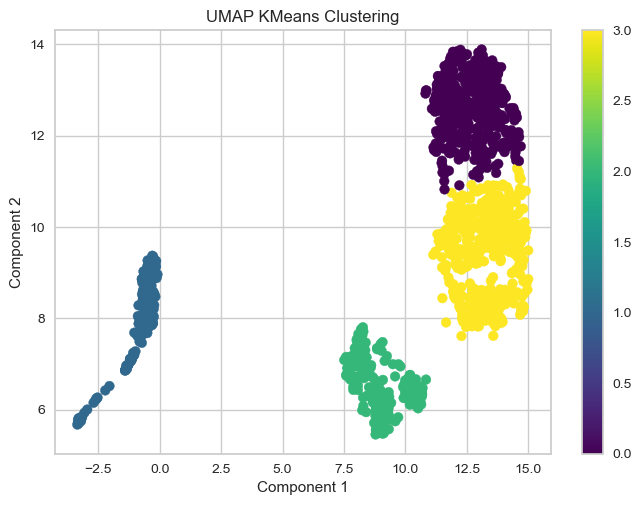

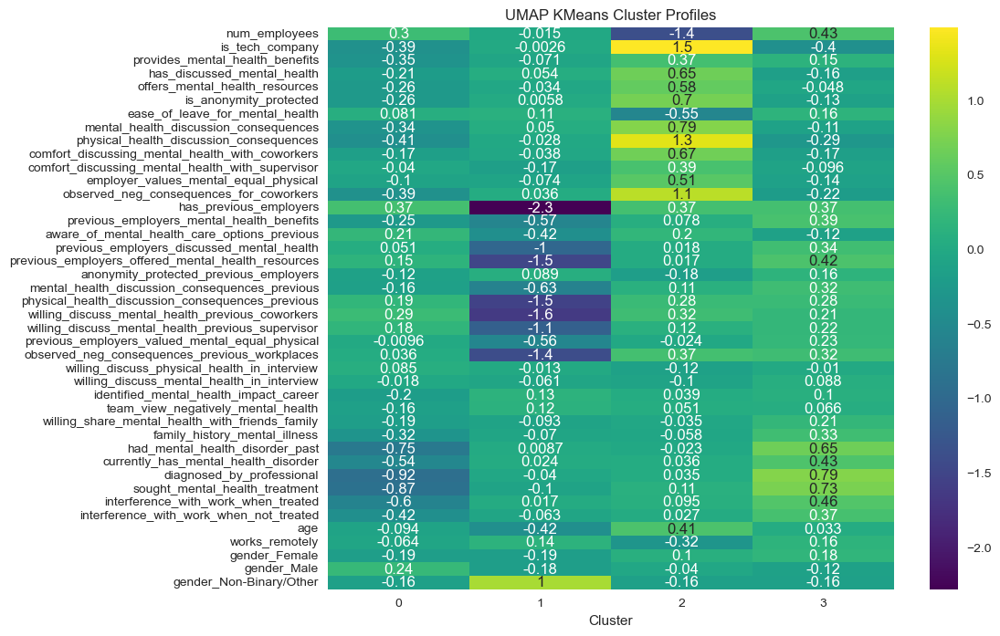

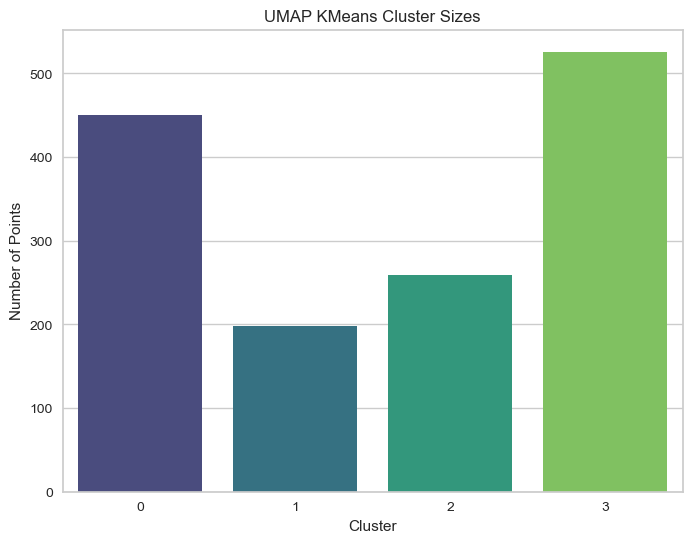

In [252]:

cluster_analysis(data_selected, technique='UMAP', cluster_method='KMeans', scaling='standard', n_clusters=4, n_components=2)

In [232]:
clusters = pd.read_excel('clusters.xlsx')
clusters.drop(clusters.columns[0], inplace=True, axis=1)

In [233]:
clusters

,Cluster
0,0
1,3
2,0
3,2
4,3
...,...
1428,2
1429,1
1430,3
1431,3


In [245]:
main_df= pd.read_excel(r'C:\Users\mrosk\OneDrive\Desktop\Mental-Health-in-Tech\Preprocessing\preprocessed_data.xlsx')
merged_df = pd.concat([main_df, clusters], axis=1)


In [246]:
merged_df.drop(merged_df.columns[0],inplace=True,axis=1)
features_to_drop = [
    'y__dissociative', 'y_eating', 'y_ocd', 'y_psychotic', 'm_adhd', 'm_eating', 
    'm_mood_disorder', 'm_ocd', 'm_personality', 'm_ptsd', 'm_psychotic', 
    'pro_dissociative', 'pro_eating',  'pro_ocd', 'pro_psychotic', 'y_addictive', 
    'y_anxiety_stress', 'y_mood_disorder', 'y_autism_develop', 'y_other', 'y_ptsd', 'y_adhd', 
    'y_personality', 'm_addictive', 'm_anxiety_stress', 'm_autism_develop', 'm_other', 'm_dissociative', 
    'pro_adhd', 'pro_addictive', 'pro_anxiety_stress', 'pro_autism_develop', 'pro_mood_disorder', 
    'pro_ptsd', 'pro_personality', 'pro_other', 'back_end_developer', 'designer', 'dev_evangelist_advocate', 
    'devops_sysadmin', 'executive_leadership', 'front_end_developer', 'hr_rep', 'one_person_shop', 
    'other_job_description', 'sales_rep', 'supervisor_team_lead', 'support_rep', 'y_no_diagnosis', 'pro_no_diagnosis', 'm_no_diagnosis'
]



merged_df = merged_df.drop(columns = features_to_drop)


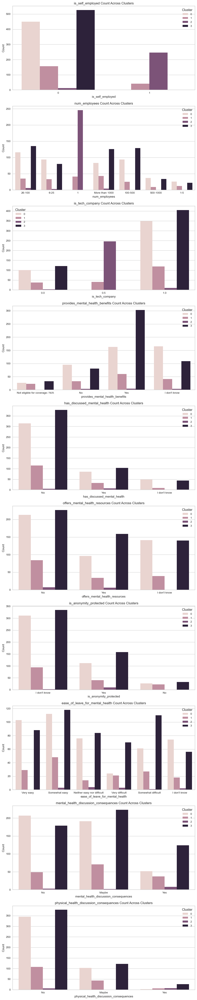

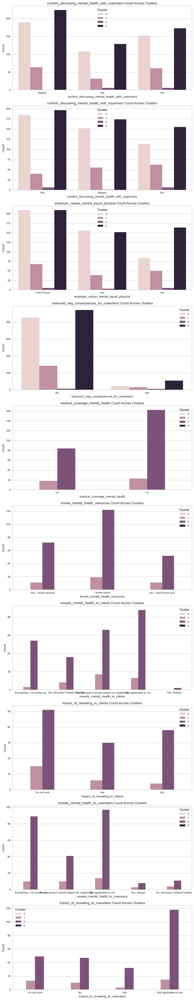

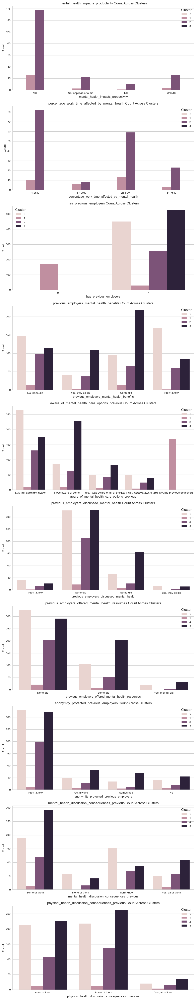

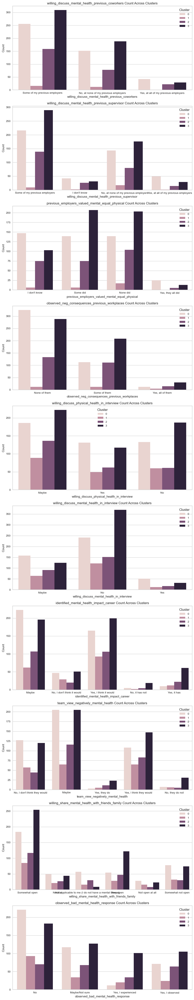

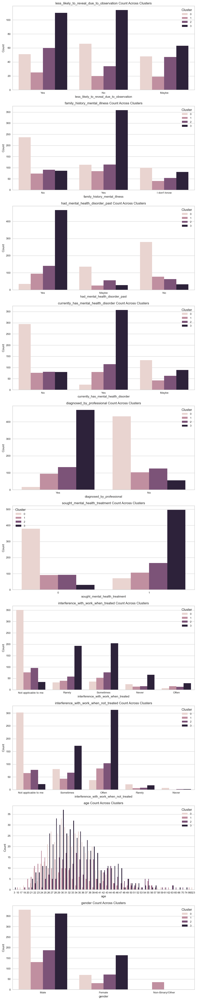

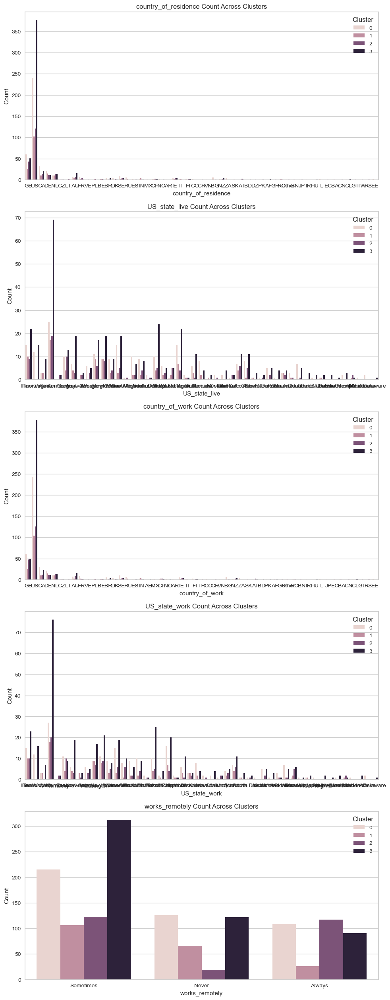

In [256]:
merged_df.drop(columns=['why_physical', 'why_mental'], inplace=True, axis =1)

features_per_figure = 10

# List of features excluding the 'Cluster' column
features = merged_df.columns[:-1]

# Loop through each feature to create visuals
for start in range(0, len(features), features_per_figure):
    end = start + features_per_figure
    plt.figure(figsize=(10, 5 * features_per_figure))
    
    for i, feature in enumerate(features[start:end]):
        plt.subplot(features_per_figure, 1, i + 1)
        sns.countplot(x=feature, hue='Cluster', data=merged_df)
        plt.title(f'{feature} Count Across Clusters')
        plt.xlabel(feature)
        plt.ylabel('Count')
    
    plt.tight_layout()
    plt.show()